In [1]:
import torch
import numpy as np
from matplotlib import pyplot as plt
import pandas as pd
import os

In [2]:
TEST_SPLIT = 0.1
# VAL_SPLIT = 0.2
BATCH_SIZE = 16
NUM_BLOCKS=7
HIDDEN_CHANNELS = 120
LEARNING_RATE = 0.001
attention = 'soft_attention'

In [3]:
# Mount Google Drive
from google.colab import drive
import os

drive.mount('/content/gdrive')
# Define base folder path
base_path = '/content/gdrive/MyDrive/yoga_proj'
!ls /content/gdrive/MyDrive/yoga_proj
# base_path = '../'

Mounted at /content/gdrive
120_h_d_LR_0.01_FEB_4_NEW_STSAE_GCN
Adaptive_avg_pooling_BLOCKSIZE_7__RC_attention_january_31_stsaegcn
Adaptive_avg_pooling_RC_attention_january_31_stsaegcn
CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention
data
dec16_Cross_fold
Dropout_RC_attention_january_31_stsaegcn
FEB_4_NEW_STSAE_GCN
FEB_4_no_STSAM_RES_BN_NEW_STSAE_GCN
FEB_4_with_STSAM_RES_BN_NEW_STSAE_GCN
HIGH_LR_FEB_4_NEW_STSAE_GCN
jan30_Cross_fold
january_30_CORRECTED_stsaegcn
january_31_CORRECTED_stsaegcn
LESS_POWER_MTCN_FIXED_stsaegcn
Lower_Model_Capacity_RC_attention_january_31_stsaegcn
LR_0.001_STSAE_GCN_2025-02-08_B7_HC120_soft_attention
LR_0.008_STSAE_GCN_2025-02-08_B7_HC120_soft_attention
LR_0.1_STSAE_GCN_2025-02-08_B7_HC120_soft_attention
MORE_REDUCED_4_BLOCKS_Model_Capacity_RC_attention_january_31_stsaegcn
MTCN_FIXED_stsaegcn
NEW_STSAE_GCN_2025-02-08_B7_HC120_soft_attention
NO_MTCN_120_h_d_LR_0.01_FEB_4_NEW_STSAE_GCN
NO_MTCN_stsaegcn
NO_STSAM_stsaegcn
nov16_second_run
nov16_test

In [4]:
import os
from datetime import datetime

# Gets label
csv_path = os.path.join(base_path,'data/3DYoga90_corrected.csv')

# SAVE_PATH = os.path.join(base_path, 'STSAE_GCN')
today = datetime.today().strftime('%Y-%m-%d')
SAVE_PATH = os.path.join(
    base_path,
    f'CROSS_FOLD_STSAE_GCN_{today}_B{NUM_BLOCKS}_HC{HIDDEN_CHANNELS}_LR{LEARNING_RATE}_{attention}'
)
os.makedirs(SAVE_PATH, exist_ok=True)
print(SAVE_PATH)

pose_list = ['downward-dog','standing-forward-bend','half-way-lift',
             'mountain','chair','cobra','cockerel','extended-triangle',
             'extended-side-angle','corpse','staff','wind-relieving','fish'
            ]
NUM_CLASSES = len(pose_list)

dataset_dir = os.path.join(base_path, 'official_dataset')
assert os.path.isdir(dataset_dir), f"Directory '{dataset_dir}' does not exist."


/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention


In [5]:
print(torch.__version__)
device = 'cuda' if torch.cuda.is_available() else 'cpu'

2.5.1+cu124


In [6]:
meta_info_path = os.path.join(base_path, 'data')
pose_index = pd.read_csv(f'{meta_info_path}/pose-index.csv')
sequence_index = pd.read_csv(f'{meta_info_path}/3DYoga90_corrected.csv')

What does each file tell?

1.) pose-index.csv -> Shows Heirarchical organization (THEN NOTHING MORE)

2.) 3DYoga90.csv -> Total Main Info(i.e. along with RGB stream){
    SequneceID: Parquet_FILE_NAME,
    URL,
    Frame Start and Frame Stop,
    Pose Name, Training Test Split
} `Difference between train and test? where to get the validation set from? How to do data augmentation?

3.) Parquet Files -> {
    Frame Number {
        33 Landmarks
    },
    row-id: FrameNumber-TYPE-Landmark_index,
    Coordinates: {x, y, z}
}

`PLEASE NOTE: The landmark coordinates are all normalized`

# Getting the data ready

In [7]:
subset_of_poses = pose_list

In [8]:
# Keep only relevant columns
def read_meta_data():
    meta_info_path = os.path.join(base_path, 'data')
    pose_index = pd.read_csv(f'{meta_info_path}/pose-index.csv')
    sequence_index = pd.read_csv(f'{meta_info_path}/3DYoga90_corrected.csv')
    parquet_index = sequence_index[['sequence_id', 'l3_pose', 'split']]
    return parquet_index

In [9]:
import torch
import torch.nn.functional as F
import numpy as np

def AddGaussianNoise(data, mean=0., std=0.01):
    noise = torch.randn_like(data) * std + mean
    return data + noise

def RandomRotate(data, max_angle=30):
    angle = torch.rand(1) * 2 * max_angle - max_angle  # Range: [-max_angle, max_angle] in degrees
    angle_rad = torch.deg2rad(angle)
    cos_theta = torch.cos(angle_rad)
    sin_theta = torch.sin(angle_rad)

    rotation_matrix = torch.tensor([
        [cos_theta, 0, sin_theta],
        [0, 1, 0],
        [-sin_theta, 0, cos_theta]
    ]).squeeze()

    # print(data.shape)
    # print(rotation_matrix.shape)
    # data = torch.matmul(rotation_matrix, data)
    data = torch.einsum('ij, jkl -> ikl', rotation_matrix, data)
    return data

def RandomScale(data, scale_range=(0.9, 1.1)):
    scale =  scale_range[0] + torch.rand(1) * (scale_range[1] - scale_range[0]) # 0.9 + 0.2 * percentage
    return data * scale

def RandomTranslate(data, max_translate=0.1):
    translate = torch.rand(3) * 2 * max_translate - max_translate  # Range: [-max_translate, max_translate]
    return data + translate.unsqueeze(1).unsqueeze(2)

def TimeReverse(data, p=0.5):
    if torch.rand(1) < p:
        return torch.flip(data, [1])
    else:
        return data

In [10]:
import torch
from torch.utils.data import Dataset
import pandas as pd
import numpy as np

class Yoga3DDataset(Dataset):
    def __init__(self, parquet_index, root_dir =  dataset_dir,subset_of_poses= subset_of_poses, sub_sampling_length = 20, transform=None, max_frames=None):
        self.parquet_index = parquet_index
        self.parquet_index = self.parquet_index[self.parquet_index['l3_pose'].isin(subset_of_poses)]
        self.root_dir = root_dir
        self.transform = transform
        self.max_frames = max_frames
        self.sub_sampling_length = sub_sampling_length
        self.pose_to_label = {pose: i for i, pose in enumerate(subset_of_poses)}
        self.use_augmentation = False

        self.cache = dict()
        self.idx_to_seq = dict()

    def __len__(self):
        return len(self.parquet_index)

    def __getitem__(self, idx):
        if idx in self.cache:
            data, label = self.cache[idx]
        else:
            fname, pose_name, _ = self.parquet_index.iloc[idx]
            label = self.pose_to_label[pose_name]
            path = os.path.join(self.root_dir, f'{fname}.parquet')

            df = pd.read_parquet(path)
            df = df.drop(columns=['frame', 'row_id', 'type','landmark_index'])

            data = self.to_tensor(df)
            data = self.sub_sample(data)
            data = data.permute(1,0,2)
            self.cache[idx] = (data, label)
            self.idx_to_seq[idx] = fname

        if self.transform and self.use_augmentation:
            data = self.transform(data.clone())

        return data, label # C, T , V

    def sub_sample(self, data):
        # data(Number_of_frames, 3, 33)
        total_frames = data.shape[0]
        indices = torch.linspace(0, total_frames -1 , self.sub_sampling_length, dtype= int)
        return data[indices]

    def to_tensor(self, df):
        # Reshape the data to (num_frames, num_landmarks, 3)  ## WHAT WHAT? this doesn't make sense remove this line you are doing (number of frames, 3 , 33)
        num_frames = len(df) // 33  # Assuming 33 landmarks per frame
        data = df.values.reshape(num_frames, 33, 3)
        return torch.FloatTensor(data).permute(0, 2, 1)

In [11]:
class Compose:
    def __init__(self, transforms):
        self.transforms = transforms

    def __call__(self, data):
        for transform in self.transforms:
            data = transform(data)
        return data

In [12]:
class RandomApply:
    def __init__(self, transform, p=0.5):
        self.transform = transform
        self.p = p

    def __call__(self, data):
        if torch.rand(1) < self.p:
            return self.transform(data)
        else:
            return data

In [13]:
import numpy as np
JOINT_COUNT = 33


def edge2mat(link, num_node):
    A = np.zeros((num_node, num_node))
    for i, j in link:
        A[j, i] = 1
    return A


def normalize_digraph(A, dim=0):
    # A is a 2D square array
    Dl = np.sum(A, dim)
    h, w = A.shape
    Dn = np.zeros((w, w))

    for i in range(w):
        if Dl[i] > 0:
            Dn[i, i] = Dl[i] ** (-1)

    AD = np.dot(A, Dn)
    return AD


class Graph:
    """The Graph to model the skeletons.

    Args:
        layout (str): must be one of the following candidates: 'mediapipe'. Default: 'mediapipe'.
        mode (str): must be one of the following candidates: 'stgcn_spatial', 'spatial'. Default: 'spatial'.
        max_hop (int): the maximal distance between two connected nodes.
            Default: 1
    """

    def __init__(
        self,
        layout="mediapipe",
        mode="spatial",
        max_hop=1,
        nx_node=1,
        num_filter=3,
        init_std=0.02,
        init_off=0.04,
    ):

        self.max_hop = max_hop
        self.layout = layout
        self.mode = mode
        self.num_filter = num_filter
        self.init_std = init_std
        self.init_off = init_off
        self.nx_node = nx_node

        assert (
            nx_node == 1 or mode == "random"
        ), "nx_node can be > 1 only if mode is 'random'"
        assert layout in ["mediapipe"]

        self.get_layout(layout)
        #  self.hop_dis = get_hop_distance(self.num_node, self.inward, max_hop)

        assert hasattr(self, mode), f"Do Not Exist This Mode: {mode}"
        self.A = getattr(self, mode)()

    def __str__(self):
        return self.A

    def get_layout(self, layout):
        if layout == "mediapipe":
            self.num_node = 33
            self.inward = [
                # Torso
                (12, 11),
                (24, 12),
                (24, 23),
                (23, 11),  # shoulders to hips
                # Right arm
                (14, 12),
                (16, 14),
                (18, 16),
                (20, 18),
                (20, 22),  # shoulder to fingertip
                # Left arm
                (13, 11),
                (15, 13),
                (17, 15),
                (19, 17),
                (21, 19),  # shoulder to fingertip
                # Right leg
                (26, 24),
                (28, 26),
                (30, 28),
                (32, 30),  # hip to foot
                # Left leg
                (25, 23),
                (27, 25),
                (29, 27),
                (31, 29),  # hip to foot
                # Face
                (1, 0),
                (2, 1),
                (3, 2),
                (7, 3),  # right eye
                (4, 0),
                (5, 4),
                (6, 5),
                (8, 6),  # left eye
                (10, 9),  # mouth
                # Add connections to nose (0) from shoulders
                # (0, 11), (0, 12)  # do we include this connection dear friend?
            ]
            self.center = 11  # Left shoulder as the center
        else:
            raise ValueError(f"Do Not Exist This Layout: {layout}")
        self.self_link = [(i, i) for i in range(self.num_node)]
        self.outward = [(j, i) for (i, j) in self.inward]
        self.neighbor = self.inward + self.outward

    def spatial(self):
        Iden = edge2mat(self.self_link, self.num_node)
        In = normalize_digraph(edge2mat(self.inward, self.num_node))
        Out = normalize_digraph(edge2mat(self.outward, self.num_node))
        A = np.stack((Iden, In, Out))
        return A

import torch
import torch.nn as nn
import torch.nn.functional as F


class AGCN(nn.Module):
    def __init__(
        self, in_channels, out_channels, adaptive="init", conv_pos="pre", with_res=False
    ):
        super().__init__()
        self.in_channels = in_channels
        self.out_channels = out_channels
        self.graph = Graph()
        A = torch.tensor(self.graph.A, dtype=torch.float32, requires_grad=False)
        self.num_subsets = A.size(0)
        # print("NUM_SUBSET:", self.num_subsets)
        self.adaptive = adaptive
        self.conv_pos = conv_pos
        self.with_res = with_res

        self.A = nn.Parameter(A.clone())

        if self.conv_pos == "pre":
            self.conv = nn.Conv2d(in_channels, out_channels * self.num_subsets, 1)
        elif self.conv_pos == "post":
            self.conv = nn.Conv2d(self.num_subsets * in_channels, out_channels, 1)

        if self.with_res:
            if in_channels != out_channels:
                self.residual = nn.Sequential(
                    nn.Conv2d(in_channels, out_channels, 1),
                    nn.BatchNorm2d(out_channels),
                )
            else:
                self.residual = lambda x: x

        self.batch_norm = nn.BatchNorm2d(out_channels)

    def forward(self, x):
        n, c, t, v = x.shape
        res = self.residual(x) if self.with_res else 0

        A = self.A

        if self.conv_pos == "pre":
            x = self.conv(x)
            x = x.view(n, self.num_subsets, -1, t, v)
            x = torch.einsum("nkctv,kvw->nctw", (x, A)).contiguous()
        elif self.conv_pos == "post":
            x = torch.einsum("nctv,kvw->nkctw", (x, A)).contiguous()
            x = x.view(n, -1, t, v)
            x = self.conv(x)

        return F.relu(self.batch_norm(x) + res)


def weights_init(m):
    classname = m.__class__.__name__
    if classname.find("Conv") != -1:
        if hasattr(m, "weight"):
            nn.init.kaiming_normal_(m.weight, mode="fan_out")
        if (
            hasattr(m, "bias")
            and m.bias is not None
            and isinstance(m.bias, torch.Tensor)
        ):
            nn.init.constant_(m.bias, 0)
    elif classname.find("BatchNorm") != -1:
        if hasattr(m, "weight") and m.weight is not None:
            m.weight.data.normal_(1.0, 0.02)
        if hasattr(m, "bias") and m.bias is not None:
            m.bias.data.fill_(0)

class TemporalConv(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size, stride=1, dilation=1):
        super(TemporalConv, self).__init__()
        pad = (kernel_size + (kernel_size - 1) * (dilation - 1) - 1) // 2
        self.conv = nn.Conv2d(
            in_channels,
            out_channels,
            kernel_size=(kernel_size, 1),
            padding=(pad, 0),
            stride=(stride, 1),
            dilation=(dilation, 1),
        )

        self.bn = nn.BatchNorm2d(out_channels)

    def forward(self, x):
        x = self.conv(x)
        x = self.bn(x)
        return x


class MTCN(nn.Module):
    def __init__(
        self,
        in_channels,
        out_channels,
        kernel_size=3,
        stride=1,
        dilations=[1, 2, 3, 4],
        residual=True,
        residual_kernel_size=1,
    ):

        super().__init__()
        assert (
            out_channels % (len(dilations) + 2) == 0
        ), "# out channels should be multiples of # branches"

        # Multiple branches of temporal convolution
        self.num_branches = len(dilations) + 2
        branch_channels = out_channels // self.num_branches
        if type(kernel_size) == list:
            assert len(kernel_size) == len(dilations)
        else:
            kernel_size = [kernel_size] * len(dilations)
        # Temporal Convolution branches
        self.branches = nn.ModuleList(
            [
                nn.Sequential(
                    nn.Conv2d(in_channels, branch_channels, kernel_size=1, padding=0),
                    nn.BatchNorm2d(branch_channels),
                    nn.ReLU(inplace=True),
                    TemporalConv(
                        branch_channels,
                        branch_channels,
                        kernel_size=ks,
                        stride=stride,
                        dilation=dilation,
                    ),
                )
                for ks, dilation in zip(kernel_size, dilations)
            ]
        )

        # Additional Max & 1x1 branch
        self.branches.append(
            nn.Sequential(
                nn.Conv2d(in_channels, branch_channels, kernel_size=1, padding=0),
                nn.BatchNorm2d(branch_channels),
                nn.ReLU(inplace=True),
                nn.MaxPool2d(kernel_size=(3, 1), stride=(stride, 1), padding=(1, 0)),
                nn.BatchNorm2d(branch_channels),
            )
        )

        self.branches.append(
            nn.Sequential(
                nn.Conv2d(
                    in_channels,
                    branch_channels,
                    kernel_size=1,
                    padding=0,
                    stride=(stride, 1),
                ),
                nn.BatchNorm2d(branch_channels),
            )
        )

        # Residual connection
        if not residual:
            self.residual = lambda x: 0
        elif (in_channels == out_channels) and (stride == 1):
            self.residual = lambda x: x
        else:
            self.residual = TemporalConv(
                in_channels,
                out_channels,
                kernel_size=residual_kernel_size,
                stride=stride,
            )

        # initialize
        self.apply(weights_init)

    def forward(self, x):
        # Input dim: (N,C,T,V)
        res = self.residual(x)
        branch_outs = []
        for tempconv in self.branches:
            out = tempconv(x)
            branch_outs.append(out)

        out = torch.cat(branch_outs, dim=1)
        out += res
        return out




class SAM(nn.Module):
    def __init__(self, in_channels, joint_count=JOINT_COUNT):
        super(SAM, self).__init__()

        # Conv1D over joints (V), capturing spatial dependencies
        ks = (
            joint_count if joint_count % 2 else joint_count - 1
        )  # Ensure odd kernel size
        padding = (ks - 1) // 2
        self.gs = nn.Conv1d(in_channels, 1, kernel_size=ks, padding=padding)

        # Pool over time (T) only, preserve joints (V)
        self.avg_pool = nn.AdaptiveAvgPool2d(
            (1, None)
        )  # Collapses T, keeps V unchanged

        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        N, C, T, V = x.shape
        # Pool along time (T) dimension only
        t = self.avg_pool(x)  # (N, C, 1, V)

        t = t.squeeze(2)
        t = self.gs(t)  # (N, 1, V)
        Ms = self.sigmoid(t)
        Ms = Ms.unsqueeze(2)
        return (x + x * Ms), Ms


class TAM(nn.Module):
    def __init__(self, in_channels, temporal_size=9):
        super(TAM, self).__init__()
        self.avg_pool = nn.AdaptiveAvgPool2d(
            (None, 1)
        )  # Keep temporal dim, pool joints
        padding = (temporal_size) // 2
        self.gt = nn.Conv1d(in_channels, 1, kernel_size=temporal_size, padding=padding)
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        # Pool over joints (V) while keeping temporal dimension
        t = self.avg_pool(x).squeeze(-1)  # (N, C, T)

        t = self.gt(t)  # (N, 1, T)

        Mt = self.sigmoid(t).unsqueeze(-1)  # (N, 1, T, 1)

        return x * Mt + x, Mt


class CAM(nn.Module):
    def __init__(self, in_channels, reduction=2):
        super(CAM, self).__init__()
        self.avg_pool = nn.AdaptiveAvgPool2d(1)
        # Combine the operations into a single sequential block
        self.fc = nn.Sequential(
            nn.Linear(in_channels, in_channels // reduction),
            nn.ReLU(),  # δ applied to entire W1 term
            nn.Linear(in_channels // reduction, in_channels),
            nn.Sigmoid(),
        )

    def forward(self, x):
        n, c, _, _ = x.shape
        t = self.avg_pool(x).view(n, c)
        Mc = self.fc(t).view(n, c, 1, 1)
        return x * Mc + x, Mc

import torch
import torch.nn as nn
import torch.nn.functional as F


class STSAE_GCN_Block(nn.Module):
    def __init__(self, in_channels, out_channels, residual=True, stride=1):
        super(STSAE_GCN_Block, self).__init__()

        # Graph Convolution
        self.agcn = AGCN(in_channels, out_channels)

        # Attention Modules
        self.sam = SAM(out_channels)  # Spatial Attention
        self.tam = TAM(out_channels)  # Temporal Attention
        self.cam = CAM(out_channels)  # Channel Attention

        # Multi-Scale Temporal Convolution Network
        self.mtcn = MTCN(out_channels, out_channels)

        # Residual Connection
        if not residual:
            self.residual = lambda x: 0
        elif (in_channels == out_channels) and (stride == 1):
            self.residual = lambda x: x
        else:
            self.residual = TemporalConv(
                in_channels, out_channels, kernel_size=1, stride=stride
            )

        # Activation
        self.relu = nn.ReLU()

        # Store Attention Maps
        self.Ms = None  # Spatial Attention Map
        self.Mt = None  # Temporal Attention Map
        self.Mc = None  # Channel Attention Map

    def forward(self, x):
        res = self.residual(x)

        # Apply Graph Convolution
        x = self.agcn(x)

        # Apply Attention Modules and Store Attention Maps
        x, self.Ms = self.sam(x)  # Spatial Attention
        x, self.Mt = self.tam(x)  # Temporal Attention
        x, self.Mc = self.cam(x)  # Channel Attention

        # Apply Multi-Scale Temporal Convolution
        x = self.mtcn(x) + res

        return self.relu(x)

    def get_attention(self):
        """
        Returns the stored attention maps.
        """
        return {"Ms": self.Ms, "Mt": self.Mt, "Mc": self.Mc}


class STSAE_GCN(nn.Module):
    def __init__(
        self, in_channels, hidden_channels, num_classes, num_frames, num_blocks=9
    ):
        super(STSAE_GCN, self).__init__()
        self.num_blocks = num_blocks
        num_nodes = 33
        self.batch_norm = nn.BatchNorm1d(in_channels * num_nodes)
        self.blocks = nn.ModuleList(
            [
                STSAE_GCN_Block(
                    in_channels if i == 0 else hidden_channels,
                    hidden_channels,
                    residual=False if i == 0 else True,
                )
                for i in range(num_blocks)
            ]
        )
        self.avg_pool = nn.AdaptiveAvgPool2d((1, 1))  # Global Average Pooling
        self.fc = nn.Linear(
            hidden_channels, num_classes
        )  # Only hidden_channels remain after pooling

    def forward(self, x):
        # x shape: (batch_size, in_channels, num_frames, num_nodes)

        # print("SHAPE X:", x.shape)
        N, C, T, V = x.size()
        x = x.permute(0, 3, 1, 2).contiguous()
        x = x.view(N, V * C, T)
        x = self.batch_norm(x)
        x = x.view(N, V, C, T).permute(0, 2, 3, 1)

        for block in self.blocks:
            x = block(x)
            # print("X SHAPE:", x.shape)

        # Apply Global Average Pooling
        x = (
            self.avg_pool(x).squeeze(-1).squeeze(-1)
        )  # Reduce to (batch_size, hidden_channels)

        # Fully connected layer
        x = self.fc(x)
        return x

    def count_parameters(self):
        total_params = 0
        for name, parameter in self.named_parameters():
            if parameter.requires_grad:
                params = parameter.numel()
                print(f"{name}: {params}")
                total_params += params
        print(f"Total Trainable Params: {total_params}")


In [14]:
import os
import torch
def save_checkpoint(model, optimizer, epoch, history, save_path = SAVE_PATH, best_path=None):
    if best_path is not None:
        chk_path = os.path.join(save_path, f'best_model.pth')
        print(f"Saving checkpoint to {chk_path}")
    else:
        chk_path = os.path.join(save_path, f'checkpath_model.pth')
        print(f"Saving checkpoint to {chk_path}")

    # Combine model, optimizer, and history into one dictionary
    checkpoint = {
        'epoch': epoch + 1,  # Save the next epoch number for resuming
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
        'history': history  # Save history along with the model and optimizer
    }

    # Save everything in a single file using torch.save
    torch.save(checkpoint, chk_path)
    print(f"Checkpoint saved at epoch {epoch + 1}")

In [15]:
def load_checkpoint(model, optimizer, checkpoint_path):
    """
    Load model and training state from a checkpoint
    """
    print(f"Loading checkpoint from {checkpoint_path}")
    checkpoint = torch.load(checkpoint_path, weights_only = False)

    # Load model and optimizer states
    model.load_state_dict(checkpoint['model_state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])

    # Get the epoch number to resume from
    start_epoch = checkpoint['epoch']

    # Load training history with new metrics
    history = checkpoint.get('history', {
        'train_loss': [], 'val_loss': [],
        'train_acc': [], 'val_acc': [],
        'train_precision': [], 'train_recall': [], 'train_f1': [],
        'val_precision': [], 'val_recall': [], 'val_f1': [],
        'learning_rates': []
    })

    return model, optimizer, start_epoch, history


In [16]:
class EarlyStopping:
    """Early stopping to prevent overfitting"""
    def __init__(self, patience=7, min_delta=0):
        self.patience = patience
        self.min_delta = min_delta
        self.counter = 0
        self.best_loss = None
        self.early_stop = False

    def __call__(self, val_loss):
        if self.best_loss is None:
            self.best_loss = val_loss
        # on default = 7 successive val_loss increase stop
        elif val_loss > self.best_loss - self.min_delta:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_loss = val_loss
            self.counter = 0

In [17]:
from sklearn.metrics import precision_score, recall_score, f1_score
import os
import matplotlib.pyplot as plt

def plot_per_class_metric(precision, recall, f1, epoch=0, pose_list=None, master_save_path="SAVE_PATH"):
    """
    Plots and saves per-class metrics (Precision, Recall, F1-score) for the given epoch.

    Args:
        precision (list): Per-class precision values.
        recall (list): Per-class recall values.
        f1 (list): Per-class F1-score values.
        epoch (int): Current epoch number.
        pose_list (list): List of class names (strings) corresponding to class indices.
        master_save_path (str): Directory to save the plot.
    """
    if pose_list is None:
        pose_list = [str(i) for i in range(len(precision))]  # Default to numeric labels

    save_dir = os.path.join(master_save_path, 'per_class_metric')
    os.makedirs(save_dir, exist_ok=True)

    save_file_path = os.path.join(save_dir, f'per_class_metric_epoch_{epoch}.png')

    # Adjust x-axis positions for grouped bars
    x = range(len(pose_list))

    plt.bar([i - 0.2 for i in x], precision, width=0.2, label='Precision', align='center')
    plt.bar(x, recall, width=0.2, label='Recall', align='center')
    plt.bar([i + 0.2 for i in x], f1, width=0.2, label='F1-Score', align='center')

    plt.xlabel('Class')
    plt.ylabel('Score')
    plt.title(f'Per-Class Metrics - Epoch {epoch}')
    plt.xticks(x, pose_list, rotation=45, ha='right')  # Use pose_list for x-axis labels
    plt.legend()
    plt.tight_layout()  # Adjust layout to fit rotated labels
    plt.savefig(save_file_path)
    plt.show()

def per_class_metric(true, pred, epoch, pose_list=pose_list, average=None):
    """
    Computes and logs per-class metrics (Precision, Recall, F1-score).

    Args:
        true (list): Ground-truth labels.
        pred (list): Predicted labels.
        epoch (int): Current epoch number.
        pose_list (list): List of class names (strings) corresponding to class indices.
        average (str or None): Averaging method for sklearn metrics (None for per-class).
    """
    per_class_precision = precision_score(true, pred, average=average, zero_division=0)
    per_class_recall = recall_score(true, pred, average=average, zero_division=0)
    per_class_f1 = f1_score(true, pred, average=average, zero_division=0)

    print(f"Per-Class Metrics for Epoch {epoch}:")
    for i, (prec, rec, f1) in enumerate(zip(per_class_precision, per_class_recall, per_class_f1)):
        class_name = pose_list[i] if pose_list else f"Class {i}"
        print(f"{class_name}: Precision={prec:.2f}, Recall={rec:.2f}, F1-Score={f1:.2f}")

    plot_per_class_metric(per_class_precision, per_class_recall, per_class_f1, epoch, pose_list)


In [18]:
import os
import torch
from torch.optim import lr_scheduler
from sklearn.metrics import precision_score, recall_score, f1_score
from tqdm import tqdm

def train_model(model, train_loader, val_loader, criterion, optimizer, dataset,fold, num_epochs=50, patience=18, log_interval=10, checkpoint_path=None, unfreeze_epoch=5, num_layers_unfreeze=3):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model = model.to(device)
    print("Using device:", device)

    # Initialize scheduler
    scheduler = lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.1, patience=4)

    # Initialize early stopping
    early_stopping = EarlyStopping(patience=patience, min_delta=1e-4)

    start_epoch = 0
    best_val_loss = float('inf')

    # Initialize history for loss, accuracy, precision, recall, and F1
    history = {
        'train_loss': [], 'val_loss': [],
        'train_acc': [], 'val_acc': [],
        'train_precision': [], 'train_recall': [], 'train_f1': [],
        'val_precision': [], 'val_recall': [], 'val_f1': [],
        'learning_rates': []
    }

    # Check for checkpoint and load if available
    if checkpoint_path and os.path.exists(checkpoint_path):
        model, optimizer, start_epoch, history = load_checkpoint(model, optimizer, checkpoint_path)
        print(f"Resuming training from epoch {start_epoch}")
        torch.cuda.empty_cache()

    for epoch in range(start_epoch, num_epochs):
        dataset.use_augmentation = True #############
        print(f'\nEpoch {epoch + 1}/{num_epochs}')

        current_lr = optimizer.param_groups[0]['lr']
        history['learning_rates'].append(current_lr)
        print(f"Current Learning Rate: {current_lr}")

        # Training phase
        model.train()
        train_loss, train_correct, train_total = 0.0, 0, 0
        train_true, train_pred = [], []

        train_loader_tqdm = tqdm(enumerate(train_loader), total=len(train_loader), desc="Training")
        for batch_idx, (inputs, labels) in train_loader_tqdm:
            inputs, labels = inputs.to(device), labels.to(device)
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()

            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
            optimizer.step()

            train_loss += loss.item() * inputs.size(0)
            _, predicted = torch.max(outputs, 1)
            train_correct += (predicted == labels).sum().item()
            train_total += labels.size(0)

            # Collect true and predicted labels for precision/recall
            train_true.extend(labels.cpu().numpy())
            train_pred.extend(predicted.cpu().numpy())

            # Log batch-level updates
            if batch_idx % log_interval == 0:
                train_loader_tqdm.set_postfix({
                    'loss': train_loss / (BATCH_SIZE * (batch_idx + 1)),
                    'accuracy': 100.0 * train_correct / train_total
                })

        # Calculate training metrics
        train_loss /= len(train_loader.dataset)
        train_acc = 100.0 * train_correct / train_total
        train_precision = precision_score(train_true, train_pred, average='weighted')
        train_recall = recall_score(train_true, train_pred, average='weighted')
        train_f1 = f1_score(train_true, train_pred, average='weighted')

        per_class_metric(train_true, train_pred, epoch)

        dataset.use_augmentation = False
        # Validation phase
        model.eval()
        val_loss, val_correct, val_total = 0.0, 0, 0
        val_true, val_pred = [], []

        val_loader_tqdm = tqdm(enumerate(val_loader), total=len(val_loader), desc="Validation")
        with torch.no_grad():
            for batch_idx, (inputs, labels) in val_loader_tqdm:
                inputs, labels = inputs.to(device), labels.to(device)
                outputs = model(inputs)  # Pass sequence lengths to model forward function
                loss = criterion(outputs, labels)

                val_loss += loss.item() * inputs.size(0)
                _, predicted = torch.max(outputs, 1)
                val_correct += (predicted == labels).sum().item()
                val_total += labels.size(0)

                # Collect true and predicted labels for precision/recall
                val_true.extend(labels.cpu().numpy())
                val_pred.extend(predicted.cpu().numpy())

                # Log batch-level updates for validation
                if batch_idx % log_interval == 0:
                    val_loader_tqdm.set_postfix({
                        'loss': val_loss / (BATCH_SIZE * (batch_idx + 1)),
                        'accuracy': 100.0 * val_correct / val_total
                    })

        # Calculate validation metrics
        val_loss /= len(val_loader.dataset)
        val_acc = 100.0 * val_correct / val_total
        val_precision = precision_score(val_true, val_pred, average='weighted')
        val_recall = recall_score(val_true, val_pred, average='weighted')
        val_f1 = f1_score(val_true, val_pred, average='weighted')
        # Per-class metrics for validation
        per_class_metric(val_true, val_pred, epoch)
        # Update history
        history['train_loss'].append(train_loss)
        history['val_loss'].append(val_loss)
        history['train_acc'].append(train_acc)
        history['val_acc'].append(val_acc)
        history['train_precision'].append(train_precision)
        history['train_recall'].append(train_recall)
        history['train_f1'].append(train_f1)
        history['val_precision'].append(val_precision)
        history['val_recall'].append(val_recall)
        history['val_f1'].append(val_f1)

        # Print metrics at the end of the epoch
        print(f'\nEpoch {epoch + 1}/{num_epochs} Summary:')
        print(f'Train Loss: {train_loss:.4f} | Train Acc: {train_acc:.2f}% | Train Precision: {train_precision:.2f} | Train Recall: {train_recall:.2f} | Train F1: {train_f1:.2f}')
        print(f'Val Loss: {val_loss:.4f} | Val Acc: {val_acc:.2f}% | Val Precision: {val_precision:.2f} | Val Recall: {val_recall:.2f} | Val F1: {val_f1:.2f}')

        # Save the best model checkpoint
        if val_loss < best_val_loss:
            best_val_loss = val_loss
            best_model_path = os.path.join(SAVE_PATH, f'best_model_fold_{fold}.pth')
            if best_model_path is not None:
                print(best_model_path)
            save_checkpoint(model, optimizer, epoch, history, SAVE_PATH, best_model_path)
            print(f"New best model saved! Validation Loss: {best_val_loss:.4f}")

        # Adjust learning rate based on validation loss
        scheduler.step(val_loss)

        # Check for early stopping
        # early_stopping(val_loss)
        # if early_stopping.early_stop:
        #     print("Early stopping triggered")
        #     break

    return model, history

In [19]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
import seaborn as sns
import torch
import numpy as np
import os
from tqdm import tqdm

def evaluate_model(model, test_loader, criterion, class_names,spath=SAVE_PATH, fsave='confusion_matrix.png'):
    """
    Evaluate model on test set

    Args:
        model: PyTorch model
        test_loader: DataLoader for test data
        criterion: Loss function
        class_names: List of class names
        save_path: Directory to save the plot
        fsave: Filename for confusion matrix plot
    """
    csave = os.path.join(spath, fsave)
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model = model.to(device)
    model.eval()

    test_loss = 0.0
    test_correct = 0
    test_total = 0
    all_predictions = []
    all_labels = []

    # Create progress bar
    test_loader_tqdm = tqdm(test_loader, desc="Testing")

    with torch.no_grad():
        for inputs, labels in test_loader_tqdm:
            inputs = inputs.to(device)
            labels = labels.to(device)
            # Forward pass
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            test_loss += loss.item() * inputs.size(0)

            # Get predictions
            _, predicted = torch.max(outputs, 1)
            # Calculate accuracy
            test_correct += (predicted == labels).sum().item()
            test_total += labels.size(0)

            # Store predictions and labels for confusion matrix
            all_predictions.extend(predicted.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())

    # Calculate metrics
    test_loss = test_loss / len(test_loader.dataset)
    accuracy = 100 * test_correct / test_total

    # Create confusion matrix
    cm = confusion_matrix(all_labels, all_predictions)

    # Plot confusion matrix
    plt.figure(figsize=(10, 8))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=class_names, yticklabels=class_names)
    plt.title('Confusion Matrix')
    plt.xlabel('Predicted')
    plt.ylabel('True')

    # Save the plot
    plt.savefig(csave)
    plt.show()
    plt.close()

    print(f'Test Loss: {test_loss:.4f}')
    print(f'Test Accuracy: {accuracy:.2f}%')

    return test_loss, accuracy

In [20]:
from torch.utils.data import random_split, DataLoader

def train_val_test_split(dataset, test_split = TEST_SPLIT):
    total_size = len(dataset)
    test_size = int(test_split * total_size)
    train_size = total_size - test_size

    train_dataset, test_dataset = random_split(
        dataset,
        [train_size, test_size],
        generator=torch.Generator().manual_seed(42)  # For reproducibility
    )

    return train_dataset, test_dataset

def create_data_loaders(train_dataset, test_dataset, batch_size = BATCH_SIZE):
    train_loader = DataLoader(
        train_dataset,
        batch_size=batch_size,
        shuffle=True,
        num_workers=2,
        pin_memory= True
    )

    test_loader = DataLoader(
        test_dataset,
        batch_size=batch_size,
        shuffle=False,
        num_workers=2
    )

    return train_loader, test_loader

In [21]:

def plot_training_curves(history, fold):
    fsave=f'training_curves_fold_{fold}.png'
    tsave = os.path.join(SAVE_PATH, fsave)
    # plt.style.use('seaborn')
    fig, axs = plt.subplots(2, 3, figsize=(18, 10))

    # Loss curves
    axs[0, 0].plot(history['train_loss'], label='Train Loss', marker='o')
    axs[0, 0].plot(history['val_loss'], label='Validation Loss', marker='o')
    axs[0, 0].set_title('Loss')
    axs[0, 0].legend()

    # Accuracy curves
    axs[0, 1].plot(history['train_acc'], label='Train Accuracy', marker='o')
    axs[0, 1].plot(history['val_acc'], label='Validation Accuracy', marker='o')
    axs[0, 1].set_title('Accuracy')
    axs[0, 1].legend()

    # Learning rate
    axs[0, 2].plot(history['learning_rates'], label='Learning Rate', marker='o')
    axs[0, 2].set_title('Learning Rate')
    axs[0, 2].set_yscale('log')
    axs[0, 2].legend()

    # Precision
    axs[1, 0].plot(history['train_precision'], label='Train Precision', marker='o')
    axs[1, 0].plot(history['val_precision'], label='Validation Precision', marker='o')
    axs[1, 0].set_title('Precision')
    axs[1, 0].legend()

    # Recall
    axs[1, 1].plot(history['train_recall'], label='Train Recall', marker='o')
    axs[1, 1].plot(history['val_recall'], label='Validation Recall', marker='o')
    axs[1, 1].set_title('Recall')
    axs[1, 1].legend()

    # F1 Score
    axs[1, 2].plot(history['train_f1'], label='Train F1', marker='o')
    axs[1, 2].plot(history['val_f1'], label='Validation F1', marker='o')
    axs[1, 2].set_title('F1 Score')
    axs[1, 2].legend()

    for ax in axs.flat:
        ax.set_xlabel('Epoch')
        ax.grid(True)

    plt.tight_layout()
    plt.savefig(tsave)
    plt.show()
    plt.close()


In [22]:
import numpy as np
import torch
from collections import Counter
from sklearn.utils.class_weight import compute_class_weight

def get_class_weights(pose_list, num_classes, strategy='balanced'):
    """
    Calculate class weights with proper class index alignment.

    Args:
        pose_list: List of labels/poses in the dataset
        num_classes: Total number of classes
        strategy: Weighting strategy ('balanced', 'inverse', 'effective_samples', 'sqrt_inverse')

    Returns:
        torch.Tensor: Class weights tensor aligned with class indices
    """
    # Count samples per class
    class_counts = Counter(pose_list)
    total_samples = len(pose_list)

    # Initialize weights array with zeros for all possible classes
    weights = np.zeros(num_classes)

    if strategy == 'balanced':
        # Use sklearn's balanced weighting
        unique_classes = sorted(class_counts.keys())
        sklearn_weights = compute_class_weight(
            class_weight='balanced',
            classes=np.array(unique_classes),
            y=pose_list
        )
        # Map weights to correct indices
        for idx, class_label in enumerate(unique_classes):
            weights[class_label] = sklearn_weights[idx]

    elif strategy == 'inverse':
        # Inverse of sample frequency
        for class_label, count in class_counts.items():
            weights[class_label] = total_samples / (num_classes * count)

    elif strategy == 'effective_samples':
        # Effective number of samples weighting
        beta = 0.9999
        for class_label, count in class_counts.items():
            weights[class_label] = (1 - beta) / (1 - beta ** count)

    elif strategy == 'sqrt_inverse':
        # Square root of inverse frequency
        for class_label, count in class_counts.items():
            weights[class_label] = np.sqrt(total_samples / (num_classes * count))

    else:
        raise ValueError(f"Unknown weighting strategy: {strategy}")

    # Convert to tensor and normalize
    weights = torch.FloatTensor(weights)
    weights = weights / weights.sum() * len(weights)

    return weights

def create_weighted_criterion(pose_list, num_classes, strategy='balanced'):
    """
    Create a weighted CrossEntropyLoss criterion.

    Args:
        pose_list: List of labels/poses in the dataset
        num_classes: Total number of classes
        strategy: Weighting strategy for calculating class weights

    Returns:
        nn.CrossEntropyLoss: Weighted loss criterion
    """
    weights = get_class_weights(pose_list, num_classes, strategy)
    print("Class weights aligned with indices:", weights)
    if torch.cuda.is_available():
        weights = weights.cuda()
    return nn.CrossEntropyLoss(weight=weights)

def analyze_class_distribution(pose_list):
    """
    Analyze and print class distribution information.

    Args:
        pose_list: List of labels/poses in the dataset
    """
    class_counts = Counter(pose_list)
    total_samples = len(pose_list)

    print("\nClass Distribution Analysis:")
    print("-" * 50)
    for class_idx, count in sorted(class_counts.items()):
        percentage = (count / total_samples) * 100
        print(f"Class {class_idx}: {count} samples ({percentage:.2f}%)")

    # Calculate imbalance metrics
    max_count = max(class_counts.values())
    min_count = min(class_counts.values())
    imbalance_ratio = max_count / min_count

    print("\nImbalance Statistics:")
    print(f"Imbalance Ratio (max/min): {imbalance_ratio:.2f}")
    print(f"Maximum class size: {max_count}")
    print(f"Minimum class size: {min_count}")
    print(f"Average class size: {total_samples/len(class_counts):.2f}")

In [23]:
from torch.utils.data import Subset

def create_data_loaders(train_idx, val_idx, dataset, batch_size=BATCH_SIZE):
    # Create subsets for this fold
    train_subset = Subset(dataset, train_idx)
    val_subset = Subset(dataset, val_idx)

    # Create data loaders
    train_loader = DataLoader(
        train_subset,
        batch_size=batch_size,
        shuffle=True,
        pin_memory=True
    )
    val_loader = DataLoader(
        val_subset,
        batch_size=batch_size,
        shuffle=False,
        pin_memory=True
    )

    return train_loader, val_loader


In [24]:
def compute_average_history(histories):
    """
    Compute the average history across multiple folds.

    Args:
        histories (list of dict): List of history dictionaries from all folds. Each dictionary contains
                                  metrics like 'train_loss', 'val_loss', 'train_accuracy', etc., as lists.

    Returns:
        dict: Averaged history containing the same keys as the input histories.
    """
    avg_history = {}
    num_folds = len(histories)

    for key in histories[0]:  # Iterate over metric names
        # Initialize a list for each metric
        avg_history[key] = [0.0] * len(histories[0][key])  # Assume all folds have same length histories

        # Sum across all folds
        for fold_history in histories:
            for i, value in enumerate(fold_history[key]):
                avg_history[key][i] += value

        # Divide by the number of folds to compute the average
        avg_history[key] = [val / num_folds for val in avg_history[key]]

    return avg_history


In [25]:
def compute_average_history(histories):
    """
    Compute the average history across multiple folds.

    Args:
        histories (list of dict): List of history dictionaries from all folds. Each dictionary contains
                                  metrics like 'train_loss', 'val_loss', 'train_accuracy', etc., as lists.

    Returns:
        dict: Averaged history containing the same keys as the input histories.
    """
    avg_history = {}
    num_folds = len(histories)

    for key in histories[0]:  # Iterate over metric names
        # Initialize a list for each metric
        avg_history[key] = [0.0] * len(histories[0][key])  # Assume all folds have same length histories

        # Sum across all folds
        for fold_history in histories:
            for i, value in enumerate(fold_history[key]):
                avg_history[key][i] += value

        # Divide by the number of folds to compute the average
        avg_history[key] = [val / num_folds for val in avg_history[key]]

    return avg_history

In [26]:
import os
import pickle
from sklearn.model_selection import StratifiedKFold

def save_folds(meta_info_path, skf, folds):
    folds_path = os.path.join(meta_info_path, "folds.pkl")
    skf_path = os.path.join(meta_info_path, "skf.pkl")

    with open(folds_path, "wb") as f:
        pickle.dump(folds, f)

    with open(skf_path, "wb") as f:
        pickle.dump(skf, f)

def load_folds(meta_info_path):
    folds_path = os.path.join(meta_info_path, "folds.pkl")
    skf_path = os.path.join(meta_info_path, "skf.pkl")

    if os.path.exists(folds_path) and os.path.exists(skf_path):
        with open(folds_path, "rb") as f:
            folds = pickle.load(f)
        with open(skf_path, "rb") as f:
            skf = pickle.load(f)
        return skf, folds
    return None, None

In [27]:
from sklearn.model_selection import StratifiedKFold

def main(in_channels=3, hidden_channels=HIDDEN_CHANNELS, num_classes=NUM_CLASSES, num_frames=20, LR=LEARNING_RATE, Epochs=50):
    transforms = Compose([
        RandomApply(AddGaussianNoise, p=0.5),
        RandomApply(RandomRotate, p=0.5),
        RandomApply(RandomScale, p=0.5),
        RandomApply(RandomTranslate, p=0.5),
    ])

    dataset, train_dataset, test_dataset = prepare_dataset()

    # Load precomputed folds if available
    skf, folds = load_folds(meta_info_path)

    if folds is None:
        k_folds = 5
        skf = StratifiedKFold(n_splits=k_folds, shuffle=True, random_state=42)
        folds = list(skf.split(np.arange(len(train_dataset)), get_all_the_labels(train_dataset)))
        save_folds(meta_info_path, skf, folds)

    best_model = None
    best_val_loss = float('inf')
    best_fold = 0
    all_metrics = []

    print('Starting cross-validation...')
    # print(f"Number of folds: {len(folds)}"
    # modelmm = CNNLSTM(in_channels, hidden_channels, num_classes, num_frames, num_blocks=NUM_BLOCKS)
    for fold, (train_idx, val_idx) in enumerate(folds):
        print(f"Fold {fold + 1}/{len(folds)}")
        train_loader, val_loader = create_data_loaders(train_idx, val_idx, train_dataset)

        # criterion = get_weighted_loss_criterion(dataset)  # CrossEntropyLoss
        criterion = get_weighted_loss_criterion(train_dataset, train_idx)
        model = STSAE_GCN(in_channels, hidden_channels, num_classes, num_frames, num_blocks=NUM_BLOCKS)
        optimizer = torch.optim.Adam(model.parameters(), lr=LR)

        model, history = train_model(
            model,
            train_loader,
            val_loader,
            criterion,
            optimizer,
            dataset,
            fold=fold,
            num_epochs=Epochs,
            patience=10,
            log_interval=1,
            checkpoint_path=None
        )
        plot_training_curves(history, fold)
        all_metrics.append(history)

        if history['val_loss'][-1] < best_val_loss:
            best_val_loss = history['val_loss'][-1]
            best_model = model
            best_fold = fold

    avg_history = compute_average_history(all_metrics)
    plot_training_curves(avg_history, 'average')

    test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)
    evaluate_model(best_model, test_loader, criterion, pose_list)

    model_save_path = os.path.join(SAVE_PATH, f'my_model_{best_fold}.pth')
    torch.save(best_model.state_dict(), model_save_path)


def get_weighted_loss_criterion(train_dataset, train_indices=None):
    """
    Calculate class weights based on the training data only.

    Args:
        train_dataset: The training dataset
        train_indices: Optional indices for cross-validation fold

    Returns:
        torch.nn.CrossEntropyLoss with computed weights
    """
    # If we're doing cross-validation, use only the fold's training data
    if train_indices is not None:
        labels = [train_dataset[i][1] for i in train_indices]
    else:
        labels = [train_dataset[i][1] for i in range(len(train_dataset))]

    analyze_class_distribution(labels)

    # Create weighted loss criterion
    criterion = create_weighted_criterion(
        labels,
        num_classes=NUM_CLASSES,
        strategy='effective_samples'
    )

    return criterion
def prepare_dataset():
    dataset = Yoga3DDataset(read_meta_data()) #removed transforms for now
    train_dataset, test_dataset = train_val_test_split(dataset)
    # train_loader, test_loader = create_data_loaders(train_dataset, test_dataset)
    return dataset,train_dataset,test_dataset

def get_all_the_labels(dataset):
    return [label for _, label in dataset]

In [28]:
# from sklearn.model_selection import StratifiedKFold

# def main(in_channels = 3, hidden_channels= HIDDEN_CHANNELS, num_classes= NUM_CLASSES, num_frames= 20, LR = LEARNING_RATE, Epochs =50):
#     transforms = Compose([
#         RandomApply(AddGaussianNoise, p=0.5),
#         RandomApply(RandomRotate, p=0.5),
#         RandomApply(RandomScale, p=0.5),
#         RandomApply(RandomTranslate, p=0.5),
#         # TimeReverse(p=0.5)
#         # Normalize,
#     ])

#     dataset, train_dataset, test_dataset = prepare_dataset(transforms)

#     # checkpoint_path = os.path.join(SAVE_PATH, 'best_model.pth')
#     k_folds = 5
#     skf = StratifiedKFold(n_splits=k_folds, shuffle=True, random_state=42)

#     folds = list(skf.split(np.arange(len(train_dataset)), get_all_the_labels(train_dataset)))

#     best_model = None
#     best_val_loss = float('inf')
#     best_fold = 0
#     all_metrics = []
#     loss_weights = None
#     print('starting')
#     for fold, (train_idx, val_idx) in enumerate(folds):
#         print(f"Fold {fold + 1}/{k_folds}")
#         train_loader, val_loader = create_data_loaders(train_idx, val_idx, train_dataset)

#         criterion = get_weighted_loss_criterion(dataset) # Cross Entropy Loss
#         model = STSAE_GCN(in_channels, hidden_channels, num_classes, num_frames)
#         optimizer = torch.optim.Adam(model.parameters(), lr=LR)

#         model, history = train_model(
#             model,
#             train_loader,
#             val_loader,
#             criterion,
#             optimizer,
#             dataset,
#             fold= fold,
#             num_epochs= Epochs,
#             patience=20,
#             log_interval=1,
#             checkpoint_path=None
#         )
#         plot_training_curves(history, fold)
#         all_metrics.append(history)

#         print(history['val_loss'][-1])
#         print(type(history['val_loss'][-1]))
#         if history['val_loss'][-1] < best_val_loss:
#             best_val_loss = history['val_loss'][-1]
#             best_model = model
#             best_fold = fold

#     avg_history = compute_average_history(all_metrics)
#     plot_training_curves(avg_history, 'average')  # Plot the average history

#     test_loader = DataLoader(test_dataset, batch_size= BATCH_SIZE, shuffle= False)
#     evaluate_model(best_model, test_loader, criterion, pose_list)

#     model_save_path = os.path.join(SAVE_PATH, f'my_model_{best_fold}.pth')
#     torch.save(best_model.state_dict(), model_save_path)

# def get_weighted_loss_criterion(dataset):
#     all_labels = [dataset[i][1] for i in range(len(dataset))]
#     analyze_class_distribution(all_labels)

#     # Create weighted loss criterion
#     criterion = create_weighted_criterion(
#         all_labels,
#         num_classes= NUM_CLASSES,
#         strategy='effective_samples'  # Try different strategies
#     )

#     return criterion

# def prepare_dataset(transforms):
#     dataset = Yoga3DDataset(read_meta_data(), transform=transforms)
#     train_dataset, test_dataset = train_val_test_split(dataset)
#     # train_loader, test_loader = create_data_loaders(train_dataset, test_dataset)
#     return dataset,train_dataset,test_dataset

# def get_all_the_labels(dataset):
#     return [label for _, label in dataset]

Starting cross-validation...
Fold 1/5

Class Distribution Analysis:
--------------------------------------------------
Class 0: 245 samples (13.48%)
Class 1: 225 samples (12.38%)
Class 2: 209 samples (11.50%)
Class 3: 165 samples (9.08%)
Class 4: 140 samples (7.70%)
Class 5: 129 samples (7.10%)
Class 6: 120 samples (6.60%)
Class 7: 108 samples (5.94%)
Class 8: 101 samples (5.56%)
Class 9: 95 samples (5.23%)
Class 10: 94 samples (5.17%)
Class 11: 94 samples (5.17%)
Class 12: 93 samples (5.12%)

Imbalance Statistics:
Imbalance Ratio (max/min): 2.63
Maximum class size: 245
Minimum class size: 93
Average class size: 139.85
Class weights aligned with indices: tensor([0.5117, 0.5567, 0.5988, 0.7568, 0.8908, 0.9663, 1.0383, 1.1529, 1.2324,
        1.3099, 1.3237, 1.3237, 1.3379])
Using device: cuda

Epoch 1/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.85it/s, loss=1.34, accuracy=61.8]


Per-Class Metrics for Epoch 0:
downward-dog: Precision=0.79, Recall=0.71, F1-Score=0.75
standing-forward-bend: Precision=0.70, Recall=0.53, F1-Score=0.61
half-way-lift: Precision=0.72, Recall=0.84, F1-Score=0.78
mountain: Precision=0.64, Recall=0.64, F1-Score=0.64
chair: Precision=0.49, Recall=0.51, F1-Score=0.50
cobra: Precision=0.75, Recall=0.74, F1-Score=0.74
cockerel: Precision=0.55, Recall=0.67, F1-Score=0.61
extended-triangle: Precision=0.44, Recall=0.47, F1-Score=0.45
extended-side-angle: Precision=0.49, Recall=0.44, F1-Score=0.46
corpse: Precision=0.39, Recall=0.37, F1-Score=0.38
staff: Precision=0.52, Recall=0.71, F1-Score=0.60
wind-relieving: Precision=0.67, Recall=0.65, F1-Score=0.66
fish: Precision=0.49, Recall=0.47, F1-Score=0.48


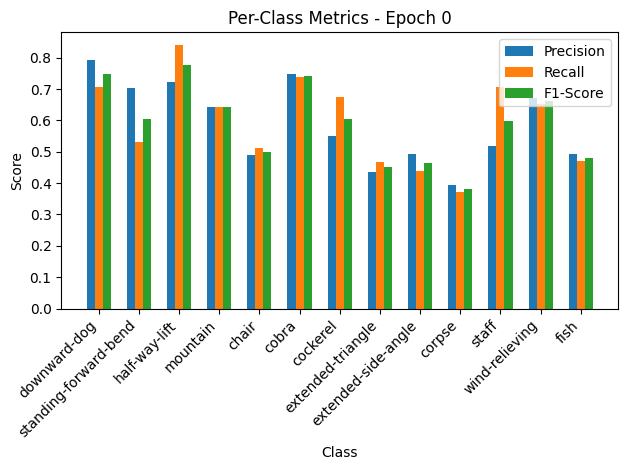

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.83it/s, loss=0.512, accuracy=82.9]


Per-Class Metrics for Epoch 0:
downward-dog: Precision=0.84, Recall=0.91, F1-Score=0.88
standing-forward-bend: Precision=0.68, Recall=0.95, F1-Score=0.79
half-way-lift: Precision=1.00, Recall=0.57, F1-Score=0.72
mountain: Precision=0.74, Recall=0.97, F1-Score=0.84
chair: Precision=0.94, Recall=0.62, F1-Score=0.75
cobra: Precision=0.91, Recall=0.91, F1-Score=0.91
cockerel: Precision=1.00, Recall=0.82, F1-Score=0.90
extended-triangle: Precision=1.00, Recall=0.89, F1-Score=0.94
extended-side-angle: Precision=0.94, Recall=0.89, F1-Score=0.92
corpse: Precision=0.62, Recall=0.59, F1-Score=0.61
staff: Precision=0.81, Recall=1.00, F1-Score=0.89
wind-relieving: Precision=1.00, Recall=0.82, F1-Score=0.90
fish: Precision=0.70, Recall=0.78, F1-Score=0.74


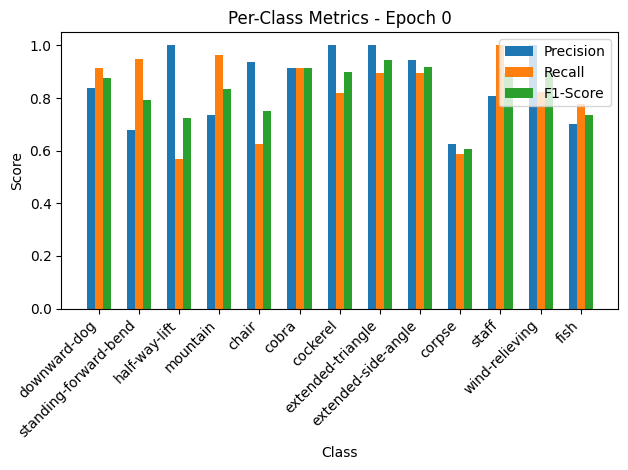


Epoch 1/50 Summary:
Train Loss: 1.3451 | Train Acc: 61.80% | Train Precision: 0.62 | Train Recall: 0.62 | Train F1: 0.62
Val Loss: 0.5248 | Val Acc: 82.93% | Val Precision: 0.86 | Val Recall: 0.83 | Val F1: 0.83
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model.pth
Checkpoint saved at epoch 1
New best model saved! Validation Loss: 0.5248

Epoch 2/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:06<00:00, 13.37it/s, loss=0.6, accuracy=80.7]


Per-Class Metrics for Epoch 1:
downward-dog: Precision=0.95, Recall=0.91, F1-Score=0.93
standing-forward-bend: Precision=0.89, Recall=0.72, F1-Score=0.80
half-way-lift: Precision=0.77, Recall=0.85, F1-Score=0.81
mountain: Precision=0.80, Recall=0.85, F1-Score=0.83
chair: Precision=0.79, Recall=0.81, F1-Score=0.80
cobra: Precision=0.91, Recall=0.91, F1-Score=0.91
cockerel: Precision=0.87, Recall=0.91, F1-Score=0.89
extended-triangle: Precision=0.69, Recall=0.75, F1-Score=0.72
extended-side-angle: Precision=0.72, Recall=0.67, F1-Score=0.70
corpse: Precision=0.58, Recall=0.51, F1-Score=0.55
staff: Precision=0.86, Recall=0.94, F1-Score=0.90
wind-relieving: Precision=0.77, Recall=0.84, F1-Score=0.81
fish: Precision=0.59, Recall=0.63, F1-Score=0.61


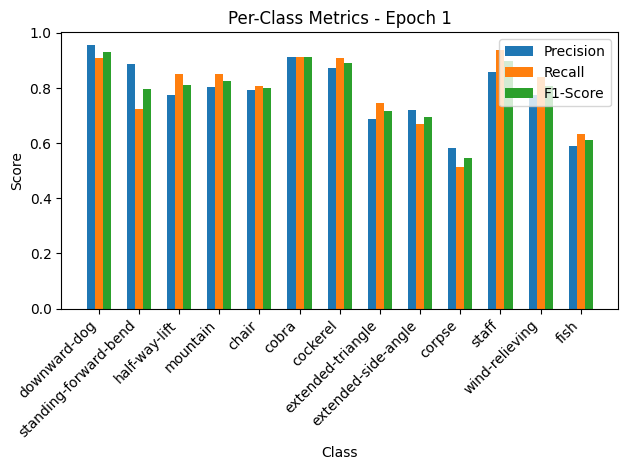

Validation: 100%|██████████| 21/21 [00:00<00:00, 38.33it/s, loss=0.392, accuracy=81.7]


Per-Class Metrics for Epoch 1:
downward-dog: Precision=0.96, Recall=0.96, F1-Score=0.96
standing-forward-bend: Precision=0.55, Recall=0.97, F1-Score=0.70
half-way-lift: Precision=1.00, Recall=0.19, F1-Score=0.32
mountain: Precision=0.85, Recall=0.97, F1-Score=0.90
chair: Precision=0.95, Recall=0.75, F1-Score=0.84
cobra: Precision=0.96, Recall=0.96, F1-Score=0.96
cockerel: Precision=1.00, Recall=0.95, F1-Score=0.98
extended-triangle: Precision=0.70, Recall=1.00, F1-Score=0.83
extended-side-angle: Precision=1.00, Recall=0.47, F1-Score=0.64
corpse: Precision=0.70, Recall=0.82, F1-Score=0.76
staff: Precision=0.89, Recall=0.94, F1-Score=0.91
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=0.83, Recall=0.83, F1-Score=0.83


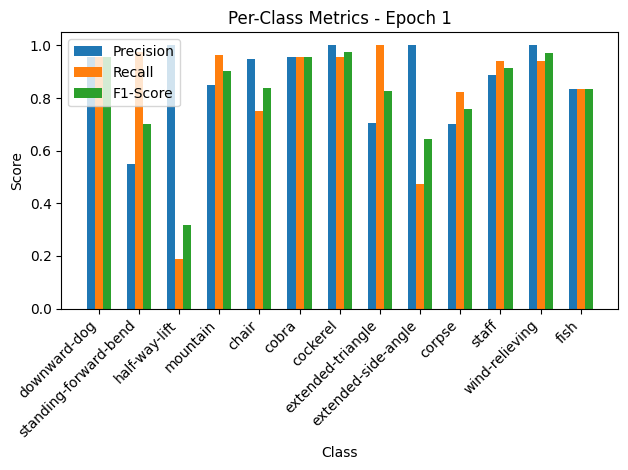


Epoch 2/50 Summary:
Train Loss: 0.6011 | Train Acc: 80.67% | Train Precision: 0.81 | Train Recall: 0.81 | Train F1: 0.81
Val Loss: 0.4016 | Val Acc: 81.71% | Val Precision: 0.87 | Val Recall: 0.82 | Val F1: 0.80
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model.pth
Checkpoint saved at epoch 2
New best model saved! Validation Loss: 0.4016

Epoch 3/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:07<00:00, 10.72it/s, loss=0.415, accuracy=86.6]


Per-Class Metrics for Epoch 2:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.90, Recall=0.77, F1-Score=0.83
half-way-lift: Precision=0.81, Recall=0.89, F1-Score=0.85
mountain: Precision=0.85, Recall=0.91, F1-Score=0.88
chair: Precision=0.88, Recall=0.83, F1-Score=0.85
cobra: Precision=0.93, Recall=0.96, F1-Score=0.94
cockerel: Precision=0.94, Recall=0.96, F1-Score=0.95
extended-triangle: Precision=0.83, Recall=0.86, F1-Score=0.84
extended-side-angle: Precision=0.80, Recall=0.81, F1-Score=0.80
corpse: Precision=0.63, Recall=0.64, F1-Score=0.64
staff: Precision=0.94, Recall=0.97, F1-Score=0.95
wind-relieving: Precision=0.94, Recall=0.90, F1-Score=0.92
fish: Precision=0.67, Recall=0.69, F1-Score=0.68


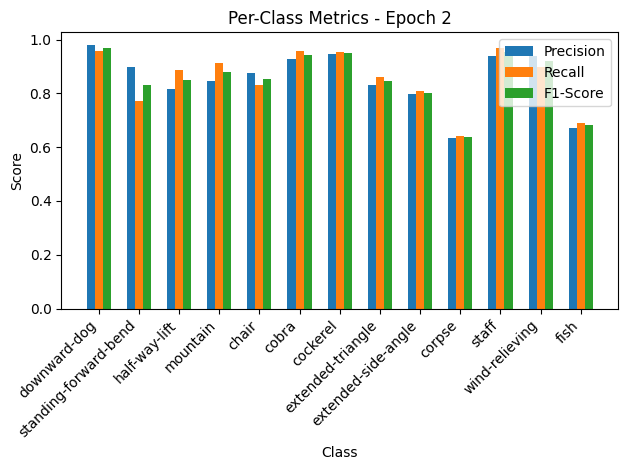

Validation: 100%|██████████| 21/21 [00:00<00:00, 35.31it/s, loss=0.261, accuracy=91.8]


Per-Class Metrics for Epoch 2:
downward-dog: Precision=0.91, Recall=0.93, F1-Score=0.92
standing-forward-bend: Precision=1.00, Recall=0.93, F1-Score=0.96
half-way-lift: Precision=0.93, Recall=1.00, F1-Score=0.96
mountain: Precision=0.96, Recall=0.86, F1-Score=0.91
chair: Precision=0.85, Recall=0.92, F1-Score=0.88
cobra: Precision=1.00, Recall=0.87, F1-Score=0.93
cockerel: Precision=0.92, Recall=1.00, F1-Score=0.96
extended-triangle: Precision=0.95, Recall=1.00, F1-Score=0.97
extended-side-angle: Precision=1.00, Recall=0.89, F1-Score=0.94
corpse: Precision=0.64, Recall=0.94, F1-Score=0.76
staff: Precision=0.89, Recall=1.00, F1-Score=0.94
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=0.91, Recall=0.56, F1-Score=0.69


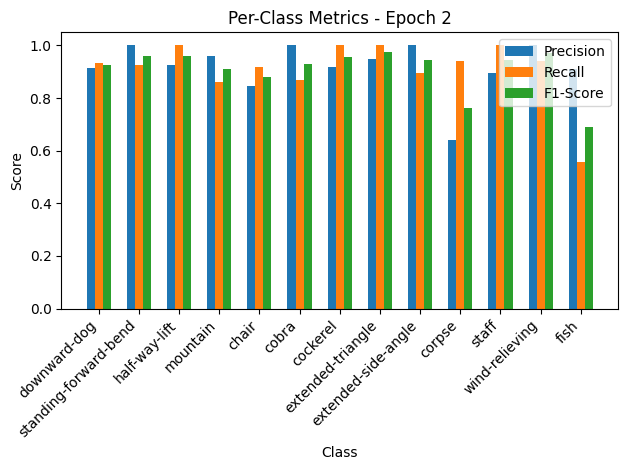


Epoch 3/50 Summary:
Train Loss: 0.4163 | Train Acc: 86.55% | Train Precision: 0.87 | Train Recall: 0.87 | Train F1: 0.87
Val Loss: 0.2673 | Val Acc: 91.77% | Val Precision: 0.93 | Val Recall: 0.92 | Val F1: 0.92
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model.pth
Checkpoint saved at epoch 3
New best model saved! Validation Loss: 0.2673

Epoch 4/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:06<00:00, 13.02it/s, loss=0.332, accuracy=88.8]


Per-Class Metrics for Epoch 3:
downward-dog: Precision=0.92, Recall=0.93, F1-Score=0.93
standing-forward-bend: Precision=0.92, Recall=0.82, F1-Score=0.87
half-way-lift: Precision=0.83, Recall=0.88, F1-Score=0.85
mountain: Precision=0.91, Recall=0.93, F1-Score=0.92
chair: Precision=0.91, Recall=0.88, F1-Score=0.90
cobra: Precision=0.90, Recall=0.90, F1-Score=0.90
cockerel: Precision=0.95, Recall=0.98, F1-Score=0.96
extended-triangle: Precision=0.87, Recall=0.87, F1-Score=0.87
extended-side-angle: Precision=0.81, Recall=0.84, F1-Score=0.82
corpse: Precision=0.76, Recall=0.76, F1-Score=0.76
staff: Precision=0.91, Recall=0.97, F1-Score=0.94
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.78, Recall=0.76, F1-Score=0.77


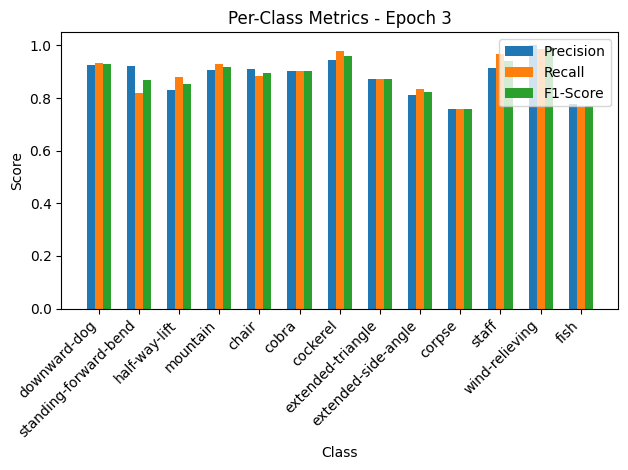

Validation: 100%|██████████| 21/21 [00:00<00:00, 28.65it/s, loss=0.239, accuracy=95.1]


Per-Class Metrics for Epoch 3:
downward-dog: Precision=0.96, Recall=0.93, F1-Score=0.95
standing-forward-bend: Precision=1.00, Recall=0.97, F1-Score=0.99
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.99
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.88, F1-Score=0.93
cobra: Precision=1.00, Recall=0.87, F1-Score=0.93
cockerel: Precision=0.88, Recall=1.00, F1-Score=0.94
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=0.88, Recall=0.82, F1-Score=0.85
staff: Precision=0.89, Recall=1.00, F1-Score=0.94
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.84, Recall=0.89, F1-Score=0.86


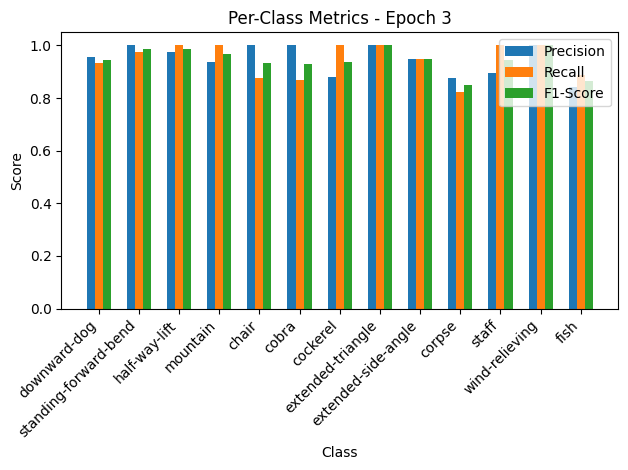


Epoch 4/50 Summary:
Train Loss: 0.3330 | Train Acc: 88.77% | Train Precision: 0.89 | Train Recall: 0.89 | Train F1: 0.89
Val Loss: 0.2445 | Val Acc: 95.12% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model.pth
Checkpoint saved at epoch 4
New best model saved! Validation Loss: 0.2445

Epoch 5/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:07<00:00, 10.70it/s, loss=0.305, accuracy=89.5]


Per-Class Metrics for Epoch 4:
downward-dog: Precision=0.96, Recall=0.95, F1-Score=0.95
standing-forward-bend: Precision=0.89, Recall=0.86, F1-Score=0.87
half-way-lift: Precision=0.86, Recall=0.89, F1-Score=0.88
mountain: Precision=0.91, Recall=0.91, F1-Score=0.91
chair: Precision=0.91, Recall=0.91, F1-Score=0.91
cobra: Precision=0.96, Recall=0.97, F1-Score=0.96
cockerel: Precision=0.95, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.84, Recall=0.78, F1-Score=0.81
extended-side-angle: Precision=0.77, Recall=0.81, F1-Score=0.79
corpse: Precision=0.83, Recall=0.74, F1-Score=0.78
staff: Precision=0.94, Recall=0.98, F1-Score=0.96
wind-relieving: Precision=0.94, Recall=0.99, F1-Score=0.96
fish: Precision=0.77, Recall=0.78, F1-Score=0.77


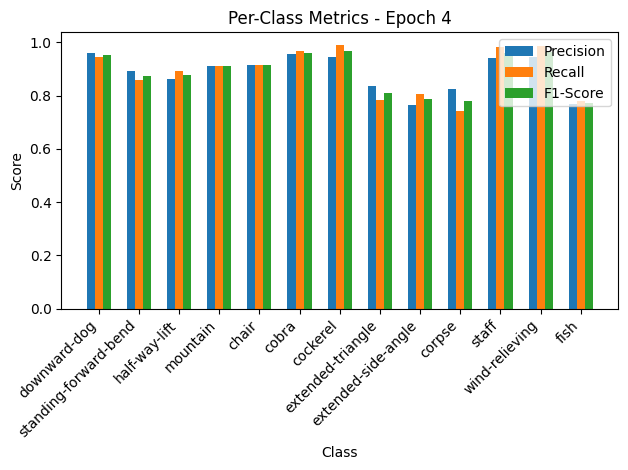

Validation: 100%|██████████| 21/21 [00:00<00:00, 25.40it/s, loss=0.359, accuracy=93.3]


Per-Class Metrics for Epoch 4:
downward-dog: Precision=0.94, Recall=1.00, F1-Score=0.97
standing-forward-bend: Precision=0.93, Recall=1.00, F1-Score=0.96
half-way-lift: Precision=1.00, Recall=0.97, F1-Score=0.99
mountain: Precision=0.96, Recall=0.93, F1-Score=0.95
chair: Precision=0.91, Recall=0.88, F1-Score=0.89
cobra: Precision=1.00, Recall=0.87, F1-Score=0.93
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.79, Recall=1.00, F1-Score=0.88
extended-side-angle: Precision=1.00, Recall=0.58, F1-Score=0.73
corpse: Precision=0.71, Recall=0.88, F1-Score=0.79
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.88, Recall=0.83, F1-Score=0.86


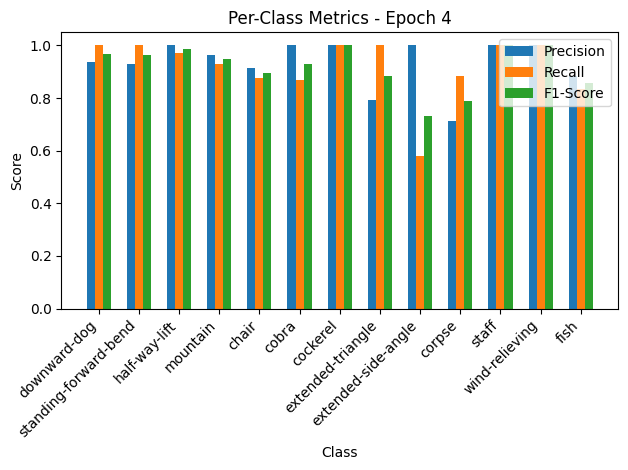


Epoch 5/50 Summary:
Train Loss: 0.3054 | Train Acc: 89.53% | Train Precision: 0.90 | Train Recall: 0.90 | Train F1: 0.89
Val Loss: 0.3677 | Val Acc: 93.29% | Val Precision: 0.94 | Val Recall: 0.93 | Val F1: 0.93

Epoch 6/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:07<00:00, 10.57it/s, loss=0.304, accuracy=91.2]


Per-Class Metrics for Epoch 5:
downward-dog: Precision=0.96, Recall=0.95, F1-Score=0.95
standing-forward-bend: Precision=0.91, Recall=0.88, F1-Score=0.89
half-way-lift: Precision=0.87, Recall=0.92, F1-Score=0.90
mountain: Precision=0.94, Recall=0.94, F1-Score=0.94
chair: Precision=0.96, Recall=0.96, F1-Score=0.96
cobra: Precision=0.95, Recall=0.96, F1-Score=0.95
cockerel: Precision=0.95, Recall=0.94, F1-Score=0.95
extended-triangle: Precision=0.87, Recall=0.82, F1-Score=0.84
extended-side-angle: Precision=0.80, Recall=0.86, F1-Score=0.83
corpse: Precision=0.81, Recall=0.81, F1-Score=0.81
staff: Precision=0.97, Recall=0.98, F1-Score=0.98
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.82, Recall=0.81, F1-Score=0.81


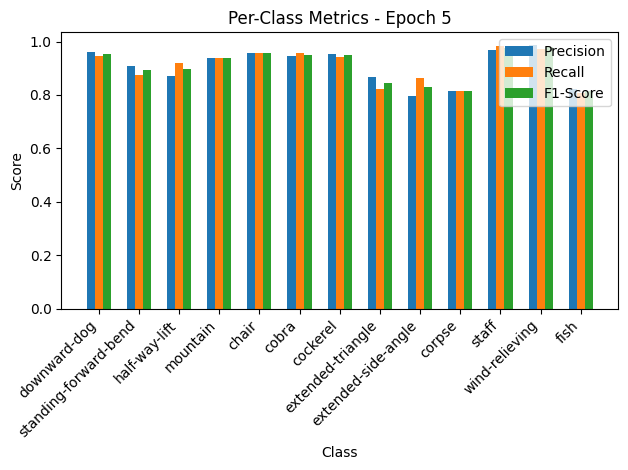

Validation: 100%|██████████| 21/21 [00:00<00:00, 35.19it/s, loss=0.194, accuracy=95.4]


Per-Class Metrics for Epoch 5:
downward-dog: Precision=0.98, Recall=0.93, F1-Score=0.96
standing-forward-bend: Precision=0.98, Recall=1.00, F1-Score=0.99
half-way-lift: Precision=1.00, Recall=0.97, F1-Score=0.99
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.92, Recall=0.96, F1-Score=0.94
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=0.90, Recall=1.00, F1-Score=0.95
corpse: Precision=0.76, Recall=0.94, F1-Score=0.84
staff: Precision=0.94, Recall=1.00, F1-Score=0.97
wind-relieving: Precision=0.94, Recall=1.00, F1-Score=0.97
fish: Precision=1.00, Recall=0.67, F1-Score=0.80


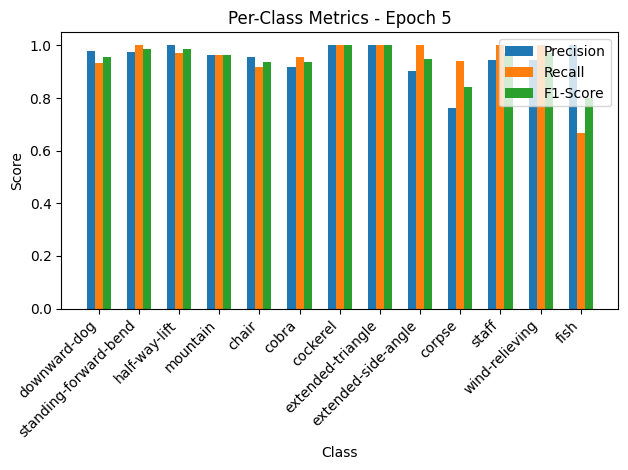


Epoch 6/50 Summary:
Train Loss: 0.3049 | Train Acc: 91.21% | Train Precision: 0.91 | Train Recall: 0.91 | Train F1: 0.91
Val Loss: 0.1992 | Val Acc: 95.43% | Val Precision: 0.96 | Val Recall: 0.95 | Val F1: 0.95
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model.pth
Checkpoint saved at epoch 6
New best model saved! Validation Loss: 0.1992

Epoch 7/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:06<00:00, 12.99it/s, loss=0.214, accuracy=93.4]


Per-Class Metrics for Epoch 6:
downward-dog: Precision=0.97, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.93, Recall=0.91, F1-Score=0.92
half-way-lift: Precision=0.94, Recall=0.93, F1-Score=0.93
mountain: Precision=0.94, Recall=0.93, F1-Score=0.93
chair: Precision=0.94, Recall=0.95, F1-Score=0.94
cobra: Precision=0.94, Recall=0.99, F1-Score=0.96
cockerel: Precision=0.95, Recall=0.97, F1-Score=0.96
extended-triangle: Precision=0.92, Recall=0.91, F1-Score=0.92
extended-side-angle: Precision=0.95, Recall=0.96, F1-Score=0.95
corpse: Precision=0.84, Recall=0.84, F1-Score=0.84
staff: Precision=0.96, Recall=0.98, F1-Score=0.97
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.85, Recall=0.84, F1-Score=0.84


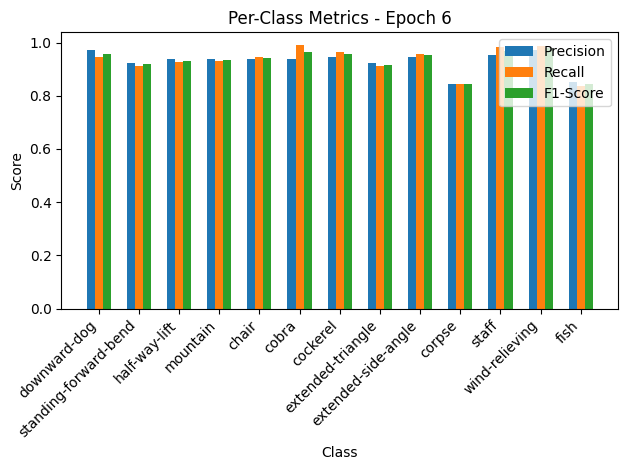

Validation: 100%|██████████| 21/21 [00:00<00:00, 26.52it/s, loss=0.216, accuracy=96]


Per-Class Metrics for Epoch 6:
downward-dog: Precision=0.94, Recall=0.98, F1-Score=0.96
standing-forward-bend: Precision=0.98, Recall=1.00, F1-Score=0.99
half-way-lift: Precision=1.00, Recall=0.97, F1-Score=0.99
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.92, Recall=0.92, F1-Score=0.92
cobra: Precision=1.00, Recall=0.91, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=0.95, F1-Score=0.97
corpse: Precision=0.87, Recall=0.76, F1-Score=0.81
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.81, Recall=0.94, F1-Score=0.87


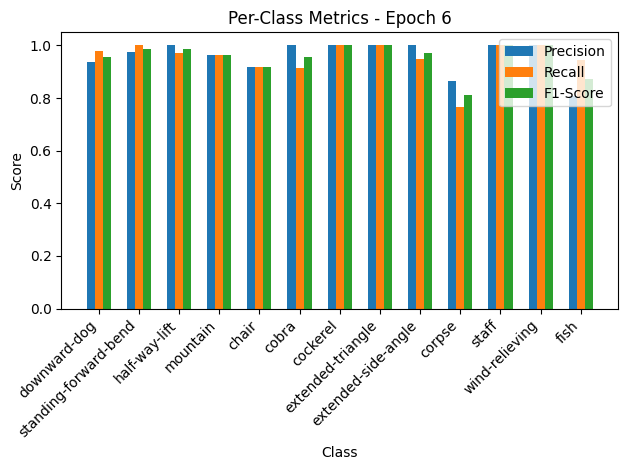


Epoch 7/50 Summary:
Train Loss: 0.2141 | Train Acc: 93.43% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.2214 | Val Acc: 96.04% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 8/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:07<00:00, 10.52it/s, loss=0.189, accuracy=93.8]


Per-Class Metrics for Epoch 7:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.93, Recall=0.90, F1-Score=0.92
half-way-lift: Precision=0.93, Recall=0.93, F1-Score=0.93
mountain: Precision=0.96, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.96, F1-Score=0.96
cobra: Precision=0.96, Recall=0.95, F1-Score=0.95
cockerel: Precision=0.98, Recall=0.96, F1-Score=0.97
extended-triangle: Precision=0.91, Recall=0.92, F1-Score=0.92
extended-side-angle: Precision=0.88, Recall=0.89, F1-Score=0.88
corpse: Precision=0.87, Recall=0.86, F1-Score=0.86
staff: Precision=0.93, Recall=0.97, F1-Score=0.95
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.87, Recall=0.87, F1-Score=0.87


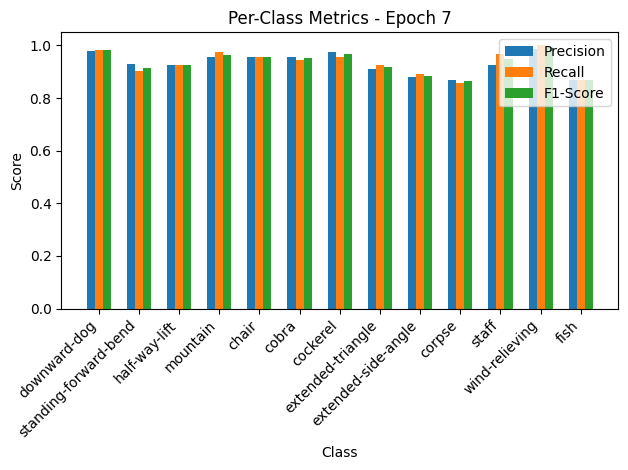

Validation: 100%|██████████| 21/21 [00:00<00:00, 32.68it/s, loss=0.24, accuracy=95.1]


Per-Class Metrics for Epoch 7:
downward-dog: Precision=0.92, Recall=0.98, F1-Score=0.95
standing-forward-bend: Precision=1.00, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.95, Recall=1.00, F1-Score=0.97
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.95, Recall=0.91, F1-Score=0.93
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.95, Recall=1.00, F1-Score=0.97
extended-side-angle: Precision=1.00, Recall=0.89, F1-Score=0.94
corpse: Precision=0.93, Recall=0.76, F1-Score=0.84
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.94, Recall=1.00, F1-Score=0.97
fish: Precision=0.80, Recall=0.89, F1-Score=0.84


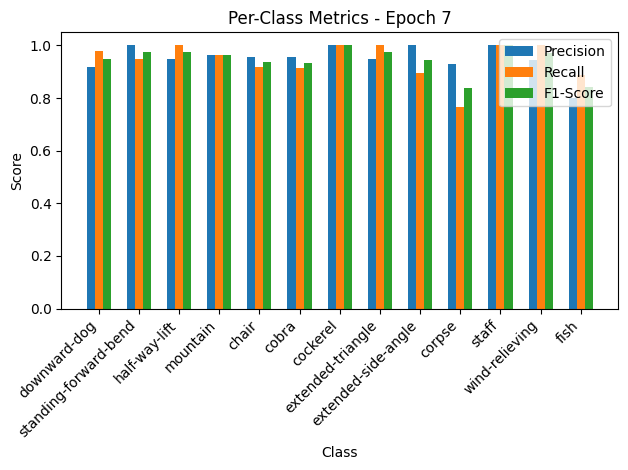


Epoch 8/50 Summary:
Train Loss: 0.1896 | Train Acc: 93.81% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.2463 | Val Acc: 95.12% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 9/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:07<00:00, 11.51it/s, loss=0.233, accuracy=92.7]


Per-Class Metrics for Epoch 8:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.90, Recall=0.91, F1-Score=0.90
half-way-lift: Precision=0.92, Recall=0.91, F1-Score=0.92
mountain: Precision=0.92, Recall=0.90, F1-Score=0.91
chair: Precision=0.96, Recall=0.96, F1-Score=0.96
cobra: Precision=0.95, Recall=0.95, F1-Score=0.95
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.92, Recall=0.96, F1-Score=0.94
extended-side-angle: Precision=0.92, Recall=0.92, F1-Score=0.92
corpse: Precision=0.86, Recall=0.79, F1-Score=0.82
staff: Precision=0.93, Recall=0.95, F1-Score=0.94
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.81, Recall=0.85, F1-Score=0.83


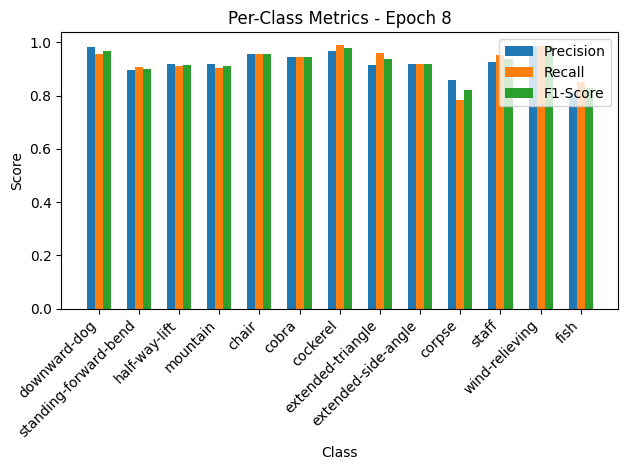

Validation: 100%|██████████| 21/21 [00:00<00:00, 24.52it/s, loss=0.221, accuracy=95.4]


Per-Class Metrics for Epoch 8:
downward-dog: Precision=0.94, Recall=1.00, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.97, F1-Score=0.97
half-way-lift: Precision=1.00, Recall=0.97, F1-Score=0.99
mountain: Precision=0.93, Recall=0.93, F1-Score=0.93
chair: Precision=0.92, Recall=0.92, F1-Score=0.92
cobra: Precision=1.00, Recall=0.96, F1-Score=0.98
cockerel: Precision=1.00, Recall=0.95, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=0.95, F1-Score=0.97
corpse: Precision=0.92, Recall=0.71, F1-Score=0.80
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.94, Recall=1.00, F1-Score=0.97
fish: Precision=0.77, Recall=0.94, F1-Score=0.85


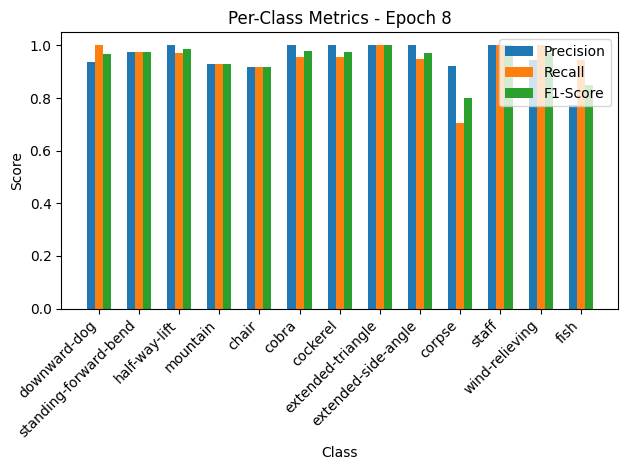


Epoch 9/50 Summary:
Train Loss: 0.2335 | Train Acc: 92.74% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.2268 | Val Acc: 95.43% | Val Precision: 0.96 | Val Recall: 0.95 | Val F1: 0.95

Epoch 10/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:07<00:00, 11.50it/s, loss=0.143, accuracy=95.8]


Per-Class Metrics for Epoch 9:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.95, Recall=0.90, F1-Score=0.92
half-way-lift: Precision=0.92, Recall=0.93, F1-Score=0.93
mountain: Precision=0.96, Recall=0.99, F1-Score=0.97
chair: Precision=0.97, Recall=0.97, F1-Score=0.97
cobra: Precision=0.98, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.96, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=0.97, Recall=0.95, F1-Score=0.96
extended-side-angle: Precision=0.95, Recall=0.97, F1-Score=0.96
corpse: Precision=0.98, Recall=0.86, F1-Score=0.92
staff: Precision=0.98, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.87, Recall=0.99, F1-Score=0.92


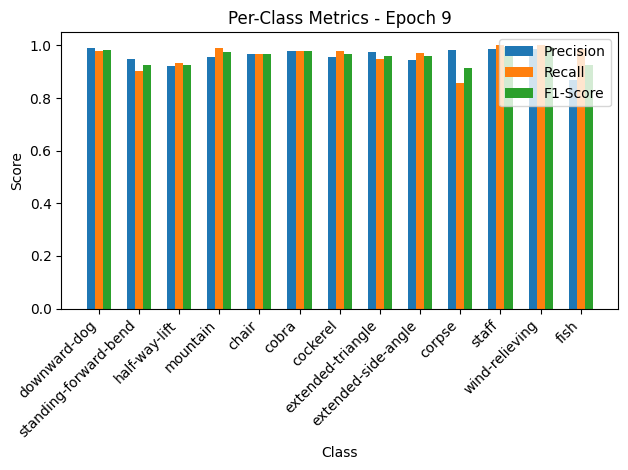

Validation: 100%|██████████| 21/21 [00:00<00:00, 31.95it/s, loss=0.238, accuracy=95.7]


Per-Class Metrics for Epoch 9:
downward-dog: Precision=0.98, Recall=0.91, F1-Score=0.94
standing-forward-bend: Precision=0.95, Recall=1.00, F1-Score=0.98
half-way-lift: Precision=1.00, Recall=0.97, F1-Score=0.99
mountain: Precision=1.00, Recall=0.93, F1-Score=0.96
chair: Precision=0.88, Recall=0.96, F1-Score=0.92
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.92, Recall=0.71, F1-Score=0.80
staff: Precision=0.94, Recall=1.00, F1-Score=0.97
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.77, Recall=0.94, F1-Score=0.85


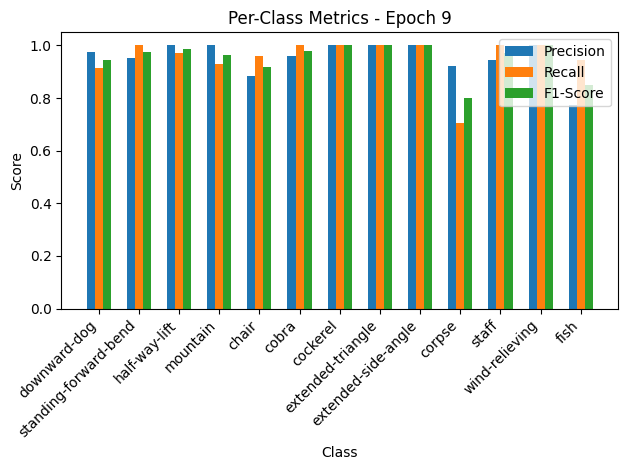


Epoch 10/50 Summary:
Train Loss: 0.1434 | Train Acc: 95.80% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.2443 | Val Acc: 95.73% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 11/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00, 10.20it/s, loss=0.17, accuracy=95.1]


Per-Class Metrics for Epoch 10:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.93, Recall=0.96, F1-Score=0.94
mountain: Precision=0.94, Recall=0.97, F1-Score=0.96
chair: Precision=0.99, Recall=0.98, F1-Score=0.98
cobra: Precision=0.95, Recall=0.99, F1-Score=0.97
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.97, Recall=0.94, F1-Score=0.95
extended-side-angle: Precision=0.93, Recall=0.96, F1-Score=0.95
corpse: Precision=0.85, Recall=0.83, F1-Score=0.84
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.83, Recall=0.87, F1-Score=0.85


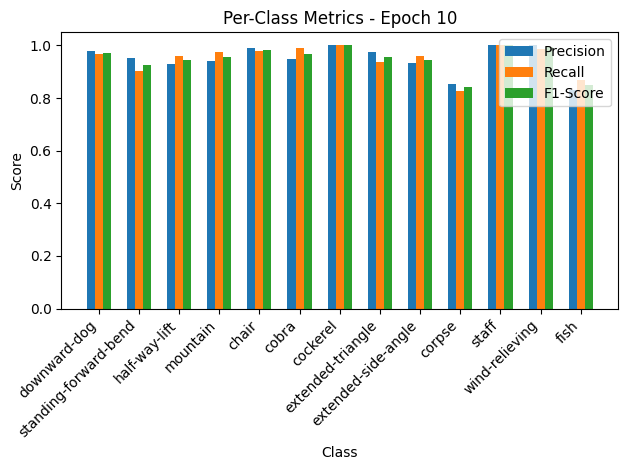

Validation: 100%|██████████| 21/21 [00:00<00:00, 32.73it/s, loss=0.252, accuracy=96.6]


Per-Class Metrics for Epoch 10:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=1.00, F1-Score=0.98
half-way-lift: Precision=1.00, Recall=1.00, F1-Score=1.00
mountain: Precision=1.00, Recall=0.97, F1-Score=0.98
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=1.00, Recall=0.96, F1-Score=0.98
cockerel: Precision=0.88, Recall=1.00, F1-Score=0.94
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.94, Recall=0.88, F1-Score=0.91
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.94, Recall=0.94, F1-Score=0.94
fish: Precision=0.89, Recall=0.89, F1-Score=0.89


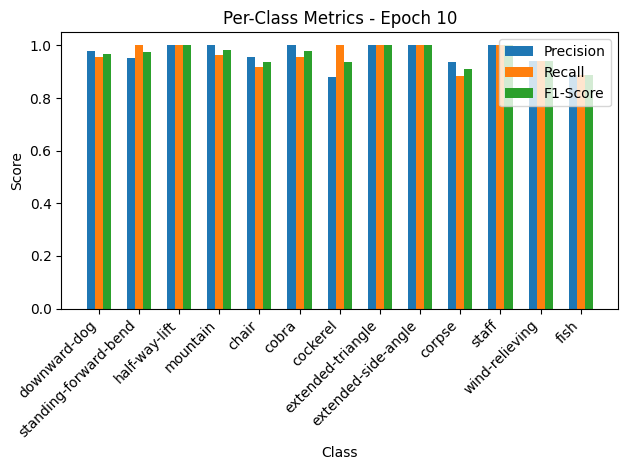


Epoch 11/50 Summary:
Train Loss: 0.1700 | Train Acc: 95.11% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.2578 | Val Acc: 96.65% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 12/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:06<00:00, 12.28it/s, loss=0.0917, accuracy=96.9]


Per-Class Metrics for Epoch 11:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.96, Recall=0.96, F1-Score=0.96
half-way-lift: Precision=0.96, Recall=0.96, F1-Score=0.96
mountain: Precision=0.97, Recall=0.98, F1-Score=0.97
chair: Precision=0.97, Recall=0.96, F1-Score=0.96
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.96, F1-Score=0.95
corpse: Precision=0.92, Recall=0.93, F1-Score=0.92
staff: Precision=0.98, Recall=0.97, F1-Score=0.98
wind-relieving: Precision=0.97, Recall=1.00, F1-Score=0.99
fish: Precision=0.95, Recall=0.88, F1-Score=0.92


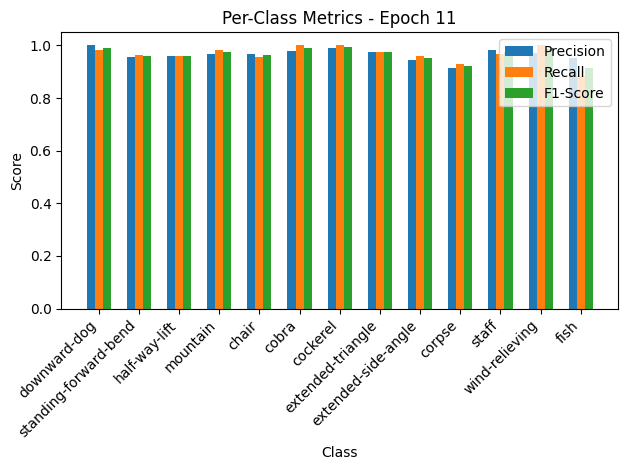

Validation: 100%|██████████| 21/21 [00:00<00:00, 31.30it/s, loss=0.217, accuracy=96.6]


Per-Class Metrics for Epoch 11:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.98, Recall=1.00, F1-Score=0.99
half-way-lift: Precision=1.00, Recall=1.00, F1-Score=1.00
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.93, Recall=0.76, F1-Score=0.84
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.94, Recall=1.00, F1-Score=0.97
fish: Precision=0.80, Recall=0.89, F1-Score=0.84


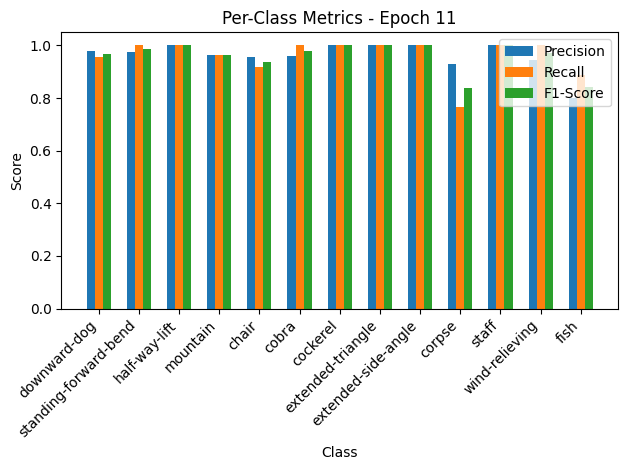


Epoch 12/50 Summary:
Train Loss: 0.0919 | Train Acc: 96.87% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.2220 | Val Acc: 96.65% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 13/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.91it/s, loss=0.0824, accuracy=96.9]


Per-Class Metrics for Epoch 12:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.93, F1-Score=0.95
half-way-lift: Precision=0.96, Recall=0.97, F1-Score=0.97
mountain: Precision=0.96, Recall=0.97, F1-Score=0.97
chair: Precision=0.98, Recall=0.98, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.94, Recall=0.99, F1-Score=0.96
extended-side-angle: Precision=1.00, Recall=0.93, F1-Score=0.96
corpse: Precision=0.91, Recall=0.90, F1-Score=0.91
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.90, Recall=0.91, F1-Score=0.91


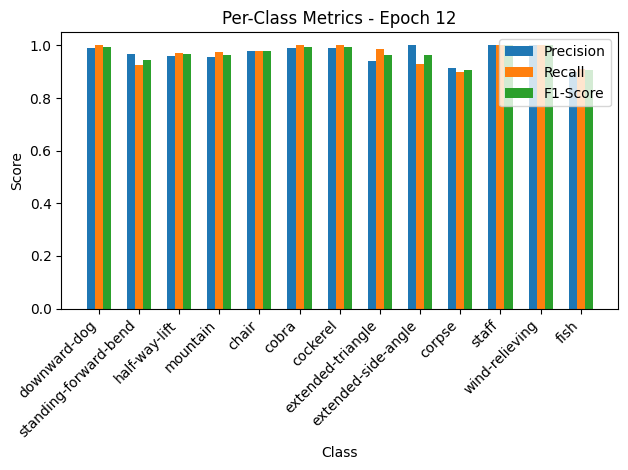

Validation: 100%|██████████| 21/21 [00:00<00:00, 30.70it/s, loss=0.194, accuracy=96.6]


Per-Class Metrics for Epoch 12:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.98, Recall=1.00, F1-Score=0.99
half-way-lift: Precision=1.00, Recall=1.00, F1-Score=1.00
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.87, Recall=0.76, F1-Score=0.81
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.80, Recall=0.89, F1-Score=0.84


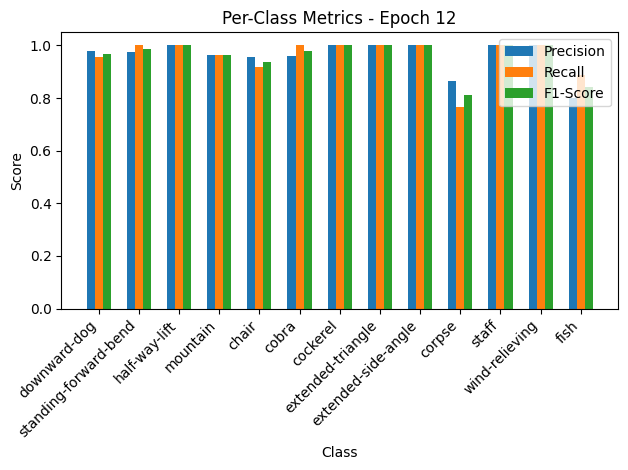


Epoch 13/50 Summary:
Train Loss: 0.0826 | Train Acc: 96.94% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.1987 | Val Acc: 96.65% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model.pth
Checkpoint saved at epoch 13
New best model saved! Validation Loss: 0.1987

Epoch 14/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:07<00:00, 11.42it/s, loss=0.0822, accuracy=97.2]


Per-Class Metrics for Epoch 13:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.94, F1-Score=0.95
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=0.98, Recall=0.98, F1-Score=0.98
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.95, Recall=0.90, F1-Score=0.93
staff: Precision=0.98, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.90, Recall=0.94, F1-Score=0.92


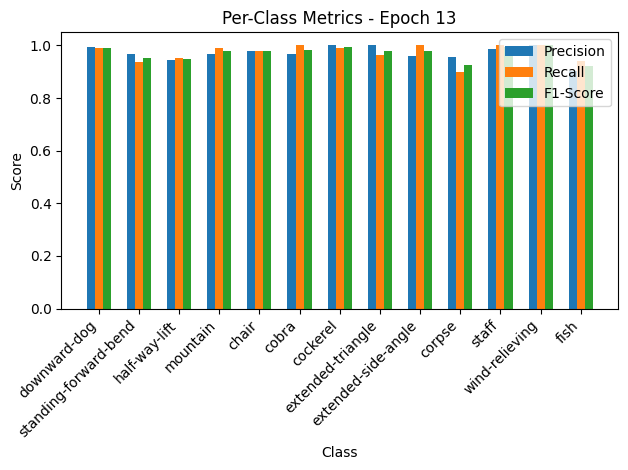

Validation: 100%|██████████| 21/21 [00:00<00:00, 28.65it/s, loss=0.196, accuracy=96]


Per-Class Metrics for Epoch 13:
downward-dog: Precision=0.94, Recall=0.96, F1-Score=0.95
standing-forward-bend: Precision=0.98, Recall=1.00, F1-Score=0.99
half-way-lift: Precision=1.00, Recall=1.00, F1-Score=1.00
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.95, Recall=0.87, F1-Score=0.91
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.88, Recall=0.82, F1-Score=0.85
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.84, Recall=0.89, F1-Score=0.86


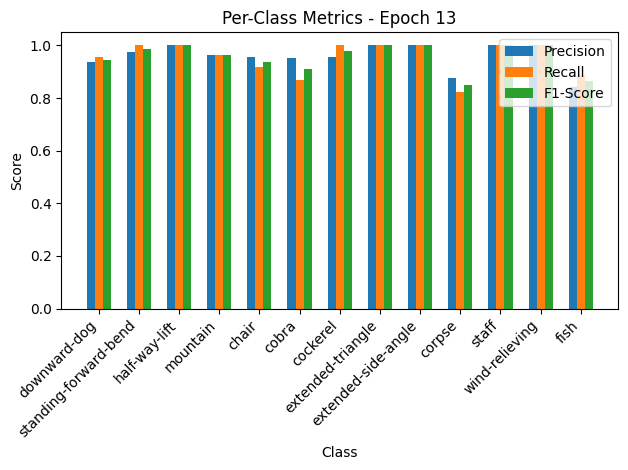


Epoch 14/50 Summary:
Train Loss: 0.0824 | Train Acc: 97.17% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.2003 | Val Acc: 96.04% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 15/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:07<00:00, 10.62it/s, loss=0.0624, accuracy=98.1]


Per-Class Metrics for Epoch 14:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.95, Recall=0.99, F1-Score=0.97
mountain: Precision=0.97, Recall=0.98, F1-Score=0.97
chair: Precision=0.99, Recall=0.99, F1-Score=0.99
cobra: Precision=0.99, Recall=0.99, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-side-angle: Precision=0.99, Recall=0.97, F1-Score=0.98
corpse: Precision=0.97, Recall=0.94, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.97, F1-Score=0.96


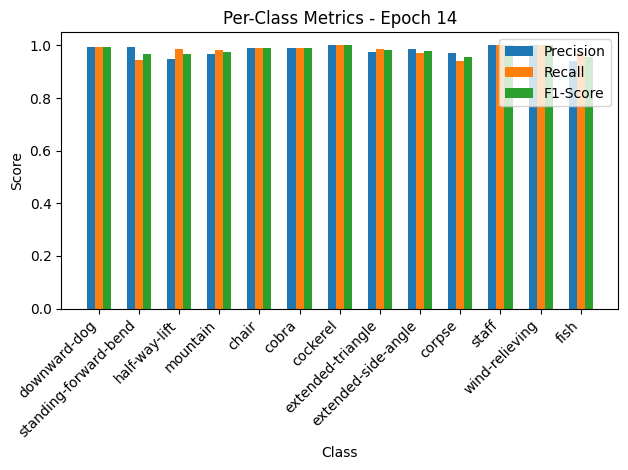

Validation: 100%|██████████| 21/21 [00:00<00:00, 31.64it/s, loss=0.207, accuracy=96.6]


Per-Class Metrics for Epoch 14:
downward-dog: Precision=0.94, Recall=0.98, F1-Score=0.96
standing-forward-bend: Precision=1.00, Recall=1.00, F1-Score=1.00
half-way-lift: Precision=1.00, Recall=1.00, F1-Score=1.00
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.95, Recall=0.91, F1-Score=0.93
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.93, Recall=0.76, F1-Score=0.84
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.81, Recall=0.94, F1-Score=0.87


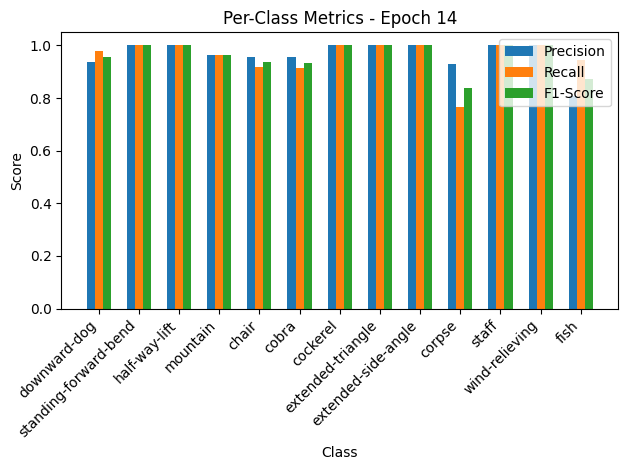


Epoch 15/50 Summary:
Train Loss: 0.0625 | Train Acc: 98.09% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.2124 | Val Acc: 96.65% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 16/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.27it/s, loss=0.058, accuracy=98.1]


Per-Class Metrics for Epoch 15:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.98, Recall=0.97, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.97, F1-Score=0.97
mountain: Precision=0.97, Recall=0.98, F1-Score=0.98
chair: Precision=0.99, Recall=0.97, F1-Score=0.98
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.97, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.97, F1-Score=0.97
corpse: Precision=0.99, Recall=0.94, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.99, F1-Score=0.96


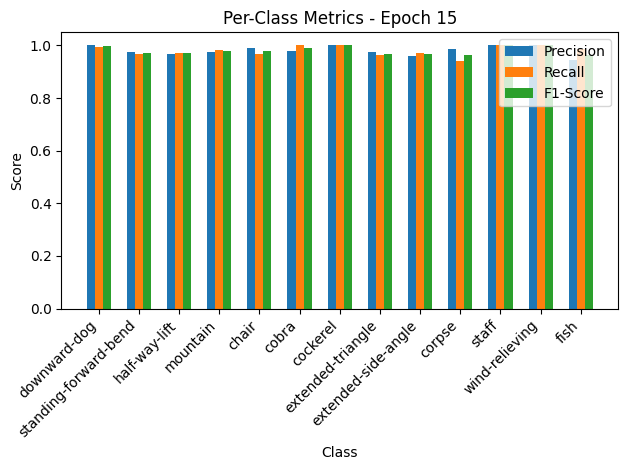

Validation: 100%|██████████| 21/21 [00:00<00:00, 31.06it/s, loss=0.203, accuracy=96.3]


Per-Class Metrics for Epoch 15:
downward-dog: Precision=0.94, Recall=0.98, F1-Score=0.96
standing-forward-bend: Precision=1.00, Recall=1.00, F1-Score=1.00
half-way-lift: Precision=1.00, Recall=1.00, F1-Score=1.00
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.95, Recall=0.87, F1-Score=0.91
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.88, Recall=0.82, F1-Score=0.85
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.84, Recall=0.89, F1-Score=0.86


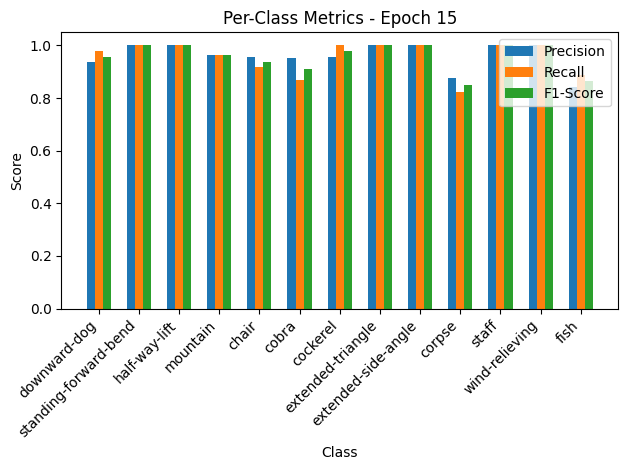


Epoch 16/50 Summary:
Train Loss: 0.0581 | Train Acc: 98.09% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.2075 | Val Acc: 96.34% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 17/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:07<00:00, 11.59it/s, loss=0.0661, accuracy=97.9]


Per-Class Metrics for Epoch 16:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.95, Recall=0.98, F1-Score=0.97
mountain: Precision=0.95, Recall=0.99, F1-Score=0.97
chair: Precision=0.99, Recall=0.96, F1-Score=0.97
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.97, Recall=0.97, F1-Score=0.97
corpse: Precision=0.98, Recall=0.93, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.99, F1-Score=0.96


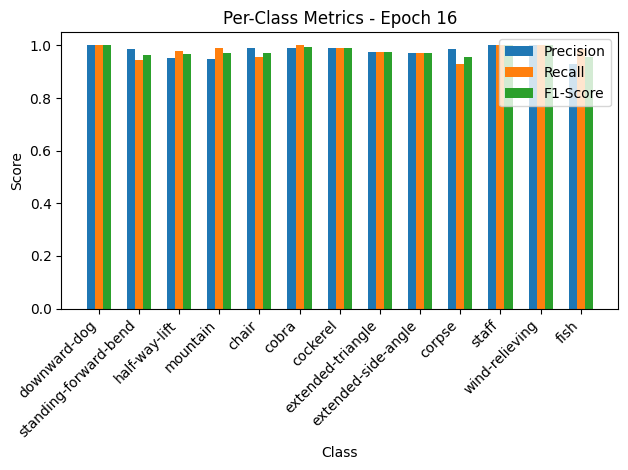

Validation: 100%|██████████| 21/21 [00:00<00:00, 30.55it/s, loss=0.181, accuracy=96.6]


Per-Class Metrics for Epoch 16:
downward-dog: Precision=0.94, Recall=0.98, F1-Score=0.96
standing-forward-bend: Precision=1.00, Recall=1.00, F1-Score=1.00
half-way-lift: Precision=1.00, Recall=1.00, F1-Score=1.00
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.95, Recall=0.91, F1-Score=0.93
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.88, Recall=0.82, F1-Score=0.85
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.84, Recall=0.89, F1-Score=0.86


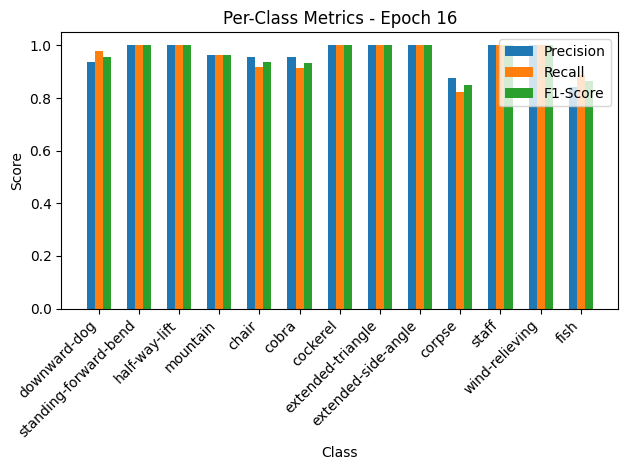


Epoch 17/50 Summary:
Train Loss: 0.0662 | Train Acc: 97.86% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1855 | Val Acc: 96.65% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model.pth
Checkpoint saved at epoch 17
New best model saved! Validation Loss: 0.1855

Epoch 18/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.36it/s, loss=0.0535, accuracy=98.2]


Per-Class Metrics for Epoch 17:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.98, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.96, Recall=0.98, F1-Score=0.97
mountain: Precision=0.97, Recall=0.98, F1-Score=0.98
chair: Precision=0.99, Recall=0.98, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=0.94, Recall=0.96, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.96, Recall=0.94, F1-Score=0.95


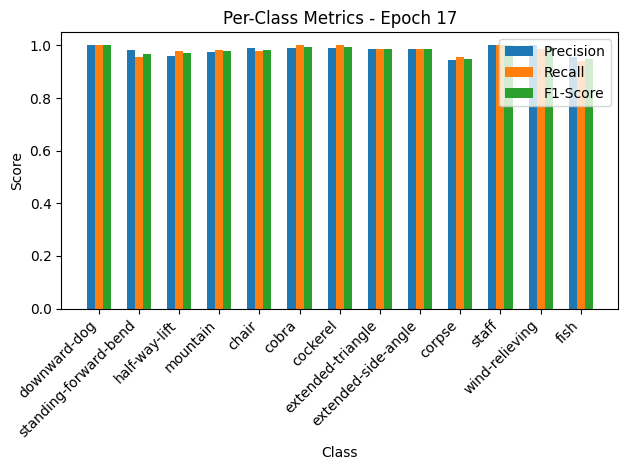

Validation: 100%|██████████| 21/21 [00:00<00:00, 27.89it/s, loss=0.242, accuracy=96.6]


Per-Class Metrics for Epoch 17:
downward-dog: Precision=0.94, Recall=0.98, F1-Score=0.96
standing-forward-bend: Precision=1.00, Recall=1.00, F1-Score=1.00
half-way-lift: Precision=1.00, Recall=1.00, F1-Score=1.00
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.95, Recall=0.91, F1-Score=0.93
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.88, Recall=0.82, F1-Score=0.85
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.84, Recall=0.89, F1-Score=0.86


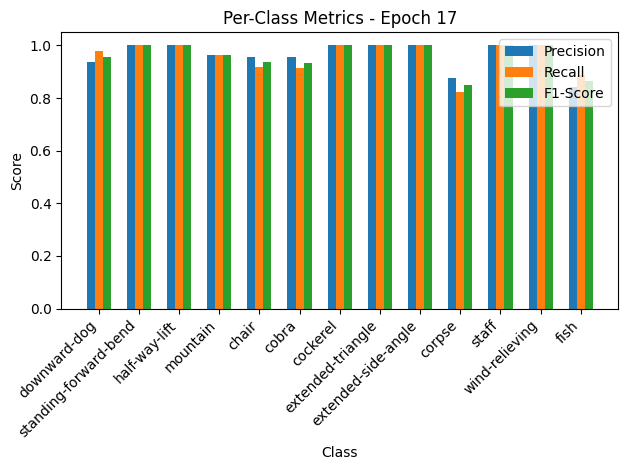


Epoch 18/50 Summary:
Train Loss: 0.0536 | Train Acc: 98.17% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.2474 | Val Acc: 96.65% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 19/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:07<00:00, 10.84it/s, loss=0.0608, accuracy=98]


Per-Class Metrics for Epoch 18:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.95, Recall=0.97, F1-Score=0.96
mountain: Precision=0.98, Recall=0.99, F1-Score=0.99
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.94, Recall=0.93, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.94, F1-Score=0.93


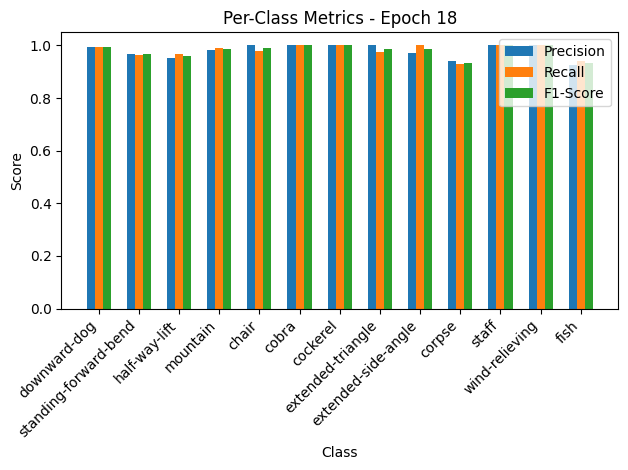

Validation: 100%|██████████| 21/21 [00:00<00:00, 28.09it/s, loss=0.227, accuracy=96]


Per-Class Metrics for Epoch 18:
downward-dog: Precision=0.94, Recall=0.96, F1-Score=0.95
standing-forward-bend: Precision=0.95, Recall=1.00, F1-Score=0.98
half-way-lift: Precision=1.00, Recall=1.00, F1-Score=1.00
mountain: Precision=1.00, Recall=0.97, F1-Score=0.98
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.95, Recall=0.87, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.82, Recall=0.82, F1-Score=0.82
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.84, Recall=0.89, F1-Score=0.86


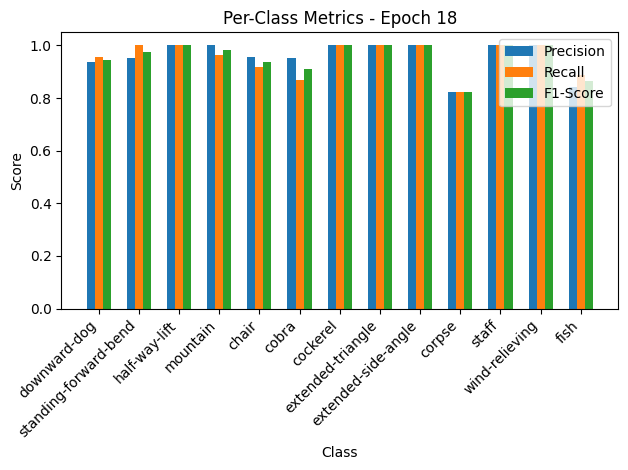


Epoch 19/50 Summary:
Train Loss: 0.0609 | Train Acc: 98.01% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.2327 | Val Acc: 96.04% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 20/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:07<00:00, 10.50it/s, loss=0.0486, accuracy=98.5]


Per-Class Metrics for Epoch 19:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.95, Recall=0.97, F1-Score=0.96
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=0.99, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=1.00, Recall=0.97, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=1.00, F1-Score=0.99


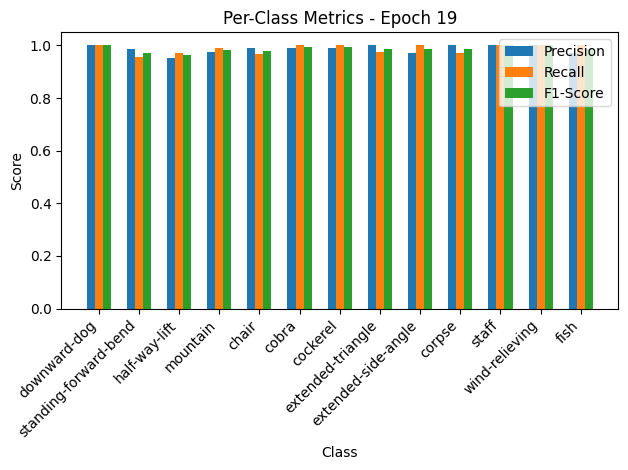

Validation: 100%|██████████| 21/21 [00:00<00:00, 30.27it/s, loss=0.225, accuracy=96.6]


Per-Class Metrics for Epoch 19:
downward-dog: Precision=0.94, Recall=0.98, F1-Score=0.96
standing-forward-bend: Precision=1.00, Recall=1.00, F1-Score=1.00
half-way-lift: Precision=1.00, Recall=1.00, F1-Score=1.00
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.95, Recall=0.91, F1-Score=0.93
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.88, Recall=0.82, F1-Score=0.85
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.84, Recall=0.89, F1-Score=0.86


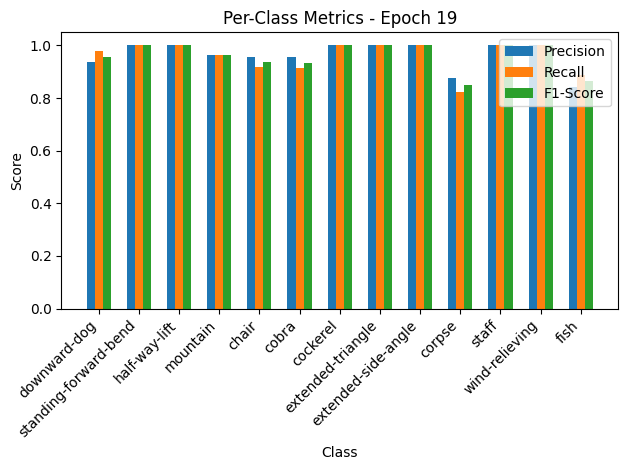


Epoch 20/50 Summary:
Train Loss: 0.0487 | Train Acc: 98.55% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2301 | Val Acc: 96.65% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 21/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.21it/s, loss=0.0511, accuracy=98.7]


Per-Class Metrics for Epoch 20:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=0.99, Recall=1.00, F1-Score=0.99
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=0.99, Recall=0.96, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.96, Recall=0.99, F1-Score=0.97


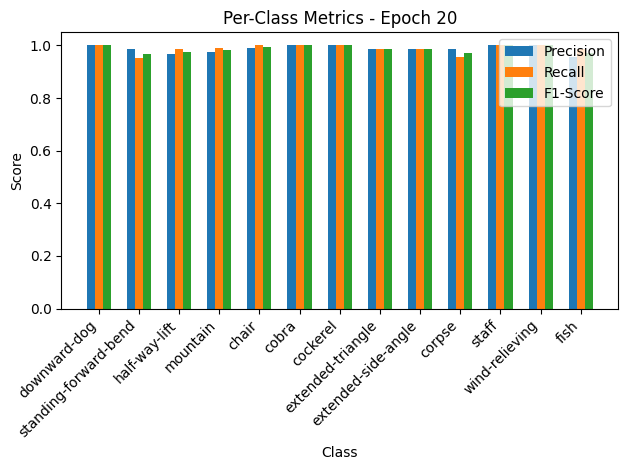

Validation: 100%|██████████| 21/21 [00:00<00:00, 30.05it/s, loss=0.245, accuracy=96.3]


Per-Class Metrics for Epoch 20:
downward-dog: Precision=0.94, Recall=0.98, F1-Score=0.96
standing-forward-bend: Precision=1.00, Recall=1.00, F1-Score=1.00
half-way-lift: Precision=1.00, Recall=1.00, F1-Score=1.00
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.95, Recall=0.87, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.82, Recall=0.82, F1-Score=0.82
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.84, Recall=0.89, F1-Score=0.86


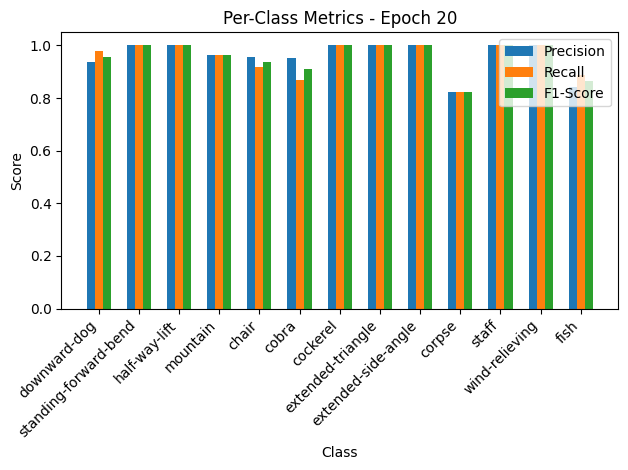


Epoch 21/50 Summary:
Train Loss: 0.0512 | Train Acc: 98.70% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2505 | Val Acc: 96.34% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 22/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:07<00:00, 11.20it/s, loss=0.0456, accuracy=98.6]


Per-Class Metrics for Epoch 21:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=1.00, F1-Score=0.98
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=0.99, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.94, Recall=0.97, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.94, F1-Score=0.96


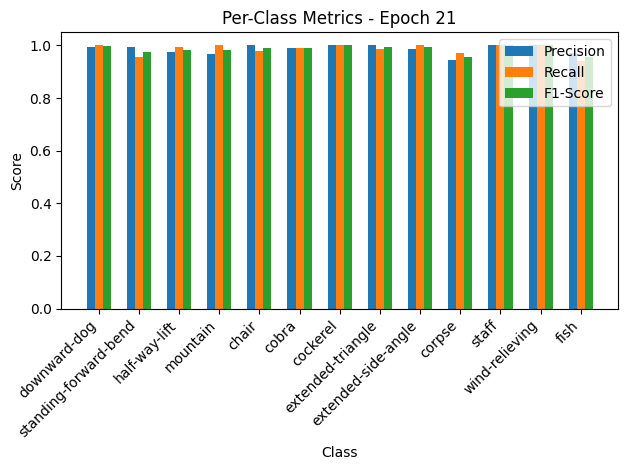

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.03it/s, loss=0.215, accuracy=97]


Per-Class Metrics for Epoch 21:
downward-dog: Precision=0.94, Recall=0.98, F1-Score=0.96
standing-forward-bend: Precision=0.98, Recall=1.00, F1-Score=0.99
half-way-lift: Precision=1.00, Recall=1.00, F1-Score=1.00
mountain: Precision=1.00, Recall=0.97, F1-Score=0.98
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.95, Recall=0.91, F1-Score=0.93
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.88, Recall=0.88, F1-Score=0.88
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.89, Recall=0.89, F1-Score=0.89


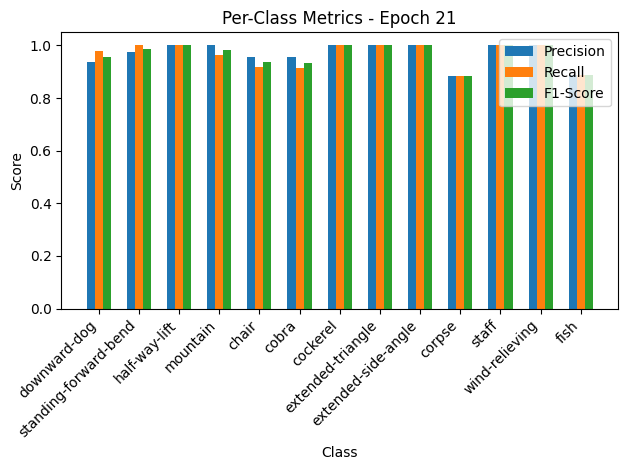


Epoch 22/50 Summary:
Train Loss: 0.0457 | Train Acc: 98.62% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2197 | Val Acc: 96.95% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 23/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:09<00:00,  8.26it/s, loss=0.0599, accuracy=98.1]


Per-Class Metrics for Epoch 22:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.97, Recall=0.97, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.97, F1-Score=0.97
mountain: Precision=0.99, Recall=0.98, F1-Score=0.99
chair: Precision=0.99, Recall=0.98, F1-Score=0.98
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.91, F1-Score=0.94
staff: Precision=1.00, Recall=0.98, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.92, Recall=0.99, F1-Score=0.95


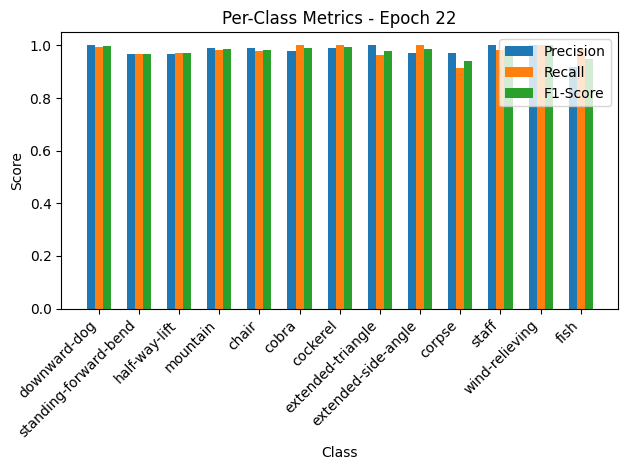

Validation: 100%|██████████| 21/21 [00:00<00:00, 25.61it/s, loss=0.206, accuracy=96.3]


Per-Class Metrics for Epoch 22:
downward-dog: Precision=0.94, Recall=0.98, F1-Score=0.96
standing-forward-bend: Precision=1.00, Recall=1.00, F1-Score=1.00
half-way-lift: Precision=1.00, Recall=1.00, F1-Score=1.00
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.95, Recall=0.87, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.82, Recall=0.82, F1-Score=0.82
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.84, Recall=0.89, F1-Score=0.86


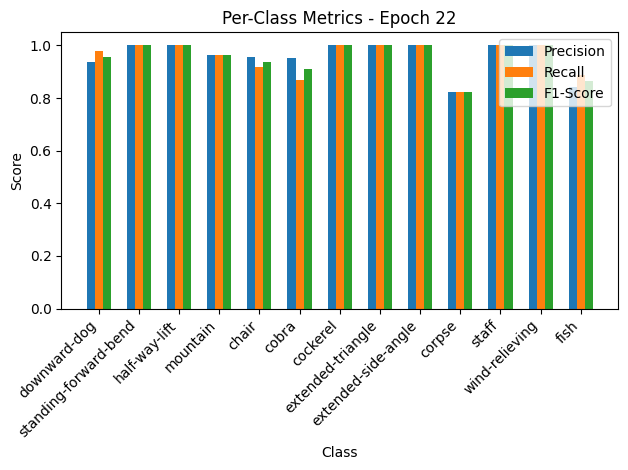


Epoch 23/50 Summary:
Train Loss: 0.0600 | Train Acc: 98.09% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.2108 | Val Acc: 96.34% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 24/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:10<00:00,  7.97it/s, loss=0.0349, accuracy=98.8]


Per-Class Metrics for Epoch 23:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.98, Recall=0.99, F1-Score=0.99
chair: Precision=0.99, Recall=0.99, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.97, F1-Score=0.98
corpse: Precision=1.00, Recall=0.96, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.96, Recall=1.00, F1-Score=0.98


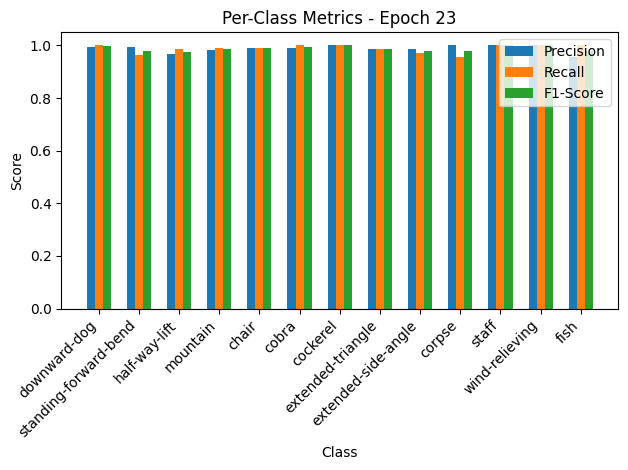

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.58it/s, loss=0.213, accuracy=96.3]


Per-Class Metrics for Epoch 23:
downward-dog: Precision=0.94, Recall=0.98, F1-Score=0.96
standing-forward-bend: Precision=1.00, Recall=1.00, F1-Score=1.00
half-way-lift: Precision=1.00, Recall=1.00, F1-Score=1.00
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.95, Recall=0.87, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.82, Recall=0.82, F1-Score=0.82
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.84, Recall=0.89, F1-Score=0.86


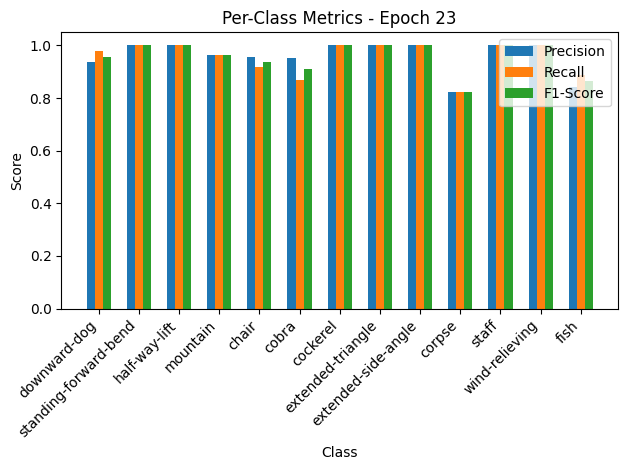


Epoch 24/50 Summary:
Train Loss: 0.0350 | Train Acc: 98.78% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2183 | Val Acc: 96.34% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 25/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:07<00:00, 10.78it/s, loss=0.0381, accuracy=98.6]


Per-Class Metrics for Epoch 24:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.98, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.96, Recall=0.98, F1-Score=0.97
mountain: Precision=0.99, Recall=0.99, F1-Score=0.99
chair: Precision=0.99, Recall=0.99, F1-Score=0.99
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.99, Recall=0.96, F1-Score=0.97
staff: Precision=0.98, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.96, Recall=0.97, F1-Score=0.96


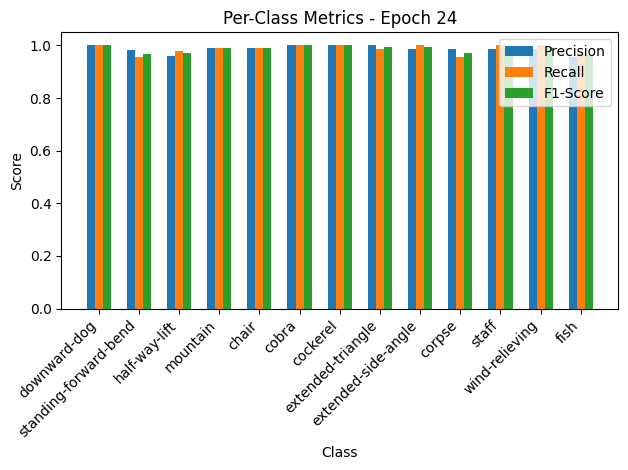

Validation: 100%|██████████| 21/21 [00:00<00:00, 28.87it/s, loss=0.216, accuracy=96.3]


Per-Class Metrics for Epoch 24:
downward-dog: Precision=0.94, Recall=0.98, F1-Score=0.96
standing-forward-bend: Precision=1.00, Recall=1.00, F1-Score=1.00
half-way-lift: Precision=1.00, Recall=1.00, F1-Score=1.00
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.95, Recall=0.87, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.82, Recall=0.82, F1-Score=0.82
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.84, Recall=0.89, F1-Score=0.86


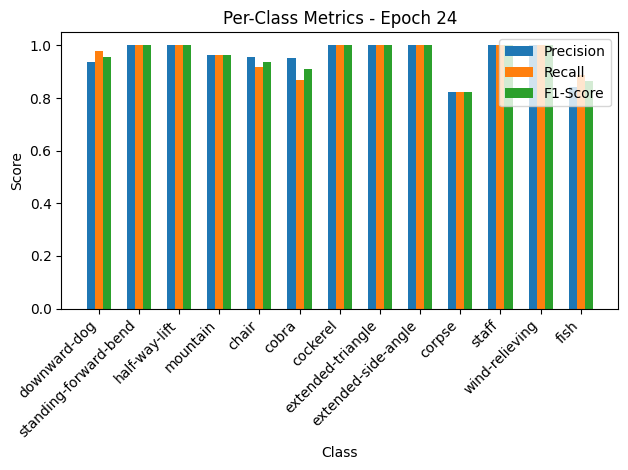


Epoch 25/50 Summary:
Train Loss: 0.0382 | Train Acc: 98.62% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2213 | Val Acc: 96.34% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 26/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:09<00:00,  8.62it/s, loss=0.0341, accuracy=98.6]


Per-Class Metrics for Epoch 25:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.97, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.98, F1-Score=0.98
mountain: Precision=0.97, Recall=0.98, F1-Score=0.98
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.99, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.99, Recall=0.97, F1-Score=0.98


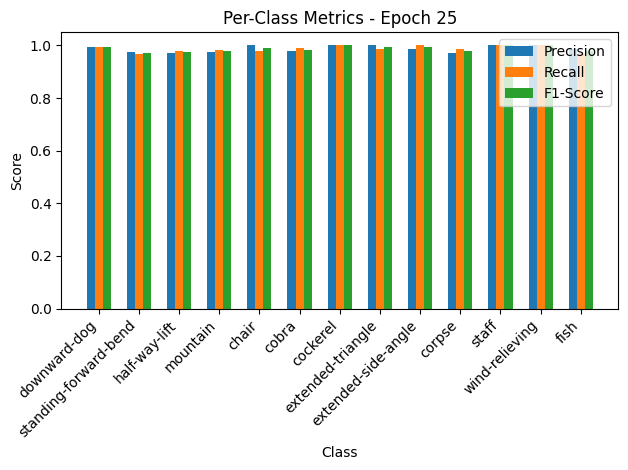

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.38it/s, loss=0.223, accuracy=96]


Per-Class Metrics for Epoch 25:
downward-dog: Precision=0.94, Recall=0.96, F1-Score=0.95
standing-forward-bend: Precision=0.98, Recall=1.00, F1-Score=0.99
half-way-lift: Precision=1.00, Recall=1.00, F1-Score=1.00
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.95, Recall=0.87, F1-Score=0.91
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.88, Recall=0.82, F1-Score=0.85
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.84, Recall=0.89, F1-Score=0.86


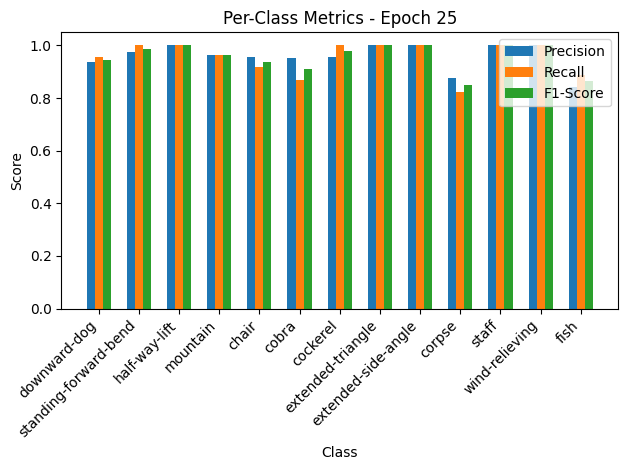


Epoch 26/50 Summary:
Train Loss: 0.0342 | Train Acc: 98.62% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2284 | Val Acc: 96.04% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 27/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:09<00:00,  8.31it/s, loss=0.053, accuracy=98.4]


Per-Class Metrics for Epoch 26:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.98, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.95, Recall=0.97, F1-Score=0.96
mountain: Precision=0.98, Recall=0.99, F1-Score=0.99
chair: Precision=0.99, Recall=0.97, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=0.99, Recall=0.94, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.99, F1-Score=0.96


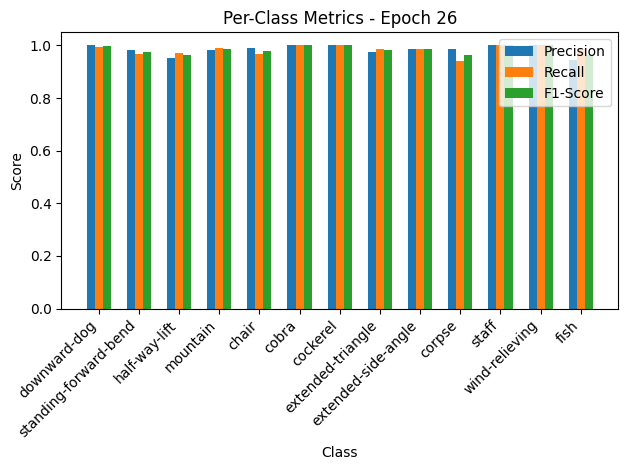

Validation: 100%|██████████| 21/21 [00:00<00:00, 30.56it/s, loss=0.217, accuracy=96.3]


Per-Class Metrics for Epoch 26:
downward-dog: Precision=0.94, Recall=0.98, F1-Score=0.96
standing-forward-bend: Precision=1.00, Recall=1.00, F1-Score=1.00
half-way-lift: Precision=1.00, Recall=1.00, F1-Score=1.00
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.95, Recall=0.87, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.82, Recall=0.82, F1-Score=0.82
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.84, Recall=0.89, F1-Score=0.86


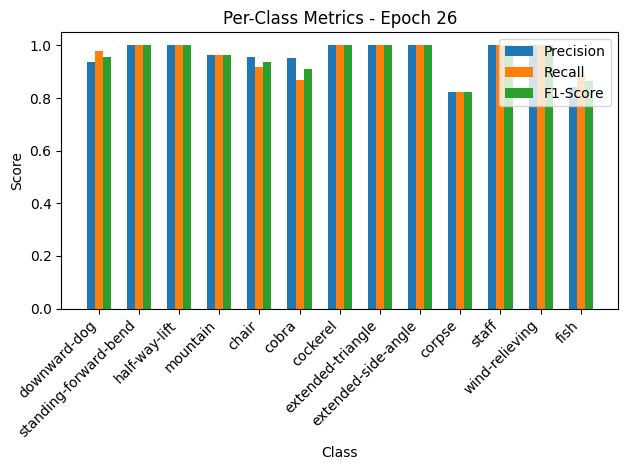


Epoch 27/50 Summary:
Train Loss: 0.0532 | Train Acc: 98.40% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.2223 | Val Acc: 96.34% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 28/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:07<00:00, 10.36it/s, loss=0.0328, accuracy=98.6]


Per-Class Metrics for Epoch 27:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.98, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.98, F1-Score=0.98
mountain: Precision=0.97, Recall=1.00, F1-Score=0.99
chair: Precision=0.99, Recall=0.98, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=0.99, Recall=0.96, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.96, Recall=0.99, F1-Score=0.97


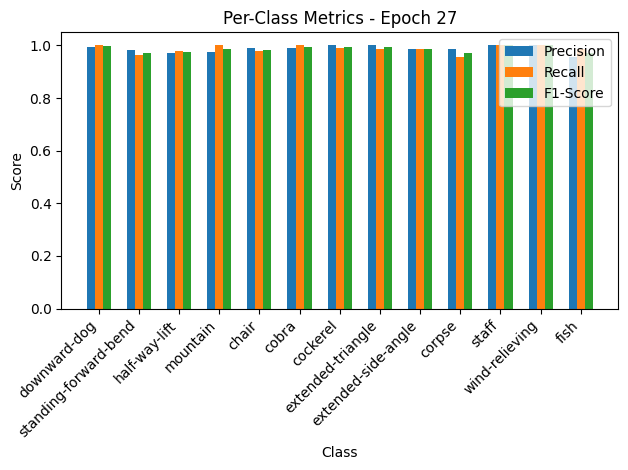

Validation: 100%|██████████| 21/21 [00:00<00:00, 28.38it/s, loss=0.217, accuracy=96.3]


Per-Class Metrics for Epoch 27:
downward-dog: Precision=0.94, Recall=0.98, F1-Score=0.96
standing-forward-bend: Precision=1.00, Recall=1.00, F1-Score=1.00
half-way-lift: Precision=1.00, Recall=1.00, F1-Score=1.00
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.95, Recall=0.87, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.82, Recall=0.82, F1-Score=0.82
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.84, Recall=0.89, F1-Score=0.86


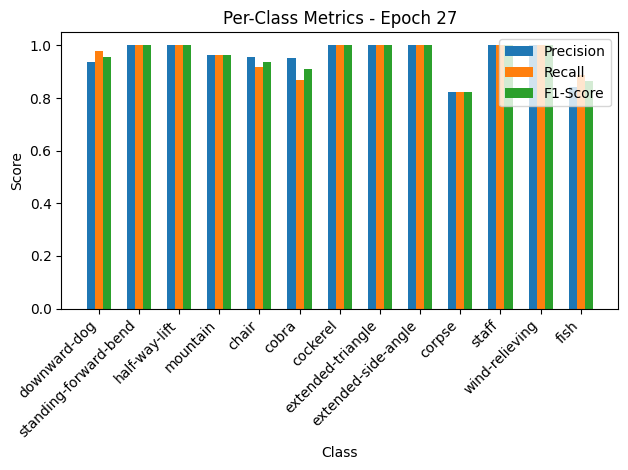


Epoch 28/50 Summary:
Train Loss: 0.0329 | Train Acc: 98.62% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2227 | Val Acc: 96.34% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 29/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:09<00:00,  8.53it/s, loss=0.0243, accuracy=98.9]


Per-Class Metrics for Epoch 28:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.98, Recall=0.97, F1-Score=0.97
half-way-lift: Precision=0.98, Recall=0.97, F1-Score=0.98
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.99, F1-Score=0.99
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=1.00, Recall=0.97, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=1.00, F1-Score=0.99


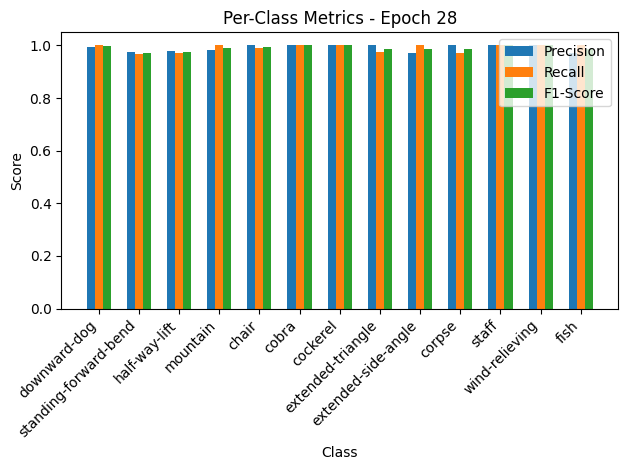

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.65it/s, loss=0.222, accuracy=96.3]


Per-Class Metrics for Epoch 28:
downward-dog: Precision=0.94, Recall=0.98, F1-Score=0.96
standing-forward-bend: Precision=1.00, Recall=1.00, F1-Score=1.00
half-way-lift: Precision=1.00, Recall=1.00, F1-Score=1.00
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.95, Recall=0.87, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.82, Recall=0.82, F1-Score=0.82
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.84, Recall=0.89, F1-Score=0.86


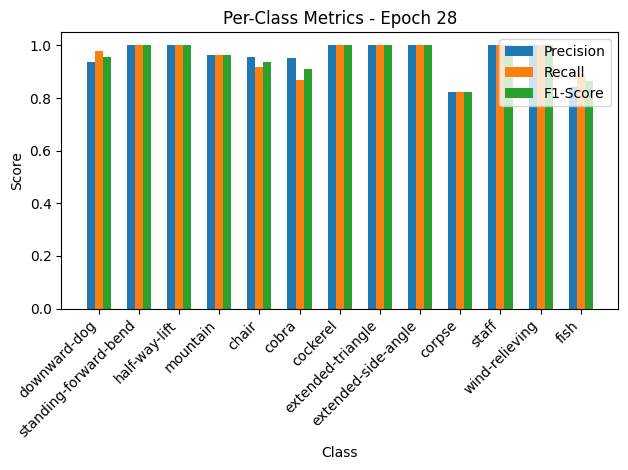


Epoch 29/50 Summary:
Train Loss: 0.0244 | Train Acc: 98.93% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2276 | Val Acc: 96.34% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 30/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:09<00:00,  8.50it/s, loss=0.0409, accuracy=98.6]


Per-Class Metrics for Epoch 29:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.98, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.98, F1-Score=0.98
mountain: Precision=0.97, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=1.00, Recall=0.93, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=1.00, F1-Score=0.96


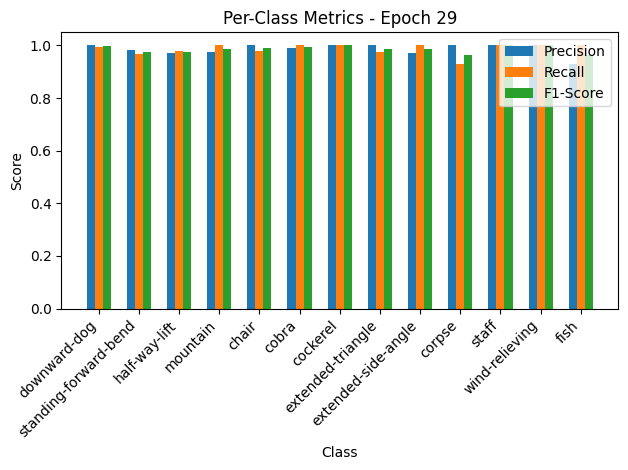

Validation: 100%|██████████| 21/21 [00:00<00:00, 27.26it/s, loss=0.229, accuracy=96.3]


Per-Class Metrics for Epoch 29:
downward-dog: Precision=0.94, Recall=0.98, F1-Score=0.96
standing-forward-bend: Precision=1.00, Recall=1.00, F1-Score=1.00
half-way-lift: Precision=1.00, Recall=1.00, F1-Score=1.00
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.95, Recall=0.87, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.82, Recall=0.82, F1-Score=0.82
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.84, Recall=0.89, F1-Score=0.86


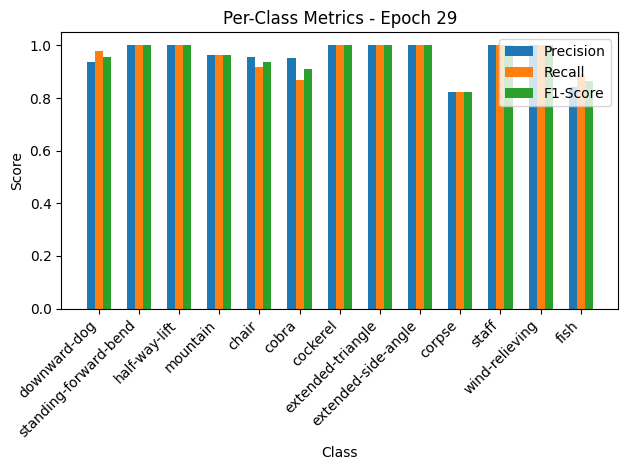


Epoch 30/50 Summary:
Train Loss: 0.0410 | Train Acc: 98.62% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2350 | Val Acc: 96.34% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 31/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:08<00:00,  9.50it/s, loss=0.0449, accuracy=98.5]


Per-Class Metrics for Epoch 30:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.98, Recall=0.97, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.97, F1-Score=0.97
mountain: Precision=0.99, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=0.99, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.96, Recall=0.96, F1-Score=0.96
staff: Precision=1.00, Recall=0.98, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.96, Recall=0.96, F1-Score=0.96


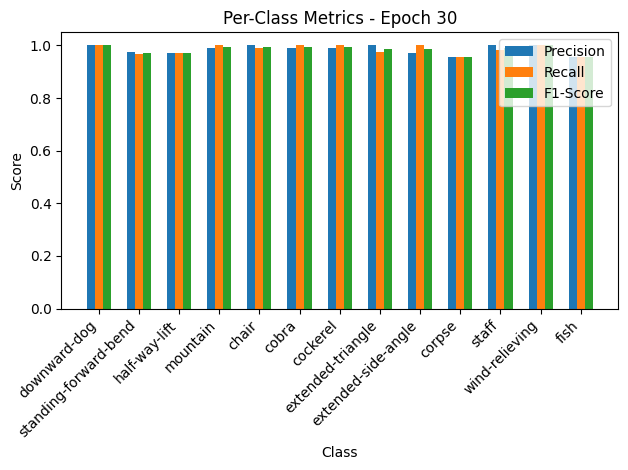

Validation: 100%|██████████| 21/21 [00:00<00:00, 27.60it/s, loss=0.226, accuracy=96.3]


Per-Class Metrics for Epoch 30:
downward-dog: Precision=0.94, Recall=0.98, F1-Score=0.96
standing-forward-bend: Precision=1.00, Recall=1.00, F1-Score=1.00
half-way-lift: Precision=1.00, Recall=1.00, F1-Score=1.00
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.95, Recall=0.87, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.82, Recall=0.82, F1-Score=0.82
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.84, Recall=0.89, F1-Score=0.86


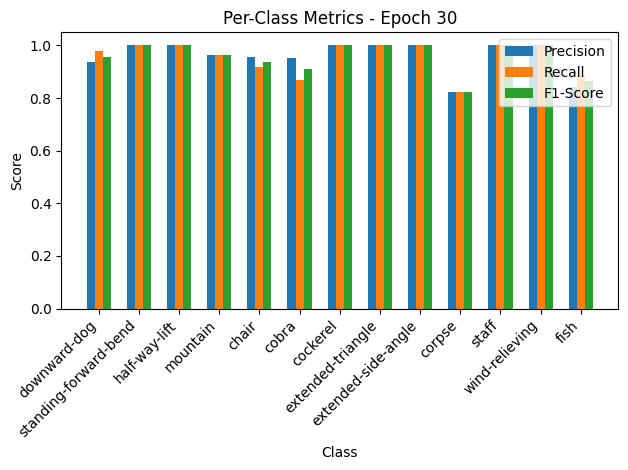


Epoch 31/50 Summary:
Train Loss: 0.0450 | Train Acc: 98.55% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2315 | Val Acc: 96.34% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 32/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:09<00:00,  8.63it/s, loss=0.0441, accuracy=98.5]


Per-Class Metrics for Epoch 31:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.97, Recall=0.95, F1-Score=0.96
half-way-lift: Precision=0.96, Recall=0.98, F1-Score=0.97
mountain: Precision=0.97, Recall=0.98, F1-Score=0.97
chair: Precision=1.00, Recall=0.99, F1-Score=0.99
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.97, Recall=0.97, F1-Score=0.97
corpse: Precision=1.00, Recall=0.99, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.99, Recall=1.00, F1-Score=0.99


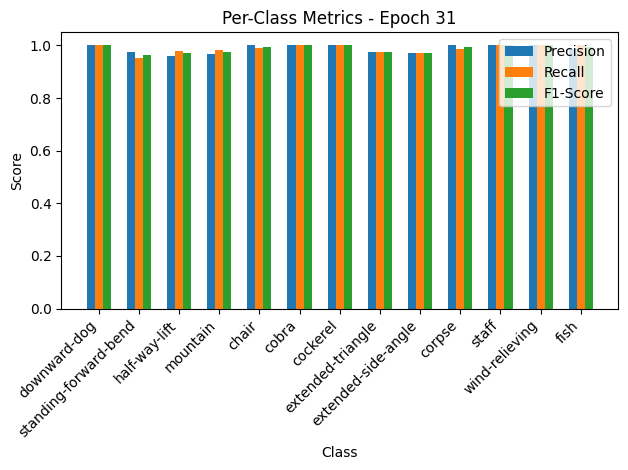

Validation: 100%|██████████| 21/21 [00:00<00:00, 28.24it/s, loss=0.227, accuracy=96.3]


Per-Class Metrics for Epoch 31:
downward-dog: Precision=0.94, Recall=0.98, F1-Score=0.96
standing-forward-bend: Precision=1.00, Recall=1.00, F1-Score=1.00
half-way-lift: Precision=1.00, Recall=1.00, F1-Score=1.00
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.95, Recall=0.87, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.82, Recall=0.82, F1-Score=0.82
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.84, Recall=0.89, F1-Score=0.86


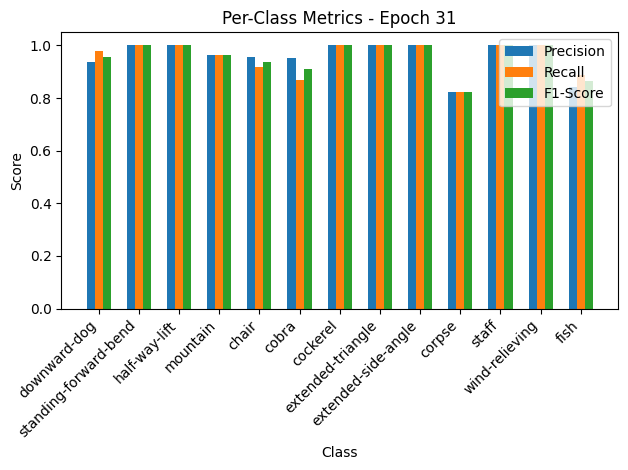


Epoch 32/50 Summary:
Train Loss: 0.0442 | Train Acc: 98.55% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2324 | Val Acc: 96.34% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 33/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:09<00:00,  8.85it/s, loss=0.0364, accuracy=98.5]


Per-Class Metrics for Epoch 32:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.96, Recall=0.97, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.97, F1-Score=0.97
mountain: Precision=0.98, Recall=0.99, F1-Score=0.99
chair: Precision=0.99, Recall=0.98, F1-Score=0.98
cobra: Precision=0.99, Recall=0.99, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=1.00, Recall=0.97, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=1.00, F1-Score=0.99


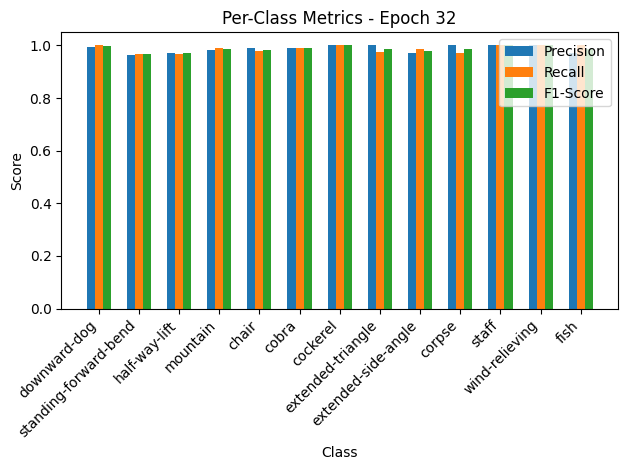

Validation: 100%|██████████| 21/21 [00:00<00:00, 23.71it/s, loss=0.217, accuracy=96.3]


Per-Class Metrics for Epoch 32:
downward-dog: Precision=0.94, Recall=0.96, F1-Score=0.95
standing-forward-bend: Precision=0.98, Recall=1.00, F1-Score=0.99
half-way-lift: Precision=1.00, Recall=1.00, F1-Score=1.00
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.95, Recall=0.91, F1-Score=0.93
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.88, Recall=0.82, F1-Score=0.85
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.84, Recall=0.89, F1-Score=0.86


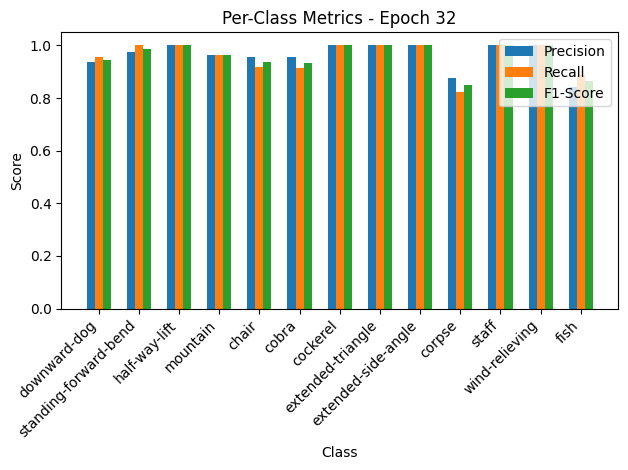


Epoch 33/50 Summary:
Train Loss: 0.0365 | Train Acc: 98.55% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2225 | Val Acc: 96.34% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 34/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:09<00:00,  9.07it/s, loss=0.0269, accuracy=99]


Per-Class Metrics for Epoch 33:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.98, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.98
mountain: Precision=1.00, Recall=0.99, F1-Score=1.00
chair: Precision=0.99, Recall=0.99, F1-Score=0.99
cobra: Precision=0.99, Recall=0.99, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=1.00, Recall=0.94, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=1.00, F1-Score=0.97


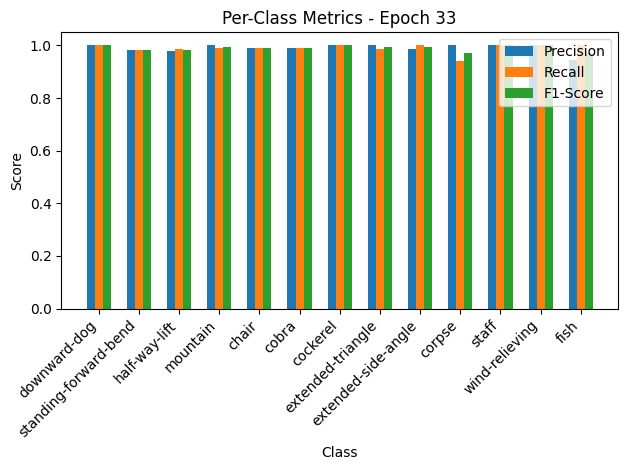

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.30it/s, loss=0.218, accuracy=96.6]


Per-Class Metrics for Epoch 33:
downward-dog: Precision=0.94, Recall=0.98, F1-Score=0.96
standing-forward-bend: Precision=1.00, Recall=1.00, F1-Score=1.00
half-way-lift: Precision=1.00, Recall=1.00, F1-Score=1.00
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.95, Recall=0.87, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.83, Recall=0.88, F1-Score=0.86
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.89, Recall=0.89, F1-Score=0.89


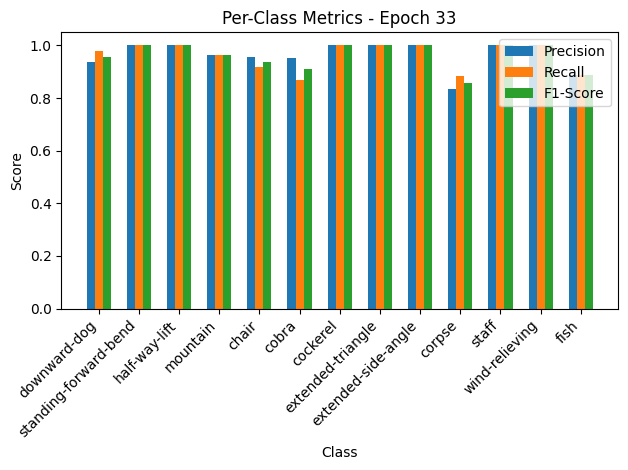


Epoch 34/50 Summary:
Train Loss: 0.0269 | Train Acc: 99.01% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2230 | Val Acc: 96.65% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 35/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:10<00:00,  8.02it/s, loss=0.0317, accuracy=98.8]


Per-Class Metrics for Epoch 34:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=0.98, F1-Score=0.98
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=1.00, F1-Score=0.99
staff: Precision=0.98, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.97, F1-Score=0.99


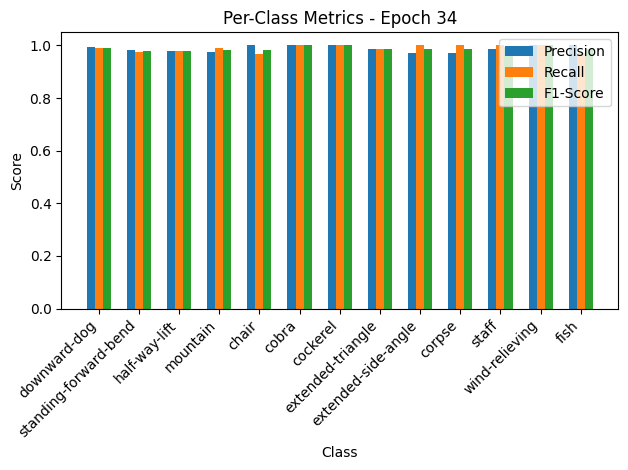

Validation: 100%|██████████| 21/21 [00:00<00:00, 28.30it/s, loss=0.219, accuracy=96.3]


Per-Class Metrics for Epoch 34:
downward-dog: Precision=0.94, Recall=0.98, F1-Score=0.96
standing-forward-bend: Precision=1.00, Recall=1.00, F1-Score=1.00
half-way-lift: Precision=1.00, Recall=1.00, F1-Score=1.00
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.95, Recall=0.87, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.82, Recall=0.82, F1-Score=0.82
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.84, Recall=0.89, F1-Score=0.86


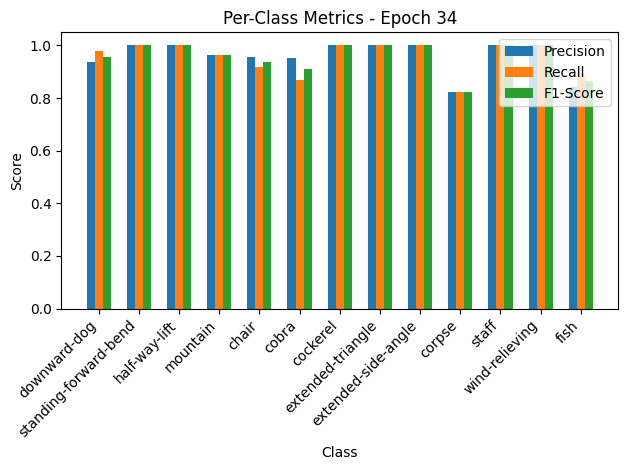


Epoch 35/50 Summary:
Train Loss: 0.0317 | Train Acc: 98.78% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2244 | Val Acc: 96.34% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 36/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:09<00:00,  8.39it/s, loss=0.0288, accuracy=98.7]


Per-Class Metrics for Epoch 35:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.98, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=0.97, F1-Score=0.98
mountain: Precision=0.97, Recall=0.98, F1-Score=0.98
chair: Precision=0.99, Recall=0.99, F1-Score=0.99
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.99, Recall=0.97, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.99, F1-Score=0.98


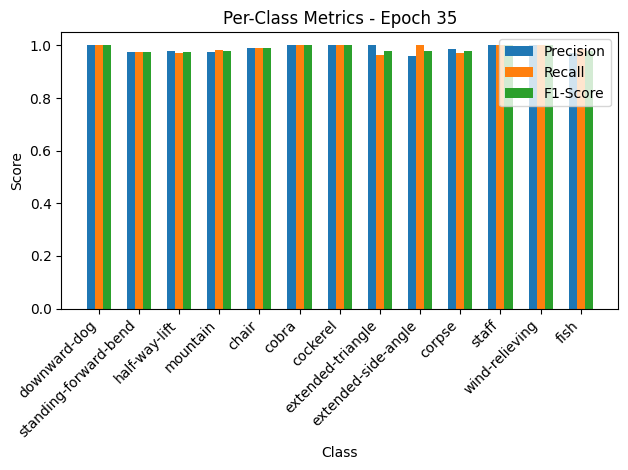

Validation: 100%|██████████| 21/21 [00:00<00:00, 27.33it/s, loss=0.237, accuracy=96.3]


Per-Class Metrics for Epoch 35:
downward-dog: Precision=0.94, Recall=0.98, F1-Score=0.96
standing-forward-bend: Precision=1.00, Recall=1.00, F1-Score=1.00
half-way-lift: Precision=1.00, Recall=1.00, F1-Score=1.00
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.95, Recall=0.87, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.82, Recall=0.82, F1-Score=0.82
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.84, Recall=0.89, F1-Score=0.86


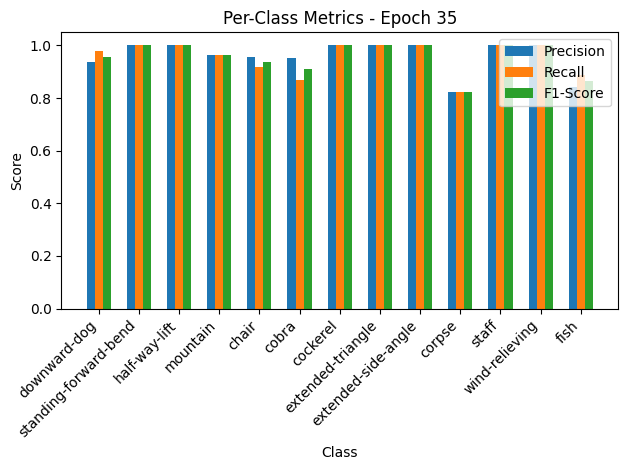


Epoch 36/50 Summary:
Train Loss: 0.0289 | Train Acc: 98.70% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2425 | Val Acc: 96.34% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 37/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:08<00:00,  9.80it/s, loss=0.0291, accuracy=99.1]


Per-Class Metrics for Epoch 36:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.98, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.98, F1-Score=0.98
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=0.99, Recall=1.00, F1-Score=0.99
cobra: Precision=1.00, Recall=0.98, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=1.00, Recall=0.99, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.99, Recall=1.00, F1-Score=0.99


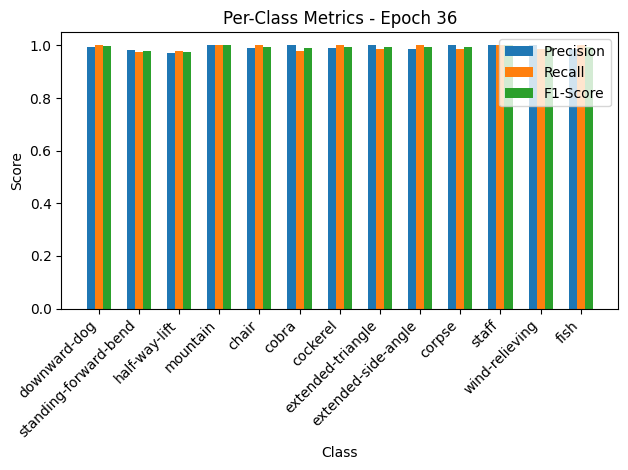

Validation: 100%|██████████| 21/21 [00:00<00:00, 25.71it/s, loss=0.217, accuracy=96.3]


Per-Class Metrics for Epoch 36:
downward-dog: Precision=0.94, Recall=0.98, F1-Score=0.96
standing-forward-bend: Precision=1.00, Recall=1.00, F1-Score=1.00
half-way-lift: Precision=1.00, Recall=1.00, F1-Score=1.00
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.95, Recall=0.87, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.82, Recall=0.82, F1-Score=0.82
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.84, Recall=0.89, F1-Score=0.86


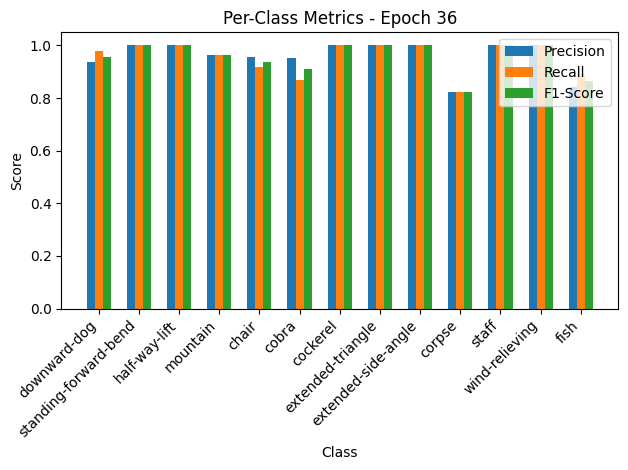


Epoch 37/50 Summary:
Train Loss: 0.0292 | Train Acc: 99.08% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2218 | Val Acc: 96.34% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 38/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:10<00:00,  8.20it/s, loss=0.0301, accuracy=98.9]


Per-Class Metrics for Epoch 37:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.98, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.98, F1-Score=0.98
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=0.99, Recall=1.00, F1-Score=0.99
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=1.00, Recall=0.99, F1-Score=0.99
corpse: Precision=0.99, Recall=0.97, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.99, Recall=0.99, F1-Score=0.99


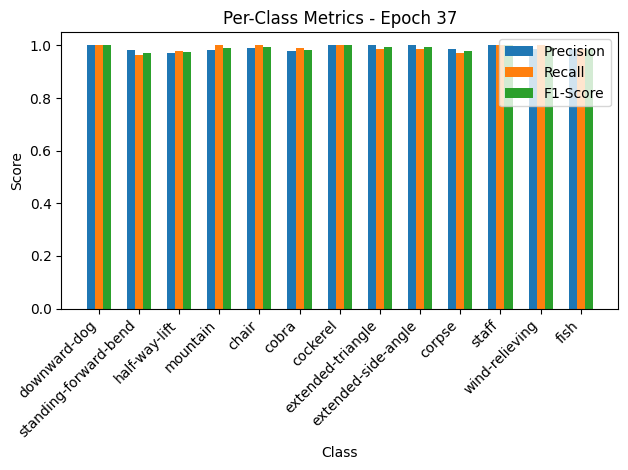

Validation: 100%|██████████| 21/21 [00:00<00:00, 25.45it/s, loss=0.224, accuracy=96.3]


Per-Class Metrics for Epoch 37:
downward-dog: Precision=0.94, Recall=0.98, F1-Score=0.96
standing-forward-bend: Precision=1.00, Recall=1.00, F1-Score=1.00
half-way-lift: Precision=1.00, Recall=1.00, F1-Score=1.00
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.95, Recall=0.87, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.82, Recall=0.82, F1-Score=0.82
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.84, Recall=0.89, F1-Score=0.86


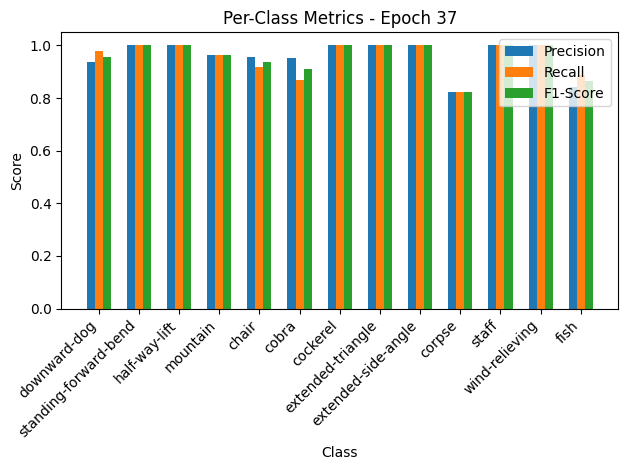


Epoch 38/50 Summary:
Train Loss: 0.0302 | Train Acc: 98.85% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2291 | Val Acc: 96.34% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 39/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:11<00:00,  6.92it/s, loss=0.0428, accuracy=98.5]


Per-Class Metrics for Epoch 38:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.98, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.98, F1-Score=0.97
mountain: Precision=0.99, Recall=0.99, F1-Score=0.99
chair: Precision=0.99, Recall=0.98, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.97, F1-Score=0.97
corpse: Precision=1.00, Recall=0.94, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.94, Recall=1.00, F1-Score=0.97


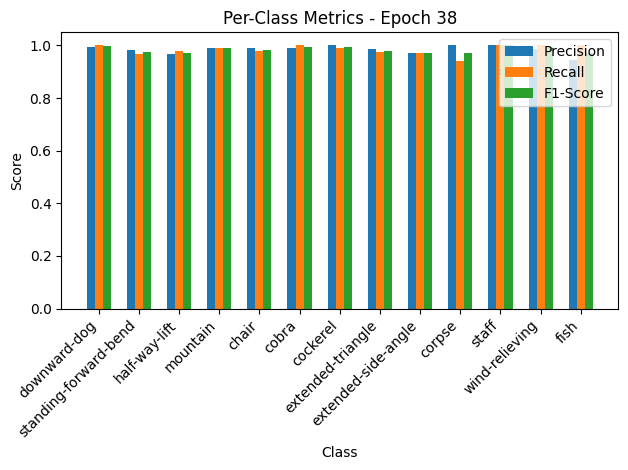

Validation: 100%|██████████| 21/21 [00:00<00:00, 31.64it/s, loss=0.214, accuracy=96.3]


Per-Class Metrics for Epoch 38:
downward-dog: Precision=0.94, Recall=0.98, F1-Score=0.96
standing-forward-bend: Precision=1.00, Recall=1.00, F1-Score=1.00
half-way-lift: Precision=1.00, Recall=1.00, F1-Score=1.00
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.95, Recall=0.87, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.82, Recall=0.82, F1-Score=0.82
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.84, Recall=0.89, F1-Score=0.86


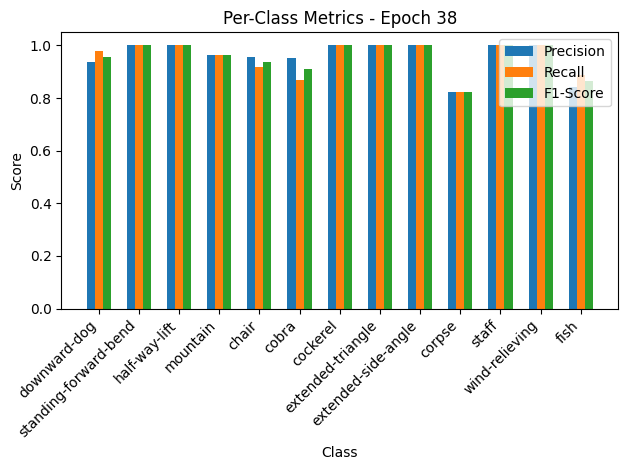


Epoch 39/50 Summary:
Train Loss: 0.0429 | Train Acc: 98.47% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.2191 | Val Acc: 96.34% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 40/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:09<00:00,  8.80it/s, loss=0.0283, accuracy=99]


Per-Class Metrics for Epoch 39:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.98, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.98, F1-Score=0.97
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=1.00, Recall=0.99, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.99, Recall=1.00, F1-Score=0.99


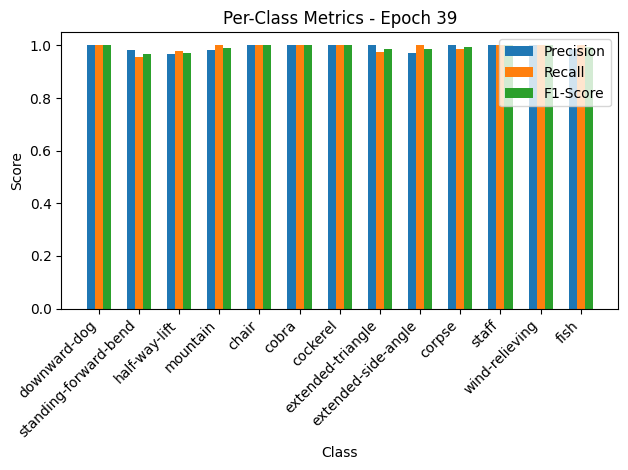

Validation: 100%|██████████| 21/21 [00:00<00:00, 23.46it/s, loss=0.23, accuracy=96.3]


Per-Class Metrics for Epoch 39:
downward-dog: Precision=0.94, Recall=0.98, F1-Score=0.96
standing-forward-bend: Precision=1.00, Recall=1.00, F1-Score=1.00
half-way-lift: Precision=1.00, Recall=1.00, F1-Score=1.00
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.95, Recall=0.87, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.82, Recall=0.82, F1-Score=0.82
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.84, Recall=0.89, F1-Score=0.86


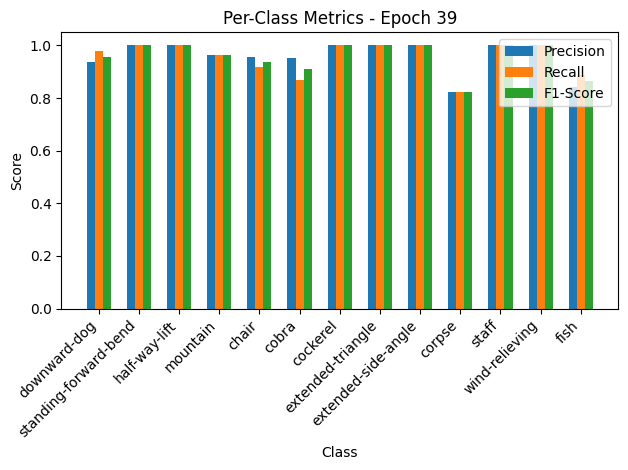


Epoch 40/50 Summary:
Train Loss: 0.0284 | Train Acc: 99.01% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2353 | Val Acc: 96.34% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 41/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:09<00:00,  8.85it/s, loss=0.0301, accuracy=98.5]


Per-Class Metrics for Epoch 40:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.98, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=0.98, F1-Score=0.97
chair: Precision=0.98, Recall=0.99, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=0.97, Recall=0.99, F1-Score=0.98
staff: Precision=0.98, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.96, F1-Score=0.97


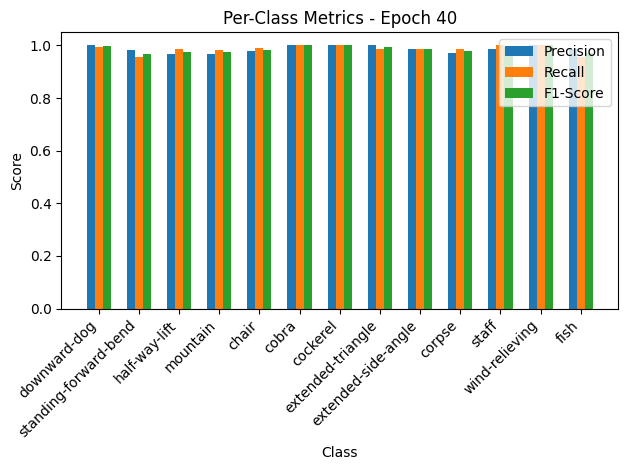

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.63it/s, loss=0.223, accuracy=96.3]


Per-Class Metrics for Epoch 40:
downward-dog: Precision=0.94, Recall=0.98, F1-Score=0.96
standing-forward-bend: Precision=1.00, Recall=1.00, F1-Score=1.00
half-way-lift: Precision=1.00, Recall=1.00, F1-Score=1.00
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.95, Recall=0.87, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.82, Recall=0.82, F1-Score=0.82
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.84, Recall=0.89, F1-Score=0.86


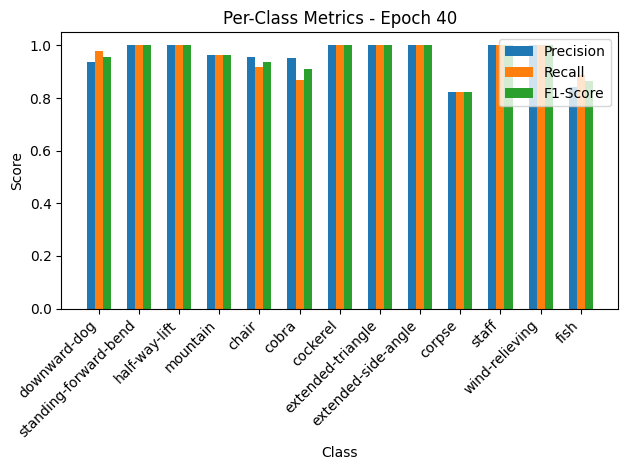


Epoch 41/50 Summary:
Train Loss: 0.0301 | Train Acc: 98.55% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2282 | Val Acc: 96.34% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 42/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:09<00:00,  8.55it/s, loss=0.0294, accuracy=99.1]


Per-Class Metrics for Epoch 41:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.98, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=0.98, F1-Score=0.98
mountain: Precision=0.99, Recall=0.99, F1-Score=0.99
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=1.00, Recall=0.99, F1-Score=0.99


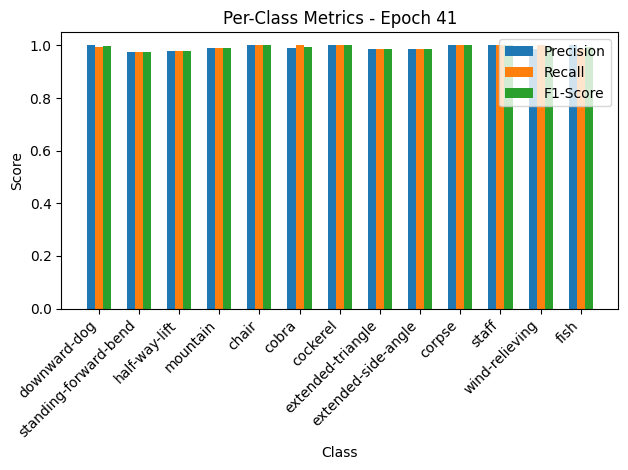

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.80it/s, loss=0.223, accuracy=96.6]


Per-Class Metrics for Epoch 41:
downward-dog: Precision=0.94, Recall=0.98, F1-Score=0.96
standing-forward-bend: Precision=1.00, Recall=1.00, F1-Score=1.00
half-way-lift: Precision=1.00, Recall=1.00, F1-Score=1.00
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.95, Recall=0.87, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.83, Recall=0.88, F1-Score=0.86
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.89, Recall=0.89, F1-Score=0.89


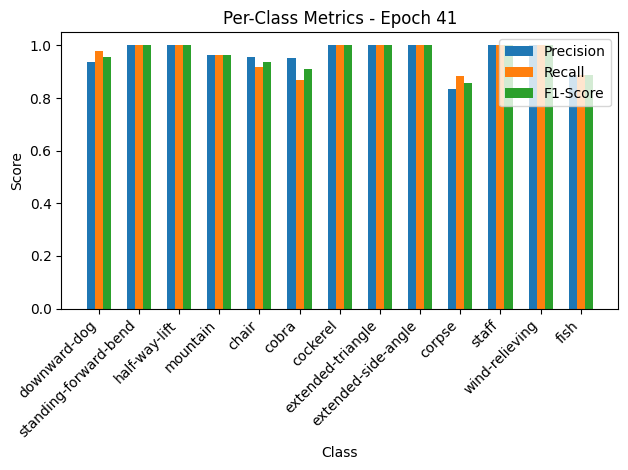


Epoch 42/50 Summary:
Train Loss: 0.0295 | Train Acc: 99.08% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2281 | Val Acc: 96.65% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 43/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:08<00:00,  9.63it/s, loss=0.035, accuracy=98.5]


Per-Class Metrics for Epoch 42:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.97, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.96, Recall=0.98, F1-Score=0.97
mountain: Precision=0.97, Recall=1.00, F1-Score=0.99
chair: Precision=0.99, Recall=0.98, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=1.00, Recall=0.96, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.96, Recall=0.99, F1-Score=0.97


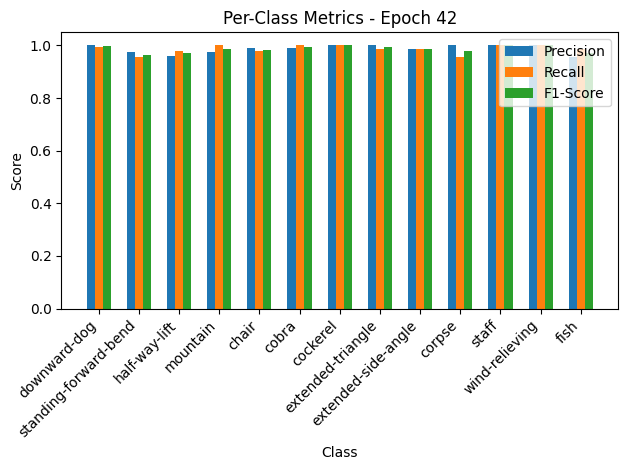

Validation: 100%|██████████| 21/21 [00:01<00:00, 20.67it/s, loss=0.239, accuracy=96.3]


Per-Class Metrics for Epoch 42:
downward-dog: Precision=0.94, Recall=0.98, F1-Score=0.96
standing-forward-bend: Precision=1.00, Recall=1.00, F1-Score=1.00
half-way-lift: Precision=1.00, Recall=1.00, F1-Score=1.00
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.95, Recall=0.87, F1-Score=0.91
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.88, Recall=0.82, F1-Score=0.85
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.84, Recall=0.89, F1-Score=0.86


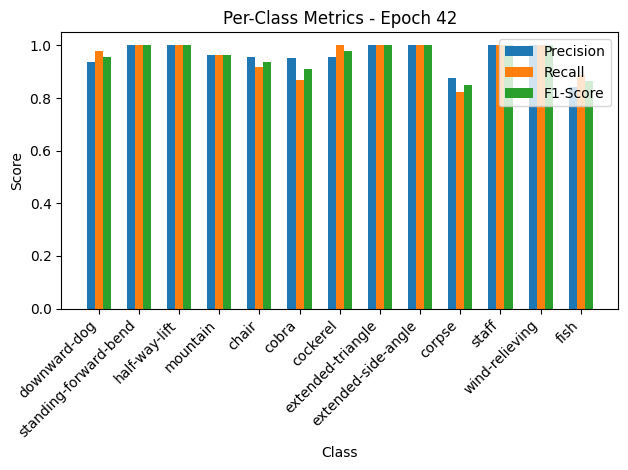


Epoch 43/50 Summary:
Train Loss: 0.0351 | Train Acc: 98.55% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2452 | Val Acc: 96.34% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 44/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:09<00:00,  8.84it/s, loss=0.0507, accuracy=98.5]


Per-Class Metrics for Epoch 43:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.97, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.98, F1-Score=0.97
mountain: Precision=0.99, Recall=0.98, F1-Score=0.99
chair: Precision=0.99, Recall=0.99, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.96, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.96, Recall=0.96, F1-Score=0.96


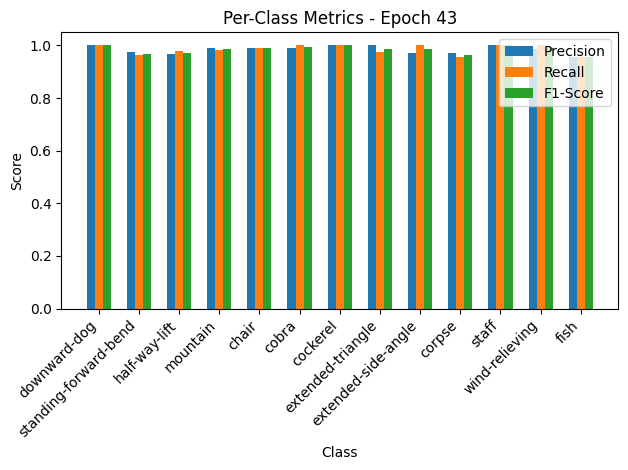

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.09it/s, loss=0.219, accuracy=96.3]


Per-Class Metrics for Epoch 43:
downward-dog: Precision=0.94, Recall=0.98, F1-Score=0.96
standing-forward-bend: Precision=1.00, Recall=1.00, F1-Score=1.00
half-way-lift: Precision=1.00, Recall=1.00, F1-Score=1.00
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.95, Recall=0.87, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.82, Recall=0.82, F1-Score=0.82
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.84, Recall=0.89, F1-Score=0.86


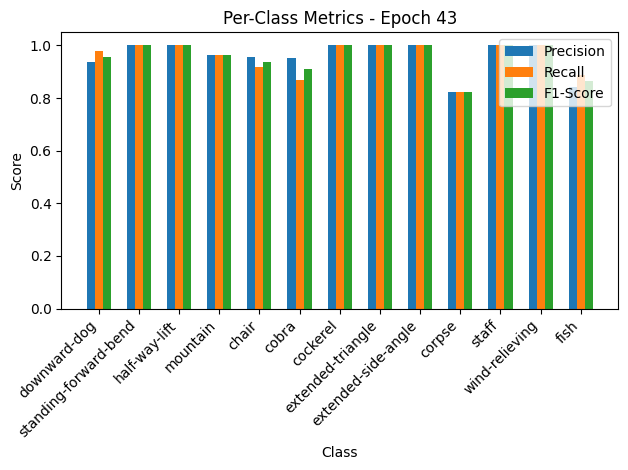


Epoch 44/50 Summary:
Train Loss: 0.0508 | Train Acc: 98.47% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.2247 | Val Acc: 96.34% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 45/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:09<00:00,  8.54it/s, loss=0.0403, accuracy=98.6]


Per-Class Metrics for Epoch 44:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.98, F1-Score=0.97
mountain: Precision=0.96, Recall=1.00, F1-Score=0.98
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.99, Recall=0.99, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.99, Recall=0.99, F1-Score=0.99


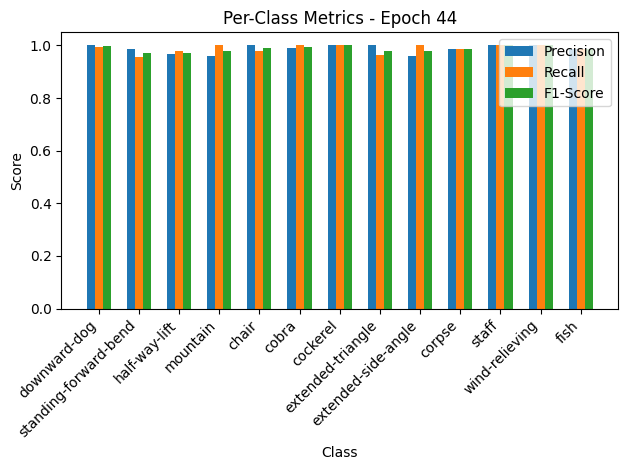

Validation: 100%|██████████| 21/21 [00:00<00:00, 31.14it/s, loss=0.222, accuracy=96.3]


Per-Class Metrics for Epoch 44:
downward-dog: Precision=0.94, Recall=0.98, F1-Score=0.96
standing-forward-bend: Precision=1.00, Recall=1.00, F1-Score=1.00
half-way-lift: Precision=1.00, Recall=1.00, F1-Score=1.00
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.95, Recall=0.87, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.82, Recall=0.82, F1-Score=0.82
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.84, Recall=0.89, F1-Score=0.86


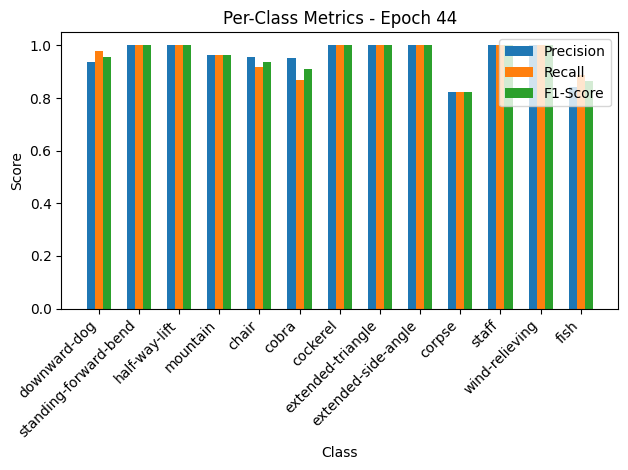


Epoch 45/50 Summary:
Train Loss: 0.0404 | Train Acc: 98.62% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2276 | Val Acc: 96.34% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 46/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:08<00:00,  9.31it/s, loss=0.0372, accuracy=98.6]


Per-Class Metrics for Epoch 45:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.97, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.96, Recall=0.97, F1-Score=0.97
mountain: Precision=0.99, Recall=0.99, F1-Score=0.99
chair: Precision=0.99, Recall=0.99, F1-Score=0.99
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.97, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.97, F1-Score=0.97


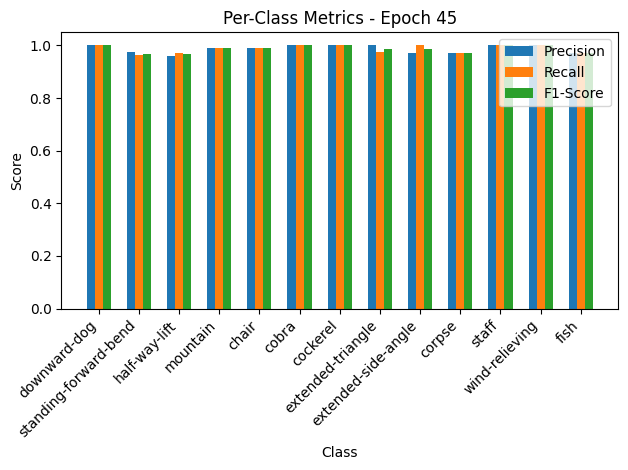

Validation: 100%|██████████| 21/21 [00:00<00:00, 27.82it/s, loss=0.21, accuracy=96.3]


Per-Class Metrics for Epoch 45:
downward-dog: Precision=0.94, Recall=0.98, F1-Score=0.96
standing-forward-bend: Precision=1.00, Recall=1.00, F1-Score=1.00
half-way-lift: Precision=1.00, Recall=1.00, F1-Score=1.00
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.95, Recall=0.87, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.82, Recall=0.82, F1-Score=0.82
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.84, Recall=0.89, F1-Score=0.86


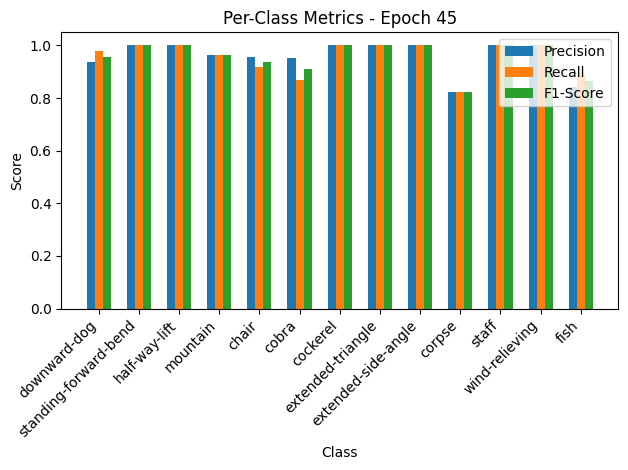


Epoch 46/50 Summary:
Train Loss: 0.0372 | Train Acc: 98.62% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2153 | Val Acc: 96.34% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 47/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:10<00:00,  8.14it/s, loss=0.0421, accuracy=98.4]


Per-Class Metrics for Epoch 46:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.97, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.98, F1-Score=0.98
mountain: Precision=0.97, Recall=0.98, F1-Score=0.98
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.97, Recall=0.97, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.97, F1-Score=0.97


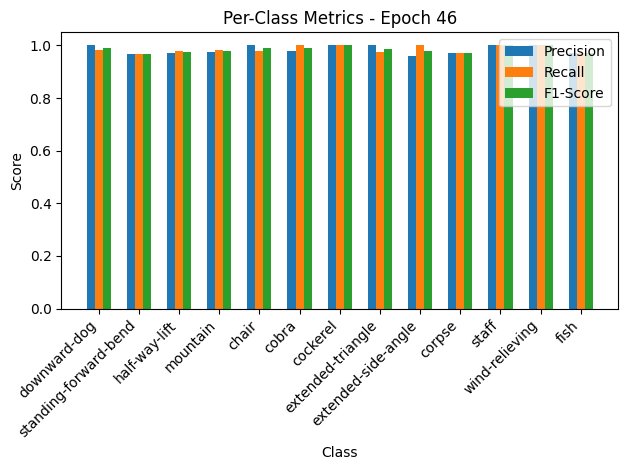

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.54it/s, loss=0.214, accuracy=96.3]


Per-Class Metrics for Epoch 46:
downward-dog: Precision=0.94, Recall=0.98, F1-Score=0.96
standing-forward-bend: Precision=1.00, Recall=1.00, F1-Score=1.00
half-way-lift: Precision=1.00, Recall=1.00, F1-Score=1.00
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.95, Recall=0.87, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.82, Recall=0.82, F1-Score=0.82
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.84, Recall=0.89, F1-Score=0.86


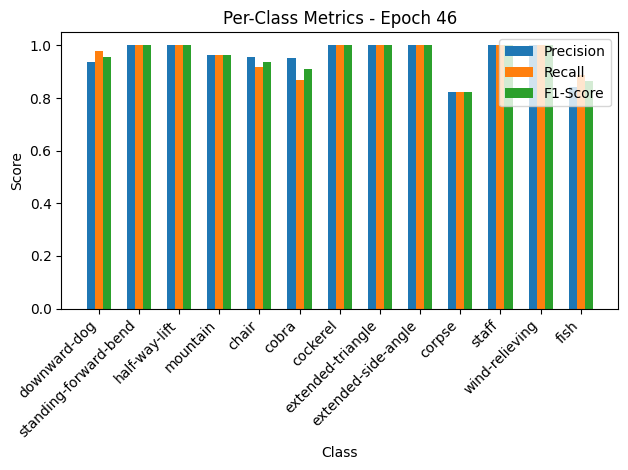


Epoch 47/50 Summary:
Train Loss: 0.0422 | Train Acc: 98.40% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.2192 | Val Acc: 96.34% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 48/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:09<00:00,  8.45it/s, loss=0.0403, accuracy=98.5]


Per-Class Metrics for Epoch 47:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.97, Recall=0.96, F1-Score=0.96
half-way-lift: Precision=0.97, Recall=0.98, F1-Score=0.98
mountain: Precision=0.97, Recall=0.98, F1-Score=0.97
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=1.00, Recall=0.96, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.96, Recall=1.00, F1-Score=0.98


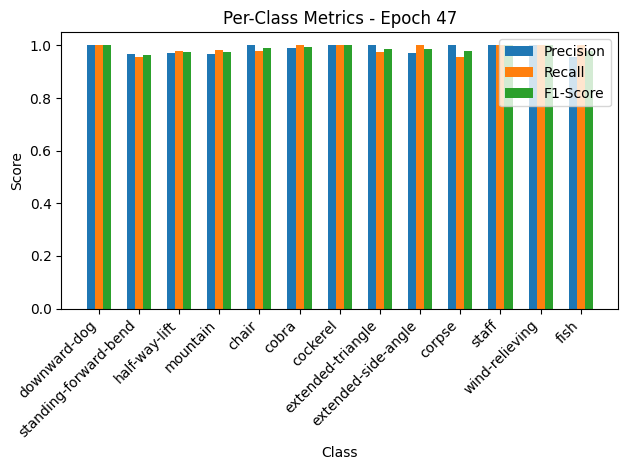

Validation: 100%|██████████| 21/21 [00:00<00:00, 28.90it/s, loss=0.217, accuracy=96.3]


Per-Class Metrics for Epoch 47:
downward-dog: Precision=0.94, Recall=0.98, F1-Score=0.96
standing-forward-bend: Precision=1.00, Recall=1.00, F1-Score=1.00
half-way-lift: Precision=1.00, Recall=1.00, F1-Score=1.00
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.95, Recall=0.87, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.82, Recall=0.82, F1-Score=0.82
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.84, Recall=0.89, F1-Score=0.86


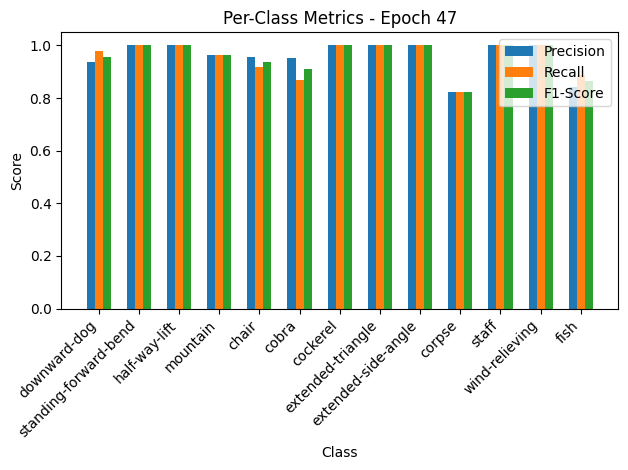


Epoch 48/50 Summary:
Train Loss: 0.0404 | Train Acc: 98.55% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2220 | Val Acc: 96.34% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 49/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:08<00:00,  9.25it/s, loss=0.0332, accuracy=98.9]


Per-Class Metrics for Epoch 48:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.98, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.98, F1-Score=0.97
mountain: Precision=0.98, Recall=0.99, F1-Score=0.99
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=0.99, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


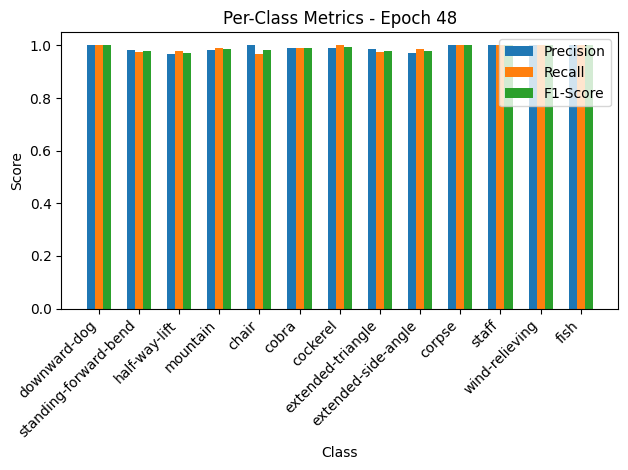

Validation: 100%|██████████| 21/21 [00:00<00:00, 25.10it/s, loss=0.224, accuracy=96.3]


Per-Class Metrics for Epoch 48:
downward-dog: Precision=0.94, Recall=0.98, F1-Score=0.96
standing-forward-bend: Precision=1.00, Recall=1.00, F1-Score=1.00
half-way-lift: Precision=1.00, Recall=1.00, F1-Score=1.00
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.95, Recall=0.87, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.82, Recall=0.82, F1-Score=0.82
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.84, Recall=0.89, F1-Score=0.86


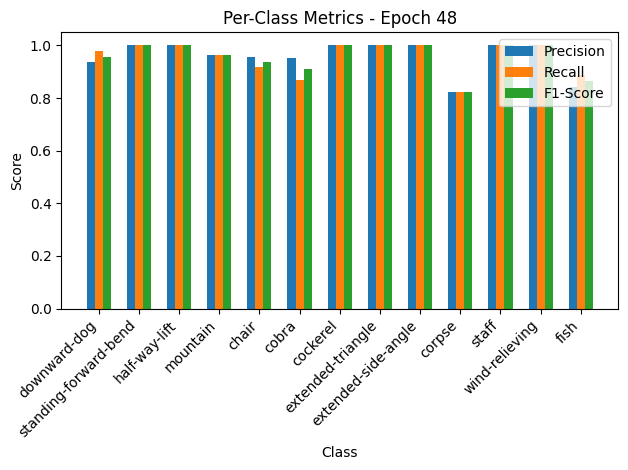


Epoch 49/50 Summary:
Train Loss: 0.0333 | Train Acc: 98.85% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2300 | Val Acc: 96.34% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 50/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:09<00:00,  8.68it/s, loss=0.0334, accuracy=98.5]


Per-Class Metrics for Epoch 49:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.96, Recall=0.97, F1-Score=0.97
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.99, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.99, Recall=0.96, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.96, Recall=0.99, F1-Score=0.97


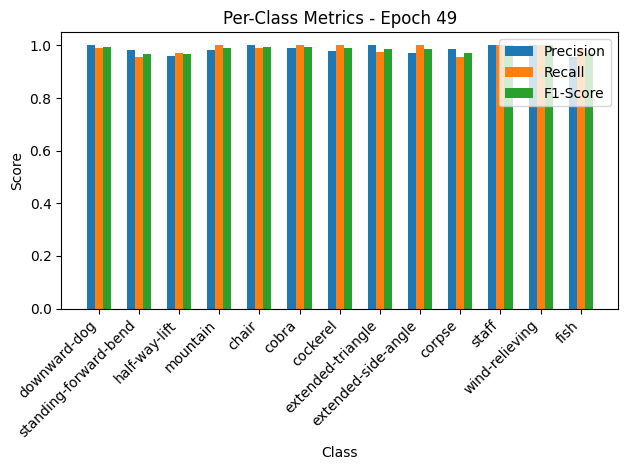

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.04it/s, loss=0.218, accuracy=96.6]


Per-Class Metrics for Epoch 49:
downward-dog: Precision=0.94, Recall=0.98, F1-Score=0.96
standing-forward-bend: Precision=1.00, Recall=1.00, F1-Score=1.00
half-way-lift: Precision=1.00, Recall=1.00, F1-Score=1.00
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.95, Recall=0.91, F1-Score=0.93
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.88, Recall=0.82, F1-Score=0.85
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.84, Recall=0.89, F1-Score=0.86


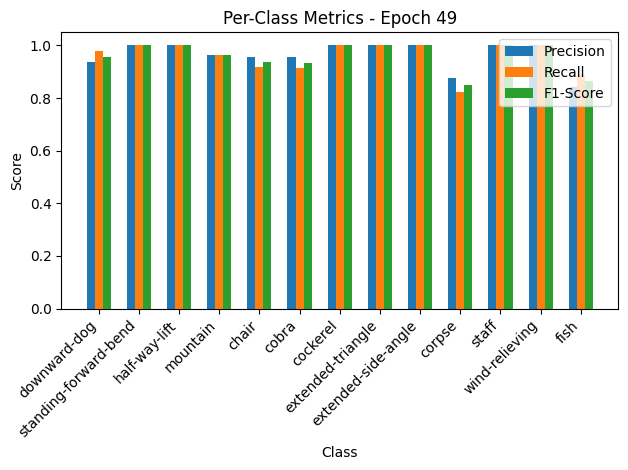


Epoch 50/50 Summary:
Train Loss: 0.0335 | Train Acc: 98.47% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.2230 | Val Acc: 96.65% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97


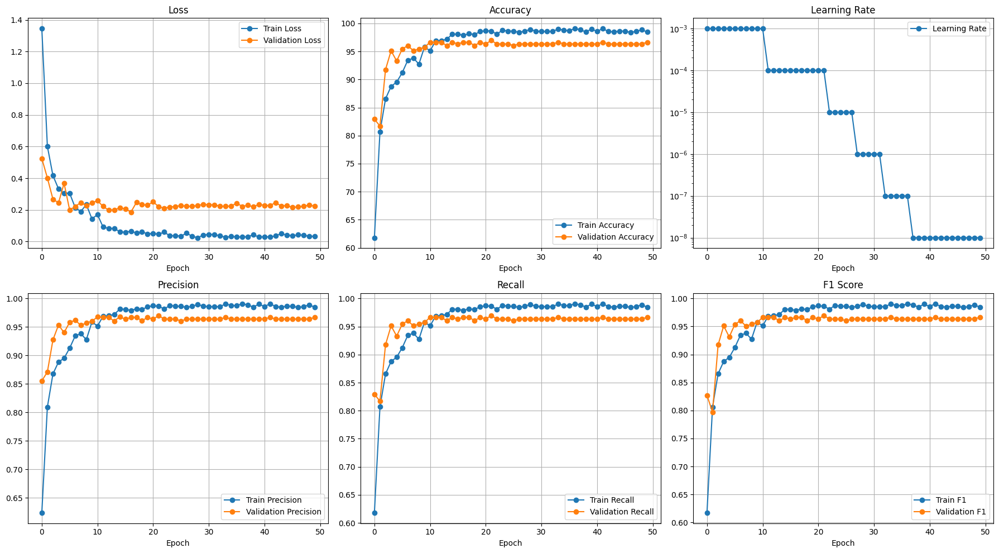

Fold 2/5

Class Distribution Analysis:
--------------------------------------------------
Class 0: 245 samples (13.48%)
Class 1: 225 samples (12.38%)
Class 2: 209 samples (11.50%)
Class 3: 165 samples (9.08%)
Class 4: 140 samples (7.70%)
Class 5: 129 samples (7.10%)
Class 6: 120 samples (6.60%)
Class 7: 108 samples (5.94%)
Class 8: 101 samples (5.56%)
Class 9: 95 samples (5.23%)
Class 10: 94 samples (5.17%)
Class 11: 94 samples (5.17%)
Class 12: 93 samples (5.12%)

Imbalance Statistics:
Imbalance Ratio (max/min): 2.63
Maximum class size: 245
Minimum class size: 93
Average class size: 139.85
Class weights aligned with indices: tensor([0.5117, 0.5567, 0.5988, 0.7568, 0.8908, 0.9663, 1.0383, 1.1529, 1.2324,
        1.3099, 1.3237, 1.3237, 1.3379])
Using device: cuda

Epoch 1/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.81it/s, loss=1.27, accuracy=61.7]


Per-Class Metrics for Epoch 0:
downward-dog: Precision=0.83, Recall=0.73, F1-Score=0.77
standing-forward-bend: Precision=0.74, Recall=0.53, F1-Score=0.62
half-way-lift: Precision=0.73, Recall=0.84, F1-Score=0.78
mountain: Precision=0.67, Recall=0.78, F1-Score=0.73
chair: Precision=0.53, Recall=0.48, F1-Score=0.50
cobra: Precision=0.72, Recall=0.68, F1-Score=0.70
cockerel: Precision=0.60, Recall=0.56, F1-Score=0.58
extended-triangle: Precision=0.51, Recall=0.50, F1-Score=0.51
extended-side-angle: Precision=0.41, Recall=0.39, F1-Score=0.40
corpse: Precision=0.36, Recall=0.33, F1-Score=0.34
staff: Precision=0.56, Recall=0.74, F1-Score=0.64
wind-relieving: Precision=0.57, Recall=0.66, F1-Score=0.61
fish: Precision=0.33, Recall=0.45, F1-Score=0.38


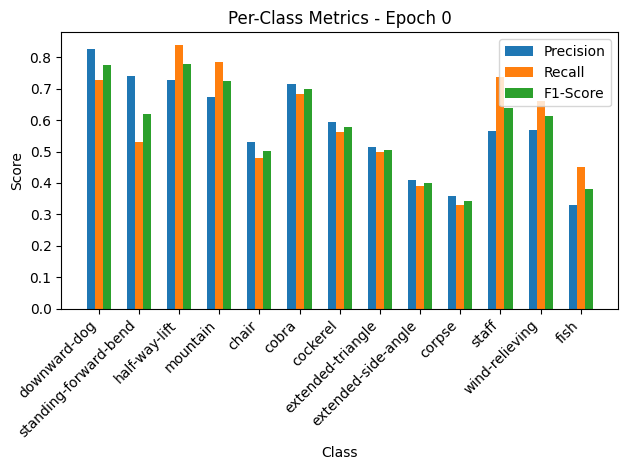

Validation: 100%|██████████| 21/21 [00:00<00:00, 28.63it/s, loss=0.845, accuracy=76.2]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 0:
downward-dog: Precision=0.86, Recall=0.96, F1-Score=0.91
standing-forward-bend: Precision=0.78, Recall=0.88, F1-Score=0.82
half-way-lift: Precision=0.94, Recall=0.76, F1-Score=0.84
mountain: Precision=0.96, Recall=0.93, F1-Score=0.95
chair: Precision=0.95, Recall=0.79, F1-Score=0.86
cobra: Precision=0.94, Recall=0.74, F1-Score=0.83
cockerel: Precision=1.00, Recall=0.86, F1-Score=0.93
extended-triangle: Precision=0.44, Recall=1.00, F1-Score=0.62
extended-side-angle: Precision=0.00, Recall=0.00, F1-Score=0.00
corpse: Precision=0.34, Recall=0.88, F1-Score=0.49
staff: Precision=1.00, Recall=0.94, F1-Score=0.97
wind-relieving: Precision=1.00, Recall=0.11, F1-Score=0.20
fish: Precision=0.80, Recall=0.47, F1-Score=0.59


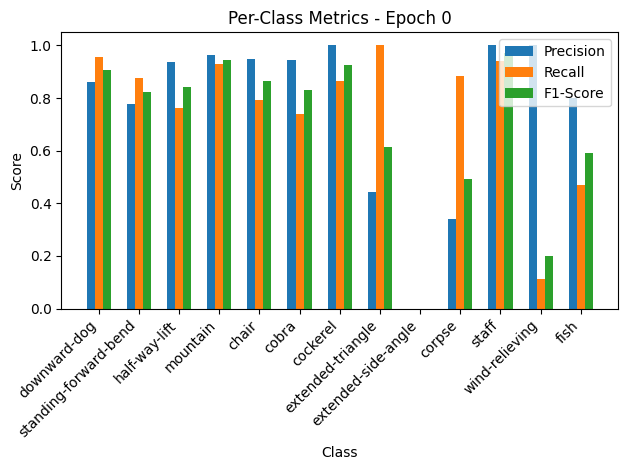


Epoch 1/50 Summary:
Train Loss: 1.2687 | Train Acc: 61.73% | Train Precision: 0.63 | Train Recall: 0.62 | Train F1: 0.62
Val Loss: 0.8654 | Val Acc: 76.22% | Val Precision: 0.80 | Val Recall: 0.76 | Val F1: 0.74
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model.pth
Checkpoint saved at epoch 1
New best model saved! Validation Loss: 0.8654

Epoch 2/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.54it/s, loss=0.555, accuracy=82.7]


Per-Class Metrics for Epoch 1:
downward-dog: Precision=0.93, Recall=0.90, F1-Score=0.91
standing-forward-bend: Precision=0.92, Recall=0.78, F1-Score=0.84
half-way-lift: Precision=0.86, Recall=0.92, F1-Score=0.89
mountain: Precision=0.75, Recall=0.86, F1-Score=0.80
chair: Precision=0.76, Recall=0.70, F1-Score=0.73
cobra: Precision=0.88, Recall=0.91, F1-Score=0.90
cockerel: Precision=0.88, Recall=0.94, F1-Score=0.91
extended-triangle: Precision=0.76, Recall=0.78, F1-Score=0.77
extended-side-angle: Precision=0.74, Recall=0.73, F1-Score=0.73
corpse: Precision=0.60, Recall=0.59, F1-Score=0.59
staff: Precision=0.87, Recall=0.91, F1-Score=0.89
wind-relieving: Precision=0.93, Recall=0.93, F1-Score=0.93
fish: Precision=0.63, Recall=0.61, F1-Score=0.62


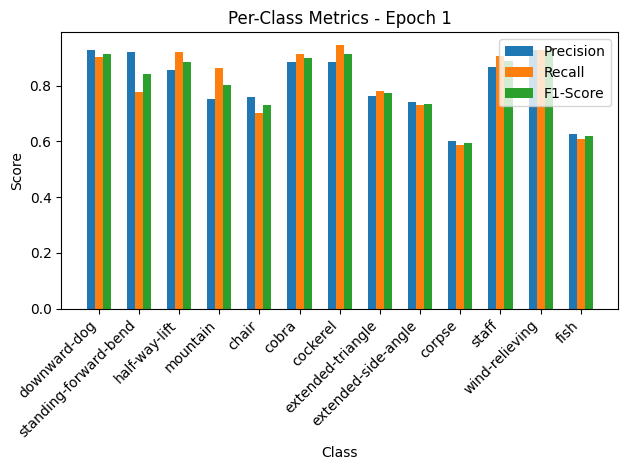

Validation: 100%|██████████| 21/21 [00:00<00:00, 22.77it/s, loss=0.769, accuracy=79.3]


Per-Class Metrics for Epoch 1:
downward-dog: Precision=1.00, Recall=0.93, F1-Score=0.97
standing-forward-bend: Precision=0.86, Recall=0.80, F1-Score=0.83
half-way-lift: Precision=0.79, Recall=0.89, F1-Score=0.84
mountain: Precision=0.68, Recall=0.96, F1-Score=0.79
chair: Precision=0.90, Recall=0.38, F1-Score=0.53
cobra: Precision=0.95, Recall=0.91, F1-Score=0.93
cockerel: Precision=1.00, Recall=0.82, F1-Score=0.90
extended-triangle: Precision=0.45, Recall=1.00, F1-Score=0.62
extended-side-angle: Precision=1.00, Recall=0.06, F1-Score=0.11
corpse: Precision=0.57, Recall=0.71, F1-Score=0.63
staff: Precision=0.89, Recall=0.94, F1-Score=0.91
wind-relieving: Precision=0.94, Recall=0.94, F1-Score=0.94
fish: Precision=0.77, Recall=0.59, F1-Score=0.67


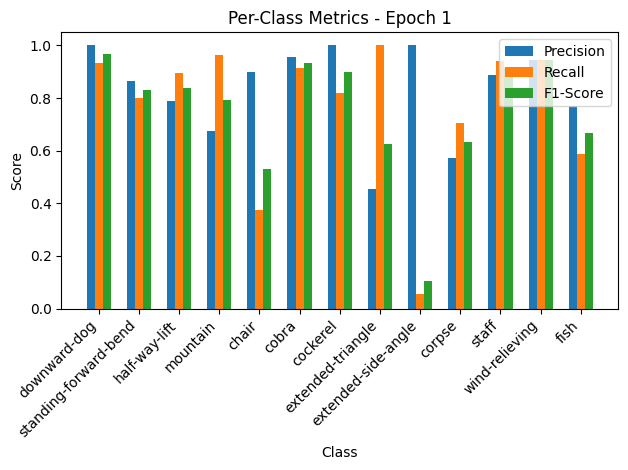


Epoch 2/50 Summary:
Train Loss: 0.5566 | Train Acc: 82.66% | Train Precision: 0.83 | Train Recall: 0.83 | Train F1: 0.83
Val Loss: 0.7873 | Val Acc: 79.27% | Val Precision: 0.84 | Val Recall: 0.79 | Val F1: 0.78
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model.pth
Checkpoint saved at epoch 2
New best model saved! Validation Loss: 0.7873

Epoch 3/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  8.18it/s, loss=0.459, accuracy=85.7]


Per-Class Metrics for Epoch 2:
downward-dog: Precision=0.97, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.92, Recall=0.82, F1-Score=0.87
half-way-lift: Precision=0.84, Recall=0.91, F1-Score=0.87
mountain: Precision=0.91, Recall=0.91, F1-Score=0.91
chair: Precision=0.80, Recall=0.87, F1-Score=0.83
cobra: Precision=0.90, Recall=0.96, F1-Score=0.93
cockerel: Precision=0.93, Recall=0.93, F1-Score=0.93
extended-triangle: Precision=0.75, Recall=0.72, F1-Score=0.73
extended-side-angle: Precision=0.72, Recall=0.72, F1-Score=0.72
corpse: Precision=0.65, Recall=0.63, F1-Score=0.64
staff: Precision=0.89, Recall=0.91, F1-Score=0.90
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.64, Recall=0.65, F1-Score=0.65


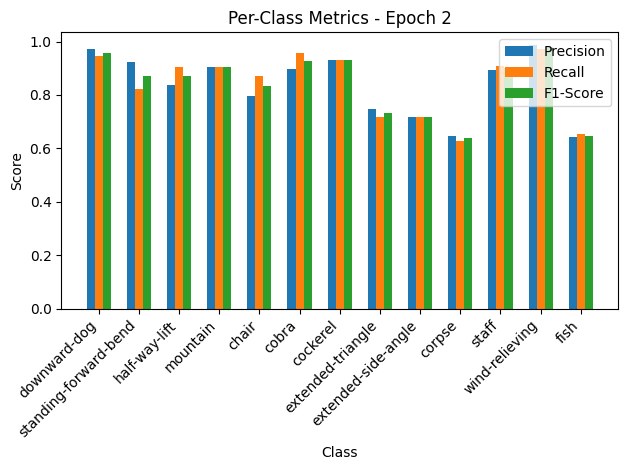

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.18it/s, loss=0.321, accuracy=90.9]


Per-Class Metrics for Epoch 2:
downward-dog: Precision=0.96, Recall=0.98, F1-Score=0.97
standing-forward-bend: Precision=0.80, Recall=0.90, F1-Score=0.85
half-way-lift: Precision=0.97, Recall=0.76, F1-Score=0.85
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.92, Recall=1.00, F1-Score=0.96
cobra: Precision=0.95, Recall=0.91, F1-Score=0.93
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.90, Recall=1.00, F1-Score=0.95
corpse: Precision=1.00, Recall=0.41, F1-Score=0.58
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.89, F1-Score=0.94
fish: Precision=0.63, Recall=1.00, F1-Score=0.77


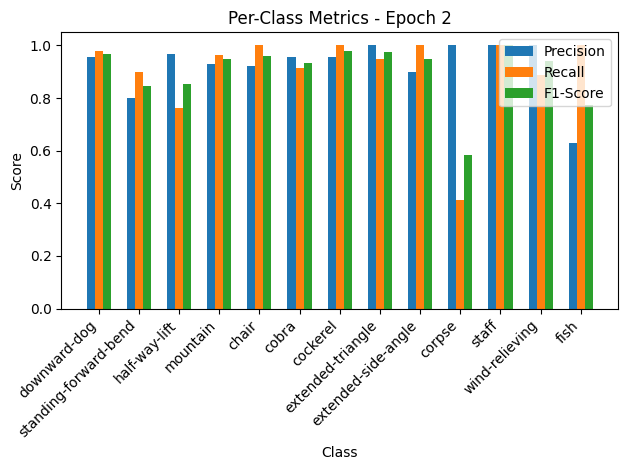


Epoch 3/50 Summary:
Train Loss: 0.4605 | Train Acc: 85.71% | Train Precision: 0.86 | Train Recall: 0.86 | Train F1: 0.86
Val Loss: 0.3287 | Val Acc: 90.85% | Val Precision: 0.92 | Val Recall: 0.91 | Val F1: 0.91
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model.pth
Checkpoint saved at epoch 3
New best model saved! Validation Loss: 0.3287

Epoch 4/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.89it/s, loss=0.334, accuracy=90]


Per-Class Metrics for Epoch 3:
downward-dog: Precision=0.93, Recall=0.93, F1-Score=0.93
standing-forward-bend: Precision=0.97, Recall=0.88, F1-Score=0.92
half-way-lift: Precision=0.89, Recall=0.95, F1-Score=0.92
mountain: Precision=0.90, Recall=0.94, F1-Score=0.92
chair: Precision=0.89, Recall=0.88, F1-Score=0.89
cobra: Precision=0.93, Recall=0.91, F1-Score=0.92
cockerel: Precision=0.97, Recall=0.96, F1-Score=0.96
extended-triangle: Precision=0.92, Recall=0.92, F1-Score=0.92
extended-side-angle: Precision=0.86, Recall=0.88, F1-Score=0.87
corpse: Precision=0.77, Recall=0.66, F1-Score=0.71
staff: Precision=0.93, Recall=0.98, F1-Score=0.96
wind-relieving: Precision=0.93, Recall=0.94, F1-Score=0.93
fish: Precision=0.68, Recall=0.74, F1-Score=0.71


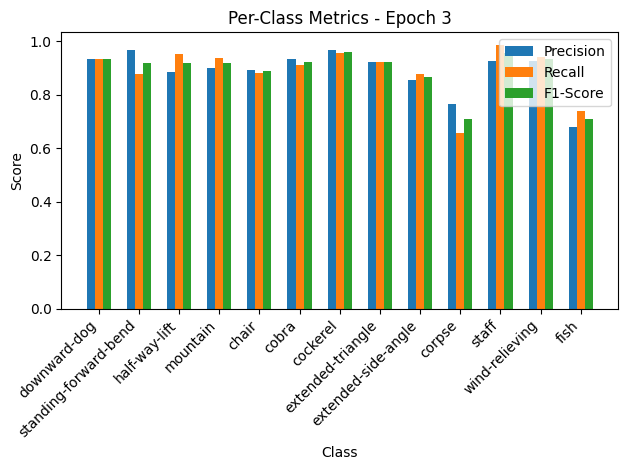

Validation: 100%|██████████| 21/21 [00:00<00:00, 30.22it/s, loss=0.401, accuracy=87.8]


Per-Class Metrics for Epoch 3:
downward-dog: Precision=1.00, Recall=0.96, F1-Score=0.98
standing-forward-bend: Precision=0.94, Recall=0.80, F1-Score=0.86
half-way-lift: Precision=0.84, Recall=0.97, F1-Score=0.90
mountain: Precision=0.96, Recall=0.96, F1-Score=0.96
chair: Precision=0.96, Recall=0.96, F1-Score=0.96
cobra: Precision=0.94, Recall=0.70, F1-Score=0.80
cockerel: Precision=0.88, Recall=1.00, F1-Score=0.94
extended-triangle: Precision=0.83, Recall=1.00, F1-Score=0.91
extended-side-angle: Precision=0.88, Recall=0.83, F1-Score=0.86
corpse: Precision=0.46, Recall=0.94, F1-Score=0.62
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=1.00, Recall=0.12, F1-Score=0.21


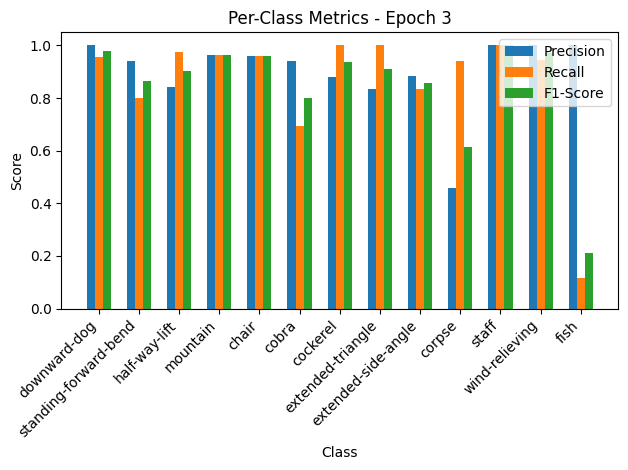


Epoch 4/50 Summary:
Train Loss: 0.3349 | Train Acc: 89.99% | Train Precision: 0.90 | Train Recall: 0.90 | Train F1: 0.90
Val Loss: 0.4107 | Val Acc: 87.80% | Val Precision: 0.91 | Val Recall: 0.88 | Val F1: 0.87

Epoch 5/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.93it/s, loss=0.318, accuracy=89.8]


Per-Class Metrics for Epoch 4:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.90, Recall=0.87, F1-Score=0.89
half-way-lift: Precision=0.90, Recall=0.90, F1-Score=0.90
mountain: Precision=0.90, Recall=0.90, F1-Score=0.90
chair: Precision=0.88, Recall=0.89, F1-Score=0.88
cobra: Precision=0.95, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.96, Recall=0.96, F1-Score=0.96
extended-triangle: Precision=0.86, Recall=0.82, F1-Score=0.84
extended-side-angle: Precision=0.83, Recall=0.88, F1-Score=0.86
corpse: Precision=0.70, Recall=0.80, F1-Score=0.75
staff: Precision=0.96, Recall=0.98, F1-Score=0.97
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.77, Recall=0.70, F1-Score=0.73


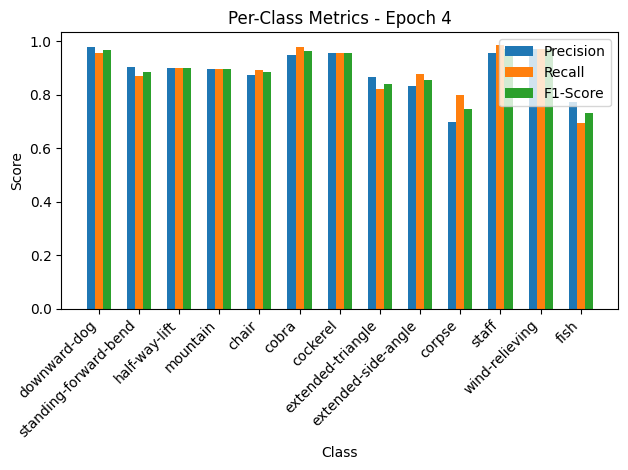

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.95it/s, loss=0.302, accuracy=92.1]


Per-Class Metrics for Epoch 4:
downward-dog: Precision=0.96, Recall=0.98, F1-Score=0.97
standing-forward-bend: Precision=1.00, Recall=0.75, F1-Score=0.86
half-way-lift: Precision=0.90, Recall=0.95, F1-Score=0.92
mountain: Precision=0.90, Recall=0.96, F1-Score=0.93
chair: Precision=0.79, Recall=0.96, F1-Score=0.87
cobra: Precision=0.96, Recall=0.96, F1-Score=0.96
cockerel: Precision=0.88, Recall=1.00, F1-Score=0.94
extended-triangle: Precision=0.87, Recall=1.00, F1-Score=0.93
extended-side-angle: Precision=1.00, Recall=0.89, F1-Score=0.94
corpse: Precision=1.00, Recall=0.71, F1-Score=0.83
staff: Precision=0.94, Recall=0.94, F1-Score=0.94
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=0.84, Recall=0.94, F1-Score=0.89


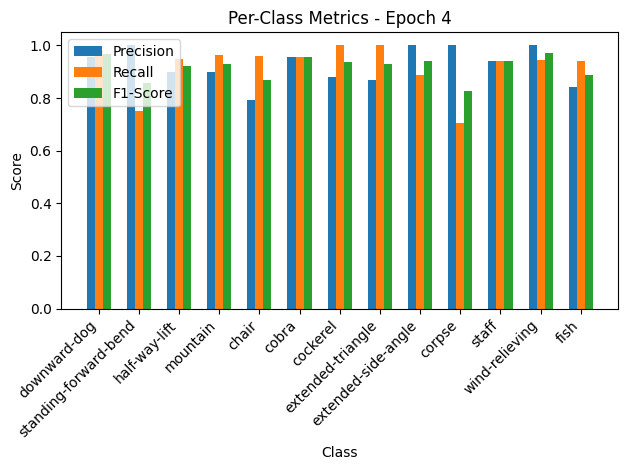


Epoch 5/50 Summary:
Train Loss: 0.3189 | Train Acc: 89.84% | Train Precision: 0.90 | Train Recall: 0.90 | Train F1: 0.90
Val Loss: 0.3098 | Val Acc: 92.07% | Val Precision: 0.93 | Val Recall: 0.92 | Val F1: 0.92
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model.pth
Checkpoint saved at epoch 5
New best model saved! Validation Loss: 0.3098

Epoch 6/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.87it/s, loss=0.273, accuracy=92.6]


Per-Class Metrics for Epoch 5:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.96, Recall=0.92, F1-Score=0.94
half-way-lift: Precision=0.93, Recall=0.96, F1-Score=0.95
mountain: Precision=0.92, Recall=0.94, F1-Score=0.93
chair: Precision=0.91, Recall=0.89, F1-Score=0.90
cobra: Precision=0.95, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.95, Recall=0.93, F1-Score=0.94
extended-triangle: Precision=0.92, Recall=0.90, F1-Score=0.91
extended-side-angle: Precision=0.87, Recall=0.92, F1-Score=0.89
corpse: Precision=0.82, Recall=0.79, F1-Score=0.80
staff: Precision=0.93, Recall=0.95, F1-Score=0.94
wind-relieving: Precision=0.97, Recall=1.00, F1-Score=0.99
fish: Precision=0.79, Recall=0.80, F1-Score=0.79


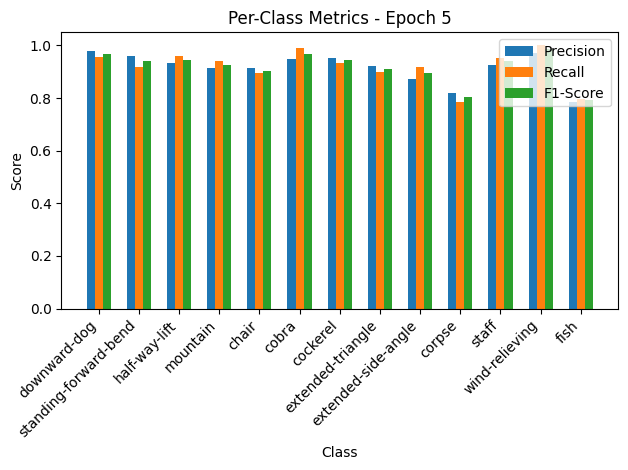

Validation: 100%|██████████| 21/21 [00:00<00:00, 27.88it/s, loss=0.344, accuracy=90.9]


Per-Class Metrics for Epoch 5:
downward-dog: Precision=1.00, Recall=0.96, F1-Score=0.98
standing-forward-bend: Precision=0.91, Recall=0.80, F1-Score=0.85
half-way-lift: Precision=0.97, Recall=0.84, F1-Score=0.90
mountain: Precision=0.90, Recall=0.96, F1-Score=0.93
chair: Precision=0.75, Recall=1.00, F1-Score=0.86
cobra: Precision=0.96, Recall=0.96, F1-Score=0.96
cockerel: Precision=0.88, Recall=1.00, F1-Score=0.94
extended-triangle: Precision=0.91, Recall=1.00, F1-Score=0.95
extended-side-angle: Precision=1.00, Recall=0.89, F1-Score=0.94
corpse: Precision=1.00, Recall=0.47, F1-Score=0.64
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=0.65, Recall=1.00, F1-Score=0.79


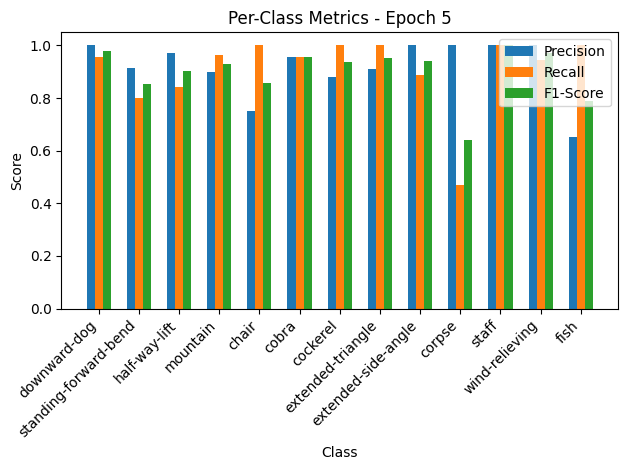


Epoch 6/50 Summary:
Train Loss: 0.2733 | Train Acc: 92.59% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.3525 | Val Acc: 90.85% | Val Precision: 0.92 | Val Recall: 0.91 | Val F1: 0.91

Epoch 7/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.84it/s, loss=0.27, accuracy=91.5]


Per-Class Metrics for Epoch 6:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.88, F1-Score=0.91
half-way-lift: Precision=0.91, Recall=0.93, F1-Score=0.92
mountain: Precision=0.91, Recall=0.90, F1-Score=0.90
chair: Precision=0.93, Recall=0.95, F1-Score=0.94
cobra: Precision=0.92, Recall=0.97, F1-Score=0.94
cockerel: Precision=0.94, Recall=0.98, F1-Score=0.96
extended-triangle: Precision=0.94, Recall=0.97, F1-Score=0.96
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=0.68, Recall=0.71, F1-Score=0.69
staff: Precision=0.98, Recall=0.97, F1-Score=0.98
wind-relieving: Precision=0.96, Recall=0.99, F1-Score=0.97
fish: Precision=0.74, Recall=0.67, F1-Score=0.70


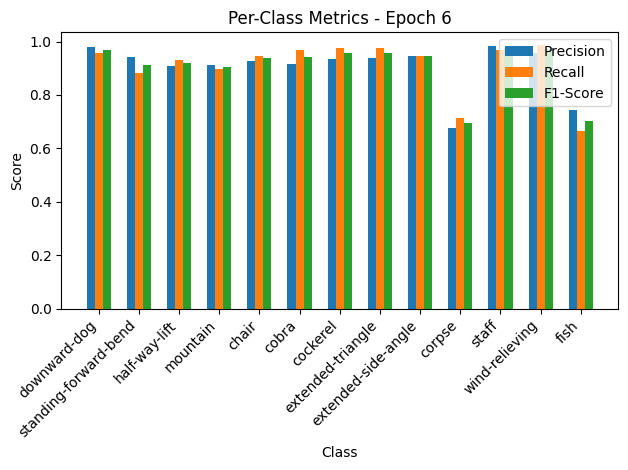

Validation: 100%|██████████| 21/21 [00:00<00:00, 28.84it/s, loss=0.289, accuracy=92.1]


Per-Class Metrics for Epoch 6:
downward-dog: Precision=1.00, Recall=0.96, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.75, F1-Score=0.85
half-way-lift: Precision=0.90, Recall=0.95, F1-Score=0.92
mountain: Precision=0.79, Recall=0.96, F1-Score=0.87
chair: Precision=0.92, Recall=1.00, F1-Score=0.96
cobra: Precision=1.00, Recall=0.96, F1-Score=0.98
cockerel: Precision=0.92, Recall=1.00, F1-Score=0.96
extended-triangle: Precision=0.87, Recall=1.00, F1-Score=0.93
extended-side-angle: Precision=1.00, Recall=0.94, F1-Score=0.97
corpse: Precision=0.70, Recall=0.94, F1-Score=0.80
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=1.00, Recall=0.59, F1-Score=0.74


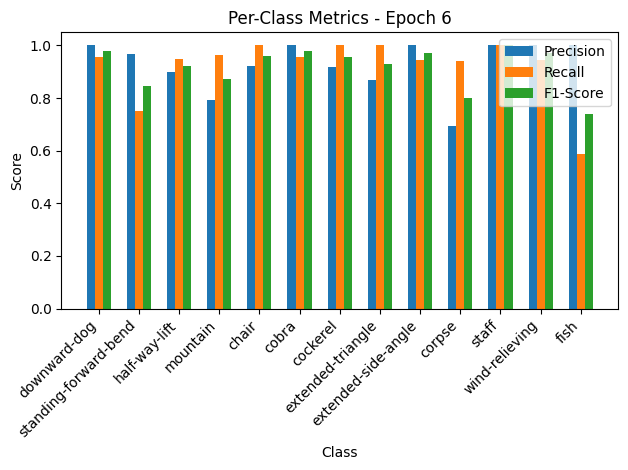


Epoch 7/50 Summary:
Train Loss: 0.2703 | Train Acc: 91.52% | Train Precision: 0.92 | Train Recall: 0.92 | Train F1: 0.91
Val Loss: 0.2965 | Val Acc: 92.07% | Val Precision: 0.93 | Val Recall: 0.92 | Val F1: 0.92
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model.pth
Checkpoint saved at epoch 7
New best model saved! Validation Loss: 0.2965

Epoch 8/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  8.12it/s, loss=0.22, accuracy=93.7]


Per-Class Metrics for Epoch 7:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.96, Recall=0.92, F1-Score=0.94
half-way-lift: Precision=0.93, Recall=0.93, F1-Score=0.93
mountain: Precision=0.92, Recall=0.95, F1-Score=0.94
chair: Precision=0.95, Recall=0.93, F1-Score=0.94
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.94, Recall=0.94, F1-Score=0.94
extended-side-angle: Precision=0.92, Recall=0.93, F1-Score=0.93
corpse: Precision=0.84, Recall=0.76, F1-Score=0.80
staff: Precision=0.97, Recall=0.98, F1-Score=0.98
wind-relieving: Precision=0.97, Recall=1.00, F1-Score=0.99
fish: Precision=0.77, Recall=0.83, F1-Score=0.80


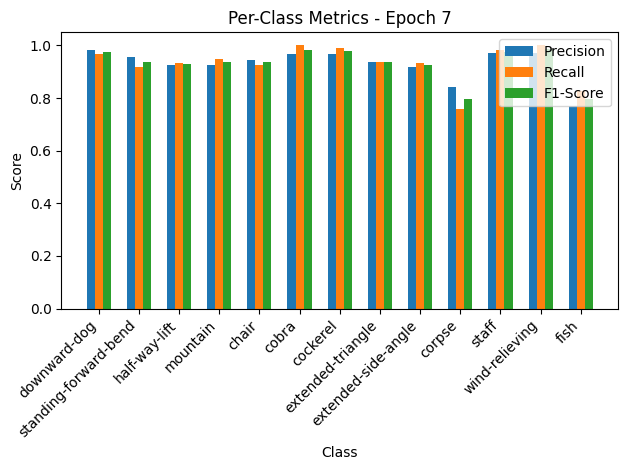

Validation: 100%|██████████| 21/21 [00:00<00:00, 31.53it/s, loss=0.326, accuracy=92.4]


Per-Class Metrics for Epoch 7:
downward-dog: Precision=0.96, Recall=1.00, F1-Score=0.98
standing-forward-bend: Precision=0.90, Recall=0.88, F1-Score=0.89
half-way-lift: Precision=0.97, Recall=0.84, F1-Score=0.90
mountain: Precision=0.93, Recall=0.93, F1-Score=0.93
chair: Precision=0.83, Recall=1.00, F1-Score=0.91
cobra: Precision=1.00, Recall=0.96, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.87, Recall=1.00, F1-Score=0.93
extended-side-angle: Precision=1.00, Recall=0.89, F1-Score=0.94
corpse: Precision=1.00, Recall=0.53, F1-Score=0.69
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=0.71, Recall=1.00, F1-Score=0.83


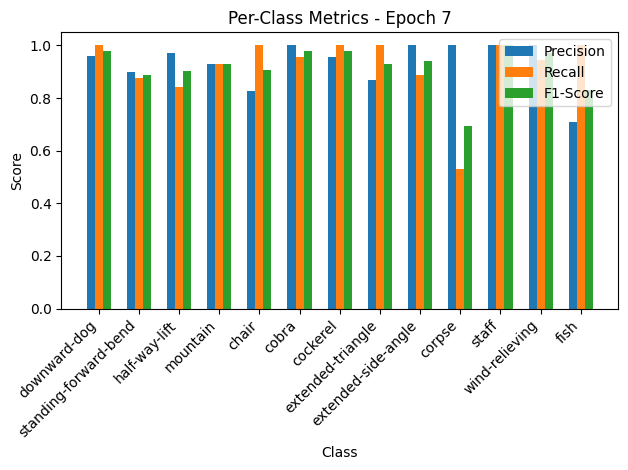


Epoch 8/50 Summary:
Train Loss: 0.2208 | Train Acc: 93.66% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.3336 | Val Acc: 92.38% | Val Precision: 0.93 | Val Recall: 0.92 | Val F1: 0.92

Epoch 9/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.48it/s, loss=0.246, accuracy=93.4]


Per-Class Metrics for Epoch 8:
downward-dog: Precision=0.97, Recall=0.96, F1-Score=0.96
standing-forward-bend: Precision=0.96, Recall=0.93, F1-Score=0.95
half-way-lift: Precision=0.92, Recall=0.95, F1-Score=0.93
mountain: Precision=0.91, Recall=0.92, F1-Score=0.92
chair: Precision=0.92, Recall=0.91, F1-Score=0.92
cobra: Precision=0.95, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.95, Recall=0.94, F1-Score=0.95
extended-triangle: Precision=0.97, Recall=0.91, F1-Score=0.94
extended-side-angle: Precision=0.94, Recall=0.99, F1-Score=0.96
corpse: Precision=0.81, Recall=0.84, F1-Score=0.83
staff: Precision=0.94, Recall=0.97, F1-Score=0.95
wind-relieving: Precision=0.97, Recall=1.00, F1-Score=0.99
fish: Precision=0.84, Recall=0.77, F1-Score=0.80


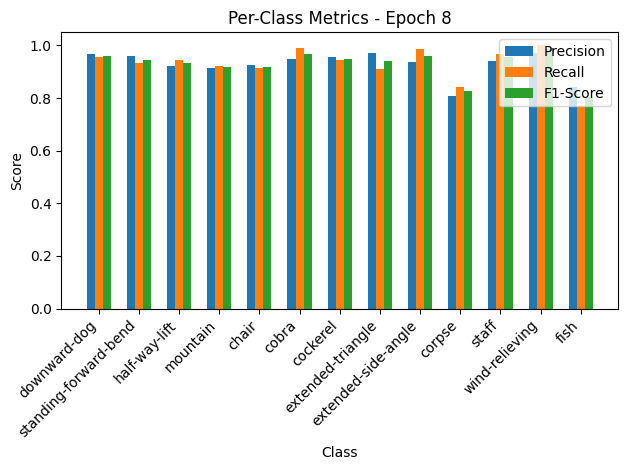

Validation: 100%|██████████| 21/21 [00:00<00:00, 28.39it/s, loss=0.364, accuracy=92.7]


Per-Class Metrics for Epoch 8:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.78, F1-Score=0.86
half-way-lift: Precision=0.84, Recall=0.97, F1-Score=0.90
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.89, Recall=1.00, F1-Score=0.94
cobra: Precision=1.00, Recall=0.91, F1-Score=0.95
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.80, Recall=1.00, F1-Score=0.89
extended-side-angle: Precision=1.00, Recall=0.78, F1-Score=0.88
corpse: Precision=0.93, Recall=0.76, F1-Score=0.84
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=0.84, Recall=0.94, F1-Score=0.89


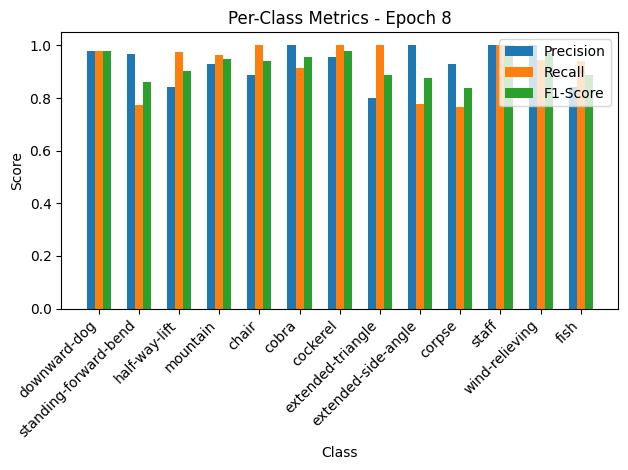


Epoch 9/50 Summary:
Train Loss: 0.2461 | Train Acc: 93.35% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.3726 | Val Acc: 92.68% | Val Precision: 0.93 | Val Recall: 0.93 | Val F1: 0.93

Epoch 10/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.63it/s, loss=0.169, accuracy=94.6]


Per-Class Metrics for Epoch 9:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.96, Recall=0.94, F1-Score=0.95
half-way-lift: Precision=0.93, Recall=0.97, F1-Score=0.95
mountain: Precision=0.95, Recall=0.97, F1-Score=0.96
chair: Precision=0.93, Recall=0.90, F1-Score=0.92
cobra: Precision=0.95, Recall=0.97, F1-Score=0.96
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.96, Recall=0.96, F1-Score=0.96
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=0.83, Recall=0.81, F1-Score=0.82
staff: Precision=0.98, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.81, Recall=0.83, F1-Score=0.82


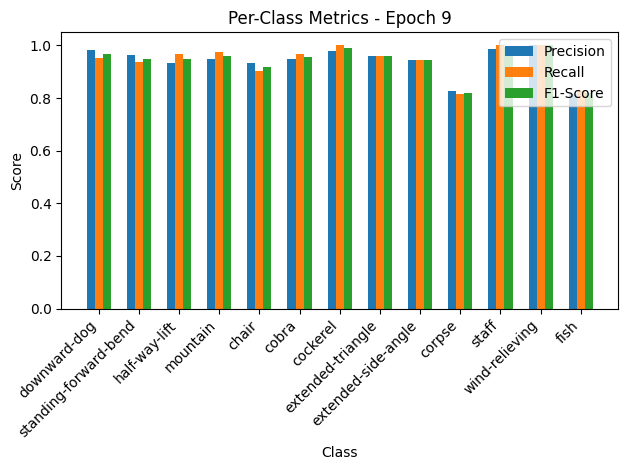

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.69it/s, loss=0.269, accuracy=92.7]


Per-Class Metrics for Epoch 9:
downward-dog: Precision=0.98, Recall=1.00, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.78, F1-Score=0.86
half-way-lift: Precision=0.86, Recall=0.95, F1-Score=0.90
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.89, Recall=1.00, F1-Score=0.94
cobra: Precision=1.00, Recall=0.96, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.83, Recall=1.00, F1-Score=0.91
extended-side-angle: Precision=1.00, Recall=0.83, F1-Score=0.91
corpse: Precision=1.00, Recall=0.59, F1-Score=0.74
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=0.74, Recall=1.00, F1-Score=0.85


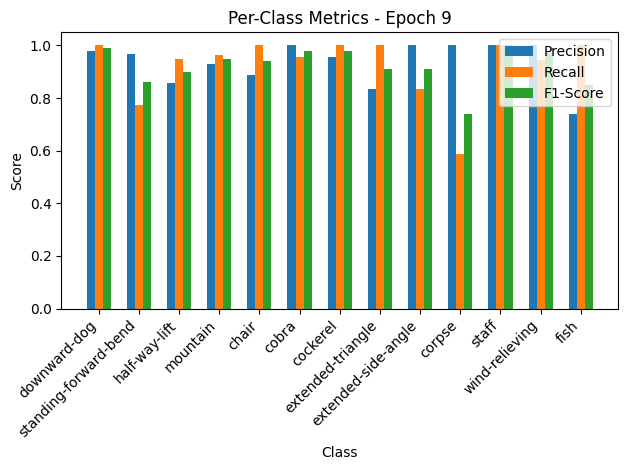


Epoch 10/50 Summary:
Train Loss: 0.1696 | Train Acc: 94.58% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.2760 | Val Acc: 92.68% | Val Precision: 0.94 | Val Recall: 0.93 | Val F1: 0.92
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model.pth
Checkpoint saved at epoch 10
New best model saved! Validation Loss: 0.2760

Epoch 11/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  8.08it/s, loss=0.21, accuracy=94.1]


Per-Class Metrics for Epoch 10:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.96, Recall=0.94, F1-Score=0.95
half-way-lift: Precision=0.94, Recall=0.93, F1-Score=0.94
mountain: Precision=0.95, Recall=0.96, F1-Score=0.95
chair: Precision=0.89, Recall=0.94, F1-Score=0.91
cobra: Precision=0.95, Recall=0.97, F1-Score=0.96
cockerel: Precision=0.95, Recall=0.98, F1-Score=0.96
extended-triangle: Precision=0.94, Recall=0.95, F1-Score=0.94
extended-side-angle: Precision=0.94, Recall=0.92, F1-Score=0.93
corpse: Precision=0.86, Recall=0.84, F1-Score=0.85
staff: Precision=0.96, Recall=1.00, F1-Score=0.98
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.87, Recall=0.86, F1-Score=0.86


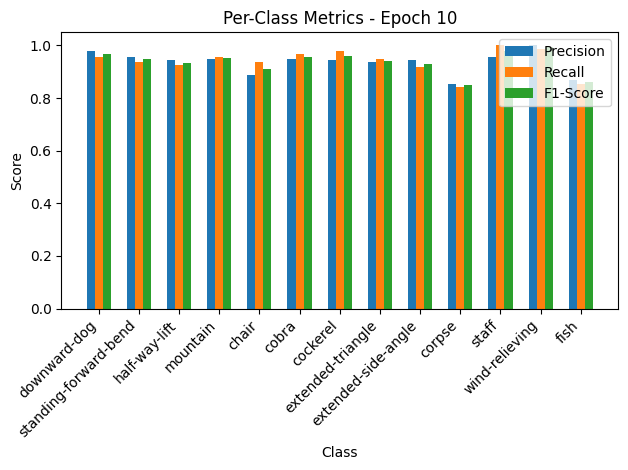

Validation: 100%|██████████| 21/21 [00:00<00:00, 28.06it/s, loss=0.462, accuracy=91.2]


Per-Class Metrics for Epoch 10:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.84, Recall=0.90, F1-Score=0.87
half-way-lift: Precision=0.92, Recall=0.95, F1-Score=0.94
mountain: Precision=1.00, Recall=0.82, F1-Score=0.90
chair: Precision=0.92, Recall=1.00, F1-Score=0.96
cobra: Precision=1.00, Recall=0.96, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.69, Recall=1.00, F1-Score=0.82
extended-side-angle: Precision=1.00, Recall=0.56, F1-Score=0.71
corpse: Precision=1.00, Recall=0.53, F1-Score=0.69
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=0.71, Recall=1.00, F1-Score=0.83


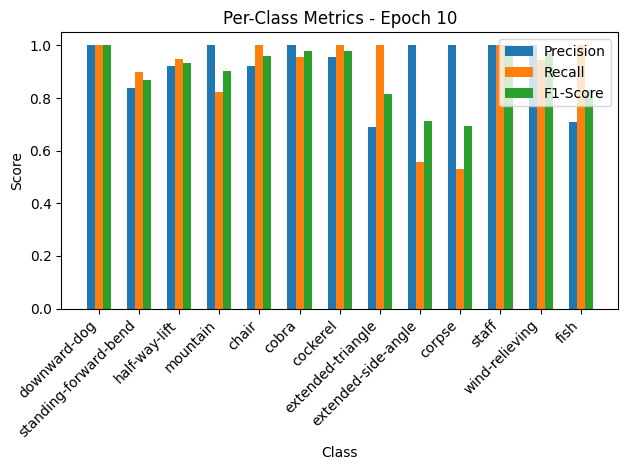


Epoch 11/50 Summary:
Train Loss: 0.2102 | Train Acc: 94.12% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.4736 | Val Acc: 91.16% | Val Precision: 0.93 | Val Recall: 0.91 | Val F1: 0.91

Epoch 12/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.61it/s, loss=0.198, accuracy=95.2]


Per-Class Metrics for Epoch 11:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.96, Recall=0.92, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.96, F1-Score=0.95
mountain: Precision=0.95, Recall=0.99, F1-Score=0.97
chair: Precision=0.96, Recall=0.95, F1-Score=0.95
cobra: Precision=0.99, Recall=0.99, F1-Score=0.99
cockerel: Precision=0.98, Recall=0.98, F1-Score=0.98
extended-triangle: Precision=0.91, Recall=0.92, F1-Score=0.92
extended-side-angle: Precision=0.90, Recall=0.89, F1-Score=0.90
corpse: Precision=0.87, Recall=0.87, F1-Score=0.87
staff: Precision=1.00, Recall=0.98, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.87, Recall=0.88, F1-Score=0.88


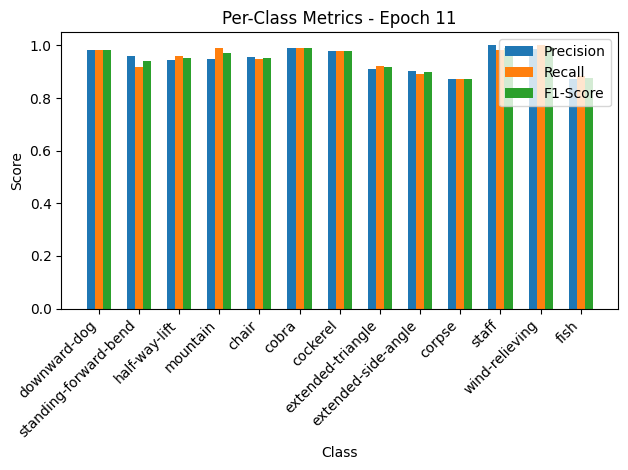

Validation: 100%|██████████| 21/21 [00:00<00:00, 28.84it/s, loss=0.354, accuracy=92.4]


Per-Class Metrics for Epoch 11:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.84, Recall=0.90, F1-Score=0.87
half-way-lift: Precision=0.89, Recall=0.87, F1-Score=0.88
mountain: Precision=0.90, Recall=0.96, F1-Score=0.93
chair: Precision=1.00, Recall=0.92, F1-Score=0.96
cobra: Precision=1.00, Recall=0.96, F1-Score=0.98
cockerel: Precision=0.92, Recall=1.00, F1-Score=0.96
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.65, Recall=1.00, F1-Score=0.79
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.89, F1-Score=0.94
fish: Precision=1.00, Recall=0.53, F1-Score=0.69


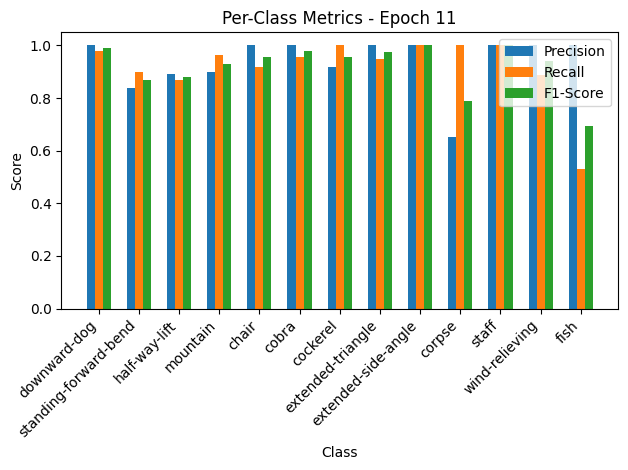


Epoch 12/50 Summary:
Train Loss: 0.1981 | Train Acc: 95.19% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.3622 | Val Acc: 92.38% | Val Precision: 0.94 | Val Recall: 0.92 | Val F1: 0.92

Epoch 13/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.72it/s, loss=0.175, accuracy=94.7]


Per-Class Metrics for Epoch 12:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.93, Recall=0.91, F1-Score=0.92
half-way-lift: Precision=0.90, Recall=0.93, F1-Score=0.91
mountain: Precision=0.96, Recall=0.97, F1-Score=0.96
chair: Precision=0.97, Recall=0.95, F1-Score=0.96
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.98, Recall=0.98, F1-Score=0.98
extended-triangle: Precision=0.94, Recall=0.92, F1-Score=0.93
extended-side-angle: Precision=0.95, Recall=0.97, F1-Score=0.96
corpse: Precision=0.90, Recall=0.89, F1-Score=0.89
staff: Precision=0.98, Recall=0.98, F1-Score=0.98
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.87, Recall=0.87, F1-Score=0.87


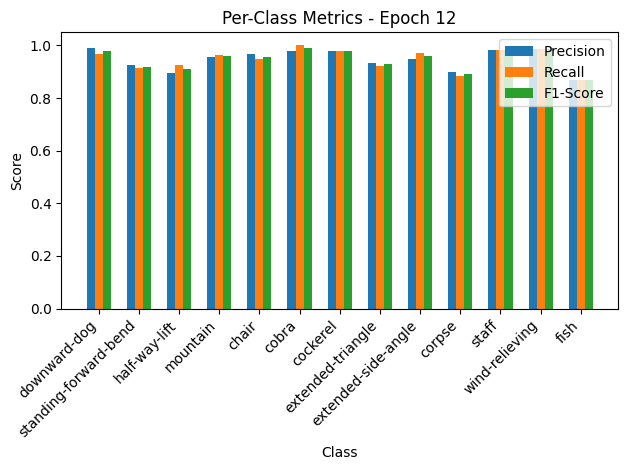

Validation: 100%|██████████| 21/21 [00:00<00:00, 31.17it/s, loss=0.29, accuracy=93.9]


Per-Class Metrics for Epoch 12:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.78, F1-Score=0.86
half-way-lift: Precision=0.86, Recall=0.95, F1-Score=0.90
mountain: Precision=0.90, Recall=0.96, F1-Score=0.93
chair: Precision=0.92, Recall=1.00, F1-Score=0.96
cobra: Precision=1.00, Recall=0.96, F1-Score=0.98
cockerel: Precision=0.92, Recall=1.00, F1-Score=0.96
extended-triangle: Precision=0.95, Recall=1.00, F1-Score=0.98
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.84, Recall=0.94, F1-Score=0.89
staff: Precision=0.94, Recall=1.00, F1-Score=0.97
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=1.00, Recall=0.76, F1-Score=0.87


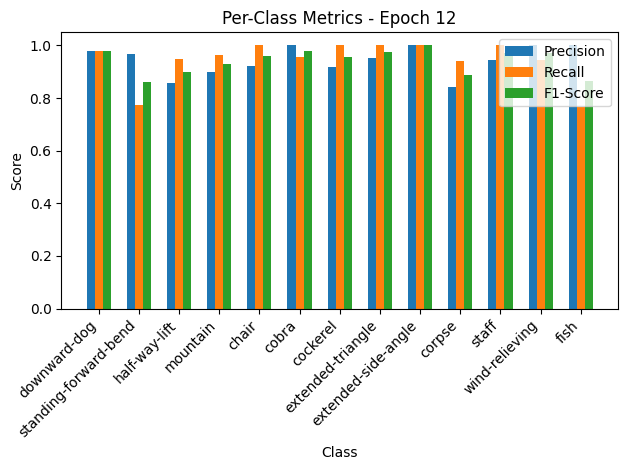


Epoch 13/50 Summary:
Train Loss: 0.1754 | Train Acc: 94.73% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.2970 | Val Acc: 93.90% | Val Precision: 0.94 | Val Recall: 0.94 | Val F1: 0.94

Epoch 14/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.48it/s, loss=0.166, accuracy=95.6]


Per-Class Metrics for Epoch 13:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.98, Recall=0.93, F1-Score=0.96
half-way-lift: Precision=0.92, Recall=0.97, F1-Score=0.95
mountain: Precision=0.94, Recall=0.94, F1-Score=0.94
chair: Precision=0.95, Recall=0.93, F1-Score=0.94
cobra: Precision=0.96, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.98, Recall=0.98, F1-Score=0.98
extended-triangle: Precision=0.96, Recall=0.95, F1-Score=0.95
extended-side-angle: Precision=0.95, Recall=0.96, F1-Score=0.95
corpse: Precision=0.93, Recall=0.91, F1-Score=0.92
staff: Precision=0.96, Recall=1.00, F1-Score=0.98
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.91, Recall=0.91, F1-Score=0.91


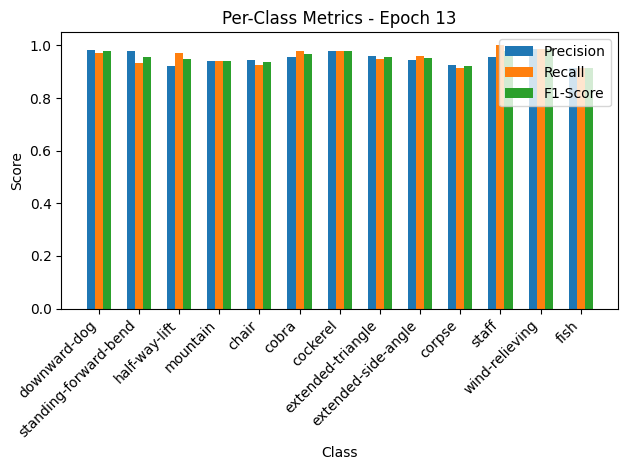

Validation: 100%|██████████| 21/21 [00:00<00:00, 28.16it/s, loss=0.214, accuracy=94.5]


Per-Class Metrics for Epoch 13:
downward-dog: Precision=0.96, Recall=0.98, F1-Score=0.97
standing-forward-bend: Precision=0.93, Recall=0.93, F1-Score=0.93
half-way-lift: Precision=0.94, Recall=0.84, F1-Score=0.89
mountain: Precision=0.90, Recall=1.00, F1-Score=0.95
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=0.96, Recall=0.96, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=0.65, F1-Score=0.79
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=0.74, Recall=1.00, F1-Score=0.85


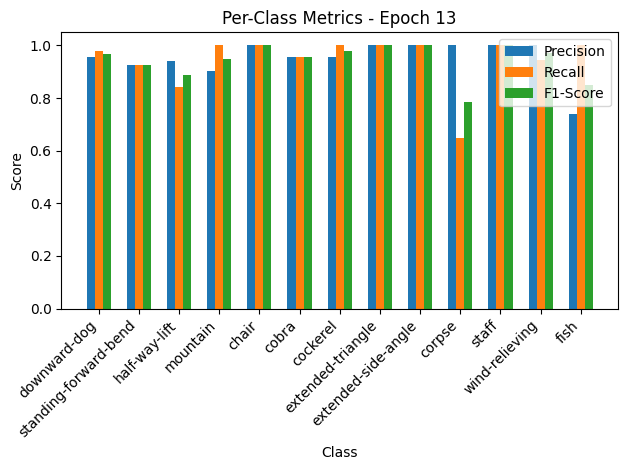


Epoch 14/50 Summary:
Train Loss: 0.1660 | Train Acc: 95.57% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.2194 | Val Acc: 94.51% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.94
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model.pth
Checkpoint saved at epoch 14
New best model saved! Validation Loss: 0.2194

Epoch 15/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  9.00it/s, loss=0.164, accuracy=96.3]


Per-Class Metrics for Epoch 14:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.97, F1-Score=0.97
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.97, Recall=0.96, F1-Score=0.96
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.98, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.91, F1-Score=0.94
extended-side-angle: Precision=0.91, Recall=0.97, F1-Score=0.94
corpse: Precision=0.86, Recall=0.91, F1-Score=0.89
staff: Precision=0.98, Recall=0.98, F1-Score=0.98
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.89, Recall=0.84, F1-Score=0.87


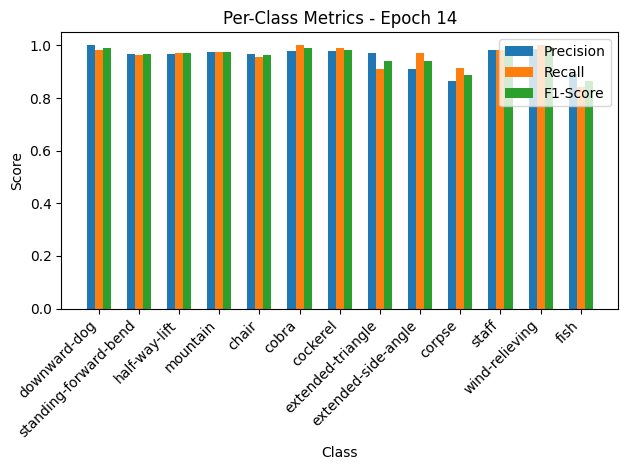

Validation: 100%|██████████| 21/21 [00:00<00:00, 23.94it/s, loss=0.278, accuracy=93.9]


Per-Class Metrics for Epoch 14:
downward-dog: Precision=0.98, Recall=1.00, F1-Score=0.99
standing-forward-bend: Precision=0.87, Recall=0.85, F1-Score=0.86
half-way-lift: Precision=0.94, Recall=0.87, F1-Score=0.90
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.86, Recall=1.00, F1-Score=0.92
cobra: Precision=1.00, Recall=0.91, F1-Score=0.95
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.91, Recall=1.00, F1-Score=0.95
extended-side-angle: Precision=1.00, Recall=0.89, F1-Score=0.94
corpse: Precision=0.89, Recall=1.00, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.89, F1-Score=0.94
fish: Precision=0.94, Recall=0.88, F1-Score=0.91


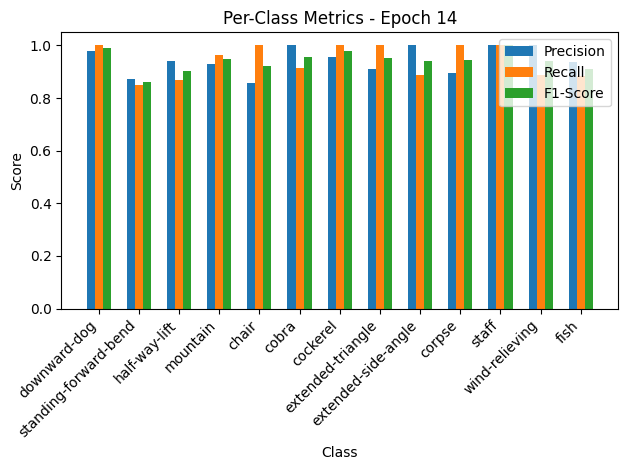


Epoch 15/50 Summary:
Train Loss: 0.1641 | Train Acc: 96.33% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.2849 | Val Acc: 93.90% | Val Precision: 0.94 | Val Recall: 0.94 | Val F1: 0.94

Epoch 16/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  9.07it/s, loss=0.171, accuracy=95.2]


Per-Class Metrics for Epoch 15:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.95, Recall=0.92, F1-Score=0.93
half-way-lift: Precision=0.93, Recall=0.93, F1-Score=0.93
mountain: Precision=0.95, Recall=0.96, F1-Score=0.95
chair: Precision=0.94, Recall=0.96, F1-Score=0.95
cobra: Precision=0.98, Recall=0.97, F1-Score=0.97
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.95, F1-Score=0.96
extended-side-angle: Precision=0.95, Recall=0.96, F1-Score=0.95
corpse: Precision=0.88, Recall=0.90, F1-Score=0.89
staff: Precision=0.98, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.91, Recall=0.88, F1-Score=0.90


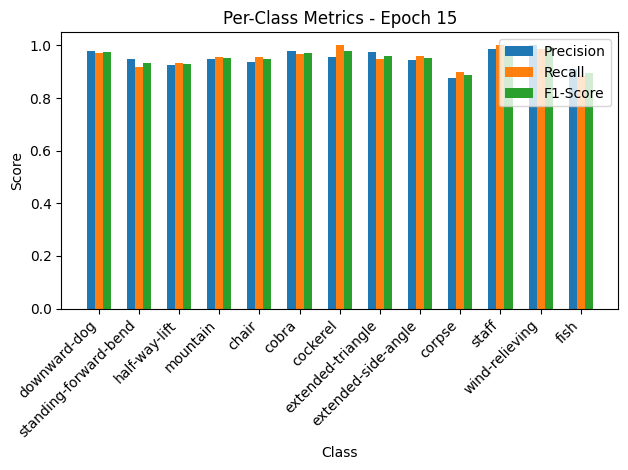

Validation: 100%|██████████| 21/21 [00:00<00:00, 30.28it/s, loss=0.201, accuracy=94.2]


Per-Class Metrics for Epoch 15:
downward-dog: Precision=1.00, Recall=0.96, F1-Score=0.98
standing-forward-bend: Precision=0.88, Recall=0.88, F1-Score=0.88
half-way-lift: Precision=0.94, Recall=0.89, F1-Score=0.92
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.92, Recall=1.00, F1-Score=0.96
cobra: Precision=1.00, Recall=0.96, F1-Score=0.98
cockerel: Precision=0.88, Recall=1.00, F1-Score=0.94
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=1.00, Recall=0.71, F1-Score=0.83
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=0.81, Recall=1.00, F1-Score=0.89


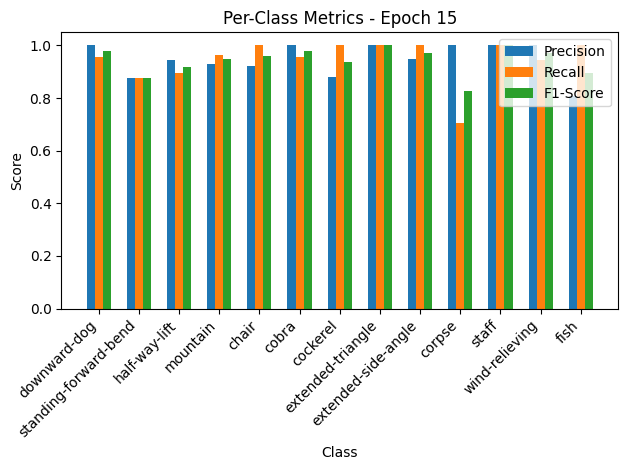


Epoch 16/50 Summary:
Train Loss: 0.1709 | Train Acc: 95.19% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.2063 | Val Acc: 94.21% | Val Precision: 0.95 | Val Recall: 0.94 | Val F1: 0.94
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model.pth
Checkpoint saved at epoch 16
New best model saved! Validation Loss: 0.2063

Epoch 17/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.87it/s, loss=0.105, accuracy=97.2]


Per-Class Metrics for Epoch 16:
downward-dog: Precision=0.97, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.96, Recall=0.97, F1-Score=0.97
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=0.98, Recall=0.97, F1-Score=0.97
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=1.00, Recall=0.98, F1-Score=0.99
extended-triangle: Precision=0.96, Recall=0.96, F1-Score=0.96
extended-side-angle: Precision=0.95, Recall=0.97, F1-Score=0.96
corpse: Precision=0.96, Recall=0.93, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.94, F1-Score=0.94


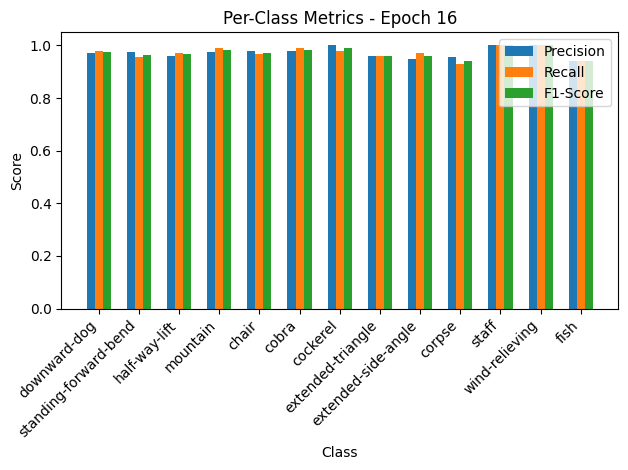

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.90it/s, loss=0.358, accuracy=93]


Per-Class Metrics for Epoch 16:
downward-dog: Precision=1.00, Recall=0.96, F1-Score=0.98
standing-forward-bend: Precision=0.80, Recall=0.82, F1-Score=0.81
half-way-lift: Precision=0.92, Recall=0.89, F1-Score=0.91
mountain: Precision=1.00, Recall=0.82, F1-Score=0.90
chair: Precision=0.77, Recall=1.00, F1-Score=0.87
cobra: Precision=1.00, Recall=0.96, F1-Score=0.98
cockerel: Precision=0.92, Recall=1.00, F1-Score=0.96
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.90, Recall=1.00, F1-Score=0.95
corpse: Precision=0.94, Recall=0.94, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=1.00, Recall=0.94, F1-Score=0.97


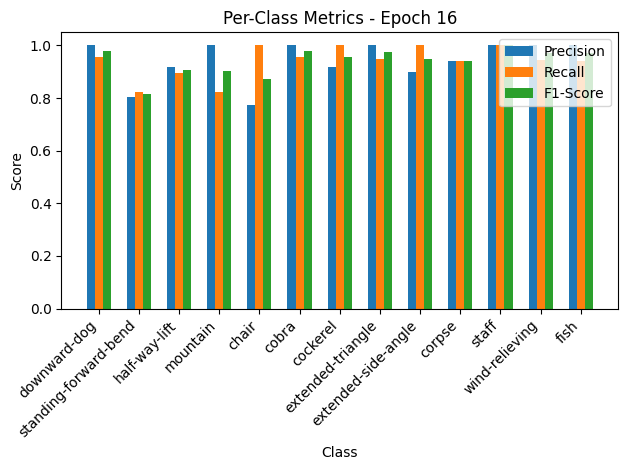


Epoch 17/50 Summary:
Train Loss: 0.1050 | Train Acc: 97.25% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.3669 | Val Acc: 92.99% | Val Precision: 0.94 | Val Recall: 0.93 | Val F1: 0.93

Epoch 18/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.52it/s, loss=0.149, accuracy=96.6]


Per-Class Metrics for Epoch 17:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.96, Recall=0.95, F1-Score=0.96
half-way-lift: Precision=0.96, Recall=0.95, F1-Score=0.96
mountain: Precision=0.96, Recall=0.98, F1-Score=0.97
chair: Precision=0.96, Recall=0.95, F1-Score=0.95
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.96, Recall=0.96, F1-Score=0.96
extended-side-angle: Precision=0.96, Recall=0.95, F1-Score=0.95
corpse: Precision=0.94, Recall=0.93, F1-Score=0.94
staff: Precision=1.00, Recall=0.98, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.91, Recall=0.93, F1-Score=0.92


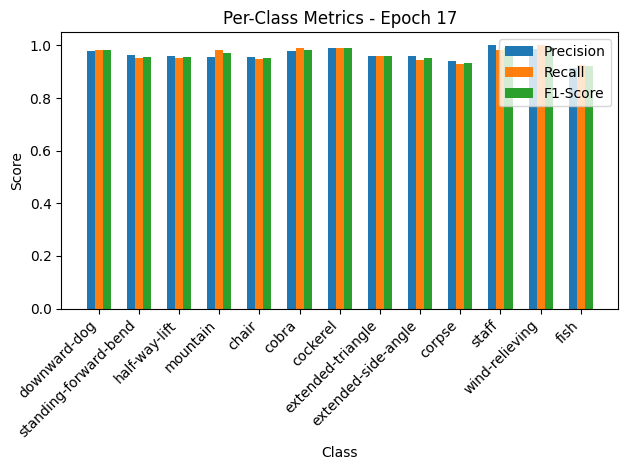

Validation: 100%|██████████| 21/21 [00:00<00:00, 22.55it/s, loss=0.2, accuracy=94.8]


Per-Class Metrics for Epoch 17:
downward-dog: Precision=0.98, Recall=1.00, F1-Score=0.99
standing-forward-bend: Precision=0.92, Recall=0.85, F1-Score=0.88
half-way-lift: Precision=0.92, Recall=0.89, F1-Score=0.91
mountain: Precision=0.96, Recall=0.89, F1-Score=0.93
chair: Precision=0.80, Recall=1.00, F1-Score=0.89
cobra: Precision=1.00, Recall=0.96, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.89, Recall=1.00, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=1.00, Recall=0.88, F1-Score=0.94


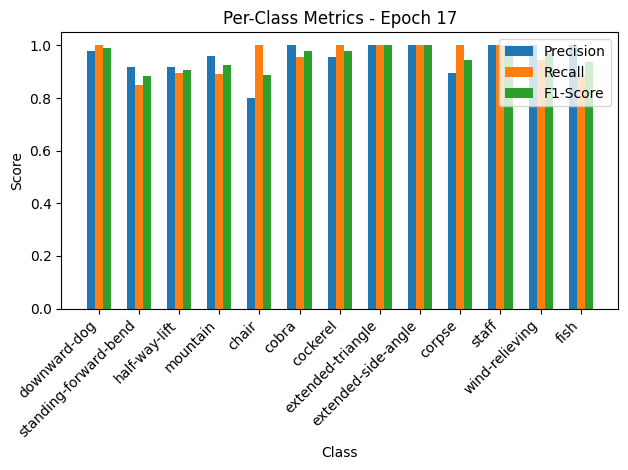


Epoch 18/50 Summary:
Train Loss: 0.1498 | Train Acc: 96.56% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.2050 | Val Acc: 94.82% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model.pth
Checkpoint saved at epoch 18
New best model saved! Validation Loss: 0.2050

Epoch 19/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.50it/s, loss=0.103, accuracy=97.5]


Per-Class Metrics for Epoch 18:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.98, F1-Score=0.98
mountain: Precision=0.97, Recall=0.98, F1-Score=0.98
chair: Precision=0.98, Recall=0.97, F1-Score=0.97
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.97, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.92, Recall=0.93, F1-Score=0.92
staff: Precision=0.98, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.91, F1-Score=0.92


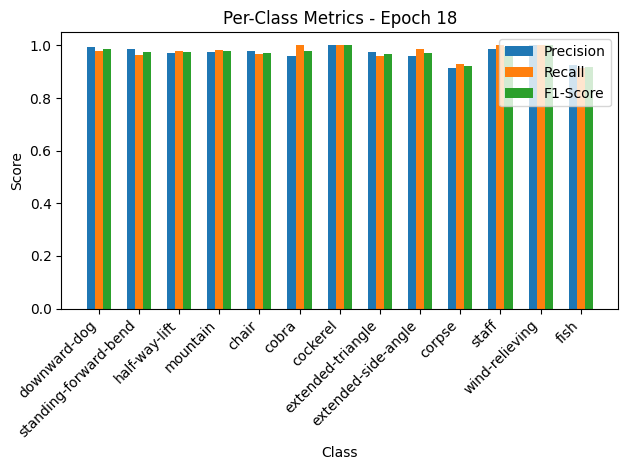

Validation: 100%|██████████| 21/21 [00:00<00:00, 26.92it/s, loss=0.341, accuracy=92.4]


Per-Class Metrics for Epoch 18:
downward-dog: Precision=0.96, Recall=0.93, F1-Score=0.95
standing-forward-bend: Precision=0.89, Recall=0.82, F1-Score=0.86
half-way-lift: Precision=0.89, Recall=0.87, F1-Score=0.88
mountain: Precision=0.90, Recall=0.96, F1-Score=0.93
chair: Precision=0.86, Recall=1.00, F1-Score=0.92
cobra: Precision=1.00, Recall=0.91, F1-Score=0.95
cockerel: Precision=0.92, Recall=1.00, F1-Score=0.96
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=1.00, Recall=0.65, F1-Score=0.79
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=0.77, Recall=1.00, F1-Score=0.87


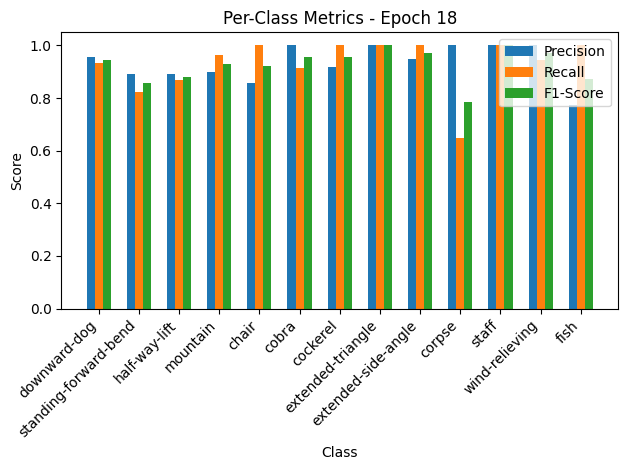


Epoch 19/50 Summary:
Train Loss: 0.1035 | Train Acc: 97.48% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.3493 | Val Acc: 92.38% | Val Precision: 0.93 | Val Recall: 0.92 | Val F1: 0.92

Epoch 20/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.44it/s, loss=0.0951, accuracy=97.4]


Per-Class Metrics for Epoch 19:
downward-dog: Precision=0.98, Recall=0.99, F1-Score=0.98
standing-forward-bend: Precision=0.98, Recall=0.97, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.96, F1-Score=0.97
mountain: Precision=0.96, Recall=0.98, F1-Score=0.97
chair: Precision=0.99, Recall=0.96, F1-Score=0.97
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.97, F1-Score=0.96
corpse: Precision=0.94, Recall=0.94, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.96, Recall=0.94, F1-Score=0.95


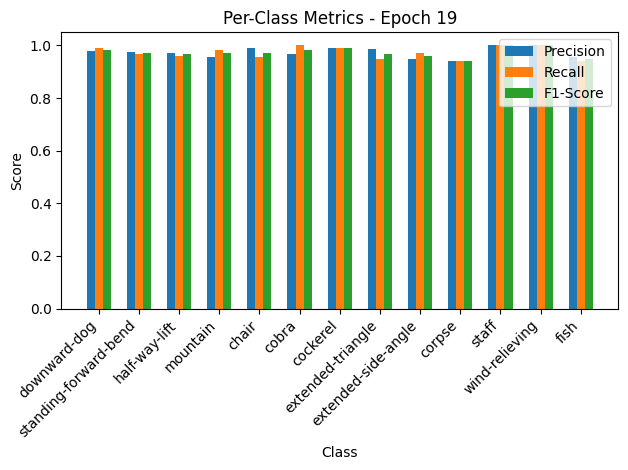

Validation: 100%|██████████| 21/21 [00:00<00:00, 30.83it/s, loss=0.326, accuracy=95.7]


Per-Class Metrics for Epoch 19:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.95, Recall=0.88, F1-Score=0.91
half-way-lift: Precision=0.93, Recall=0.97, F1-Score=0.95
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.96, Recall=1.00, F1-Score=0.98
cobra: Precision=1.00, Recall=0.96, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.93, Recall=0.76, F1-Score=0.84
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=0.80, Recall=0.94, F1-Score=0.86


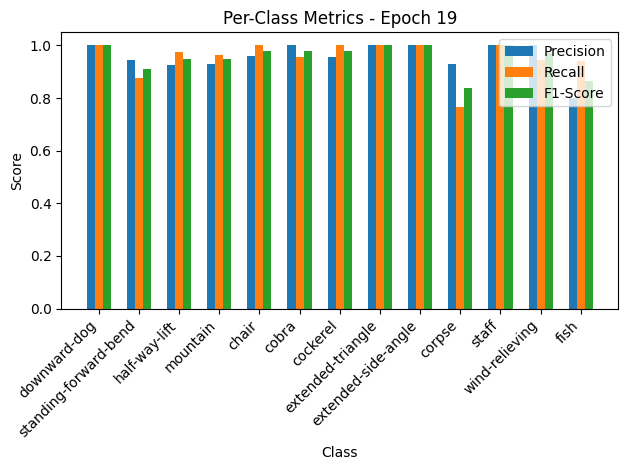


Epoch 20/50 Summary:
Train Loss: 0.0953 | Train Acc: 97.40% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.3341 | Val Acc: 95.73% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 21/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.23it/s, loss=0.12, accuracy=96.6]


Per-Class Metrics for Epoch 20:
downward-dog: Precision=0.98, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.94, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.97, Recall=0.96, F1-Score=0.97
chair: Precision=0.96, Recall=0.97, F1-Score=0.96
cobra: Precision=0.99, Recall=0.99, F1-Score=0.99
cockerel: Precision=0.98, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.94, Recall=0.97, F1-Score=0.95
corpse: Precision=0.95, Recall=0.90, F1-Score=0.93
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.92, Recall=0.96, F1-Score=0.94


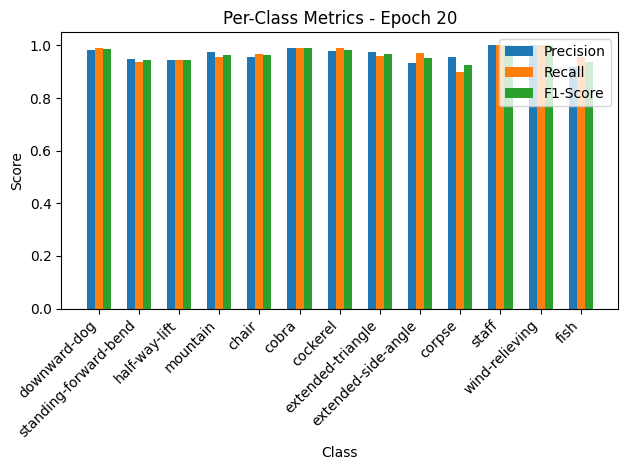

Validation: 100%|██████████| 21/21 [00:00<00:00, 21.77it/s, loss=0.335, accuracy=94.8]


Per-Class Metrics for Epoch 20:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.94, Recall=0.82, F1-Score=0.88
half-way-lift: Precision=0.90, Recall=0.95, F1-Score=0.92
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.86, Recall=1.00, F1-Score=0.92
cobra: Precision=1.00, Recall=0.96, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.84, Recall=0.94, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=0.93, Recall=0.82, F1-Score=0.88


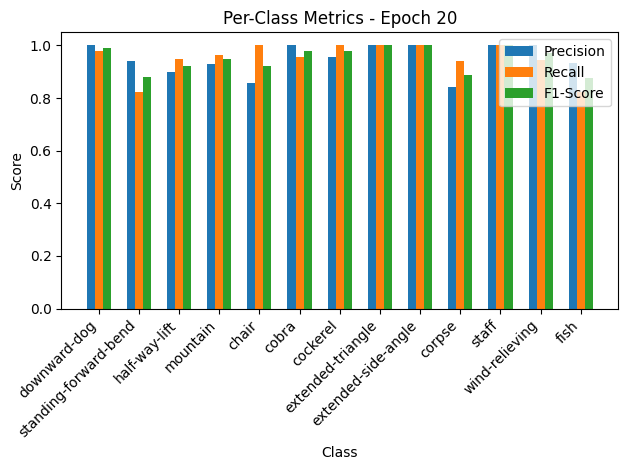


Epoch 21/50 Summary:
Train Loss: 0.1201 | Train Acc: 96.56% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.3428 | Val Acc: 94.82% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 22/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.57it/s, loss=0.122, accuracy=97.3]


Per-Class Metrics for Epoch 21:
downward-dog: Precision=0.97, Recall=0.99, F1-Score=0.98
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.96, Recall=0.98, F1-Score=0.97
mountain: Precision=0.97, Recall=1.00, F1-Score=0.98
chair: Precision=0.98, Recall=0.95, F1-Score=0.96
cobra: Precision=1.00, Recall=0.97, F1-Score=0.98
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.90, Recall=0.93, F1-Score=0.92
staff: Precision=1.00, Recall=0.98, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.90, F1-Score=0.91


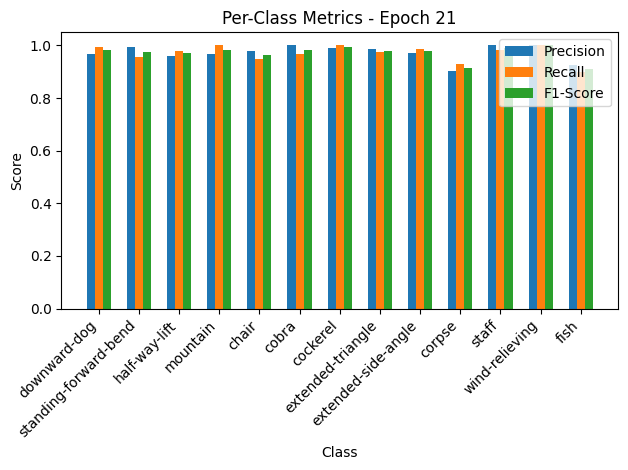

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.79it/s, loss=0.282, accuracy=93.9]


Per-Class Metrics for Epoch 21:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.80, Recall=0.90, F1-Score=0.85
half-way-lift: Precision=0.92, Recall=0.92, F1-Score=0.92
mountain: Precision=0.96, Recall=0.79, F1-Score=0.86
chair: Precision=0.92, Recall=1.00, F1-Score=0.96
cobra: Precision=1.00, Recall=0.96, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=1.00, Recall=0.76, F1-Score=0.87
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=0.85, Recall=1.00, F1-Score=0.92


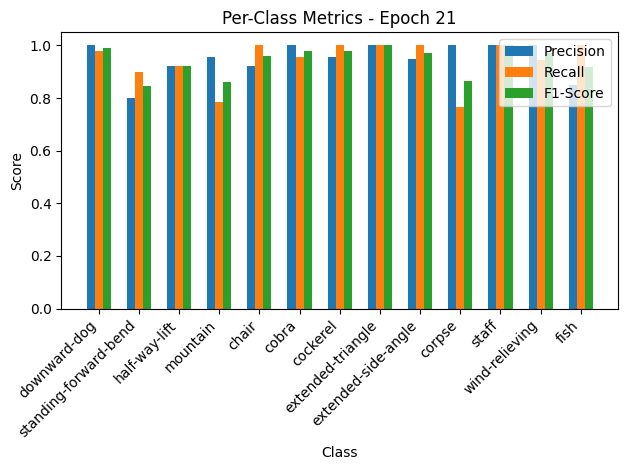


Epoch 22/50 Summary:
Train Loss: 0.1224 | Train Acc: 97.33% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.2890 | Val Acc: 93.90% | Val Precision: 0.94 | Val Recall: 0.94 | Val F1: 0.94

Epoch 23/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.26it/s, loss=0.144, accuracy=96.9]


Per-Class Metrics for Epoch 22:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.96, F1-Score=0.96
half-way-lift: Precision=0.95, Recall=0.97, F1-Score=0.96
mountain: Precision=0.98, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.96, F1-Score=0.96
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.94, Recall=0.94, F1-Score=0.94
extended-side-angle: Precision=0.93, Recall=0.92, F1-Score=0.93
corpse: Precision=0.97, Recall=0.97, F1-Score=0.97
staff: Precision=0.97, Recall=0.98, F1-Score=0.98
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.97, F1-Score=0.97


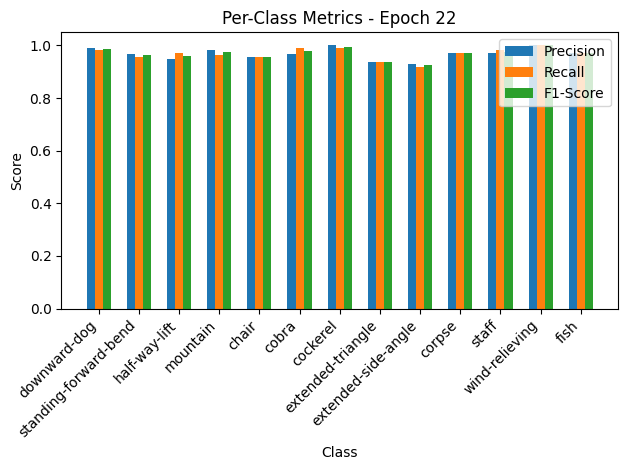

Validation: 100%|██████████| 21/21 [00:00<00:00, 30.49it/s, loss=0.244, accuracy=94.2]


Per-Class Metrics for Epoch 22:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.92, Recall=0.82, F1-Score=0.87
half-way-lift: Precision=0.90, Recall=0.92, F1-Score=0.91
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.86, Recall=1.00, F1-Score=0.92
cobra: Precision=1.00, Recall=0.91, F1-Score=0.95
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=1.00, F1-Score=0.98
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.93, Recall=0.82, F1-Score=0.88
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=0.89, Recall=0.94, F1-Score=0.91


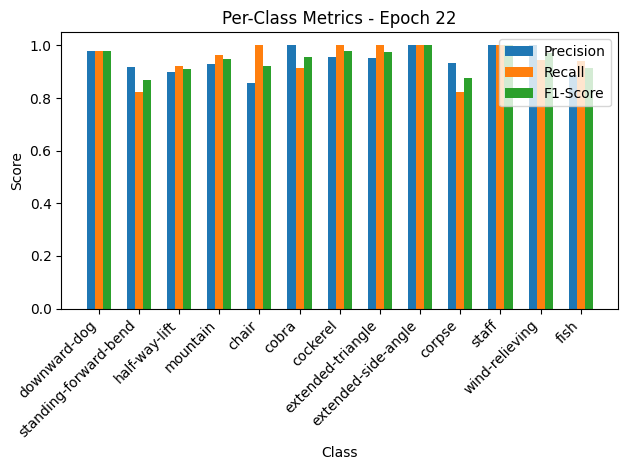


Epoch 23/50 Summary:
Train Loss: 0.1442 | Train Acc: 96.94% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.2498 | Val Acc: 94.21% | Val Precision: 0.94 | Val Recall: 0.94 | Val F1: 0.94

Epoch 24/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.76it/s, loss=0.052, accuracy=98.4]


Per-Class Metrics for Epoch 23:
downward-dog: Precision=0.97, Recall=0.99, F1-Score=0.98
standing-forward-bend: Precision=0.99, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=1.00, F1-Score=0.98
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.99, Recall=0.93, F1-Score=0.96
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.99, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=1.00, Recall=0.99, F1-Score=0.99


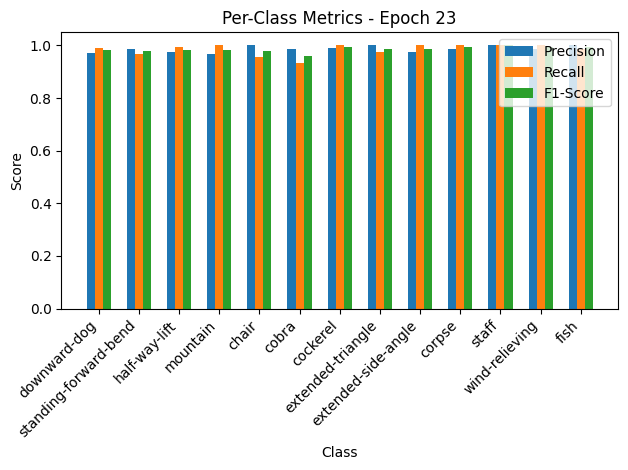

Validation: 100%|██████████| 21/21 [00:00<00:00, 24.67it/s, loss=0.218, accuracy=95.4]


Per-Class Metrics for Epoch 23:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.90, Recall=0.88, F1-Score=0.89
half-way-lift: Precision=0.95, Recall=0.92, F1-Score=0.93
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.89, Recall=1.00, F1-Score=0.94
cobra: Precision=1.00, Recall=0.91, F1-Score=0.95
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=1.00, F1-Score=0.98
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.94, Recall=0.94, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=1.00, Recall=0.94, F1-Score=0.97


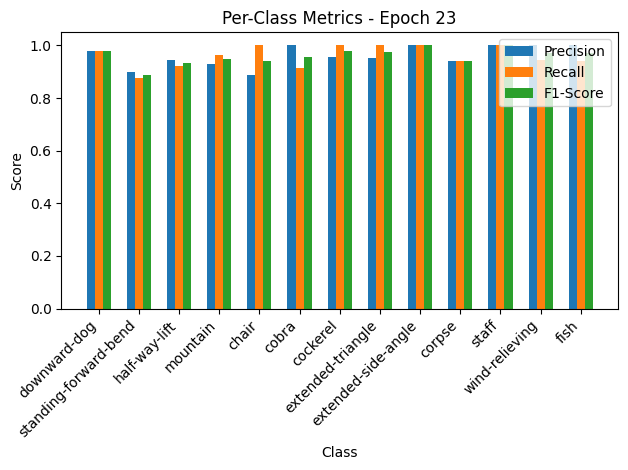


Epoch 24/50 Summary:
Train Loss: 0.0522 | Train Acc: 98.40% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.2230 | Val Acc: 95.43% | Val Precision: 0.96 | Val Recall: 0.95 | Val F1: 0.95

Epoch 25/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.67it/s, loss=0.0549, accuracy=97.9]


Per-Class Metrics for Epoch 24:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.96, Recall=0.97, F1-Score=0.96
half-way-lift: Precision=0.97, Recall=0.96, F1-Score=0.97
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.98, Recall=0.97, F1-Score=0.97
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.96, F1-Score=0.96
staff: Precision=0.98, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.96, Recall=0.97, F1-Score=0.96


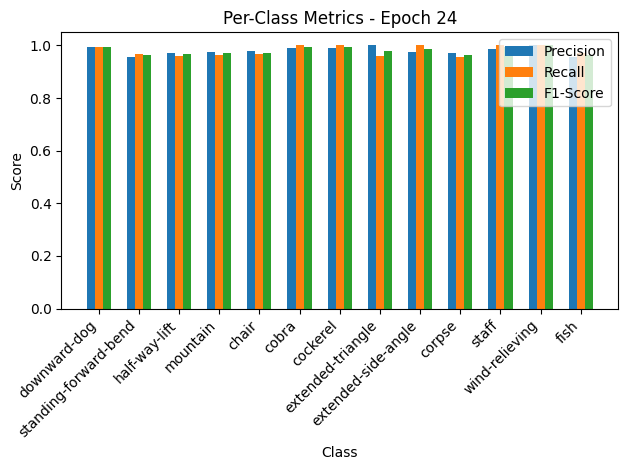

Validation: 100%|██████████| 21/21 [00:00<00:00, 27.73it/s, loss=0.234, accuracy=95.1]


Per-Class Metrics for Epoch 24:
downward-dog: Precision=0.96, Recall=0.98, F1-Score=0.97
standing-forward-bend: Precision=0.92, Recall=0.88, F1-Score=0.90
half-way-lift: Precision=0.94, Recall=0.89, F1-Score=0.92
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.86, Recall=1.00, F1-Score=0.92
cobra: Precision=1.00, Recall=0.91, F1-Score=0.95
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=1.00, F1-Score=0.98
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.94, Recall=0.94, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=1.00, Recall=0.94, F1-Score=0.97


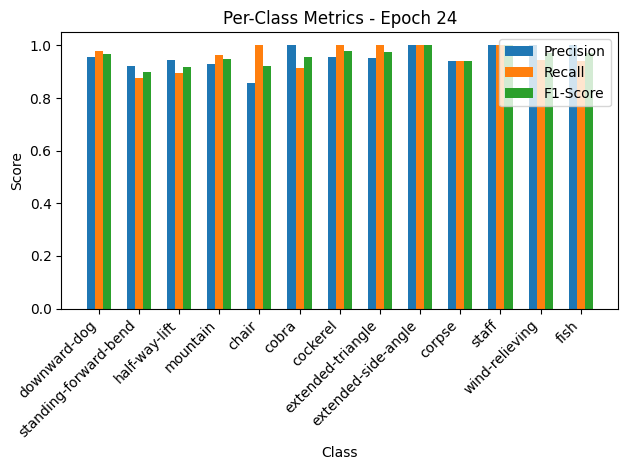


Epoch 25/50 Summary:
Train Loss: 0.0550 | Train Acc: 97.94% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.2401 | Val Acc: 95.12% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 26/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.52it/s, loss=0.0439, accuracy=98.5]


Per-Class Metrics for Epoch 25:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=1.00, F1-Score=0.98
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=0.97, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=0.96, Recall=0.99, F1-Score=0.97
staff: Precision=0.98, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.99, Recall=0.96, F1-Score=0.97


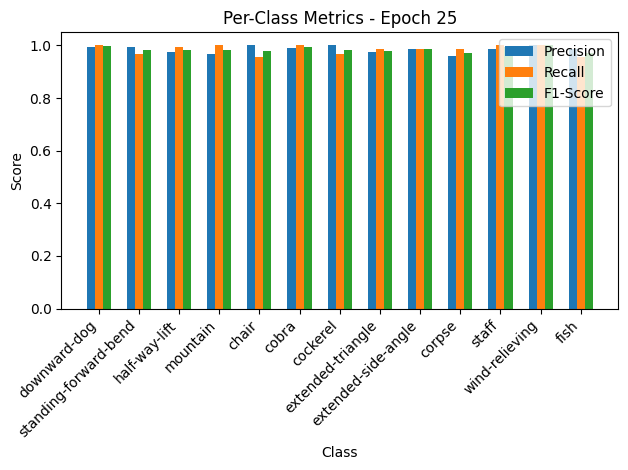

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.03it/s, loss=0.216, accuracy=95.7]


Per-Class Metrics for Epoch 25:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.90, Recall=0.88, F1-Score=0.89
half-way-lift: Precision=0.95, Recall=0.92, F1-Score=0.93
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.89, Recall=1.00, F1-Score=0.94
cobra: Precision=1.00, Recall=0.96, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=1.00, F1-Score=0.98
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.94, Recall=0.94, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=1.00, Recall=0.94, F1-Score=0.97


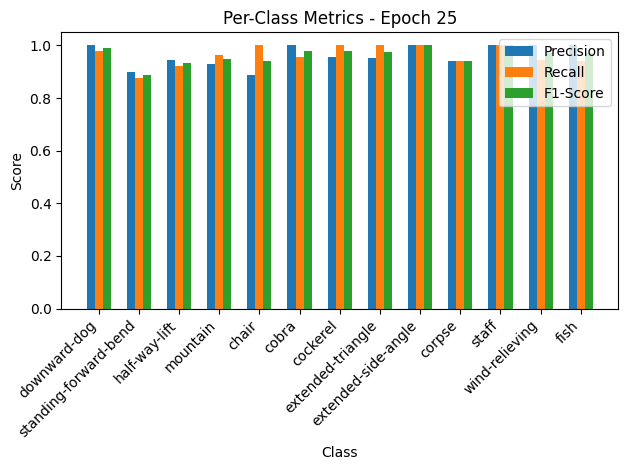


Epoch 26/50 Summary:
Train Loss: 0.0440 | Train Acc: 98.55% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2210 | Val Acc: 95.73% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 27/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.96it/s, loss=0.0227, accuracy=99.1]


Per-Class Metrics for Epoch 26:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.99, Recall=0.98, F1-Score=0.98
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=0.98, Recall=0.98, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.99, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.99, F1-Score=0.99


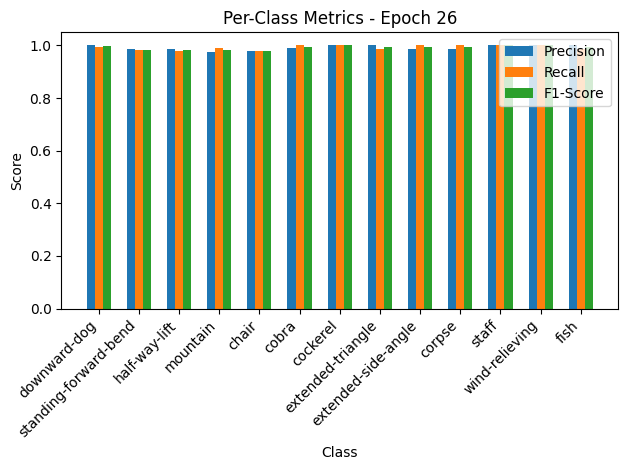

Validation: 100%|██████████| 21/21 [00:00<00:00, 23.97it/s, loss=0.213, accuracy=95.7]


Per-Class Metrics for Epoch 26:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.88, Recall=0.88, F1-Score=0.88
half-way-lift: Precision=0.94, Recall=0.89, F1-Score=0.92
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.89, Recall=1.00, F1-Score=0.94
cobra: Precision=1.00, Recall=0.96, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.94, Recall=1.00, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=1.00, Recall=0.94, F1-Score=0.97


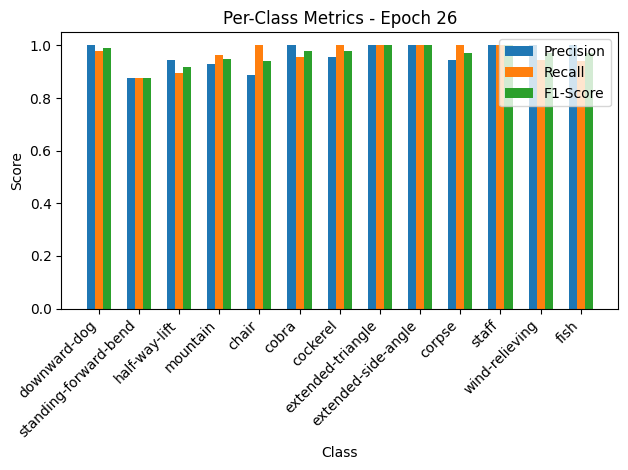


Epoch 27/50 Summary:
Train Loss: 0.0228 | Train Acc: 99.08% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2185 | Val Acc: 95.73% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 28/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.49it/s, loss=0.0334, accuracy=99.1]


Per-Class Metrics for Epoch 27:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.98
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.99, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.99, Recall=0.97, F1-Score=0.98


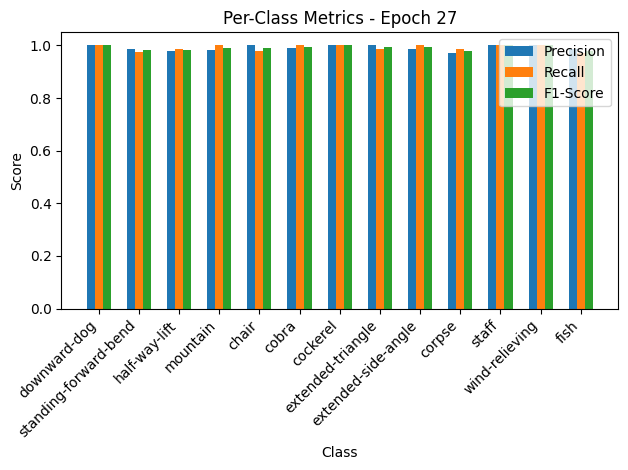

Validation: 100%|██████████| 21/21 [00:00<00:00, 30.50it/s, loss=0.212, accuracy=96]


Per-Class Metrics for Epoch 27:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.90, Recall=0.90, F1-Score=0.90
half-way-lift: Precision=0.95, Recall=0.92, F1-Score=0.93
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.92, Recall=1.00, F1-Score=0.96
cobra: Precision=1.00, Recall=0.96, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=1.00, F1-Score=0.98
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.94, Recall=0.94, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=1.00, Recall=0.94, F1-Score=0.97


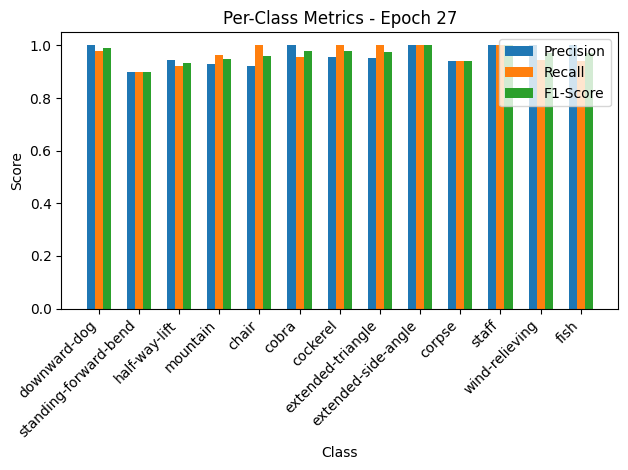


Epoch 28/50 Summary:
Train Loss: 0.0335 | Train Acc: 99.08% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2170 | Val Acc: 96.04% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 29/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:10<00:00,  7.96it/s, loss=0.0391, accuracy=98.9]


Per-Class Metrics for Epoch 28:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=1.00, F1-Score=0.99
mountain: Precision=0.97, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=0.99, Recall=0.96, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.96, Recall=0.99, F1-Score=0.97


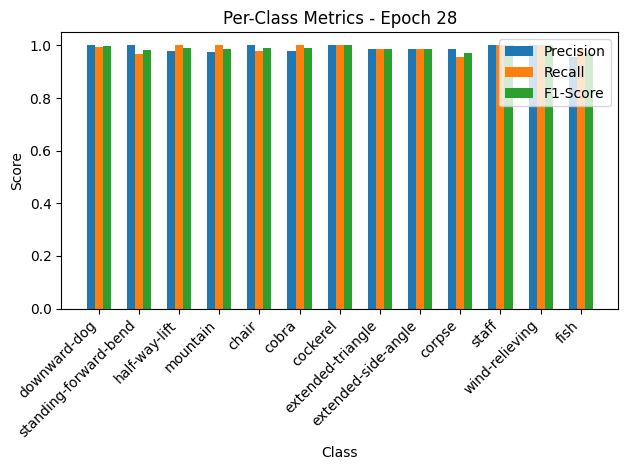

Validation: 100%|██████████| 21/21 [00:00<00:00, 31.10it/s, loss=0.214, accuracy=95.7]


Per-Class Metrics for Epoch 28:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.88, Recall=0.90, F1-Score=0.89
half-way-lift: Precision=0.94, Recall=0.89, F1-Score=0.92
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.92, Recall=1.00, F1-Score=0.96
cobra: Precision=1.00, Recall=0.96, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=1.00, F1-Score=0.98
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.94, Recall=0.94, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=1.00, Recall=0.94, F1-Score=0.97


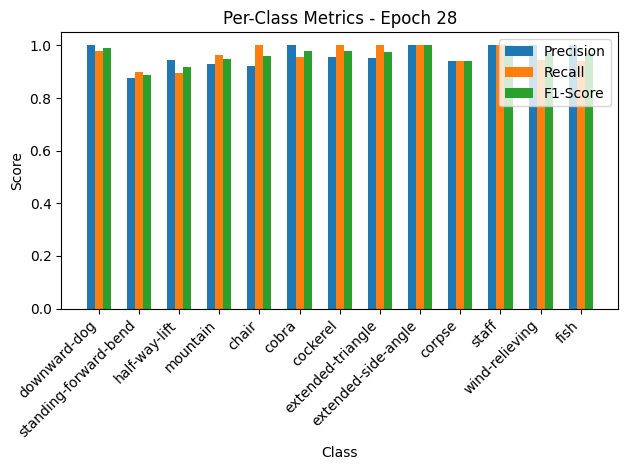


Epoch 29/50 Summary:
Train Loss: 0.0392 | Train Acc: 98.93% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2189 | Val Acc: 95.73% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 30/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:09<00:00,  8.76it/s, loss=0.0289, accuracy=99.2]


Per-Class Metrics for Epoch 29:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.99, Recall=0.99, F1-Score=0.99
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.99, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-side-angle: Precision=0.99, Recall=0.97, F1-Score=0.98
corpse: Precision=0.97, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.97, F1-Score=0.99


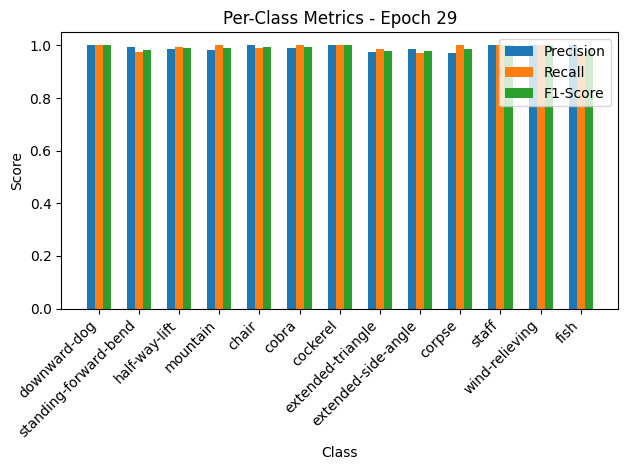

Validation: 100%|██████████| 21/21 [00:00<00:00, 28.69it/s, loss=0.211, accuracy=96]


Per-Class Metrics for Epoch 29:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.92, Recall=0.88, F1-Score=0.90
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.89, Recall=1.00, F1-Score=0.94
cobra: Precision=1.00, Recall=0.96, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=1.00, F1-Score=0.98
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.94, Recall=0.94, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=1.00, Recall=0.94, F1-Score=0.97


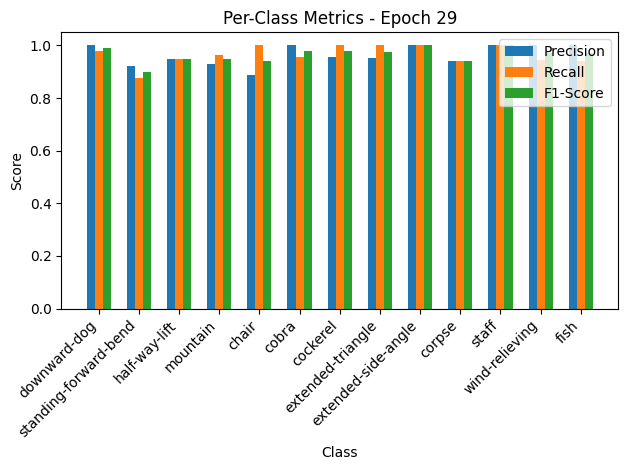


Epoch 30/50 Summary:
Train Loss: 0.0290 | Train Acc: 99.16% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2164 | Val Acc: 96.04% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 31/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:08<00:00,  9.53it/s, loss=0.0339, accuracy=99]


Per-Class Metrics for Epoch 30:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=0.99, F1-Score=0.99
mountain: Precision=0.99, Recall=0.99, F1-Score=0.99
chair: Precision=0.99, Recall=0.98, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.99, Recall=0.99, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.99, Recall=0.99, F1-Score=0.99


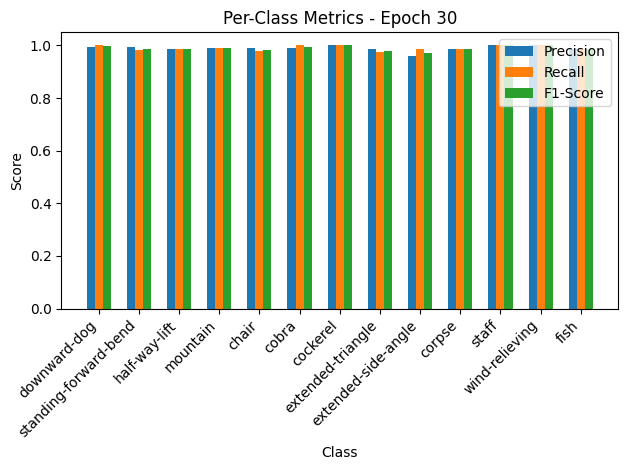

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.74it/s, loss=0.219, accuracy=95.7]


Per-Class Metrics for Epoch 30:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.88, Recall=0.90, F1-Score=0.89
half-way-lift: Precision=0.94, Recall=0.89, F1-Score=0.92
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.92, Recall=1.00, F1-Score=0.96
cobra: Precision=1.00, Recall=0.96, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=1.00, F1-Score=0.98
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.94, Recall=0.94, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=1.00, Recall=0.94, F1-Score=0.97


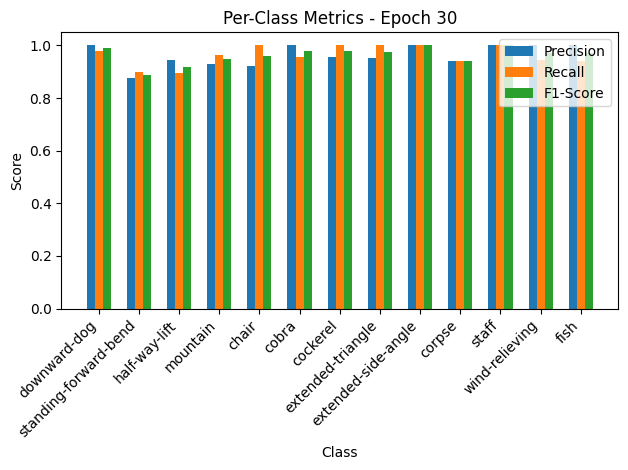


Epoch 31/50 Summary:
Train Loss: 0.0340 | Train Acc: 99.01% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2239 | Val Acc: 95.73% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 32/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:10<00:00,  7.48it/s, loss=0.0455, accuracy=98.6]


Per-Class Metrics for Epoch 31:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.98, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.99, Recall=0.98, F1-Score=0.99
chair: Precision=0.99, Recall=0.99, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.97, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.97, Recall=0.97, F1-Score=0.97
corpse: Precision=0.96, Recall=1.00, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.96, F1-Score=0.98


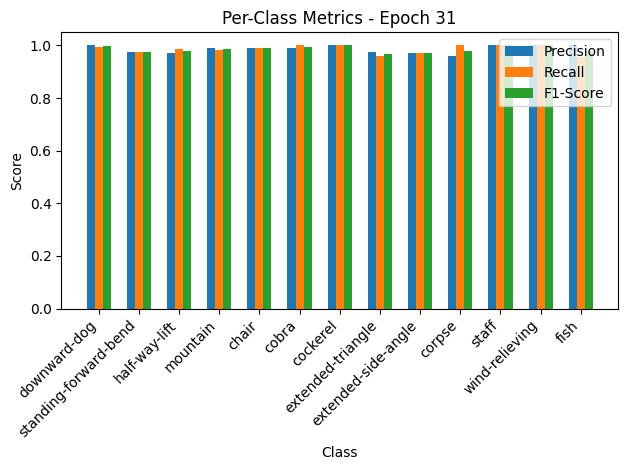

Validation: 100%|██████████| 21/21 [00:00<00:00, 25.42it/s, loss=0.219, accuracy=95.7]


Per-Class Metrics for Epoch 31:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.88, Recall=0.88, F1-Score=0.88
half-way-lift: Precision=0.94, Recall=0.89, F1-Score=0.92
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.89, Recall=1.00, F1-Score=0.94
cobra: Precision=1.00, Recall=0.96, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.94, Recall=1.00, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=1.00, Recall=0.94, F1-Score=0.97


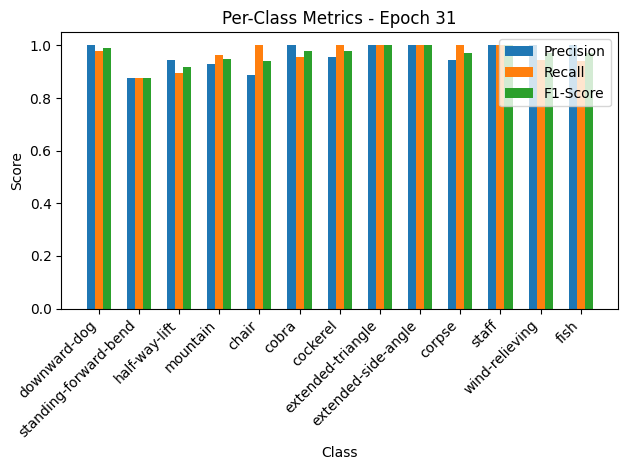


Epoch 32/50 Summary:
Train Loss: 0.0456 | Train Acc: 98.62% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2244 | Val Acc: 95.73% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 33/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:08<00:00,  9.24it/s, loss=0.0276, accuracy=98.7]


Per-Class Metrics for Epoch 32:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=0.98, F1-Score=0.98
chair: Precision=0.98, Recall=0.97, F1-Score=0.97
cobra: Precision=0.99, Recall=0.99, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.99, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.99, F1-Score=0.99


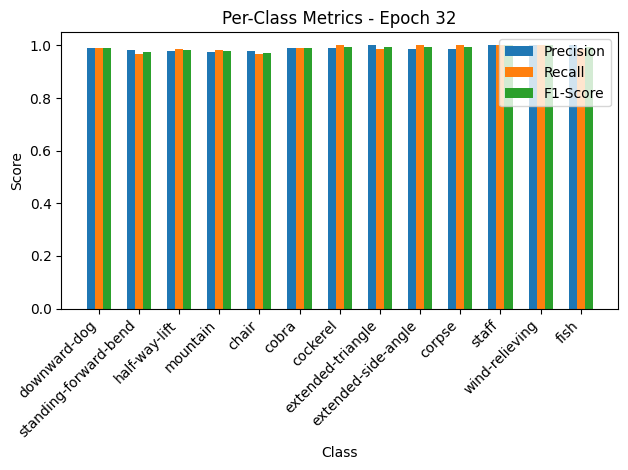

Validation: 100%|██████████| 21/21 [00:00<00:00, 23.59it/s, loss=0.216, accuracy=95.7]


Per-Class Metrics for Epoch 32:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.88, Recall=0.90, F1-Score=0.89
half-way-lift: Precision=0.94, Recall=0.89, F1-Score=0.92
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.92, Recall=1.00, F1-Score=0.96
cobra: Precision=1.00, Recall=0.96, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=1.00, F1-Score=0.98
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.94, Recall=0.94, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=1.00, Recall=0.94, F1-Score=0.97


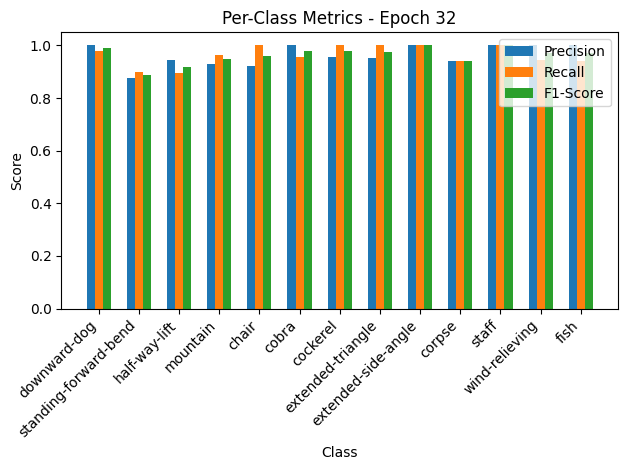


Epoch 33/50 Summary:
Train Loss: 0.0276 | Train Acc: 98.70% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2215 | Val Acc: 95.73% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 34/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:08<00:00,  9.42it/s, loss=0.0201, accuracy=99.2]


Per-Class Metrics for Epoch 33:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.98, Recall=1.00, F1-Score=0.99
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.99, F1-Score=0.99
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.99, F1-Score=0.98
staff: Precision=0.98, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.99, Recall=0.97, F1-Score=0.98


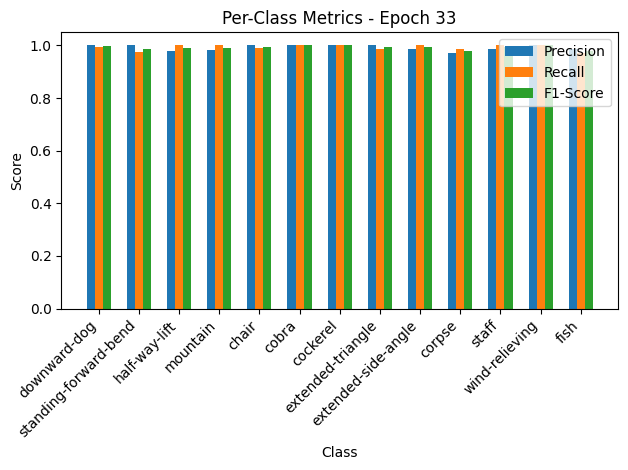

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.09it/s, loss=0.217, accuracy=95.7]


Per-Class Metrics for Epoch 33:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.90, Recall=0.88, F1-Score=0.89
half-way-lift: Precision=0.95, Recall=0.92, F1-Score=0.93
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.89, Recall=1.00, F1-Score=0.94
cobra: Precision=1.00, Recall=0.96, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=1.00, F1-Score=0.98
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.94, Recall=0.94, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=1.00, Recall=0.94, F1-Score=0.97


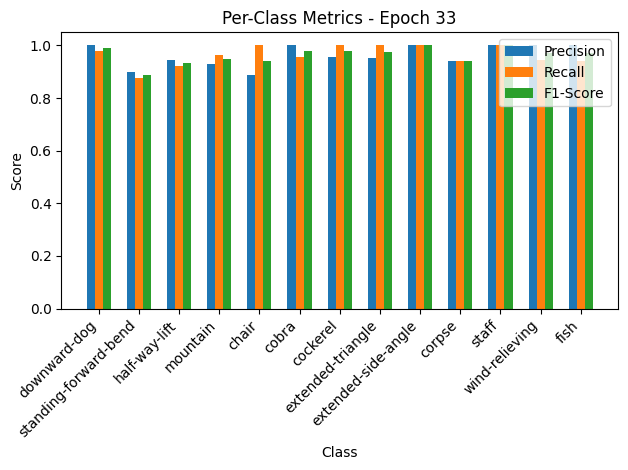


Epoch 34/50 Summary:
Train Loss: 0.0201 | Train Acc: 99.24% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2219 | Val Acc: 95.73% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 35/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:10<00:00,  7.90it/s, loss=0.0224, accuracy=99.1]


Per-Class Metrics for Epoch 34:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.99
mountain: Precision=0.98, Recall=0.99, F1-Score=0.99
chair: Precision=0.99, Recall=0.99, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.96, Recall=1.00, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.96, F1-Score=0.98


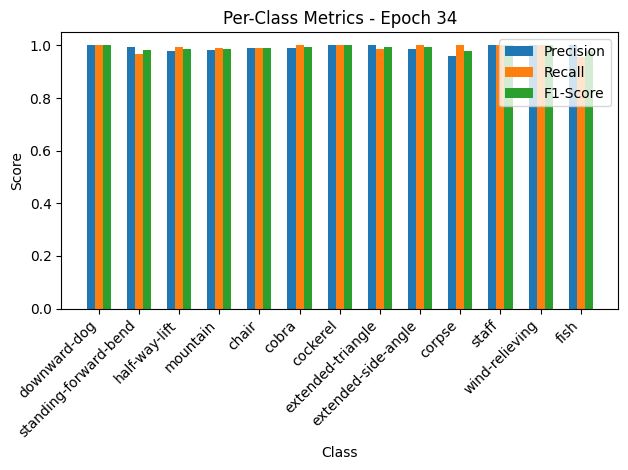

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.37it/s, loss=0.226, accuracy=96]


Per-Class Metrics for Epoch 34:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.92, Recall=0.88, F1-Score=0.90
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.89, Recall=1.00, F1-Score=0.94
cobra: Precision=1.00, Recall=0.96, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=1.00, F1-Score=0.98
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.94, Recall=0.94, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=1.00, Recall=0.94, F1-Score=0.97


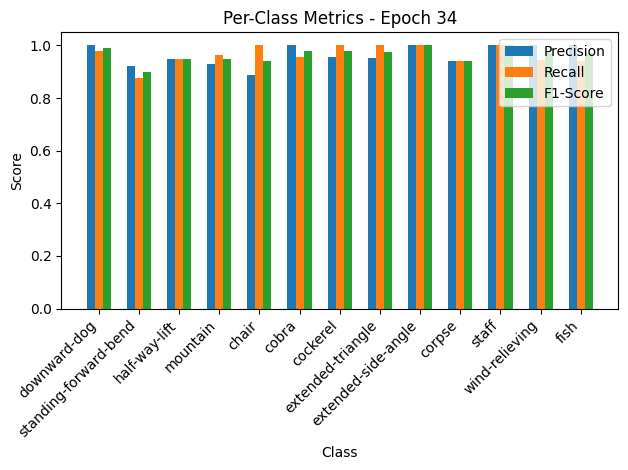


Epoch 35/50 Summary:
Train Loss: 0.0224 | Train Acc: 99.08% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2315 | Val Acc: 96.04% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 36/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:09<00:00,  8.65it/s, loss=0.0321, accuracy=99.1]


Per-Class Metrics for Epoch 35:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.99
mountain: Precision=1.00, Recall=0.99, F1-Score=1.00
chair: Precision=1.00, Recall=0.99, F1-Score=0.99
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.99, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.99, Recall=0.97, F1-Score=0.98


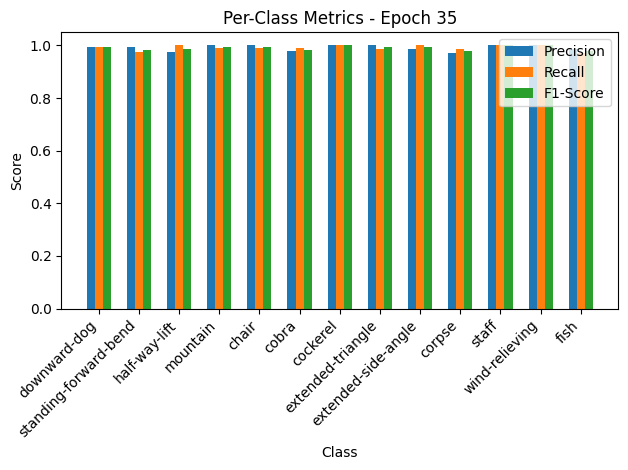

Validation: 100%|██████████| 21/21 [00:00<00:00, 27.10it/s, loss=0.216, accuracy=96.3]


Per-Class Metrics for Epoch 35:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.92, Recall=0.90, F1-Score=0.91
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.92, Recall=1.00, F1-Score=0.96
cobra: Precision=1.00, Recall=0.96, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=1.00, F1-Score=0.98
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.94, Recall=0.94, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=1.00, Recall=0.94, F1-Score=0.97


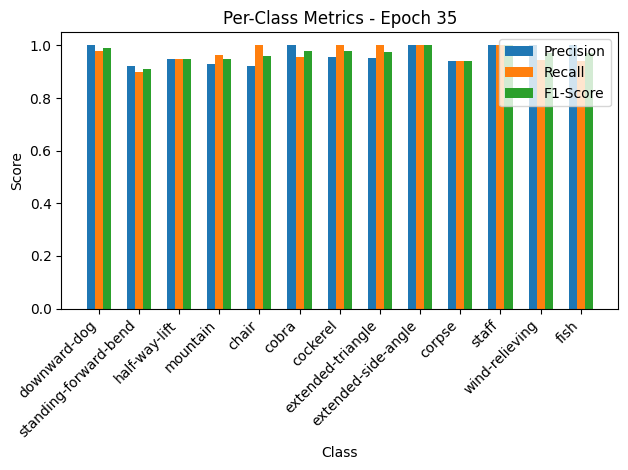


Epoch 36/50 Summary:
Train Loss: 0.0322 | Train Acc: 99.08% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2209 | Val Acc: 96.34% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 37/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:08<00:00,  9.66it/s, loss=0.0247, accuracy=99.2]


Per-Class Metrics for Epoch 36:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.99
mountain: Precision=0.99, Recall=0.99, F1-Score=0.99
chair: Precision=1.00, Recall=0.99, F1-Score=0.99
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.97, F1-Score=0.99


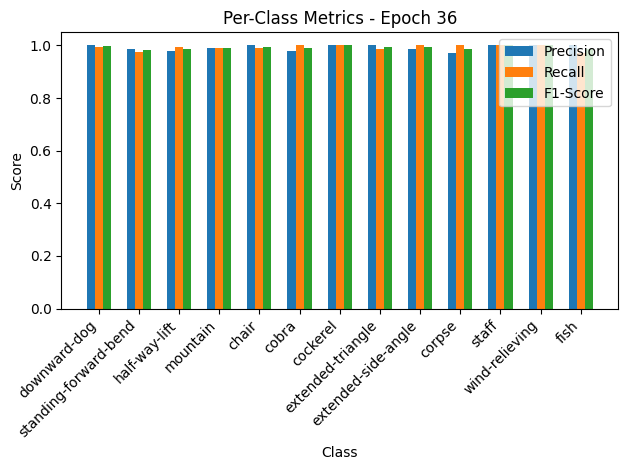

Validation: 100%|██████████| 21/21 [00:00<00:00, 30.15it/s, loss=0.22, accuracy=95.4]


Per-Class Metrics for Epoch 36:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.88, Recall=0.88, F1-Score=0.88
half-way-lift: Precision=0.94, Recall=0.89, F1-Score=0.92
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.89, Recall=1.00, F1-Score=0.94
cobra: Precision=1.00, Recall=0.96, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=1.00, F1-Score=0.98
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.94, Recall=0.94, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=1.00, Recall=0.94, F1-Score=0.97


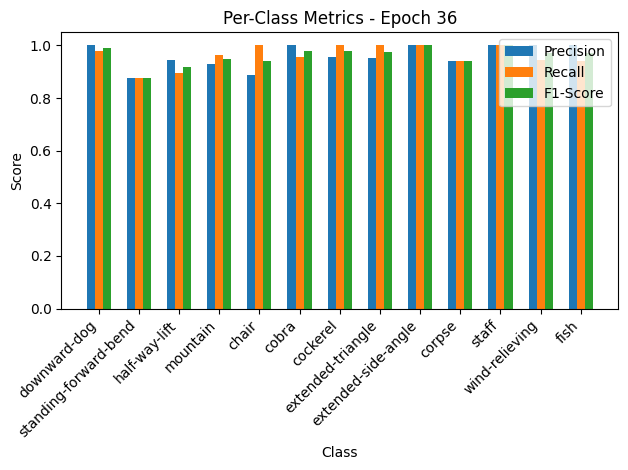


Epoch 37/50 Summary:
Train Loss: 0.0248 | Train Acc: 99.16% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2254 | Val Acc: 95.43% | Val Precision: 0.96 | Val Recall: 0.95 | Val F1: 0.95

Epoch 38/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:09<00:00,  8.57it/s, loss=0.0263, accuracy=99.2]


Per-Class Metrics for Epoch 37:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=0.99, F1-Score=0.99
mountain: Precision=0.99, Recall=0.99, F1-Score=0.99
chair: Precision=0.99, Recall=0.99, F1-Score=0.99
cobra: Precision=0.99, Recall=0.99, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.99, Recall=0.99, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.99, Recall=0.99, F1-Score=0.99


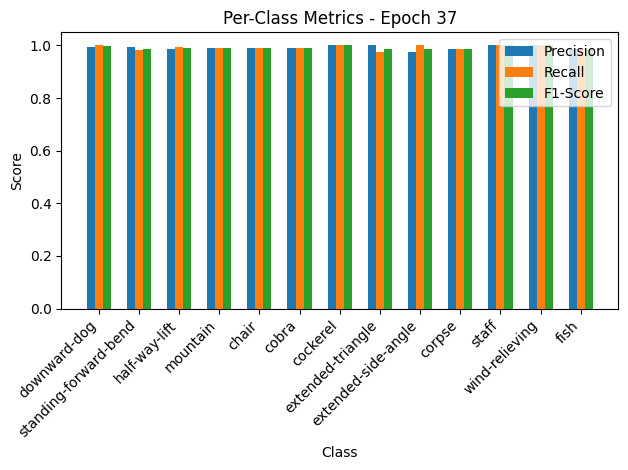

Validation: 100%|██████████| 21/21 [00:00<00:00, 31.18it/s, loss=0.222, accuracy=96.3]


Per-Class Metrics for Epoch 37:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.92, Recall=0.88, F1-Score=0.90
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.89, Recall=1.00, F1-Score=0.94
cobra: Precision=1.00, Recall=0.96, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.94, Recall=1.00, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=1.00, Recall=0.94, F1-Score=0.97


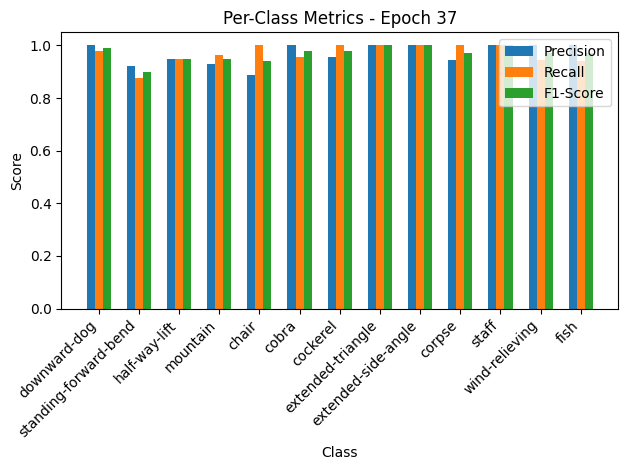


Epoch 38/50 Summary:
Train Loss: 0.0263 | Train Acc: 99.16% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2270 | Val Acc: 96.34% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 39/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:09<00:00,  8.50it/s, loss=0.0308, accuracy=99.1]


Per-Class Metrics for Epoch 38:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.98, Recall=0.99, F1-Score=0.98
half-way-lift: Precision=0.99, Recall=0.98, F1-Score=0.99
mountain: Precision=0.99, Recall=0.99, F1-Score=0.99
chair: Precision=0.99, Recall=1.00, F1-Score=0.99
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=0.97, Recall=0.97, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.97, F1-Score=0.97


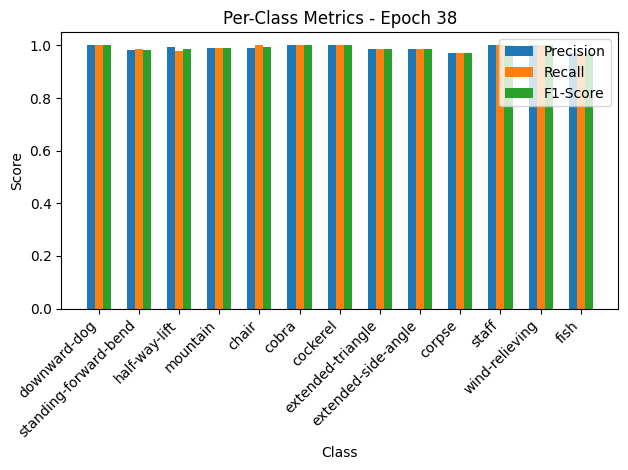

Validation: 100%|██████████| 21/21 [00:00<00:00, 26.03it/s, loss=0.211, accuracy=95.7]


Per-Class Metrics for Epoch 38:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.90, Recall=0.88, F1-Score=0.89
half-way-lift: Precision=0.95, Recall=0.92, F1-Score=0.93
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.89, Recall=1.00, F1-Score=0.94
cobra: Precision=1.00, Recall=0.96, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=1.00, F1-Score=0.98
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.94, Recall=0.94, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=1.00, Recall=0.94, F1-Score=0.97


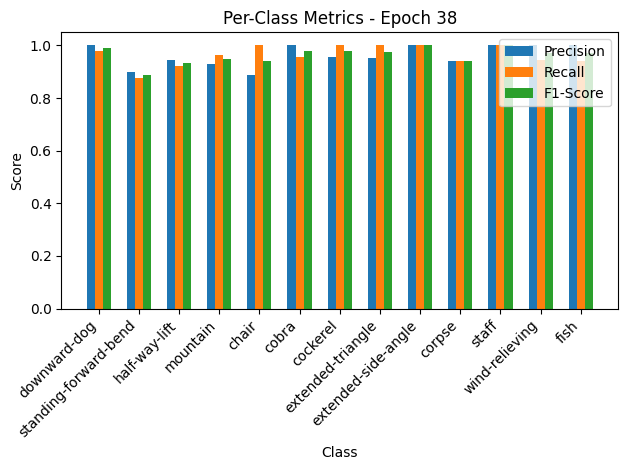


Epoch 39/50 Summary:
Train Loss: 0.0309 | Train Acc: 99.08% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2166 | Val Acc: 95.73% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 40/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:08<00:00,  9.53it/s, loss=0.0348, accuracy=99.2]


Per-Class Metrics for Epoch 39:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.99, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=0.99, F1-Score=0.99
mountain: Precision=0.97, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.97, F1-Score=0.99


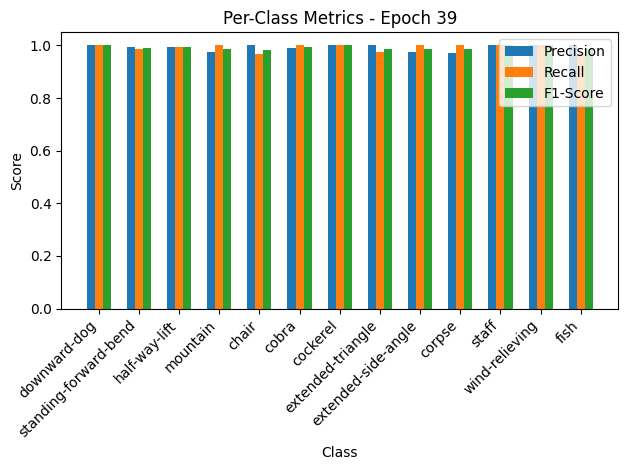

Validation: 100%|██████████| 21/21 [00:00<00:00, 31.67it/s, loss=0.211, accuracy=95.7]


Per-Class Metrics for Epoch 39:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.90, Recall=0.88, F1-Score=0.89
half-way-lift: Precision=0.95, Recall=0.92, F1-Score=0.93
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.89, Recall=1.00, F1-Score=0.94
cobra: Precision=1.00, Recall=0.96, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=1.00, F1-Score=0.98
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.94, Recall=0.94, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=1.00, Recall=0.94, F1-Score=0.97


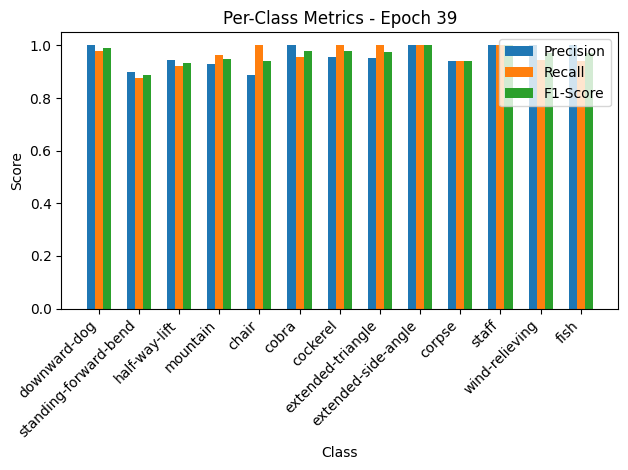


Epoch 40/50 Summary:
Train Loss: 0.0348 | Train Acc: 99.24% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2161 | Val Acc: 95.73% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 41/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:09<00:00,  8.60it/s, loss=0.0155, accuracy=99.3]


Per-Class Metrics for Epoch 40:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.99
mountain: Precision=0.98, Recall=0.99, F1-Score=0.99
chair: Precision=0.99, Recall=0.99, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


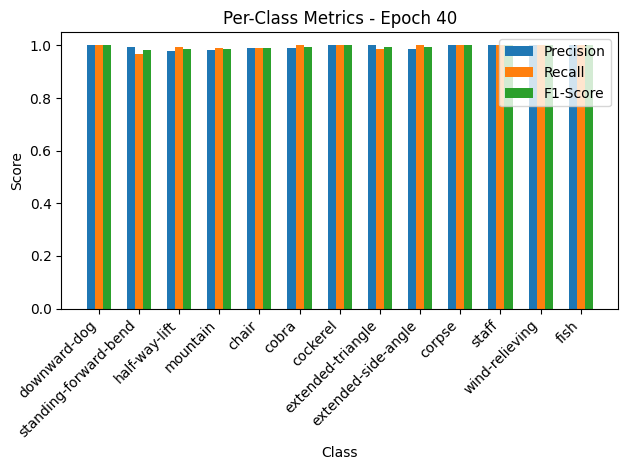

Validation: 100%|██████████| 21/21 [00:00<00:00, 28.39it/s, loss=0.217, accuracy=95.7]


Per-Class Metrics for Epoch 40:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.90, Recall=0.88, F1-Score=0.89
half-way-lift: Precision=0.95, Recall=0.92, F1-Score=0.93
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.89, Recall=1.00, F1-Score=0.94
cobra: Precision=1.00, Recall=0.96, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=1.00, F1-Score=0.98
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.94, Recall=0.94, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=1.00, Recall=0.94, F1-Score=0.97


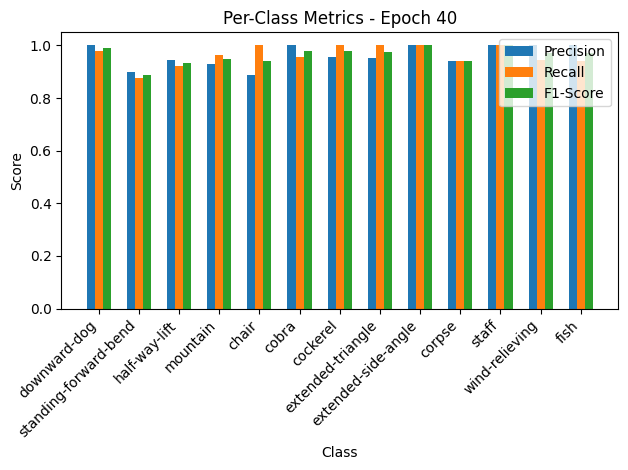


Epoch 41/50 Summary:
Train Loss: 0.0155 | Train Acc: 99.31% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2225 | Val Acc: 95.73% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 42/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:08<00:00,  9.35it/s, loss=0.0373, accuracy=98.7]


Per-Class Metrics for Epoch 41:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.98, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.99, Recall=0.99, F1-Score=0.99
mountain: Precision=0.99, Recall=0.97, F1-Score=0.98
chair: Precision=0.99, Recall=0.99, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-side-angle: Precision=0.99, Recall=0.97, F1-Score=0.98
corpse: Precision=0.97, Recall=0.96, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.96, Recall=0.97, F1-Score=0.96


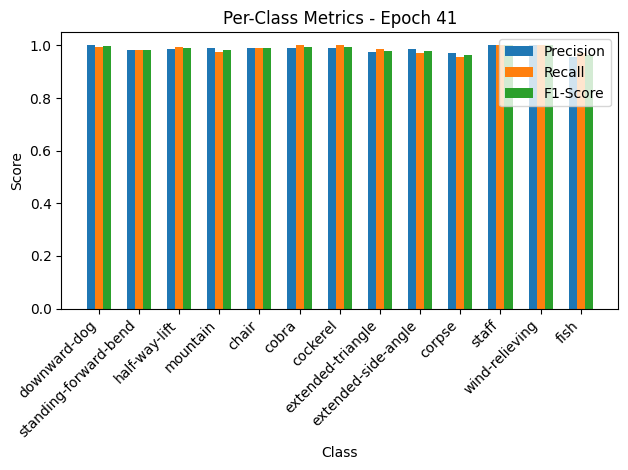

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.72it/s, loss=0.226, accuracy=95.4]


Per-Class Metrics for Epoch 41:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.88, Recall=0.88, F1-Score=0.88
half-way-lift: Precision=0.94, Recall=0.89, F1-Score=0.92
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.89, Recall=1.00, F1-Score=0.94
cobra: Precision=1.00, Recall=0.96, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=1.00, F1-Score=0.98
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.94, Recall=0.94, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=1.00, Recall=0.94, F1-Score=0.97


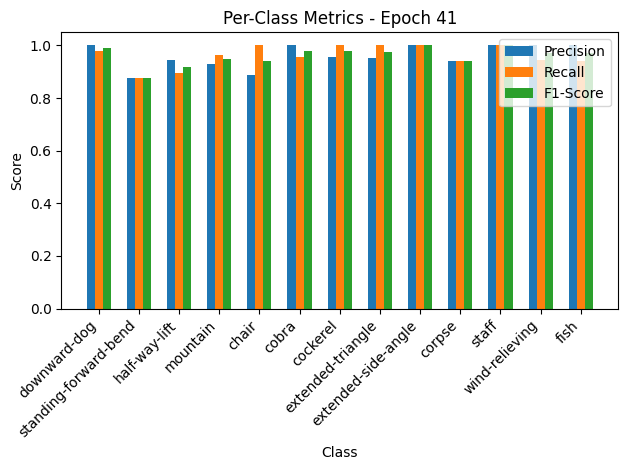


Epoch 42/50 Summary:
Train Loss: 0.0374 | Train Acc: 98.70% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2312 | Val Acc: 95.43% | Val Precision: 0.96 | Val Recall: 0.95 | Val F1: 0.95

Epoch 43/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:09<00:00,  9.02it/s, loss=0.0192, accuracy=99.2]


Per-Class Metrics for Epoch 42:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=1.00, F1-Score=0.99
mountain: Precision=0.99, Recall=0.99, F1-Score=0.99
chair: Precision=0.98, Recall=0.99, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=0.99, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.99, F1-Score=0.99


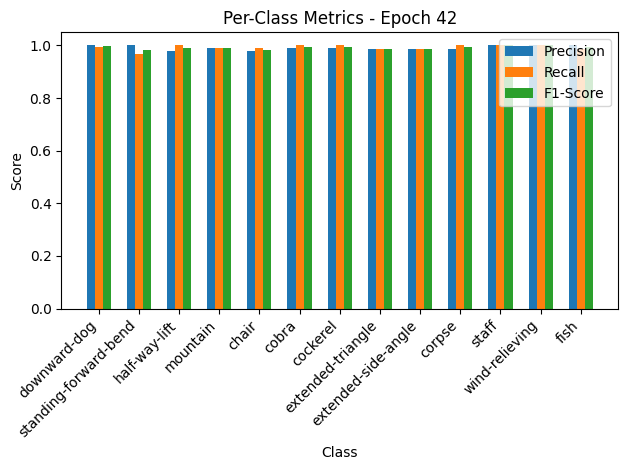

Validation: 100%|██████████| 21/21 [00:00<00:00, 30.87it/s, loss=0.213, accuracy=95.4]


Per-Class Metrics for Epoch 42:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.88, Recall=0.88, F1-Score=0.88
half-way-lift: Precision=0.94, Recall=0.89, F1-Score=0.92
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.89, Recall=1.00, F1-Score=0.94
cobra: Precision=1.00, Recall=0.96, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=1.00, F1-Score=0.98
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.94, Recall=0.94, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=1.00, Recall=0.94, F1-Score=0.97


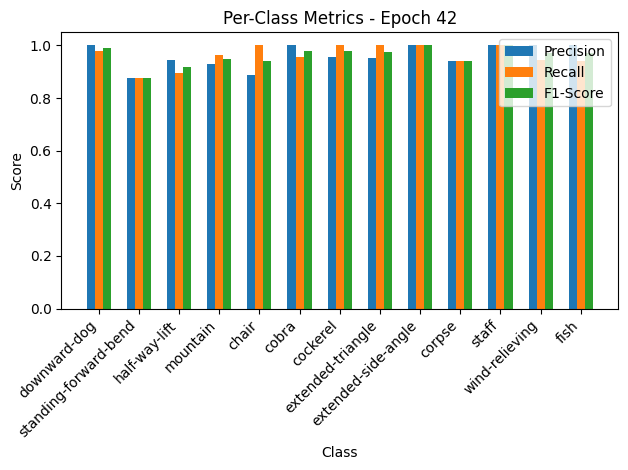


Epoch 43/50 Summary:
Train Loss: 0.0193 | Train Acc: 99.16% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2181 | Val Acc: 95.43% | Val Precision: 0.96 | Val Recall: 0.95 | Val F1: 0.95

Epoch 44/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:10<00:00,  7.97it/s, loss=0.0214, accuracy=99.2]


Per-Class Metrics for Epoch 43:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.99
mountain: Precision=0.99, Recall=0.99, F1-Score=0.99
chair: Precision=0.99, Recall=0.99, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.97, F1-Score=0.99


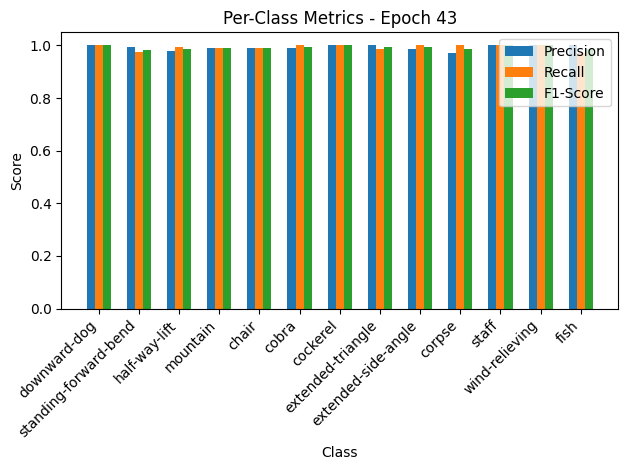

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.83it/s, loss=0.212, accuracy=95.1]


Per-Class Metrics for Epoch 43:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.88, Recall=0.88, F1-Score=0.88
half-way-lift: Precision=0.94, Recall=0.87, F1-Score=0.90
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.89, Recall=1.00, F1-Score=0.94
cobra: Precision=1.00, Recall=0.96, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=1.00, F1-Score=0.98
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.94, Recall=0.94, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=1.00, Recall=0.94, F1-Score=0.97


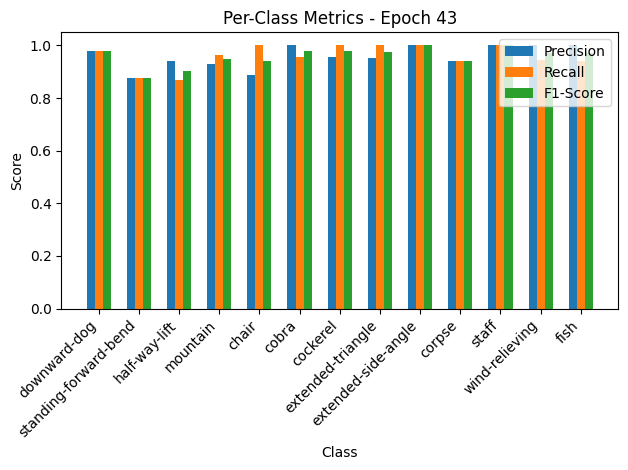


Epoch 44/50 Summary:
Train Loss: 0.0215 | Train Acc: 99.24% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2170 | Val Acc: 95.12% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 45/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:08<00:00,  9.47it/s, loss=0.0326, accuracy=99.3]


Per-Class Metrics for Epoch 44:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.98, Recall=1.00, F1-Score=0.99
mountain: Precision=0.98, Recall=0.99, F1-Score=0.99
chair: Precision=0.99, Recall=0.98, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.99, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.99, F1-Score=0.99


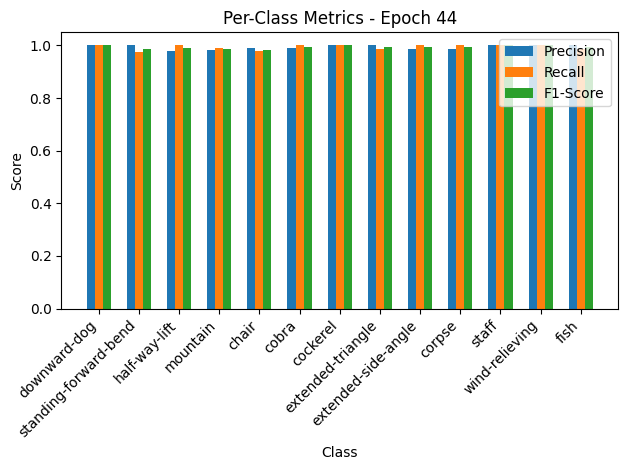

Validation: 100%|██████████| 21/21 [00:00<00:00, 26.71it/s, loss=0.221, accuracy=95.7]


Per-Class Metrics for Epoch 44:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.88, Recall=0.88, F1-Score=0.88
half-way-lift: Precision=0.94, Recall=0.89, F1-Score=0.92
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.89, Recall=1.00, F1-Score=0.94
cobra: Precision=1.00, Recall=0.96, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.94, Recall=1.00, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=1.00, Recall=0.94, F1-Score=0.97


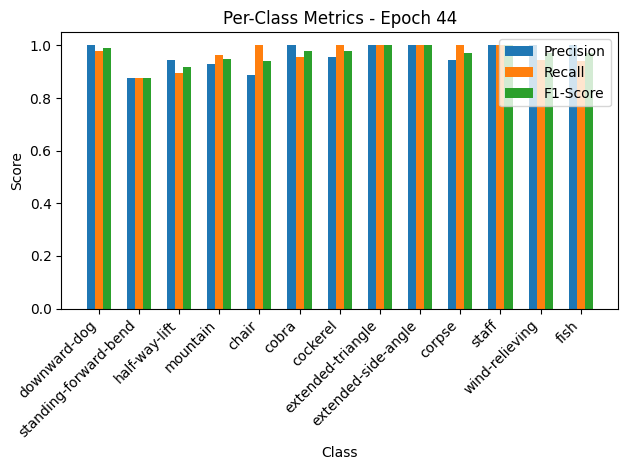


Epoch 45/50 Summary:
Train Loss: 0.0326 | Train Acc: 99.31% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2269 | Val Acc: 95.73% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 46/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:09<00:00,  9.09it/s, loss=0.028, accuracy=99.2]


Per-Class Metrics for Epoch 45:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=1.00, F1-Score=0.99
mountain: Precision=0.98, Recall=0.99, F1-Score=0.99
chair: Precision=0.99, Recall=0.98, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.97, Recall=0.97, F1-Score=0.97
corpse: Precision=0.99, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.99, F1-Score=0.99


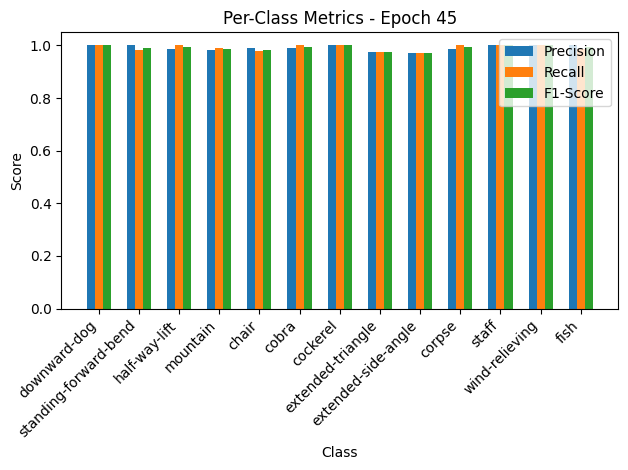

Validation: 100%|██████████| 21/21 [00:00<00:00, 30.38it/s, loss=0.219, accuracy=95.7]


Per-Class Metrics for Epoch 45:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.88, Recall=0.90, F1-Score=0.89
half-way-lift: Precision=0.94, Recall=0.89, F1-Score=0.92
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.92, Recall=1.00, F1-Score=0.96
cobra: Precision=1.00, Recall=0.96, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=1.00, F1-Score=0.98
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.94, Recall=0.94, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=1.00, Recall=0.94, F1-Score=0.97


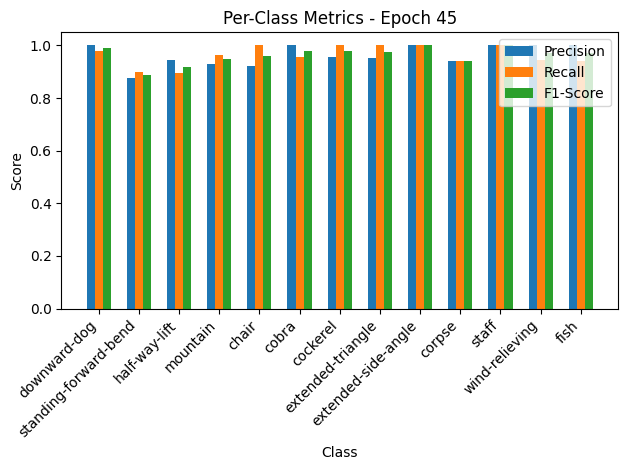


Epoch 46/50 Summary:
Train Loss: 0.0281 | Train Acc: 99.16% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2243 | Val Acc: 95.73% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 47/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:09<00:00,  8.32it/s, loss=0.0289, accuracy=99]


Per-Class Metrics for Epoch 46:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.99, Recall=0.99, F1-Score=0.99
mountain: Precision=0.98, Recall=0.99, F1-Score=0.99
chair: Precision=0.99, Recall=0.98, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-side-angle: Precision=1.00, Recall=0.99, F1-Score=0.99
corpse: Precision=0.97, Recall=0.97, F1-Score=0.97
staff: Precision=1.00, Recall=0.98, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.99, Recall=0.97, F1-Score=0.98


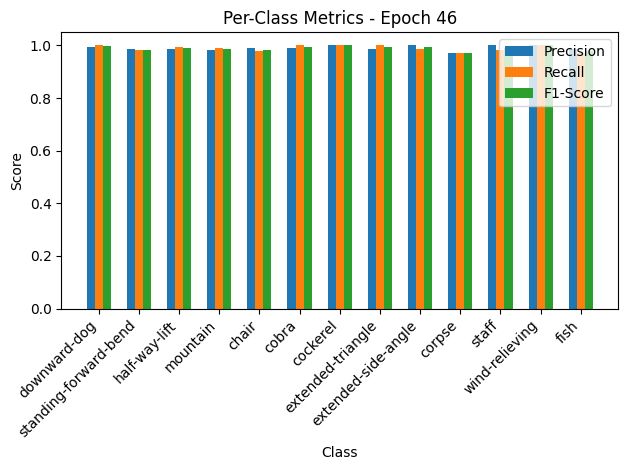

Validation: 100%|██████████| 21/21 [00:00<00:00, 28.30it/s, loss=0.218, accuracy=95.4]


Per-Class Metrics for Epoch 46:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.88, Recall=0.88, F1-Score=0.88
half-way-lift: Precision=0.94, Recall=0.89, F1-Score=0.92
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.89, Recall=1.00, F1-Score=0.94
cobra: Precision=1.00, Recall=0.96, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=1.00, F1-Score=0.98
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.94, Recall=0.94, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=1.00, Recall=0.94, F1-Score=0.97


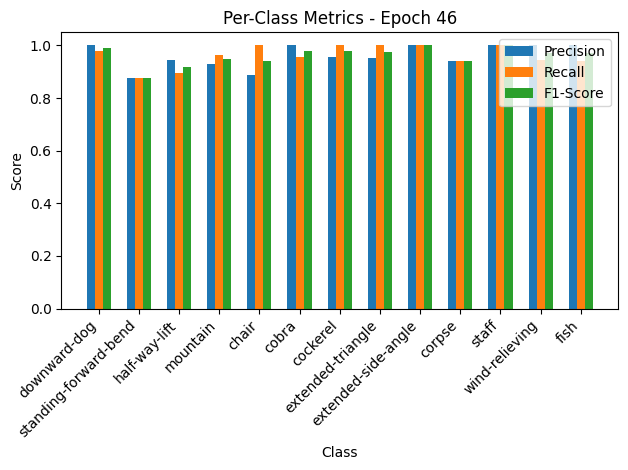


Epoch 47/50 Summary:
Train Loss: 0.0290 | Train Acc: 99.01% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2238 | Val Acc: 95.43% | Val Precision: 0.96 | Val Recall: 0.95 | Val F1: 0.95

Epoch 48/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:08<00:00,  9.23it/s, loss=0.0425, accuracy=98.7]


Per-Class Metrics for Epoch 47:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=0.99, Recall=0.98, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.97, F1-Score=0.99


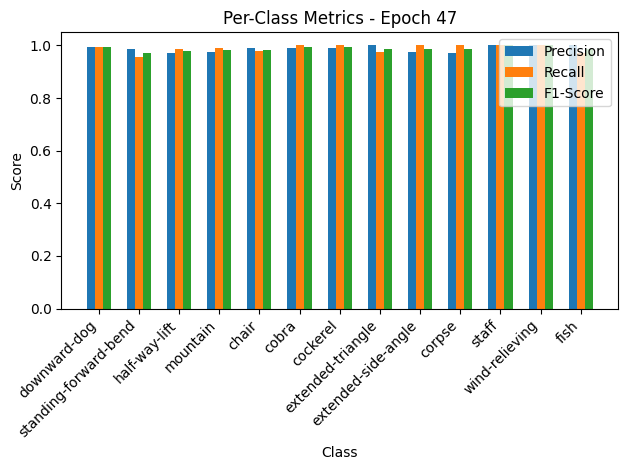

Validation: 100%|██████████| 21/21 [00:00<00:00, 27.44it/s, loss=0.219, accuracy=96]


Per-Class Metrics for Epoch 47:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.90, Recall=0.90, F1-Score=0.90
half-way-lift: Precision=0.95, Recall=0.92, F1-Score=0.93
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.92, Recall=1.00, F1-Score=0.96
cobra: Precision=1.00, Recall=0.96, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=1.00, F1-Score=0.98
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.94, Recall=0.94, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=1.00, Recall=0.94, F1-Score=0.97


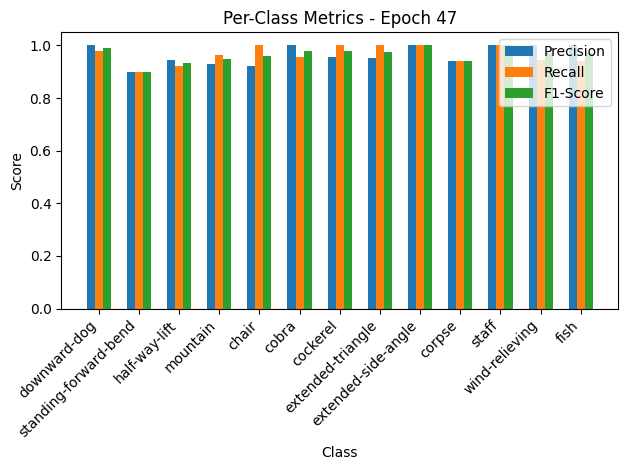


Epoch 48/50 Summary:
Train Loss: 0.0426 | Train Acc: 98.70% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2243 | Val Acc: 96.04% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 49/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:08<00:00,  9.30it/s, loss=0.0274, accuracy=99.2]


Per-Class Metrics for Epoch 48:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.98, Recall=1.00, F1-Score=0.99
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=0.99, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.99, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.99, F1-Score=0.99


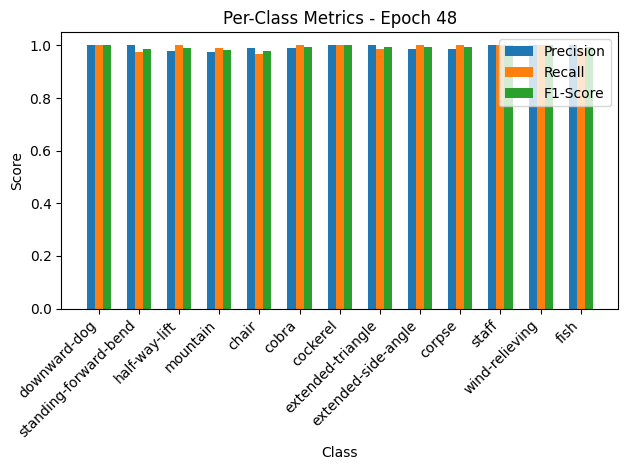

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.93it/s, loss=0.212, accuracy=95.7]


Per-Class Metrics for Epoch 48:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.90, Recall=0.88, F1-Score=0.89
half-way-lift: Precision=0.95, Recall=0.92, F1-Score=0.93
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.89, Recall=1.00, F1-Score=0.94
cobra: Precision=1.00, Recall=0.96, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=1.00, F1-Score=0.98
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.94, Recall=0.94, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=1.00, Recall=0.94, F1-Score=0.97


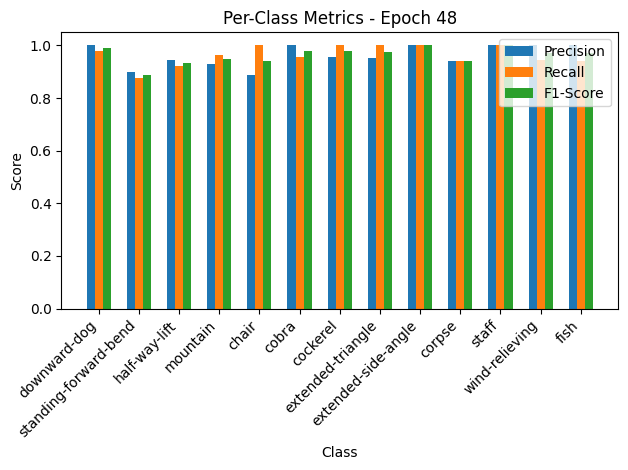


Epoch 49/50 Summary:
Train Loss: 0.0275 | Train Acc: 99.24% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2174 | Val Acc: 95.73% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 50/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:08<00:00,  9.31it/s, loss=0.0243, accuracy=99.2]


Per-Class Metrics for Epoch 49:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=0.99, F1-Score=0.99
mountain: Precision=0.99, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=0.99, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=0.99, Recall=0.99, F1-Score=0.99
staff: Precision=1.00, Recall=0.98, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.99, Recall=0.99, F1-Score=0.99


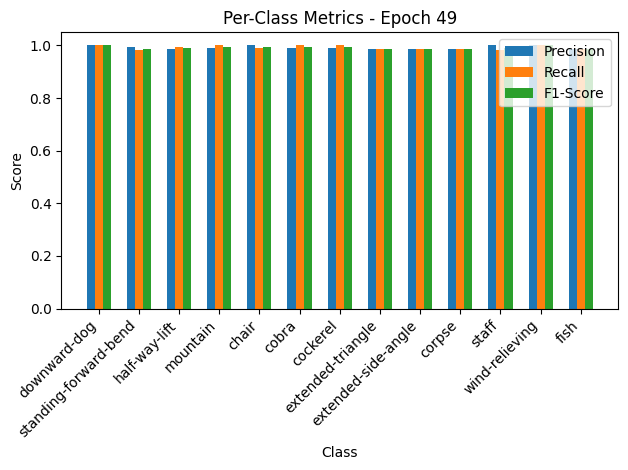

Validation: 100%|██████████| 21/21 [00:00<00:00, 23.63it/s, loss=0.215, accuracy=95.7]


Per-Class Metrics for Epoch 49:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.90, Recall=0.88, F1-Score=0.89
half-way-lift: Precision=0.95, Recall=0.92, F1-Score=0.93
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.89, Recall=1.00, F1-Score=0.94
cobra: Precision=1.00, Recall=0.96, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=1.00, F1-Score=0.98
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.94, Recall=0.94, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=1.00, Recall=0.94, F1-Score=0.97


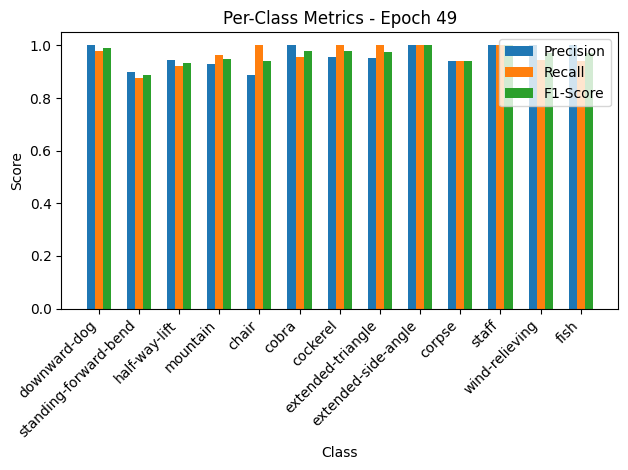


Epoch 50/50 Summary:
Train Loss: 0.0244 | Train Acc: 99.24% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2201 | Val Acc: 95.73% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96


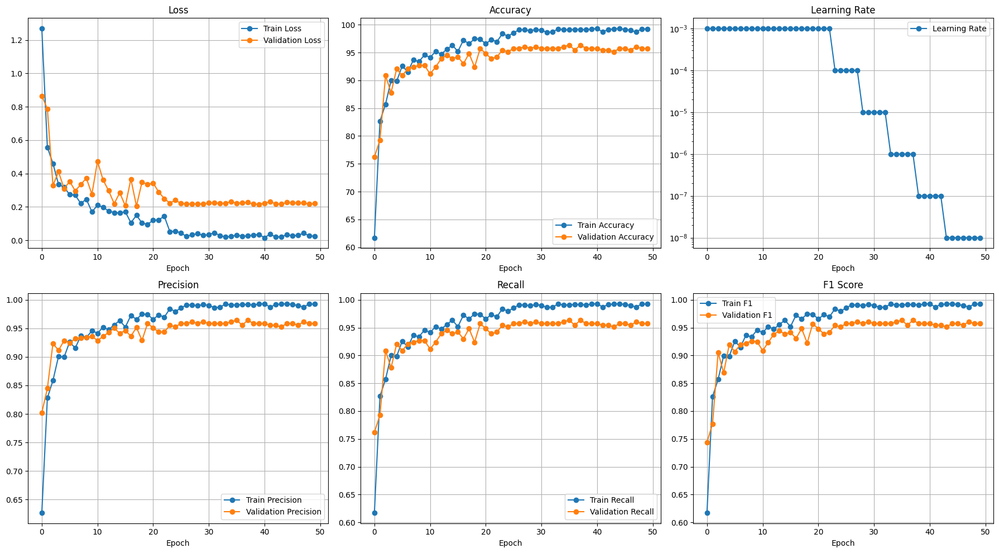

Fold 3/5

Class Distribution Analysis:
--------------------------------------------------
Class 0: 245 samples (13.48%)
Class 1: 225 samples (12.38%)
Class 2: 209 samples (11.50%)
Class 3: 165 samples (9.08%)
Class 4: 140 samples (7.70%)
Class 5: 129 samples (7.10%)
Class 6: 120 samples (6.60%)
Class 7: 108 samples (5.94%)
Class 8: 101 samples (5.56%)
Class 9: 95 samples (5.23%)
Class 10: 94 samples (5.17%)
Class 11: 94 samples (5.17%)
Class 12: 93 samples (5.12%)

Imbalance Statistics:
Imbalance Ratio (max/min): 2.63
Maximum class size: 245
Minimum class size: 93
Average class size: 139.85
Class weights aligned with indices: tensor([0.5117, 0.5567, 0.5988, 0.7568, 0.8908, 0.9663, 1.0383, 1.1529, 1.2324,
        1.3099, 1.3237, 1.3237, 1.3379])
Using device: cuda

Epoch 1/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.52it/s, loss=1.43, accuracy=61.7]


Per-Class Metrics for Epoch 0:
downward-dog: Precision=0.79, Recall=0.68, F1-Score=0.73
standing-forward-bend: Precision=0.73, Recall=0.54, F1-Score=0.62
half-way-lift: Precision=0.76, Recall=0.79, F1-Score=0.77
mountain: Precision=0.60, Recall=0.74, F1-Score=0.66
chair: Precision=0.53, Recall=0.45, F1-Score=0.49
cobra: Precision=0.62, Recall=0.62, F1-Score=0.62
cockerel: Precision=0.50, Recall=0.72, F1-Score=0.59
extended-triangle: Precision=0.53, Recall=0.58, F1-Score=0.55
extended-side-angle: Precision=0.41, Recall=0.42, F1-Score=0.41
corpse: Precision=0.36, Recall=0.41, F1-Score=0.38
staff: Precision=0.63, Recall=0.73, F1-Score=0.68
wind-relieving: Precision=0.77, Recall=0.74, F1-Score=0.76
fish: Precision=0.46, Recall=0.38, F1-Score=0.42


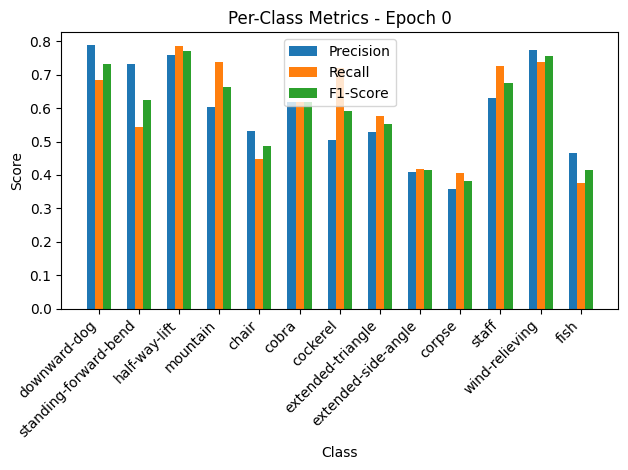

Validation: 100%|██████████| 21/21 [00:00<00:00, 23.22it/s, loss=0.498, accuracy=82.6]


Per-Class Metrics for Epoch 0:
downward-dog: Precision=0.93, Recall=0.87, F1-Score=0.90
standing-forward-bend: Precision=1.00, Recall=0.45, F1-Score=0.62
half-way-lift: Precision=0.75, Recall=0.89, F1-Score=0.81
mountain: Precision=0.71, Recall=1.00, F1-Score=0.83
chair: Precision=0.83, Recall=0.79, F1-Score=0.81
cobra: Precision=0.77, Recall=1.00, F1-Score=0.87
cockerel: Precision=0.95, Recall=0.82, F1-Score=0.88
extended-triangle: Precision=0.83, Recall=0.75, F1-Score=0.79
extended-side-angle: Precision=0.75, Recall=0.83, F1-Score=0.79
corpse: Precision=0.80, Recall=0.67, F1-Score=0.73
staff: Precision=0.94, Recall=1.00, F1-Score=0.97
wind-relieving: Precision=0.81, Recall=1.00, F1-Score=0.89
fish: Precision=0.83, Recall=0.88, F1-Score=0.86


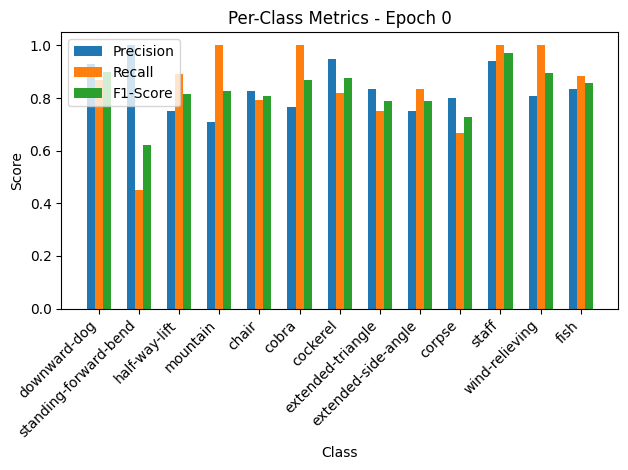


Epoch 1/50 Summary:
Train Loss: 1.4283 | Train Acc: 61.68% | Train Precision: 0.63 | Train Recall: 0.62 | Train F1: 0.62
Val Loss: 0.5121 | Val Acc: 82.57% | Val Precision: 0.85 | Val Recall: 0.83 | Val F1: 0.82
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model.pth
Checkpoint saved at epoch 1
New best model saved! Validation Loss: 0.5121

Epoch 2/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.37it/s, loss=0.616, accuracy=81.1]


Per-Class Metrics for Epoch 1:
downward-dog: Precision=0.92, Recall=0.86, F1-Score=0.89
standing-forward-bend: Precision=0.90, Recall=0.77, F1-Score=0.83
half-way-lift: Precision=0.86, Recall=0.91, F1-Score=0.88
mountain: Precision=0.80, Recall=0.88, F1-Score=0.83
chair: Precision=0.70, Recall=0.70, F1-Score=0.70
cobra: Precision=0.88, Recall=0.91, F1-Score=0.90
cockerel: Precision=0.90, Recall=0.92, F1-Score=0.91
extended-triangle: Precision=0.78, Recall=0.76, F1-Score=0.77
extended-side-angle: Precision=0.71, Recall=0.76, F1-Score=0.73
corpse: Precision=0.49, Recall=0.42, F1-Score=0.45
staff: Precision=0.84, Recall=0.97, F1-Score=0.90
wind-relieving: Precision=0.87, Recall=0.87, F1-Score=0.87
fish: Precision=0.57, Recall=0.62, F1-Score=0.60


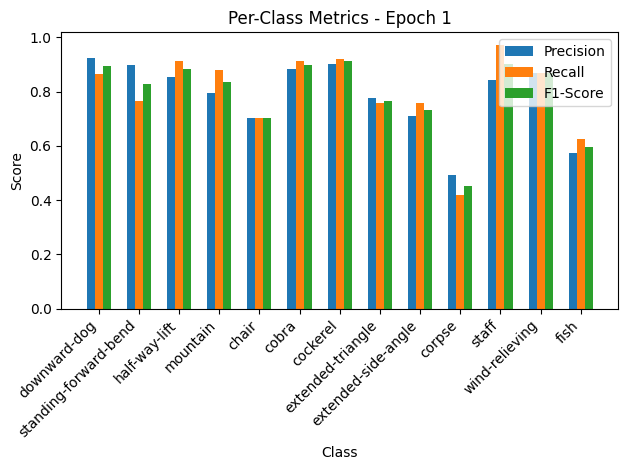

Validation: 100%|██████████| 21/21 [00:00<00:00, 31.69it/s, loss=0.661, accuracy=77.7]


Per-Class Metrics for Epoch 1:
downward-dog: Precision=0.96, Recall=0.93, F1-Score=0.95
standing-forward-bend: Precision=0.65, Recall=0.90, F1-Score=0.76
half-way-lift: Precision=0.89, Recall=0.89, F1-Score=0.89
mountain: Precision=0.93, Recall=0.45, F1-Score=0.60
chair: Precision=1.00, Recall=0.88, F1-Score=0.93
cobra: Precision=0.79, Recall=1.00, F1-Score=0.88
cockerel: Precision=1.00, Recall=0.73, F1-Score=0.84
extended-triangle: Precision=0.62, Recall=0.90, F1-Score=0.73
extended-side-angle: Precision=0.77, Recall=0.56, F1-Score=0.65
corpse: Precision=0.67, Recall=0.11, F1-Score=0.19
staff: Precision=1.00, Recall=0.44, F1-Score=0.61
wind-relieving: Precision=0.73, Recall=0.94, F1-Score=0.82
fish: Precision=0.44, Recall=0.94, F1-Score=0.60


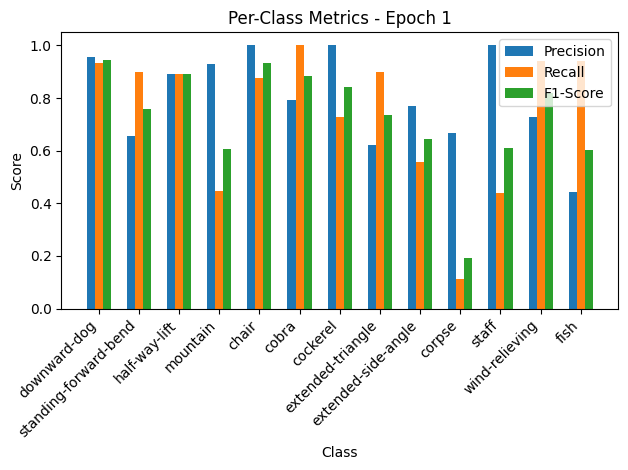


Epoch 2/50 Summary:
Train Loss: 0.6166 | Train Acc: 81.15% | Train Precision: 0.81 | Train Recall: 0.81 | Train F1: 0.81
Val Loss: 0.6788 | Val Acc: 77.68% | Val Precision: 0.82 | Val Recall: 0.78 | Val F1: 0.76

Epoch 3/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.25it/s, loss=0.451, accuracy=84.8]


Per-Class Metrics for Epoch 2:
downward-dog: Precision=0.92, Recall=0.90, F1-Score=0.91
standing-forward-bend: Precision=0.84, Recall=0.80, F1-Score=0.82
half-way-lift: Precision=0.83, Recall=0.87, F1-Score=0.85
mountain: Precision=0.82, Recall=0.83, F1-Score=0.82
chair: Precision=0.82, Recall=0.82, F1-Score=0.82
cobra: Precision=0.89, Recall=0.93, F1-Score=0.91
cockerel: Precision=0.95, Recall=0.98, F1-Score=0.96
extended-triangle: Precision=0.86, Recall=0.87, F1-Score=0.87
extended-side-angle: Precision=0.85, Recall=0.81, F1-Score=0.83
corpse: Precision=0.65, Recall=0.57, F1-Score=0.60
staff: Precision=0.87, Recall=0.91, F1-Score=0.89
wind-relieving: Precision=0.94, Recall=0.96, F1-Score=0.95
fish: Precision=0.68, Recall=0.72, F1-Score=0.70


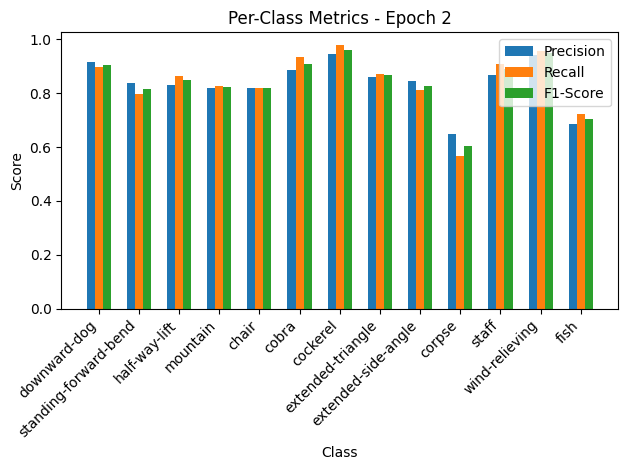

Validation: 100%|██████████| 21/21 [00:00<00:00, 30.54it/s, loss=0.325, accuracy=85.3]


Per-Class Metrics for Epoch 2:
downward-dog: Precision=1.00, Recall=0.93, F1-Score=0.97
standing-forward-bend: Precision=0.63, Recall=0.85, F1-Score=0.72
half-way-lift: Precision=0.89, Recall=0.43, F1-Score=0.58
mountain: Precision=0.83, Recall=1.00, F1-Score=0.91
chair: Precision=0.92, Recall=0.96, F1-Score=0.94
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.65, F1-Score=0.79
extended-side-angle: Precision=0.71, Recall=0.94, F1-Score=0.81
corpse: Precision=0.92, Recall=0.67, F1-Score=0.77
staff: Precision=0.75, Recall=0.94, F1-Score=0.83
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.75, Recall=0.88, F1-Score=0.81


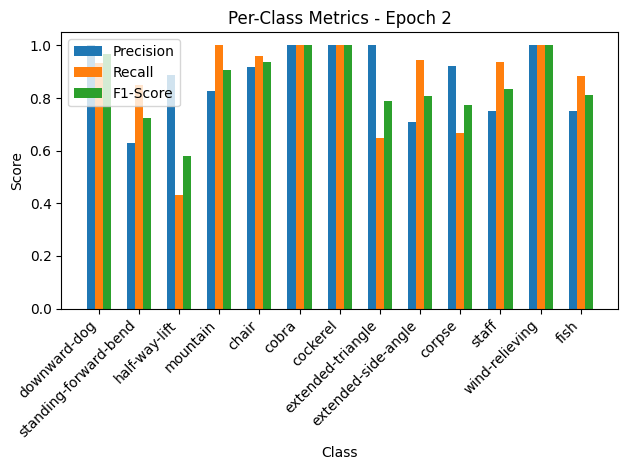


Epoch 3/50 Summary:
Train Loss: 0.4515 | Train Acc: 84.81% | Train Precision: 0.85 | Train Recall: 0.85 | Train F1: 0.85
Val Loss: 0.3341 | Val Acc: 85.32% | Val Precision: 0.88 | Val Recall: 0.85 | Val F1: 0.85
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model.pth
Checkpoint saved at epoch 3
New best model saved! Validation Loss: 0.3341

Epoch 4/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.38it/s, loss=0.311, accuracy=90.8]


Per-Class Metrics for Epoch 3:
downward-dog: Precision=0.96, Recall=0.95, F1-Score=0.95
standing-forward-bend: Precision=0.91, Recall=0.87, F1-Score=0.89
half-way-lift: Precision=0.87, Recall=0.90, F1-Score=0.88
mountain: Precision=0.92, Recall=0.91, F1-Score=0.92
chair: Precision=0.91, Recall=0.91, F1-Score=0.91
cobra: Precision=0.93, Recall=0.95, F1-Score=0.94
cockerel: Precision=0.98, Recall=0.96, F1-Score=0.97
extended-triangle: Precision=0.91, Recall=0.95, F1-Score=0.93
extended-side-angle: Precision=0.93, Recall=0.93, F1-Score=0.93
corpse: Precision=0.72, Recall=0.75, F1-Score=0.74
staff: Precision=0.96, Recall=0.98, F1-Score=0.97
wind-relieving: Precision=0.96, Recall=0.99, F1-Score=0.97
fish: Precision=0.76, Recall=0.70, F1-Score=0.73


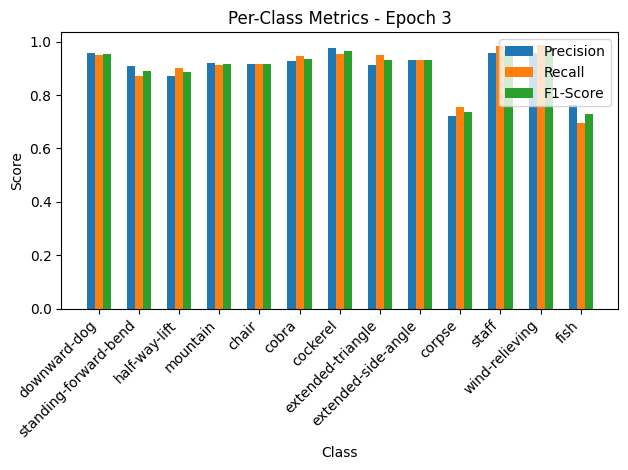

Validation: 100%|██████████| 21/21 [00:00<00:00, 26.65it/s, loss=0.342, accuracy=90.2]


Per-Class Metrics for Epoch 3:
downward-dog: Precision=0.98, Recall=0.93, F1-Score=0.96
standing-forward-bend: Precision=0.96, Recall=0.62, F1-Score=0.76
half-way-lift: Precision=0.78, Recall=0.97, F1-Score=0.87
mountain: Precision=0.74, Recall=1.00, F1-Score=0.85
chair: Precision=1.00, Recall=0.83, F1-Score=0.91
cobra: Precision=0.88, Recall=1.00, F1-Score=0.94
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.95, Recall=0.90, F1-Score=0.92
extended-side-angle: Precision=0.89, Recall=0.89, F1-Score=0.89
corpse: Precision=0.81, Recall=0.94, F1-Score=0.87
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.76, F1-Score=0.87


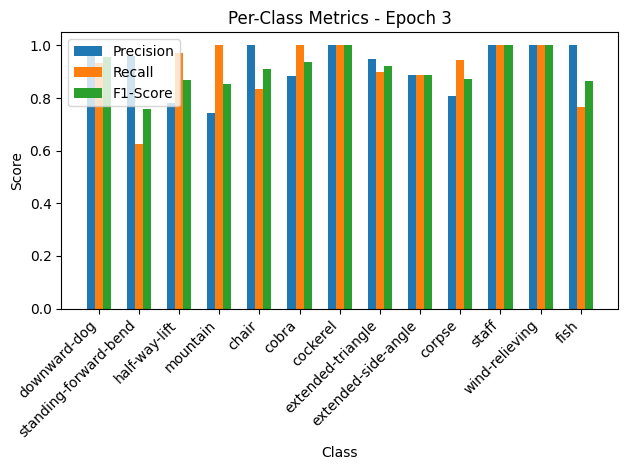


Epoch 4/50 Summary:
Train Loss: 0.3115 | Train Acc: 90.76% | Train Precision: 0.91 | Train Recall: 0.91 | Train F1: 0.91
Val Loss: 0.3516 | Val Acc: 90.21% | Val Precision: 0.92 | Val Recall: 0.90 | Val F1: 0.90

Epoch 5/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.31it/s, loss=0.31, accuracy=91.2]


Per-Class Metrics for Epoch 4:
downward-dog: Precision=0.97, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.96, Recall=0.88, F1-Score=0.92
half-way-lift: Precision=0.89, Recall=0.93, F1-Score=0.91
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.93, Recall=0.91, F1-Score=0.92
cobra: Precision=0.89, Recall=0.90, F1-Score=0.90
cockerel: Precision=0.91, Recall=0.96, F1-Score=0.93
extended-triangle: Precision=0.91, Recall=0.95, F1-Score=0.93
extended-side-angle: Precision=0.93, Recall=0.86, F1-Score=0.90
corpse: Precision=0.79, Recall=0.64, F1-Score=0.70
staff: Precision=0.93, Recall=0.98, F1-Score=0.96
wind-relieving: Precision=0.97, Recall=0.96, F1-Score=0.96
fish: Precision=0.71, Recall=0.87, F1-Score=0.78


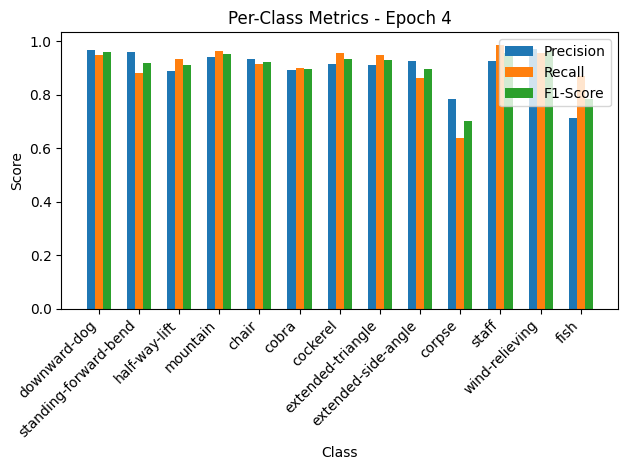

Validation: 100%|██████████| 21/21 [00:00<00:00, 28.68it/s, loss=0.251, accuracy=92.7]


Per-Class Metrics for Epoch 4:
downward-dog: Precision=0.98, Recall=0.93, F1-Score=0.96
standing-forward-bend: Precision=0.83, Recall=0.95, F1-Score=0.88
half-way-lift: Precision=0.97, Recall=0.81, F1-Score=0.88
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=1.00, Recall=0.91, F1-Score=0.95
extended-triangle: Precision=1.00, Recall=0.90, F1-Score=0.95
extended-side-angle: Precision=0.90, Recall=1.00, F1-Score=0.95
corpse: Precision=0.93, Recall=0.78, F1-Score=0.85
staff: Precision=0.88, Recall=0.94, F1-Score=0.91
wind-relieving: Precision=0.94, Recall=1.00, F1-Score=0.97
fish: Precision=0.79, Recall=0.88, F1-Score=0.83


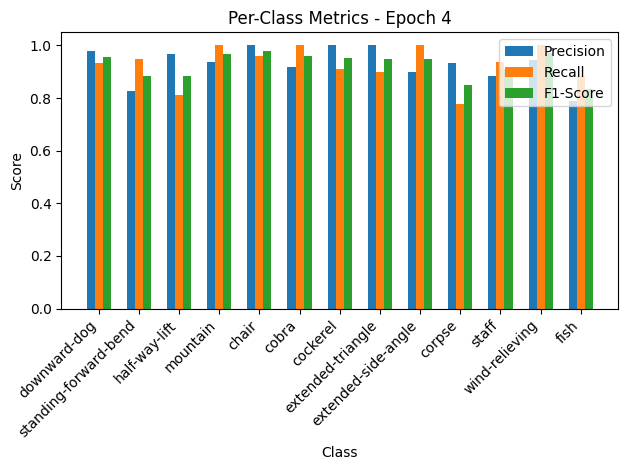


Epoch 5/50 Summary:
Train Loss: 0.3102 | Train Acc: 91.22% | Train Precision: 0.91 | Train Recall: 0.91 | Train F1: 0.91
Val Loss: 0.2581 | Val Acc: 92.66% | Val Precision: 0.93 | Val Recall: 0.93 | Val F1: 0.93
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model.pth
Checkpoint saved at epoch 5
New best model saved! Validation Loss: 0.2581

Epoch 6/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.78it/s, loss=0.236, accuracy=93.1]


Per-Class Metrics for Epoch 5:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.89, F1-Score=0.92
half-way-lift: Precision=0.90, Recall=0.95, F1-Score=0.93
mountain: Precision=0.93, Recall=0.96, F1-Score=0.94
chair: Precision=0.97, Recall=0.95, F1-Score=0.96
cobra: Precision=0.96, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.92, Recall=0.97, F1-Score=0.94
extended-side-angle: Precision=0.97, Recall=0.89, F1-Score=0.93
corpse: Precision=0.78, Recall=0.75, F1-Score=0.76
staff: Precision=0.97, Recall=0.97, F1-Score=0.97
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.77, Recall=0.80, F1-Score=0.79


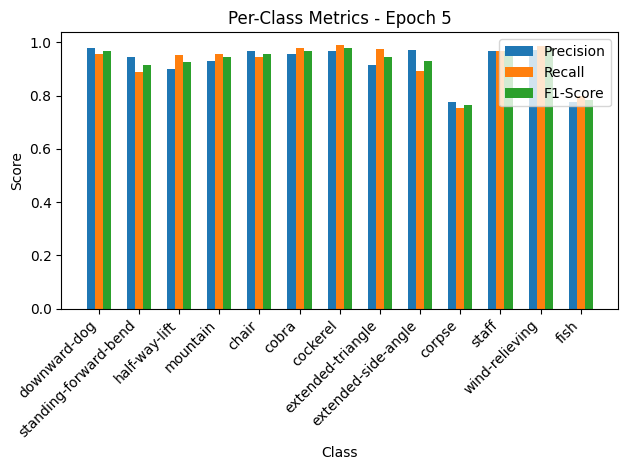

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.21it/s, loss=0.322, accuracy=90.8]


Per-Class Metrics for Epoch 5:
downward-dog: Precision=1.00, Recall=0.87, F1-Score=0.93
standing-forward-bend: Precision=0.95, Recall=0.90, F1-Score=0.92
half-way-lift: Precision=0.85, Recall=0.95, F1-Score=0.90
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.92, Recall=0.96, F1-Score=0.94
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=1.00, Recall=0.91, F1-Score=0.95
extended-triangle: Precision=0.90, Recall=0.90, F1-Score=0.90
extended-side-angle: Precision=0.89, Recall=0.89, F1-Score=0.89
corpse: Precision=0.65, Recall=0.94, F1-Score=0.77
staff: Precision=0.89, Recall=1.00, F1-Score=0.94
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.89, Recall=0.47, F1-Score=0.62


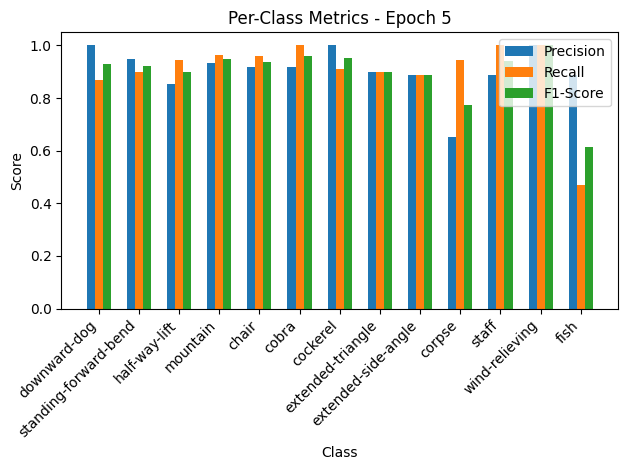


Epoch 6/50 Summary:
Train Loss: 0.2359 | Train Acc: 93.13% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.3313 | Val Acc: 90.83% | Val Precision: 0.92 | Val Recall: 0.91 | Val F1: 0.91

Epoch 7/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  9.02it/s, loss=0.275, accuracy=91.8]


Per-Class Metrics for Epoch 6:
downward-dog: Precision=0.99, Recall=0.96, F1-Score=0.98
standing-forward-bend: Precision=0.93, Recall=0.91, F1-Score=0.92
half-way-lift: Precision=0.90, Recall=0.93, F1-Score=0.91
mountain: Precision=0.92, Recall=0.95, F1-Score=0.94
chair: Precision=0.93, Recall=0.91, F1-Score=0.92
cobra: Precision=0.98, Recall=0.97, F1-Score=0.97
cockerel: Precision=0.94, Recall=0.94, F1-Score=0.94
extended-triangle: Precision=0.97, Recall=0.94, F1-Score=0.95
extended-side-angle: Precision=0.95, Recall=0.97, F1-Score=0.96
corpse: Precision=0.71, Recall=0.68, F1-Score=0.70
staff: Precision=0.90, Recall=0.94, F1-Score=0.92
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.68, Recall=0.72, F1-Score=0.70


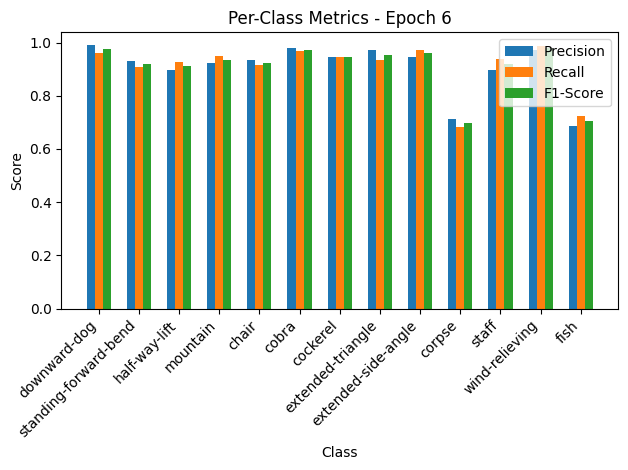

Validation: 100%|██████████| 21/21 [00:00<00:00, 23.38it/s, loss=0.37, accuracy=90.2]


Per-Class Metrics for Epoch 6:
downward-dog: Precision=1.00, Recall=0.93, F1-Score=0.97
standing-forward-bend: Precision=1.00, Recall=0.68, F1-Score=0.81
half-way-lift: Precision=0.74, Recall=1.00, F1-Score=0.85
mountain: Precision=0.88, Recall=1.00, F1-Score=0.94
chair: Precision=1.00, Recall=0.79, F1-Score=0.88
cobra: Precision=0.88, Recall=1.00, F1-Score=0.94
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.95, Recall=0.90, F1-Score=0.92
extended-side-angle: Precision=0.85, Recall=0.94, F1-Score=0.89
corpse: Precision=0.77, Recall=0.94, F1-Score=0.85
staff: Precision=0.89, Recall=1.00, F1-Score=0.94
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.91, Recall=0.59, F1-Score=0.71


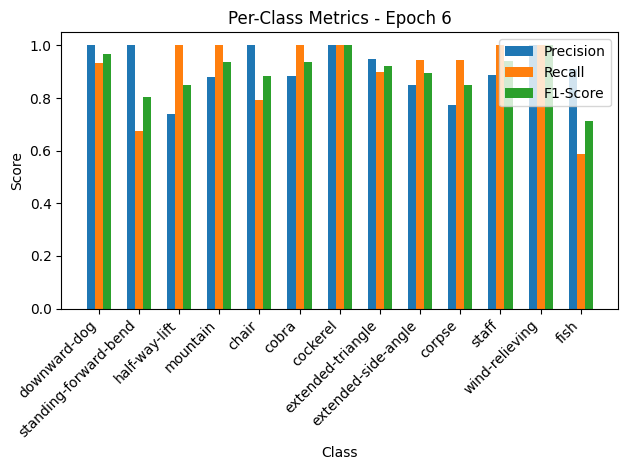


Epoch 7/50 Summary:
Train Loss: 0.2750 | Train Acc: 91.76% | Train Precision: 0.92 | Train Recall: 0.92 | Train F1: 0.92
Val Loss: 0.3800 | Val Acc: 90.21% | Val Precision: 0.92 | Val Recall: 0.90 | Val F1: 0.90

Epoch 8/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  9.04it/s, loss=0.267, accuracy=91.6]


Per-Class Metrics for Epoch 7:
downward-dog: Precision=0.97, Recall=0.96, F1-Score=0.96
standing-forward-bend: Precision=0.93, Recall=0.88, F1-Score=0.90
half-way-lift: Precision=0.90, Recall=0.94, F1-Score=0.92
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.94, Recall=0.93, F1-Score=0.93
cobra: Precision=0.98, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.93, Recall=0.96, F1-Score=0.94
extended-triangle: Precision=0.96, Recall=0.92, F1-Score=0.94
extended-side-angle: Precision=0.94, Recall=0.97, F1-Score=0.95
corpse: Precision=0.68, Recall=0.71, F1-Score=0.70
staff: Precision=0.94, Recall=1.00, F1-Score=0.97
wind-relieving: Precision=0.96, Recall=0.94, F1-Score=0.95
fish: Precision=0.69, Recall=0.65, F1-Score=0.67


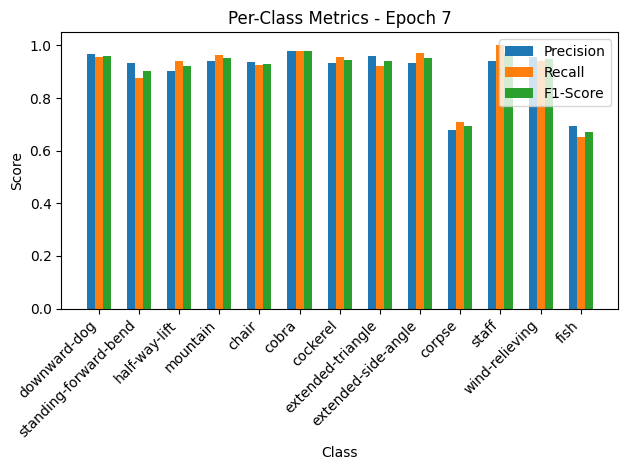

Validation: 100%|██████████| 21/21 [00:00<00:00, 30.27it/s, loss=0.303, accuracy=92.7]


Per-Class Metrics for Epoch 7:
downward-dog: Precision=1.00, Recall=0.93, F1-Score=0.97
standing-forward-bend: Precision=0.93, Recall=0.93, F1-Score=0.93
half-way-lift: Precision=0.89, Recall=0.92, F1-Score=0.91
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.88, Recall=1.00, F1-Score=0.94
cockerel: Precision=1.00, Recall=0.91, F1-Score=0.95
extended-triangle: Precision=0.75, Recall=0.90, F1-Score=0.82
extended-side-angle: Precision=0.86, Recall=0.67, F1-Score=0.75
corpse: Precision=0.89, Recall=0.89, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.88, Recall=0.88, F1-Score=0.88


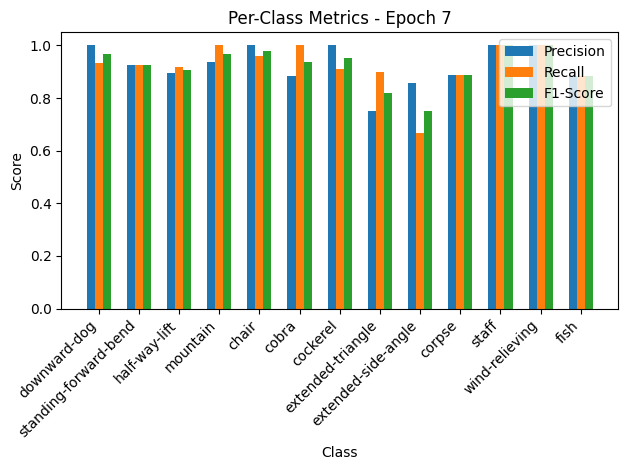


Epoch 8/50 Summary:
Train Loss: 0.2673 | Train Acc: 91.60% | Train Precision: 0.92 | Train Recall: 0.92 | Train F1: 0.92
Val Loss: 0.3111 | Val Acc: 92.66% | Val Precision: 0.93 | Val Recall: 0.93 | Val F1: 0.93

Epoch 9/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.76it/s, loss=0.218, accuracy=94]


Per-Class Metrics for Epoch 8:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.95, Recall=0.95, F1-Score=0.95
half-way-lift: Precision=0.96, Recall=0.93, F1-Score=0.95
mountain: Precision=0.96, Recall=0.97, F1-Score=0.96
chair: Precision=0.93, Recall=0.93, F1-Score=0.93
cobra: Precision=0.96, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.93, Recall=0.94, F1-Score=0.94
extended-triangle: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.96, F1-Score=0.96
corpse: Precision=0.83, Recall=0.71, F1-Score=0.77
staff: Precision=0.97, Recall=0.97, F1-Score=0.97
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.75, Recall=0.86, F1-Score=0.80


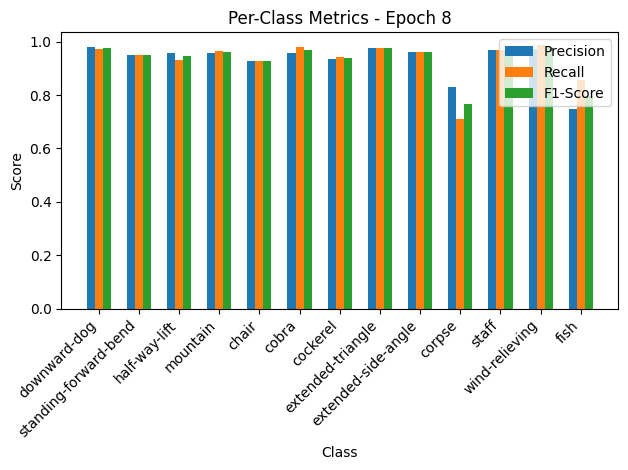

Validation: 100%|██████████| 21/21 [00:00<00:00, 28.88it/s, loss=0.297, accuracy=93.9]


Per-Class Metrics for Epoch 8:
downward-dog: Precision=1.00, Recall=0.93, F1-Score=0.97
standing-forward-bend: Precision=1.00, Recall=0.90, F1-Score=0.95
half-way-lift: Precision=0.90, Recall=1.00, F1-Score=0.95
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.83, F1-Score=0.91
cobra: Precision=0.88, Recall=1.00, F1-Score=0.94
cockerel: Precision=1.00, Recall=0.95, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=0.90, F1-Score=0.92
extended-side-angle: Precision=0.77, Recall=0.94, F1-Score=0.85
corpse: Precision=0.84, Recall=0.89, F1-Score=0.86
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.88, Recall=0.82, F1-Score=0.85


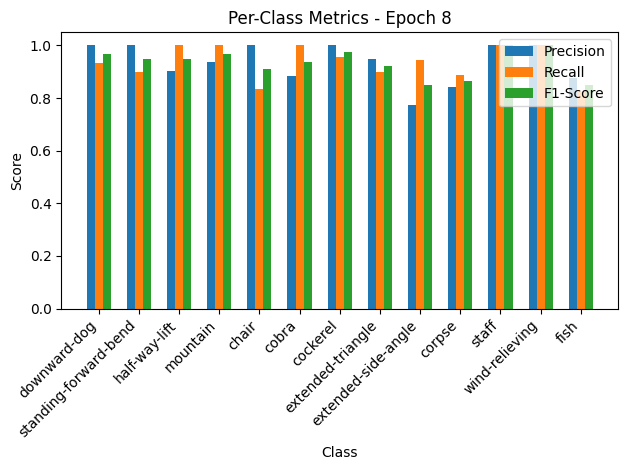


Epoch 9/50 Summary:
Train Loss: 0.2187 | Train Acc: 93.97% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.3055 | Val Acc: 93.88% | Val Precision: 0.94 | Val Recall: 0.94 | Val F1: 0.94

Epoch 10/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.17it/s, loss=0.19, accuracy=94.4]


Per-Class Metrics for Epoch 9:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.92, Recall=0.97, F1-Score=0.94
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=0.95, Recall=0.94, F1-Score=0.94
cobra: Precision=0.94, Recall=0.99, F1-Score=0.96
cockerel: Precision=0.95, Recall=0.94, F1-Score=0.95
extended-triangle: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.97, F1-Score=0.96
corpse: Precision=0.83, Recall=0.80, F1-Score=0.81
staff: Precision=0.97, Recall=0.98, F1-Score=0.98
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.82, Recall=0.84, F1-Score=0.83


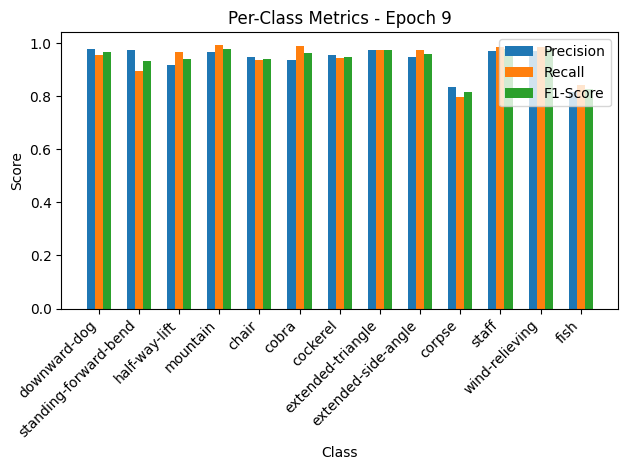

Validation: 100%|██████████| 21/21 [00:00<00:00, 24.94it/s, loss=0.223, accuracy=94.8]


Per-Class Metrics for Epoch 9:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=1.00, Recall=0.90, F1-Score=0.95
half-way-lift: Precision=0.93, Recall=1.00, F1-Score=0.96
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.92, Recall=0.96, F1-Score=0.94
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.86, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.88, Recall=0.83, F1-Score=0.86
corpse: Precision=0.84, Recall=0.89, F1-Score=0.86
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.88, Recall=0.82, F1-Score=0.85


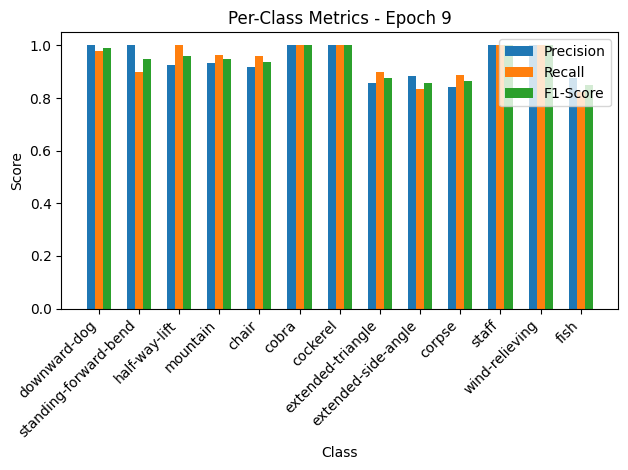


Epoch 10/50 Summary:
Train Loss: 0.1904 | Train Acc: 94.35% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.2292 | Val Acc: 94.80% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model.pth
Checkpoint saved at epoch 10
New best model saved! Validation Loss: 0.2292

Epoch 11/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.26it/s, loss=0.194, accuracy=94.3]


Per-Class Metrics for Epoch 10:
downward-dog: Precision=0.97, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.92, Recall=0.91, F1-Score=0.92
half-way-lift: Precision=0.93, Recall=0.92, F1-Score=0.92
mountain: Precision=0.94, Recall=0.94, F1-Score=0.94
chair: Precision=0.95, Recall=0.93, F1-Score=0.94
cobra: Precision=0.97, Recall=0.96, F1-Score=0.96
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.86, Recall=0.80, F1-Score=0.83
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.81, Recall=0.86, F1-Score=0.83


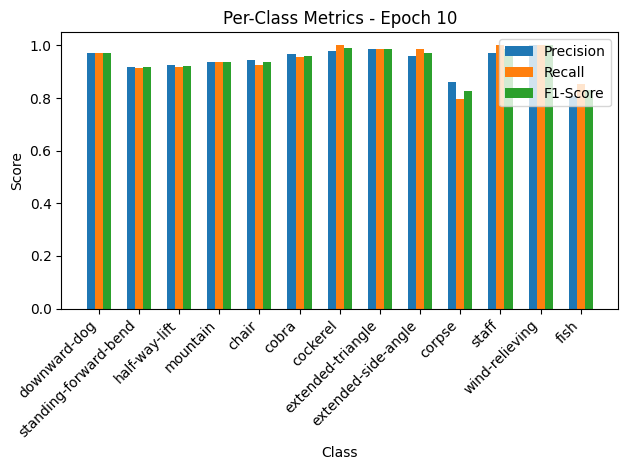

Validation: 100%|██████████| 21/21 [00:00<00:00, 27.72it/s, loss=0.3, accuracy=93.9]


Per-Class Metrics for Epoch 10:
downward-dog: Precision=1.00, Recall=0.96, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.85, F1-Score=0.91
half-way-lift: Precision=0.88, Recall=0.97, F1-Score=0.92
mountain: Precision=0.97, Recall=1.00, F1-Score=0.98
chair: Precision=0.96, Recall=0.96, F1-Score=0.96
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.82, Recall=0.90, F1-Score=0.86
extended-side-angle: Precision=0.88, Recall=0.78, F1-Score=0.82
corpse: Precision=0.85, Recall=0.94, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.82, F1-Score=0.88


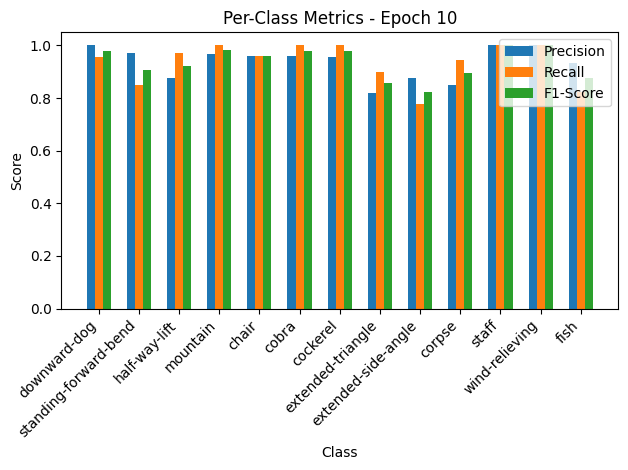


Epoch 11/50 Summary:
Train Loss: 0.1948 | Train Acc: 94.27% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.3087 | Val Acc: 93.88% | Val Precision: 0.94 | Val Recall: 0.94 | Val F1: 0.94

Epoch 12/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.26it/s, loss=0.152, accuracy=95.5]


Per-Class Metrics for Epoch 11:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.95, Recall=0.97, F1-Score=0.96
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.94, F1-Score=0.95
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.95, Recall=0.97, F1-Score=0.96
extended-triangle: Precision=0.99, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.92, Recall=0.99, F1-Score=0.95
corpse: Precision=0.85, Recall=0.84, F1-Score=0.85
staff: Precision=0.98, Recall=0.98, F1-Score=0.98
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.84, Recall=0.86, F1-Score=0.85


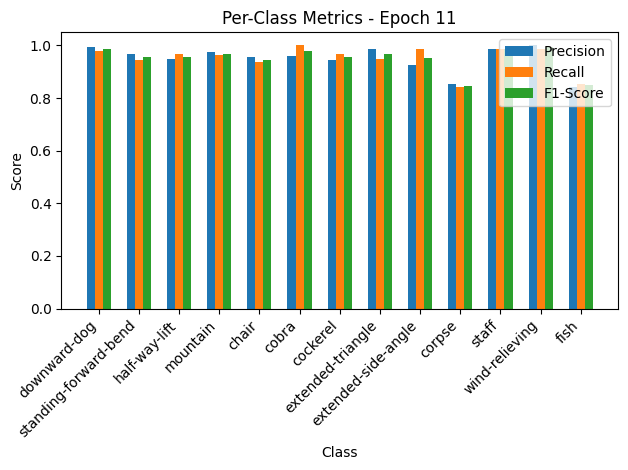

Validation: 100%|██████████| 21/21 [00:00<00:00, 28.77it/s, loss=0.385, accuracy=93.6]


Per-Class Metrics for Epoch 11:
downward-dog: Precision=0.98, Recall=0.93, F1-Score=0.96
standing-forward-bend: Precision=0.93, Recall=0.93, F1-Score=0.93
half-way-lift: Precision=0.89, Recall=0.92, F1-Score=0.91
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.88, Recall=1.00, F1-Score=0.94
cockerel: Precision=1.00, Recall=0.86, F1-Score=0.93
extended-triangle: Precision=0.90, Recall=0.90, F1-Score=0.90
extended-side-angle: Precision=0.89, Recall=0.89, F1-Score=0.89
corpse: Precision=0.89, Recall=0.89, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.88, Recall=0.88, F1-Score=0.88


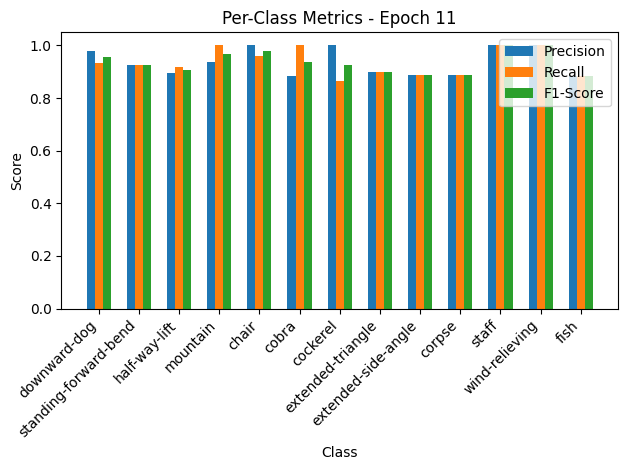


Epoch 12/50 Summary:
Train Loss: 0.1522 | Train Acc: 95.50% | Train Precision: 0.96 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.3959 | Val Acc: 93.58% | Val Precision: 0.94 | Val Recall: 0.94 | Val F1: 0.94

Epoch 13/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.84it/s, loss=0.212, accuracy=95.1]


Per-Class Metrics for Epoch 12:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.94, Recall=0.94, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.97, Recall=0.98, F1-Score=0.97
chair: Precision=0.97, Recall=0.93, F1-Score=0.95
cobra: Precision=0.94, Recall=0.99, F1-Score=0.96
cockerel: Precision=0.97, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=0.96, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.97, F1-Score=0.97
corpse: Precision=0.83, Recall=0.83, F1-Score=0.83
staff: Precision=0.98, Recall=0.98, F1-Score=0.98
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.85, Recall=0.83, F1-Score=0.84


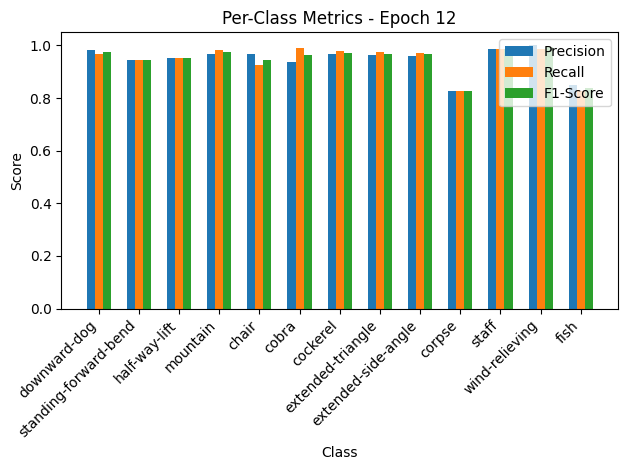

Validation: 100%|██████████| 21/21 [00:00<00:00, 30.05it/s, loss=0.289, accuracy=93.9]


Per-Class Metrics for Epoch 12:
downward-dog: Precision=1.00, Recall=0.96, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.93, F1-Score=0.95
half-way-lift: Precision=0.95, Recall=0.97, F1-Score=0.96
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.92, Recall=1.00, F1-Score=0.96
extended-triangle: Precision=0.86, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.88, Recall=0.83, F1-Score=0.86
corpse: Precision=0.74, Recall=0.94, F1-Score=0.83
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=0.92, Recall=0.65, F1-Score=0.76


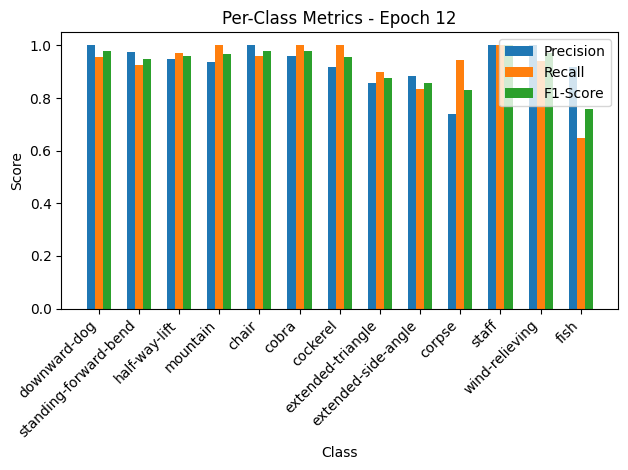


Epoch 13/50 Summary:
Train Loss: 0.2119 | Train Acc: 95.11% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.2970 | Val Acc: 93.88% | Val Precision: 0.94 | Val Recall: 0.94 | Val F1: 0.94

Epoch 14/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.73it/s, loss=0.161, accuracy=95.1]


Per-Class Metrics for Epoch 13:
downward-dog: Precision=0.97, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.94, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.93, F1-Score=0.94
mountain: Precision=0.95, Recall=0.96, F1-Score=0.95
chair: Precision=0.97, Recall=0.96, F1-Score=0.96
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.98, Recall=0.98, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.95, F1-Score=0.96
extended-side-angle: Precision=0.92, Recall=0.96, F1-Score=0.94
corpse: Precision=0.91, Recall=0.86, F1-Score=0.88
staff: Precision=0.96, Recall=1.00, F1-Score=0.98
wind-relieving: Precision=0.99, Recall=0.96, F1-Score=0.97
fish: Precision=0.88, Recall=0.91, F1-Score=0.89


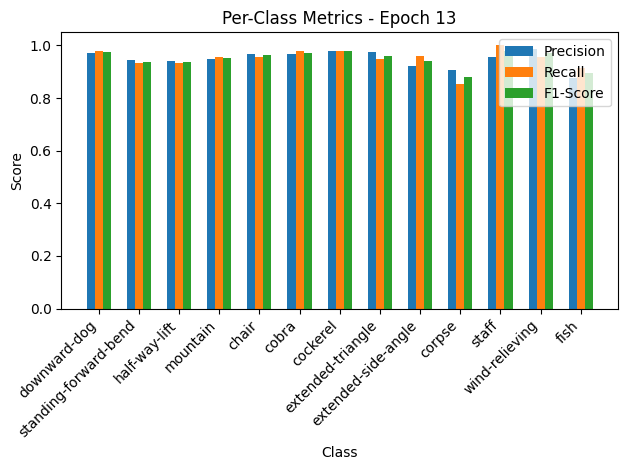

Validation: 100%|██████████| 21/21 [00:00<00:00, 30.81it/s, loss=0.347, accuracy=94.8]


Per-Class Metrics for Epoch 13:
downward-dog: Precision=1.00, Recall=0.93, F1-Score=0.97
standing-forward-bend: Precision=1.00, Recall=0.90, F1-Score=0.95
half-way-lift: Precision=0.93, Recall=1.00, F1-Score=0.96
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.88, Recall=1.00, F1-Score=0.94
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.86, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.88, Recall=0.83, F1-Score=0.86
corpse: Precision=0.85, Recall=0.94, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.82, F1-Score=0.88


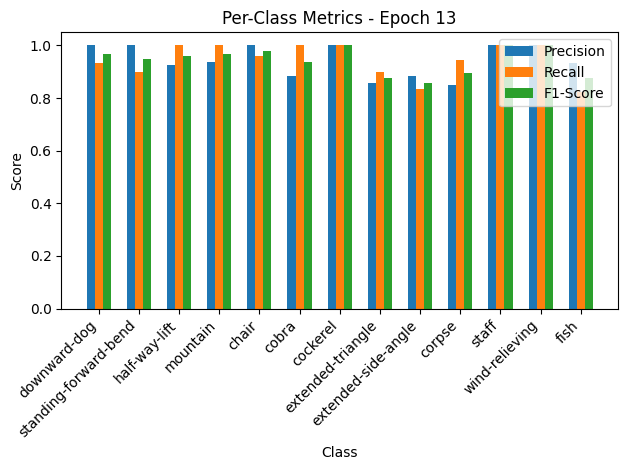


Epoch 14/50 Summary:
Train Loss: 0.1616 | Train Acc: 95.11% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.3567 | Val Acc: 94.80% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 15/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.74it/s, loss=0.132, accuracy=96]


Per-Class Metrics for Epoch 14:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.99, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.95, Recall=0.97, F1-Score=0.96
mountain: Precision=0.98, Recall=0.99, F1-Score=0.99
chair: Precision=0.95, Recall=0.95, F1-Score=0.95
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.95, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.96, F1-Score=0.97
corpse: Precision=0.89, Recall=0.81, F1-Score=0.85
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.83, Recall=0.90, F1-Score=0.86


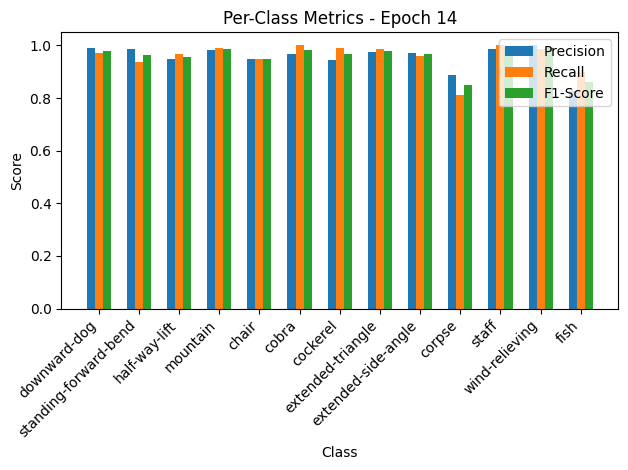

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.44it/s, loss=0.401, accuracy=95.1]


Per-Class Metrics for Epoch 14:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.97, Recall=1.00, F1-Score=0.98
chair: Precision=0.96, Recall=0.96, F1-Score=0.96
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.86, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.88, Recall=0.83, F1-Score=0.86
corpse: Precision=0.85, Recall=0.94, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.82, F1-Score=0.88


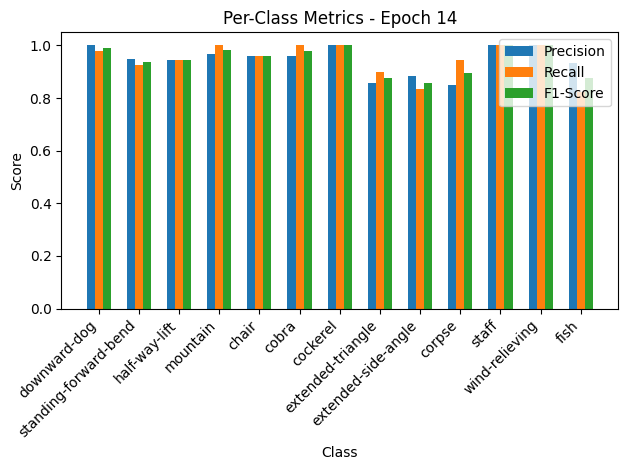


Epoch 15/50 Summary:
Train Loss: 0.1321 | Train Acc: 96.03% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.4119 | Val Acc: 95.11% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 16/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  9.09it/s, loss=0.0853, accuracy=97.6]


Per-Class Metrics for Epoch 15:
downward-dog: Precision=0.98, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.95, Recall=0.97, F1-Score=0.96
mountain: Precision=0.97, Recall=0.98, F1-Score=0.98
chair: Precision=0.98, Recall=0.97, F1-Score=0.97
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=1.00, Recall=0.99, F1-Score=0.99
corpse: Precision=0.89, Recall=0.94, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.88, F1-Score=0.91


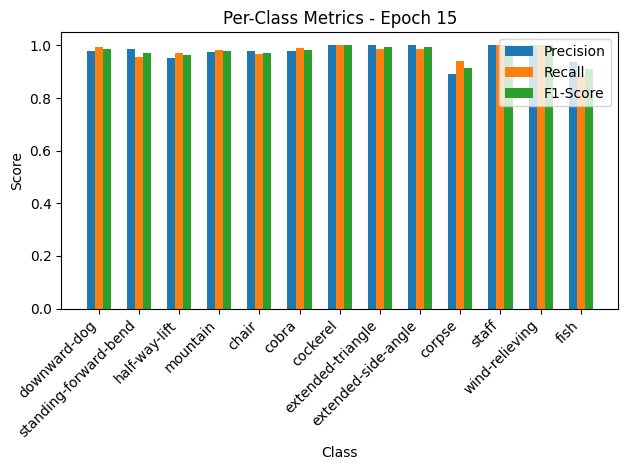

Validation: 100%|██████████| 21/21 [00:00<00:00, 26.95it/s, loss=0.356, accuracy=95.1]


Per-Class Metrics for Epoch 15:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.86, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.88, Recall=0.83, F1-Score=0.86
corpse: Precision=0.85, Recall=0.94, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.82, F1-Score=0.88


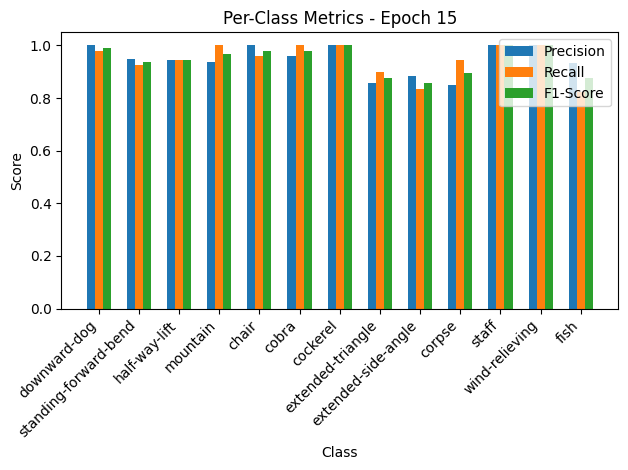


Epoch 16/50 Summary:
Train Loss: 0.0855 | Train Acc: 97.56% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.3663 | Val Acc: 95.11% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 17/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.78it/s, loss=0.0681, accuracy=98]


Per-Class Metrics for Epoch 16:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.98, Recall=0.98, F1-Score=0.98
chair: Precision=0.98, Recall=0.97, F1-Score=0.97
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.97, Recall=1.00, F1-Score=0.99
extended-side-angle: Precision=1.00, Recall=0.99, F1-Score=0.99
corpse: Precision=0.93, Recall=0.93, F1-Score=0.93
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.93, Recall=0.91, F1-Score=0.92


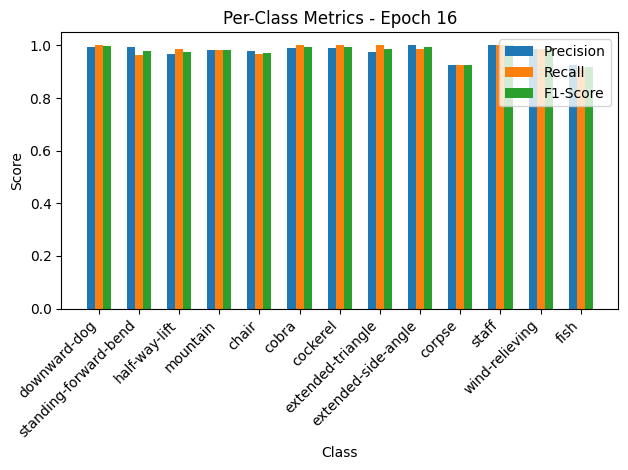

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.61it/s, loss=0.335, accuracy=95.1]


Per-Class Metrics for Epoch 16:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.86, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.88, Recall=0.83, F1-Score=0.86
corpse: Precision=0.85, Recall=0.94, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.82, F1-Score=0.88


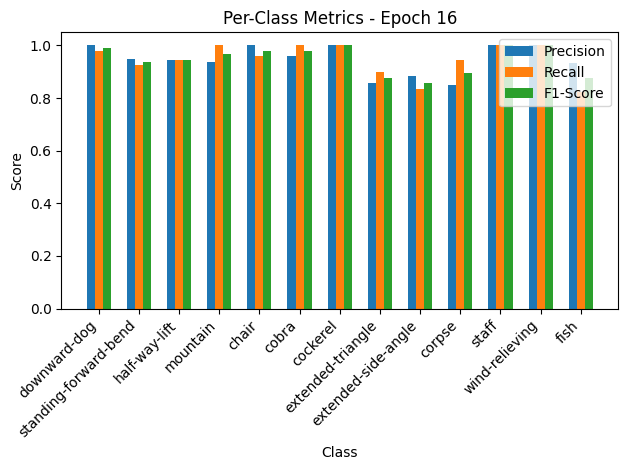


Epoch 17/50 Summary:
Train Loss: 0.0682 | Train Acc: 98.02% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.3440 | Val Acc: 95.11% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 18/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:10<00:00,  8.04it/s, loss=0.0636, accuracy=98.5]


Per-Class Metrics for Epoch 17:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.98, F1-Score=0.98
mountain: Precision=0.97, Recall=0.98, F1-Score=0.98
chair: Precision=0.99, Recall=0.95, F1-Score=0.97
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.99, Recall=0.97, F1-Score=0.98
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.97, Recall=0.97, F1-Score=0.97


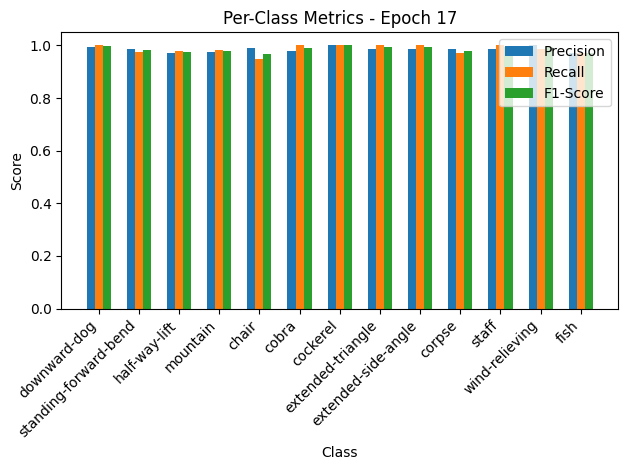

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.06it/s, loss=0.333, accuracy=95.1]


Per-Class Metrics for Epoch 17:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.86, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.88, Recall=0.83, F1-Score=0.86
corpse: Precision=0.85, Recall=0.94, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.82, F1-Score=0.88


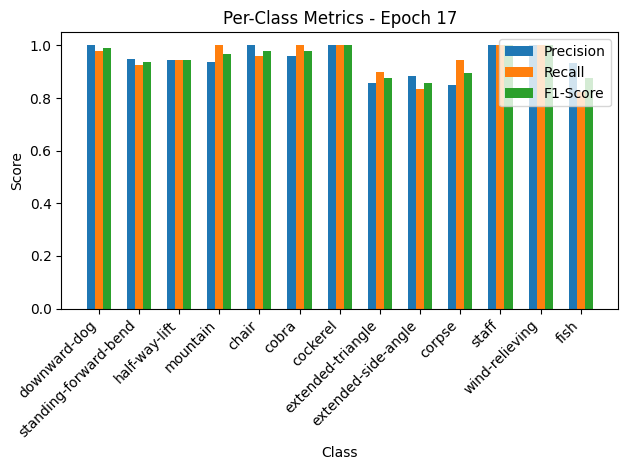


Epoch 18/50 Summary:
Train Loss: 0.0637 | Train Acc: 98.55% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.3418 | Val Acc: 95.11% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 19/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.77it/s, loss=0.0607, accuracy=98.2]


Per-Class Metrics for Epoch 18:
downward-dog: Precision=0.98, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.96, Recall=0.98, F1-Score=0.97
mountain: Precision=0.99, Recall=0.99, F1-Score=0.99
chair: Precision=0.99, Recall=0.97, F1-Score=0.98
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-side-angle: Precision=0.99, Recall=0.97, F1-Score=0.98
corpse: Precision=0.95, Recall=1.00, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.97, Recall=1.00, F1-Score=0.99
fish: Precision=1.00, Recall=0.91, F1-Score=0.95


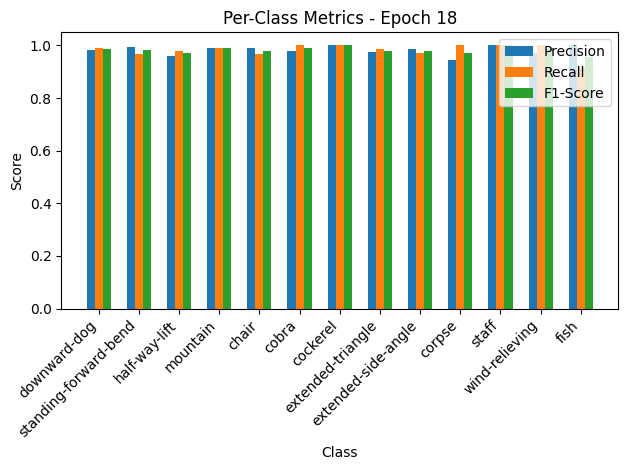

Validation: 100%|██████████| 21/21 [00:00<00:00, 24.78it/s, loss=0.336, accuracy=95.1]


Per-Class Metrics for Epoch 18:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.86, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.88, Recall=0.83, F1-Score=0.86
corpse: Precision=0.85, Recall=0.94, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.82, F1-Score=0.88


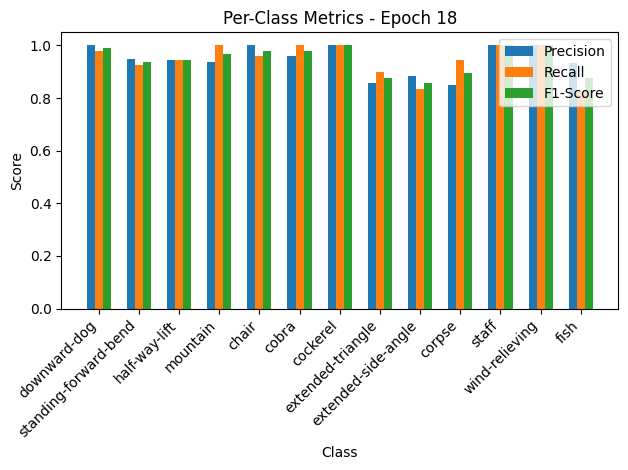


Epoch 19/50 Summary:
Train Loss: 0.0608 | Train Acc: 98.24% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.3451 | Val Acc: 95.11% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 20/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.13it/s, loss=0.04, accuracy=98.6]


Per-Class Metrics for Epoch 19:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.99
mountain: Precision=0.99, Recall=0.99, F1-Score=0.99
chair: Precision=0.99, Recall=0.98, F1-Score=0.98
cobra: Precision=0.99, Recall=0.98, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.94, Recall=0.93, F1-Score=0.93
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.94, F1-Score=0.94


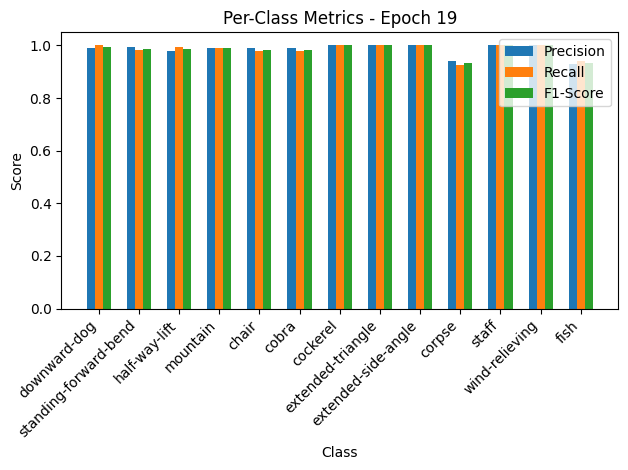

Validation: 100%|██████████| 21/21 [00:00<00:00, 31.96it/s, loss=0.286, accuracy=95.4]


Per-Class Metrics for Epoch 19:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.86, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.88, Recall=0.83, F1-Score=0.86
corpse: Precision=0.89, Recall=0.94, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.88, F1-Score=0.91


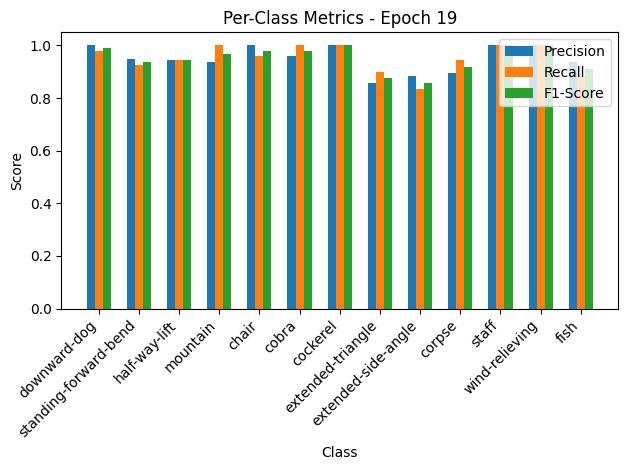


Epoch 20/50 Summary:
Train Loss: 0.0400 | Train Acc: 98.63% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2943 | Val Acc: 95.41% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 21/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:10<00:00,  8.16it/s, loss=0.0449, accuracy=98.6]


Per-Class Metrics for Epoch 20:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.98, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.97, F1-Score=0.97
mountain: Precision=0.98, Recall=0.99, F1-Score=0.99
chair: Precision=0.99, Recall=0.98, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.96, Recall=0.97, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.97, Recall=0.97, F1-Score=0.97


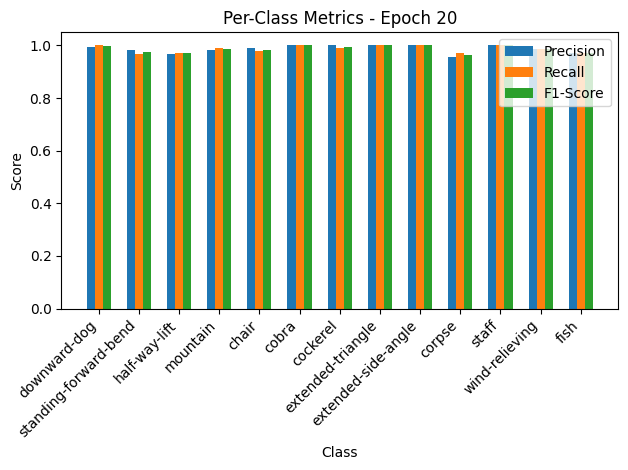

Validation: 100%|██████████| 21/21 [00:00<00:00, 28.26it/s, loss=0.296, accuracy=95.4]


Per-Class Metrics for Epoch 20:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.86, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.88, Recall=0.83, F1-Score=0.86
corpse: Precision=0.89, Recall=0.94, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.88, F1-Score=0.91


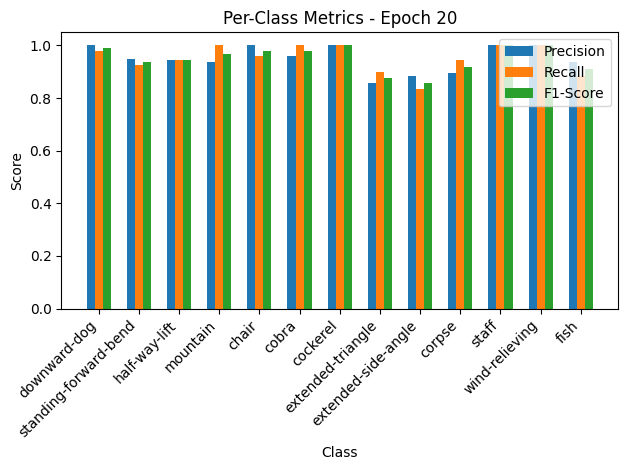


Epoch 21/50 Summary:
Train Loss: 0.0450 | Train Acc: 98.63% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.3043 | Val Acc: 95.41% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 22/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:08<00:00,  9.52it/s, loss=0.0492, accuracy=98.5]


Per-Class Metrics for Epoch 21:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.98, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=0.98, Recall=0.93, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.99, F1-Score=0.96


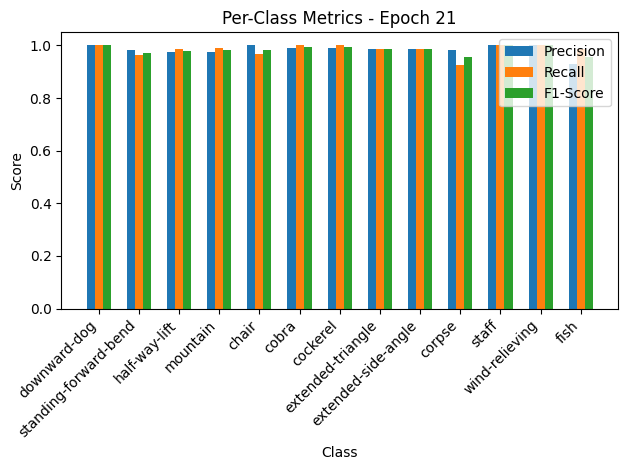

Validation: 100%|██████████| 21/21 [00:00<00:00, 25.85it/s, loss=0.308, accuracy=95.1]


Per-Class Metrics for Epoch 21:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.86, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.88, Recall=0.83, F1-Score=0.86
corpse: Precision=0.85, Recall=0.94, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.82, F1-Score=0.88


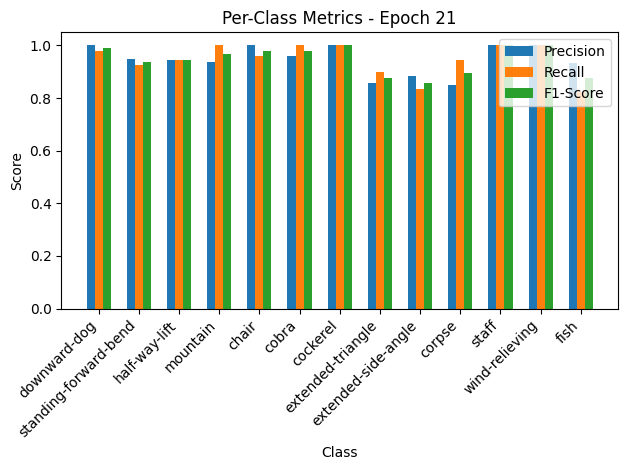


Epoch 22/50 Summary:
Train Loss: 0.0492 | Train Acc: 98.47% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.3160 | Val Acc: 95.11% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 23/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:08<00:00,  9.27it/s, loss=0.0513, accuracy=98.4]


Per-Class Metrics for Epoch 22:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.98, F1-Score=0.97
mountain: Precision=0.97, Recall=1.00, F1-Score=0.98
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.98, Recall=0.93, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.99, F1-Score=0.96


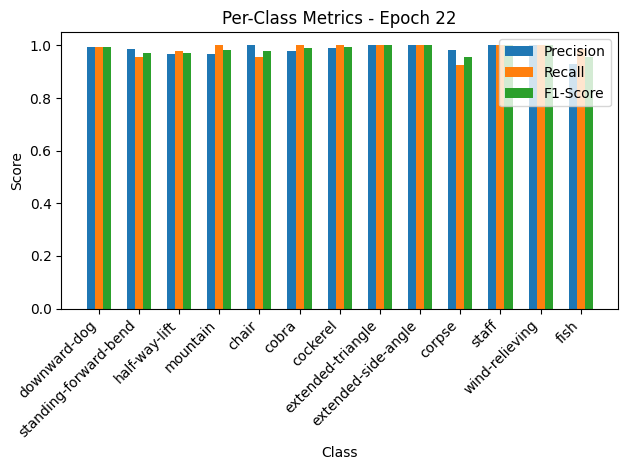

Validation: 100%|██████████| 21/21 [00:00<00:00, 30.44it/s, loss=0.309, accuracy=95.1]


Per-Class Metrics for Epoch 22:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.86, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.88, Recall=0.83, F1-Score=0.86
corpse: Precision=0.85, Recall=0.94, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.82, F1-Score=0.88


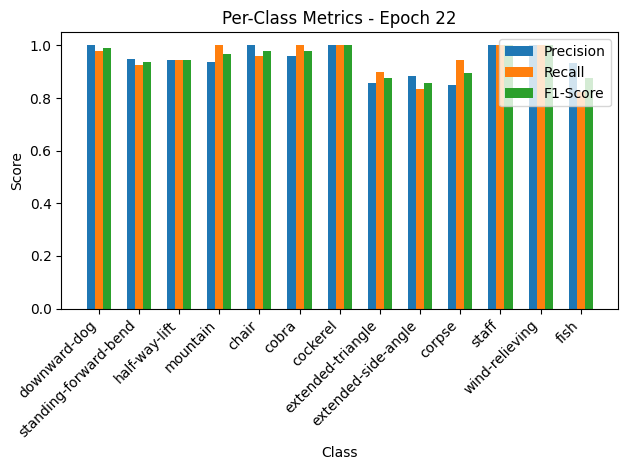


Epoch 23/50 Summary:
Train Loss: 0.0514 | Train Acc: 98.40% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.3174 | Val Acc: 95.11% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 24/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:09<00:00,  8.37it/s, loss=0.0432, accuracy=98.5]


Per-Class Metrics for Epoch 23:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.98, F1-Score=0.98
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.99, F1-Score=0.99
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.96, Recall=0.94, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.96, F1-Score=0.95


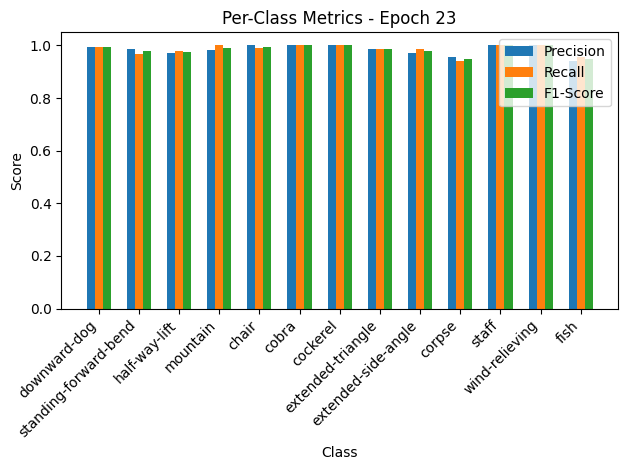

Validation: 100%|██████████| 21/21 [00:00<00:00, 30.42it/s, loss=0.301, accuracy=95.1]


Per-Class Metrics for Epoch 23:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.86, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.88, Recall=0.83, F1-Score=0.86
corpse: Precision=0.85, Recall=0.94, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.82, F1-Score=0.88


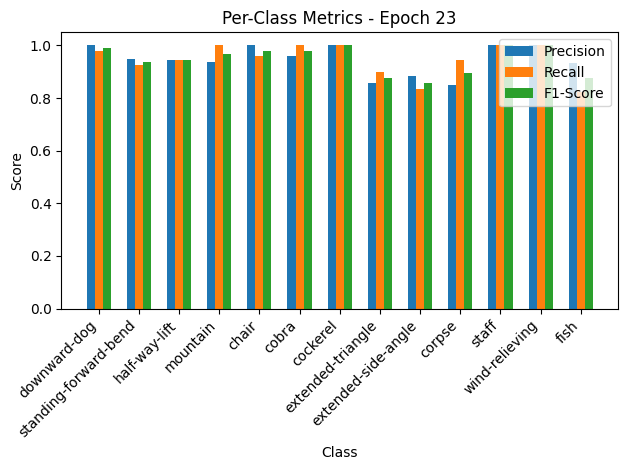


Epoch 24/50 Summary:
Train Loss: 0.0433 | Train Acc: 98.55% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.3094 | Val Acc: 95.11% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 25/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:08<00:00,  9.14it/s, loss=0.0349, accuracy=98.6]


Per-Class Metrics for Epoch 24:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.98, Recall=0.99, F1-Score=0.99
chair: Precision=0.99, Recall=0.96, F1-Score=0.97
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.99, Recall=0.99, F1-Score=0.99
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.99, Recall=0.99, F1-Score=0.99


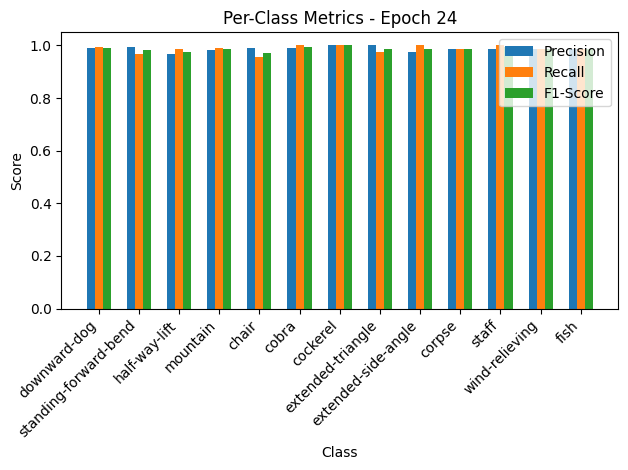

Validation: 100%|██████████| 21/21 [00:00<00:00, 27.41it/s, loss=0.315, accuracy=95.1]


Per-Class Metrics for Epoch 24:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.86, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.88, Recall=0.83, F1-Score=0.86
corpse: Precision=0.85, Recall=0.94, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.82, F1-Score=0.88


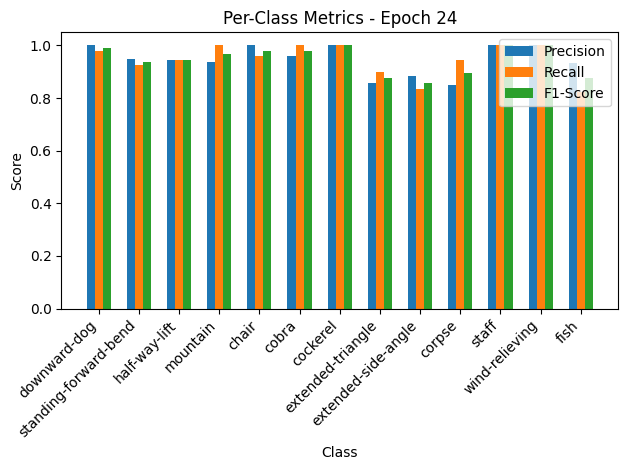


Epoch 25/50 Summary:
Train Loss: 0.0349 | Train Acc: 98.63% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.3233 | Val Acc: 95.11% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 26/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:09<00:00,  8.59it/s, loss=0.0417, accuracy=98.5]


Per-Class Metrics for Epoch 25:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=0.98, Recall=0.96, F1-Score=0.97
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.96, Recall=0.99, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.99, Recall=0.96, F1-Score=0.97


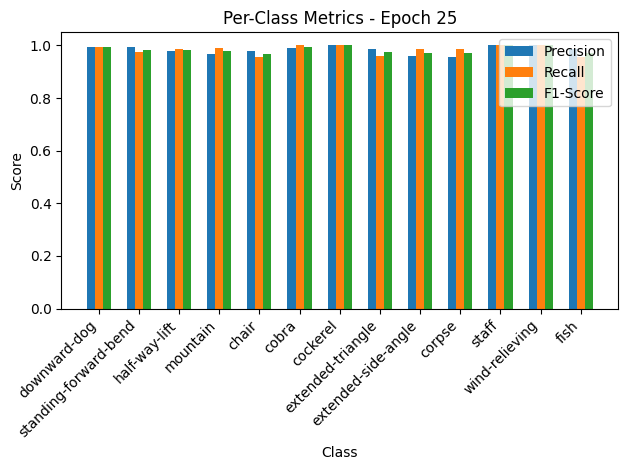

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.04it/s, loss=0.319, accuracy=95.1]


Per-Class Metrics for Epoch 25:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.86, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.88, Recall=0.83, F1-Score=0.86
corpse: Precision=0.85, Recall=0.94, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.82, F1-Score=0.88


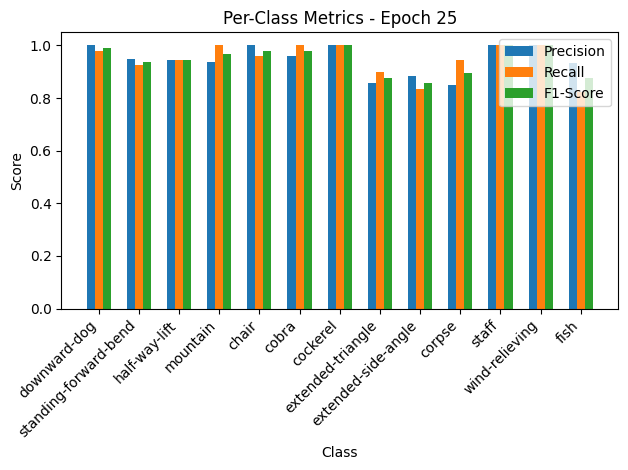


Epoch 26/50 Summary:
Train Loss: 0.0418 | Train Acc: 98.47% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.3275 | Val Acc: 95.11% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 27/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:12<00:00,  6.71it/s, loss=0.0324, accuracy=99.1]


Per-Class Metrics for Epoch 26:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.99, Recall=0.99, F1-Score=0.99
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=0.99, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.97, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=1.00, Recall=0.99, F1-Score=0.99


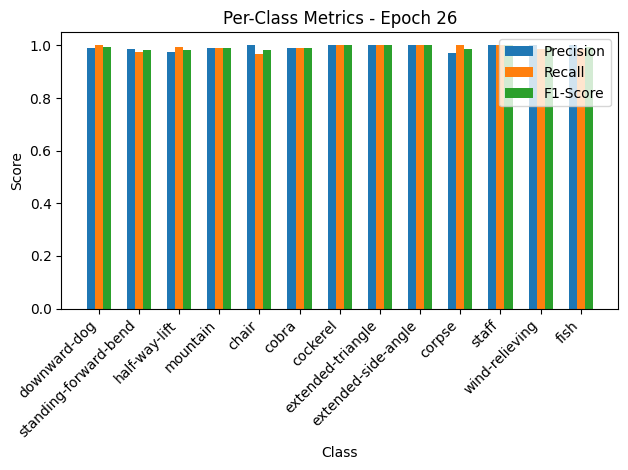

Validation: 100%|██████████| 21/21 [00:00<00:00, 28.22it/s, loss=0.309, accuracy=95.1]


Per-Class Metrics for Epoch 26:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.86, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.88, Recall=0.83, F1-Score=0.86
corpse: Precision=0.85, Recall=0.94, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.82, F1-Score=0.88


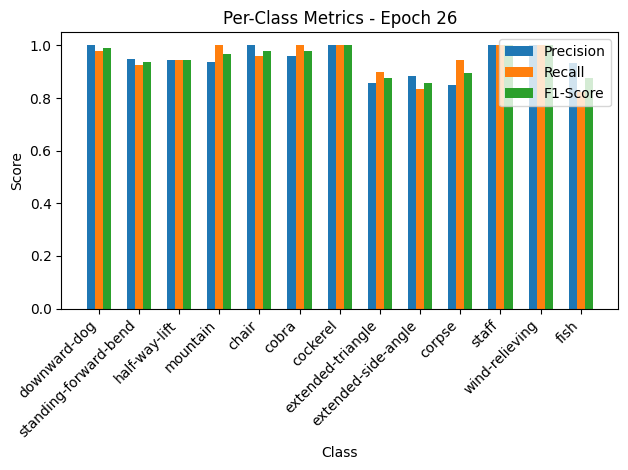


Epoch 27/50 Summary:
Train Loss: 0.0325 | Train Acc: 99.08% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.3174 | Val Acc: 95.11% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 28/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:08<00:00,  9.23it/s, loss=0.0361, accuracy=98.8]


Per-Class Metrics for Epoch 27:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=0.98, F1-Score=0.98
mountain: Precision=0.99, Recall=0.99, F1-Score=0.99
chair: Precision=0.99, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.99, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.99, Recall=0.96, F1-Score=0.97


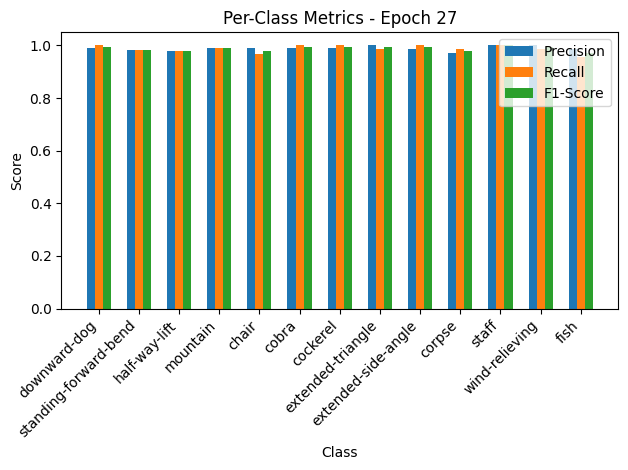

Validation: 100%|██████████| 21/21 [00:00<00:00, 28.41it/s, loss=0.308, accuracy=95.1]


Per-Class Metrics for Epoch 27:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.86, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.88, Recall=0.83, F1-Score=0.86
corpse: Precision=0.85, Recall=0.94, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.82, F1-Score=0.88


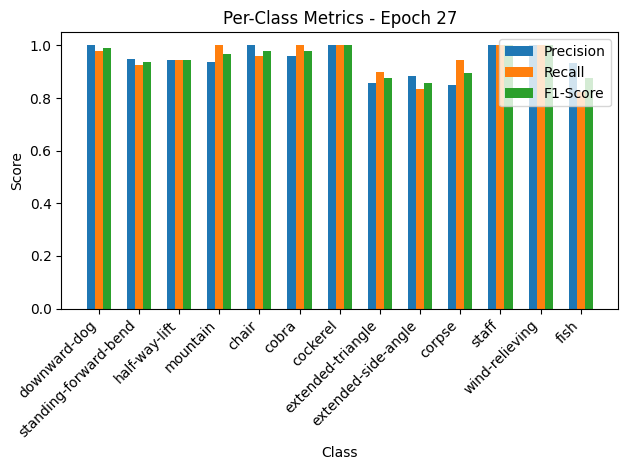


Epoch 28/50 Summary:
Train Loss: 0.0361 | Train Acc: 98.78% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.3164 | Val Acc: 95.11% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 29/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:09<00:00,  8.85it/s, loss=0.0454, accuracy=98.8]


Per-Class Metrics for Epoch 28:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=0.99, Recall=0.98, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.94, Recall=0.99, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.94, F1-Score=0.96


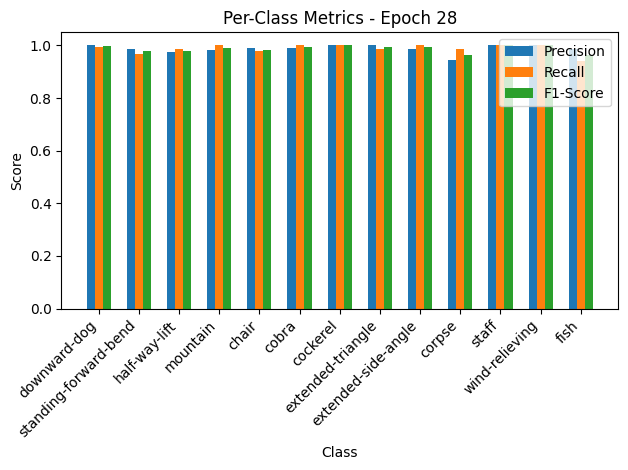

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.36it/s, loss=0.301, accuracy=95.4]


Per-Class Metrics for Epoch 28:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.86, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.88, Recall=0.83, F1-Score=0.86
corpse: Precision=0.89, Recall=0.94, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.88, F1-Score=0.91


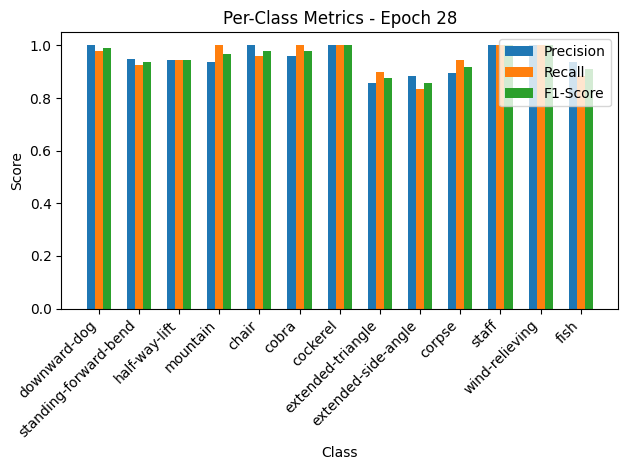


Epoch 29/50 Summary:
Train Loss: 0.0454 | Train Acc: 98.78% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.3094 | Val Acc: 95.41% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 30/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:09<00:00,  8.37it/s, loss=0.0405, accuracy=98.5]


Per-Class Metrics for Epoch 29:
downward-dog: Precision=0.98, Recall=1.00, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.98, F1-Score=0.97
mountain: Precision=0.99, Recall=0.99, F1-Score=0.99
chair: Precision=0.99, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=0.99, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.94, Recall=0.97, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.97, Recall=0.96, F1-Score=0.96


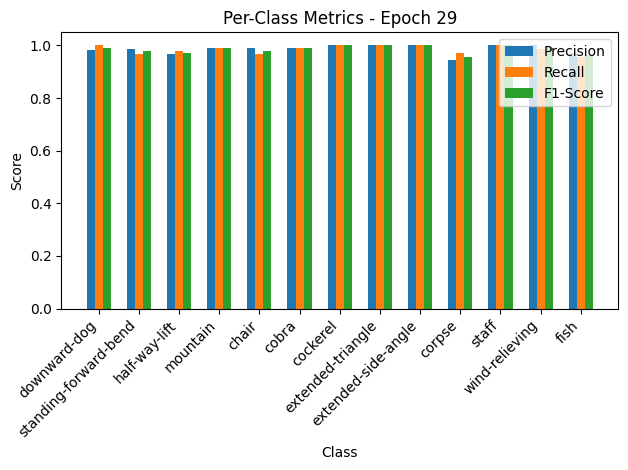

Validation: 100%|██████████| 21/21 [00:00<00:00, 27.90it/s, loss=0.309, accuracy=95.4]


Per-Class Metrics for Epoch 29:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.86, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.88, Recall=0.83, F1-Score=0.86
corpse: Precision=0.89, Recall=0.94, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.88, F1-Score=0.91


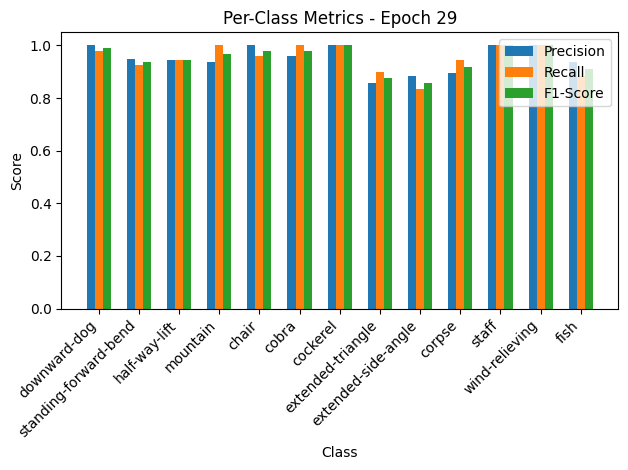


Epoch 30/50 Summary:
Train Loss: 0.0406 | Train Acc: 98.55% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.3178 | Val Acc: 95.41% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 31/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:09<00:00,  9.00it/s, loss=0.0416, accuracy=98.7]


Per-Class Metrics for Epoch 30:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.98, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.98
mountain: Precision=0.98, Recall=0.99, F1-Score=0.99
chair: Precision=0.99, Recall=0.96, F1-Score=0.97
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.97, Recall=0.94, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.97, F1-Score=0.96


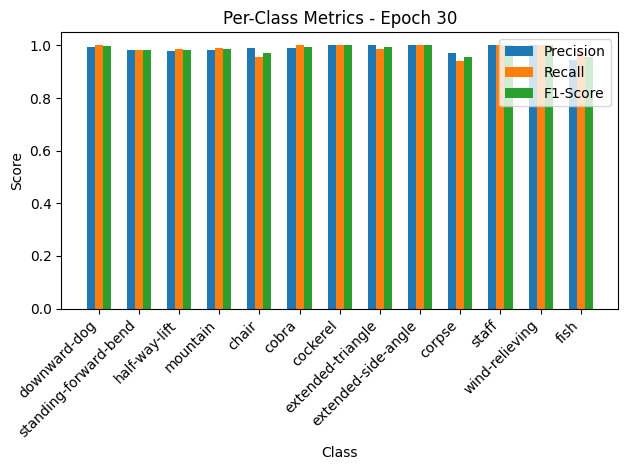

Validation: 100%|██████████| 21/21 [00:00<00:00, 22.63it/s, loss=0.298, accuracy=95.4]


Per-Class Metrics for Epoch 30:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.86, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.88, Recall=0.83, F1-Score=0.86
corpse: Precision=0.89, Recall=0.94, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.88, F1-Score=0.91


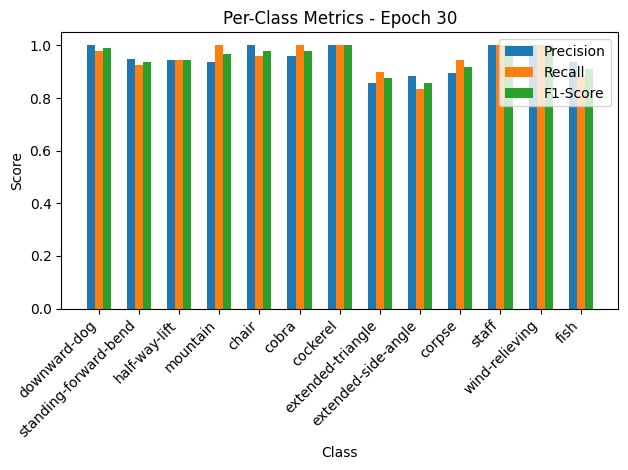


Epoch 31/50 Summary:
Train Loss: 0.0416 | Train Acc: 98.70% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.3063 | Val Acc: 95.41% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 32/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:09<00:00,  8.67it/s, loss=0.0475, accuracy=98.8]


Per-Class Metrics for Epoch 31:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.99
mountain: Precision=0.99, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.92, Recall=0.97, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.91, F1-Score=0.94


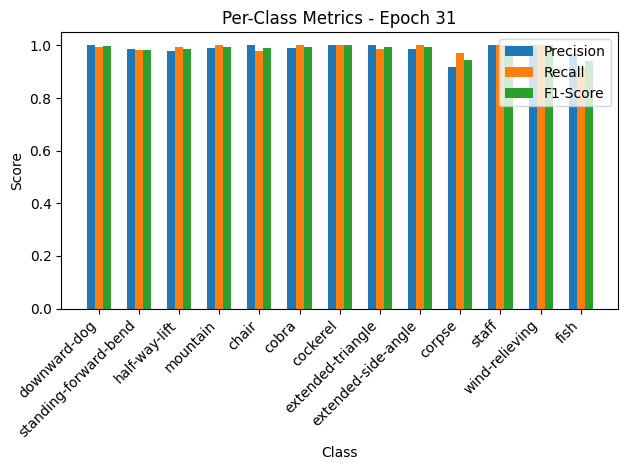

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.83it/s, loss=0.317, accuracy=95.4]


Per-Class Metrics for Epoch 31:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.86, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.88, Recall=0.83, F1-Score=0.86
corpse: Precision=0.89, Recall=0.94, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.88, F1-Score=0.91


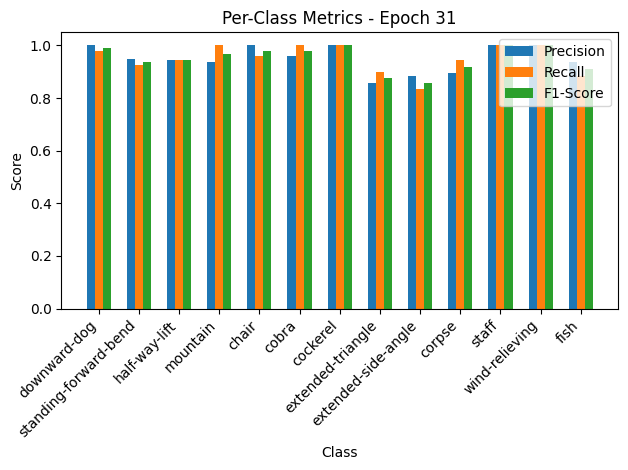


Epoch 32/50 Summary:
Train Loss: 0.0475 | Train Acc: 98.78% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.3254 | Val Acc: 95.41% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 33/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:10<00:00,  8.14it/s, loss=0.0453, accuracy=98.8]


Per-Class Metrics for Epoch 32:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.98
mountain: Precision=0.98, Recall=0.99, F1-Score=0.99
chair: Precision=0.99, Recall=0.98, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=0.97, Recall=0.96, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.96, Recall=0.97, F1-Score=0.96


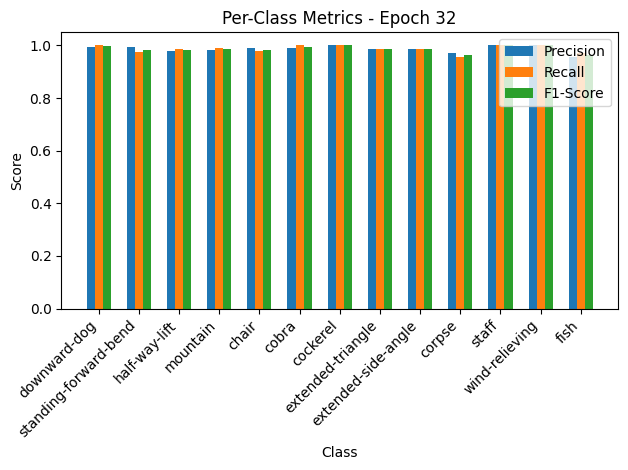

Validation: 100%|██████████| 21/21 [00:00<00:00, 28.84it/s, loss=0.319, accuracy=95.4]


Per-Class Metrics for Epoch 32:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.86, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.88, Recall=0.83, F1-Score=0.86
corpse: Precision=0.89, Recall=0.94, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.88, F1-Score=0.91


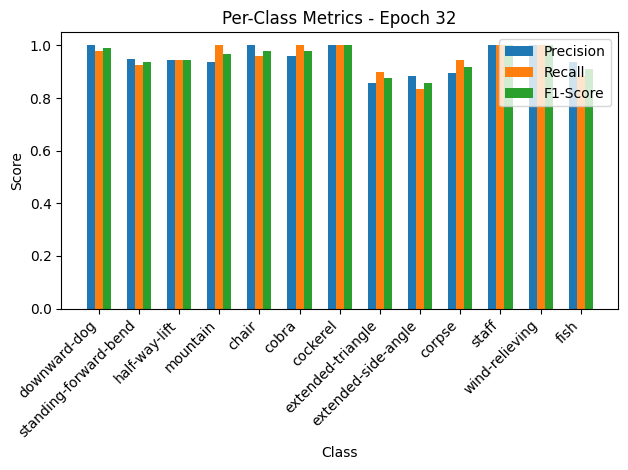


Epoch 33/50 Summary:
Train Loss: 0.0454 | Train Acc: 98.78% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.3282 | Val Acc: 95.41% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 34/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:09<00:00,  8.54it/s, loss=0.0439, accuracy=98.2]


Per-Class Metrics for Epoch 33:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.97, F1-Score=0.97
mountain: Precision=0.98, Recall=0.99, F1-Score=0.99
chair: Precision=0.97, Recall=0.97, F1-Score=0.97
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.97, F1-Score=0.98
corpse: Precision=0.96, Recall=0.97, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.96, F1-Score=0.96


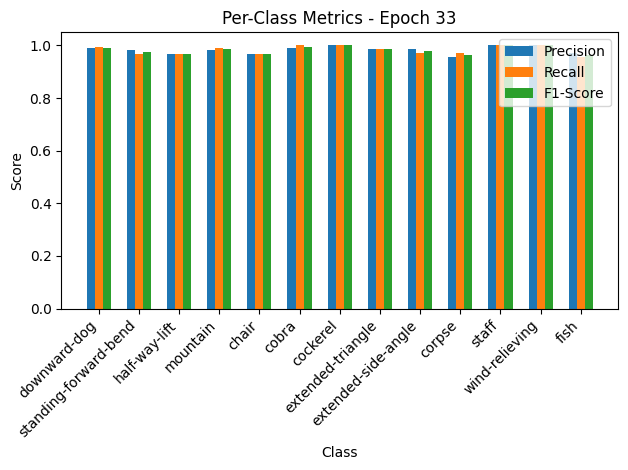

Validation: 100%|██████████| 21/21 [00:00<00:00, 21.52it/s, loss=0.307, accuracy=94.8]


Per-Class Metrics for Epoch 33:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.86, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.88, Recall=0.83, F1-Score=0.86
corpse: Precision=0.81, Recall=0.94, F1-Score=0.87
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.76, F1-Score=0.84


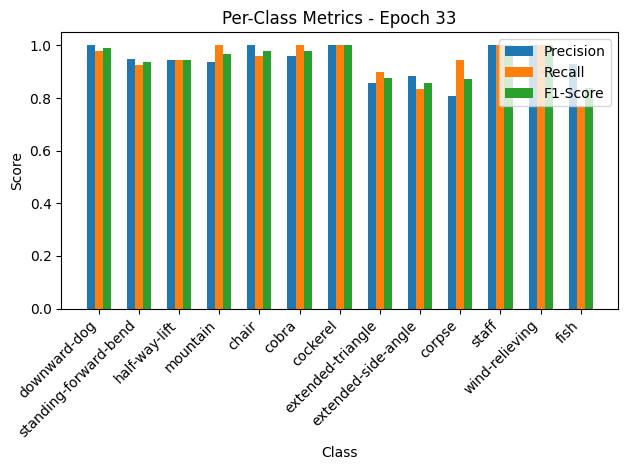


Epoch 34/50 Summary:
Train Loss: 0.0440 | Train Acc: 98.24% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.3159 | Val Acc: 94.80% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 35/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:08<00:00,  9.32it/s, loss=0.0311, accuracy=98.9]


Per-Class Metrics for Epoch 34:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.98, Recall=0.99, F1-Score=0.99
chair: Precision=0.98, Recall=0.97, F1-Score=0.97
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.99, Recall=0.97, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.99, F1-Score=0.98


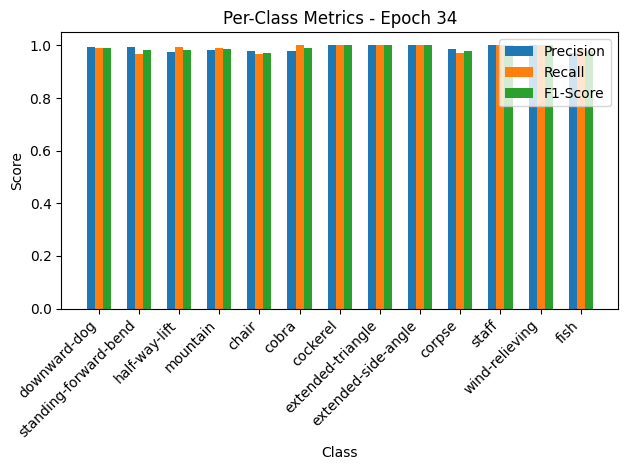

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.07it/s, loss=0.31, accuracy=95.1]


Per-Class Metrics for Epoch 34:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.86, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.88, Recall=0.83, F1-Score=0.86
corpse: Precision=0.85, Recall=0.94, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.82, F1-Score=0.88


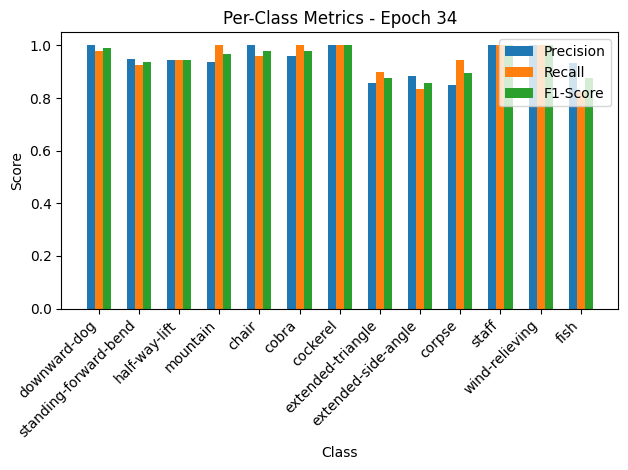


Epoch 35/50 Summary:
Train Loss: 0.0312 | Train Acc: 98.85% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.3189 | Val Acc: 95.11% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 36/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:09<00:00,  8.45it/s, loss=0.0297, accuracy=99]


Per-Class Metrics for Epoch 35:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.99, Recall=1.00, F1-Score=1.00
chair: Precision=0.99, Recall=0.99, F1-Score=0.99
cobra: Precision=0.99, Recall=0.98, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.99, Recall=0.97, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.99, F1-Score=0.98


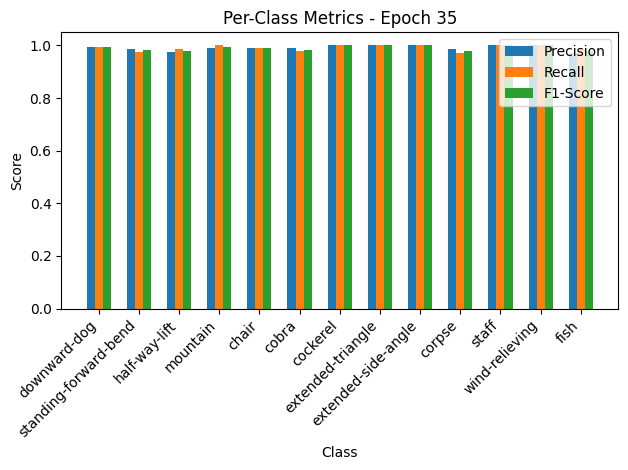

Validation: 100%|██████████| 21/21 [00:00<00:00, 27.48it/s, loss=0.318, accuracy=95.4]


Per-Class Metrics for Epoch 35:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.86, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.88, Recall=0.83, F1-Score=0.86
corpse: Precision=0.89, Recall=0.94, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.88, F1-Score=0.91


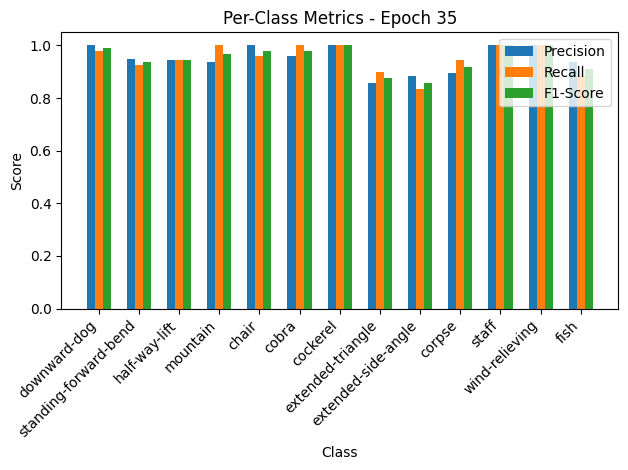


Epoch 36/50 Summary:
Train Loss: 0.0298 | Train Acc: 99.01% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.3264 | Val Acc: 95.41% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 37/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:09<00:00,  8.79it/s, loss=0.0432, accuracy=98.5]


Per-Class Metrics for Epoch 36:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.98, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=0.97, F1-Score=0.97
mountain: Precision=0.98, Recall=0.99, F1-Score=0.99
chair: Precision=0.99, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.97, Recall=0.96, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.96, Recall=0.97, F1-Score=0.96


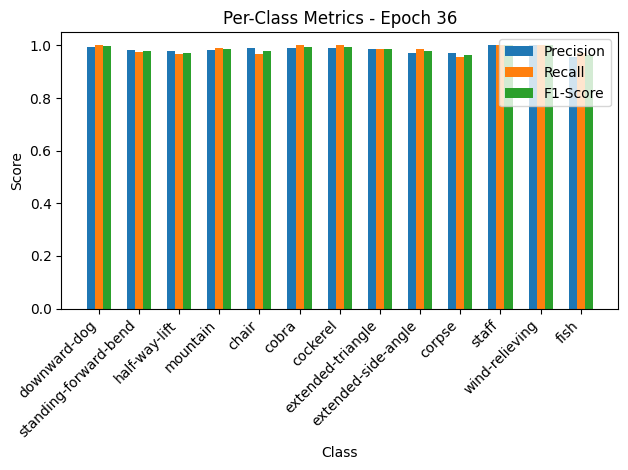

Validation: 100%|██████████| 21/21 [00:00<00:00, 25.14it/s, loss=0.303, accuracy=95.1]


Per-Class Metrics for Epoch 36:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.86, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.88, Recall=0.83, F1-Score=0.86
corpse: Precision=0.85, Recall=0.94, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.82, F1-Score=0.88


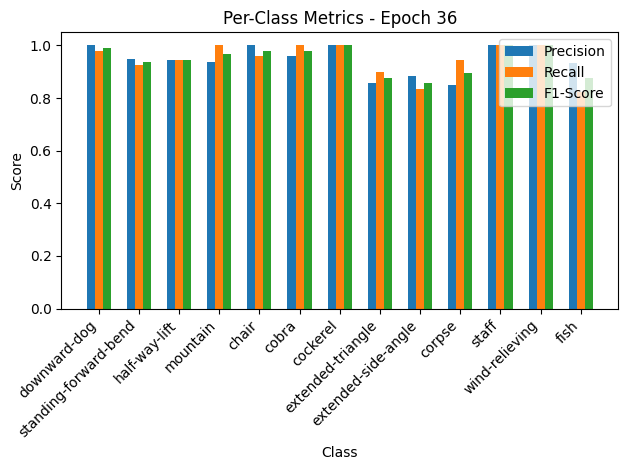


Epoch 37/50 Summary:
Train Loss: 0.0432 | Train Acc: 98.47% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.3114 | Val Acc: 95.11% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 38/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:08<00:00,  9.14it/s, loss=0.0363, accuracy=98.7]


Per-Class Metrics for Epoch 37:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.98, F1-Score=0.98
mountain: Precision=0.99, Recall=1.00, F1-Score=1.00
chair: Precision=0.99, Recall=0.98, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.93, Recall=0.97, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.93, F1-Score=0.95


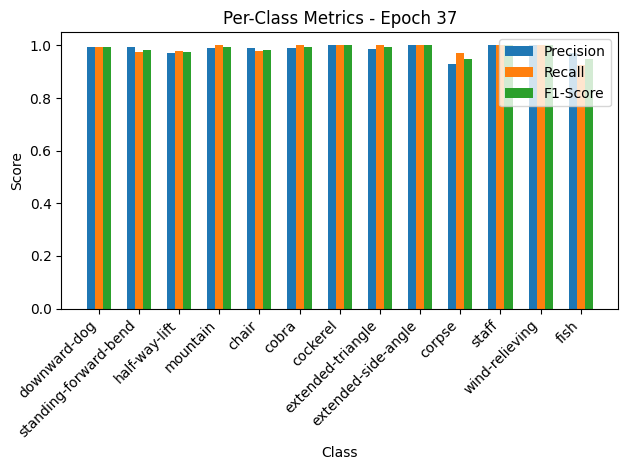

Validation: 100%|██████████| 21/21 [00:00<00:00, 30.86it/s, loss=0.296, accuracy=95.4]


Per-Class Metrics for Epoch 37:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.86, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.88, Recall=0.83, F1-Score=0.86
corpse: Precision=0.89, Recall=0.94, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.88, F1-Score=0.91


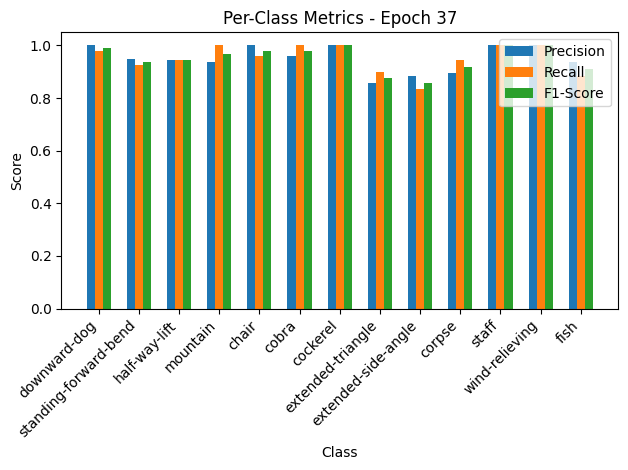


Epoch 38/50 Summary:
Train Loss: 0.0364 | Train Acc: 98.70% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.3044 | Val Acc: 95.41% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 39/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:10<00:00,  7.74it/s, loss=0.0452, accuracy=98.5]


Per-Class Metrics for Epoch 38:
downward-dog: Precision=0.98, Recall=1.00, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.98, F1-Score=0.98
mountain: Precision=0.98, Recall=0.99, F1-Score=0.99
chair: Precision=0.99, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=0.99, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.93, Recall=0.97, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.93, F1-Score=0.95


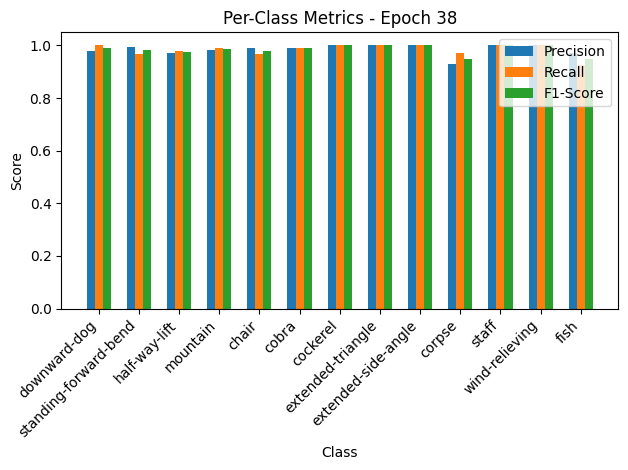

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.92it/s, loss=0.298, accuracy=95.4]


Per-Class Metrics for Epoch 38:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.86, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.88, Recall=0.83, F1-Score=0.86
corpse: Precision=0.89, Recall=0.94, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.88, F1-Score=0.91


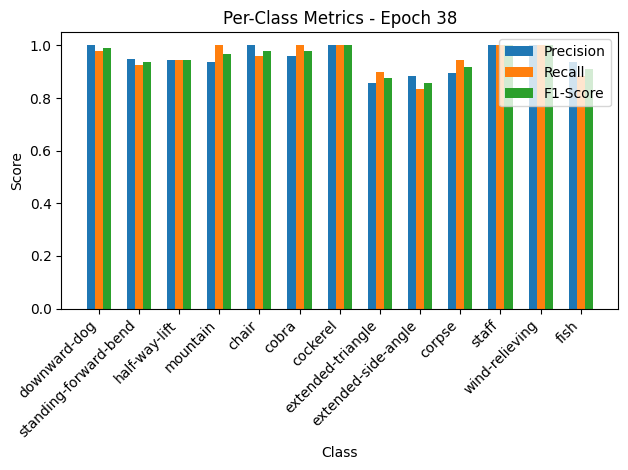


Epoch 39/50 Summary:
Train Loss: 0.0453 | Train Acc: 98.47% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.3062 | Val Acc: 95.41% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 40/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:09<00:00,  8.97it/s, loss=0.0593, accuracy=98.6]


Per-Class Metrics for Epoch 39:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.98
mountain: Precision=0.99, Recall=0.98, F1-Score=0.99
chair: Precision=0.98, Recall=0.97, F1-Score=0.97
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.96, Recall=0.94, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.96, F1-Score=0.95


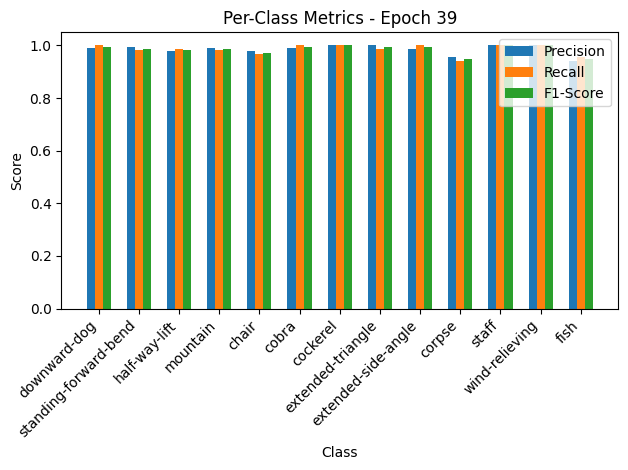

Validation: 100%|██████████| 21/21 [00:00<00:00, 24.67it/s, loss=0.298, accuracy=95.1]


Per-Class Metrics for Epoch 39:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.86, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.88, Recall=0.83, F1-Score=0.86
corpse: Precision=0.85, Recall=0.94, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.82, F1-Score=0.88


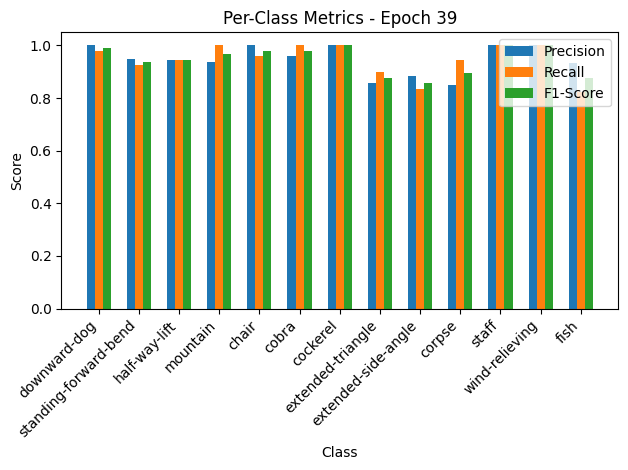


Epoch 40/50 Summary:
Train Loss: 0.0594 | Train Acc: 98.63% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.3064 | Val Acc: 95.11% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 41/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:09<00:00,  9.06it/s, loss=0.0366, accuracy=98.7]


Per-Class Metrics for Epoch 40:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.99
mountain: Precision=0.98, Recall=0.99, F1-Score=0.99
chair: Precision=0.99, Recall=0.99, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-side-angle: Precision=1.00, Recall=0.97, F1-Score=0.99
corpse: Precision=0.96, Recall=0.94, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.93, Recall=0.96, F1-Score=0.94


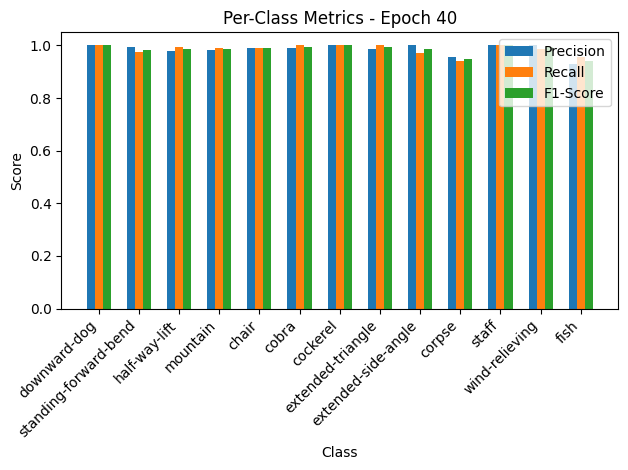

Validation: 100%|██████████| 21/21 [00:00<00:00, 27.45it/s, loss=0.332, accuracy=95.1]


Per-Class Metrics for Epoch 40:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.86, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.88, Recall=0.83, F1-Score=0.86
corpse: Precision=0.85, Recall=0.94, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.82, F1-Score=0.88


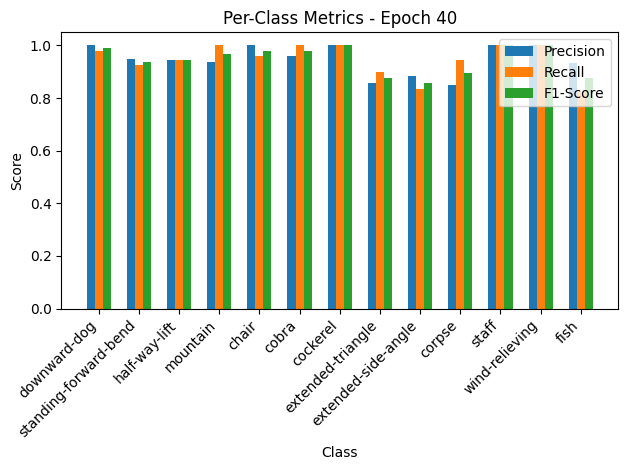


Epoch 41/50 Summary:
Train Loss: 0.0367 | Train Acc: 98.70% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.3408 | Val Acc: 95.11% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 42/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:11<00:00,  7.42it/s, loss=0.0389, accuracy=98.7]


Per-Class Metrics for Epoch 41:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.98, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=0.98, F1-Score=0.98
mountain: Precision=0.98, Recall=0.99, F1-Score=0.99
chair: Precision=0.99, Recall=0.98, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.96, Recall=0.94, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.96, F1-Score=0.95


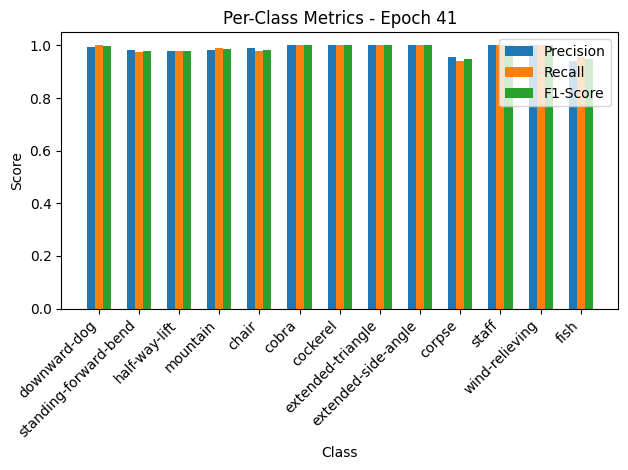

Validation: 100%|██████████| 21/21 [00:00<00:00, 30.39it/s, loss=0.31, accuracy=95.1]


Per-Class Metrics for Epoch 41:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.86, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.88, Recall=0.83, F1-Score=0.86
corpse: Precision=0.85, Recall=0.94, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.82, F1-Score=0.88


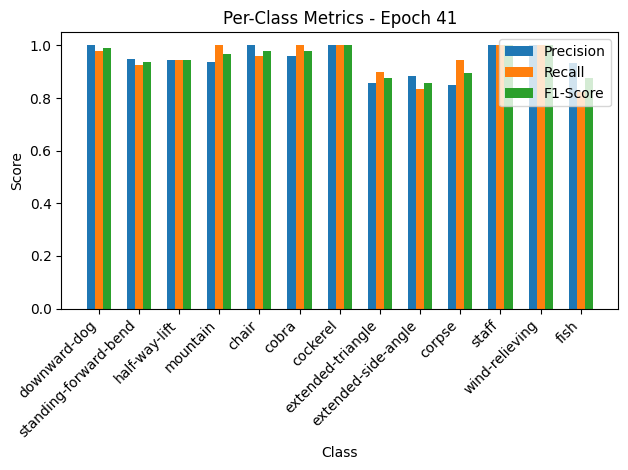


Epoch 42/50 Summary:
Train Loss: 0.0390 | Train Acc: 98.70% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.3183 | Val Acc: 95.11% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 43/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:08<00:00,  9.69it/s, loss=0.0379, accuracy=98.8]


Per-Class Metrics for Epoch 42:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.98, Recall=0.99, F1-Score=0.99
chair: Precision=0.98, Recall=0.98, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.99, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.99, Recall=0.97, F1-Score=0.98


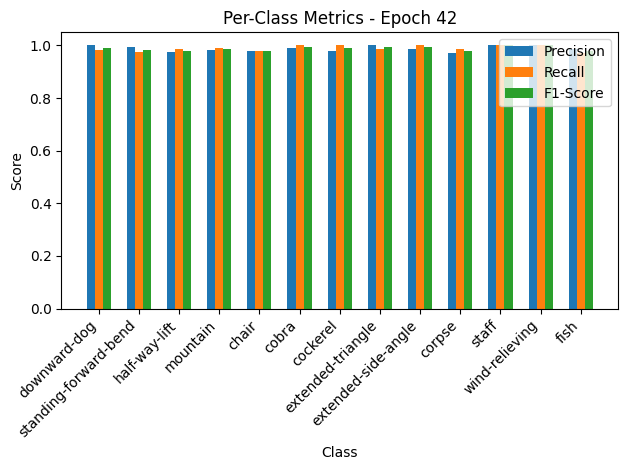

Validation: 100%|██████████| 21/21 [00:00<00:00, 28.04it/s, loss=0.304, accuracy=95.4]


Per-Class Metrics for Epoch 42:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.86, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.88, Recall=0.83, F1-Score=0.86
corpse: Precision=0.89, Recall=0.94, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.88, F1-Score=0.91


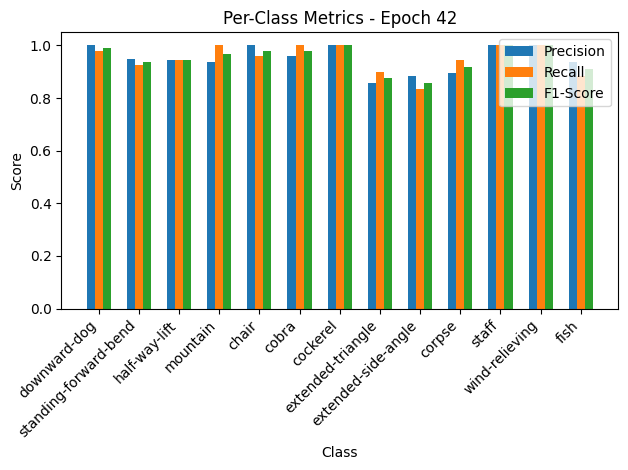


Epoch 43/50 Summary:
Train Loss: 0.0379 | Train Acc: 98.78% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.3124 | Val Acc: 95.41% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 44/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:09<00:00,  8.49it/s, loss=0.0398, accuracy=98.8]


Per-Class Metrics for Epoch 43:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=0.99
standing-forward-bend: Precision=1.00, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.94, Recall=0.94, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.94, F1-Score=0.94


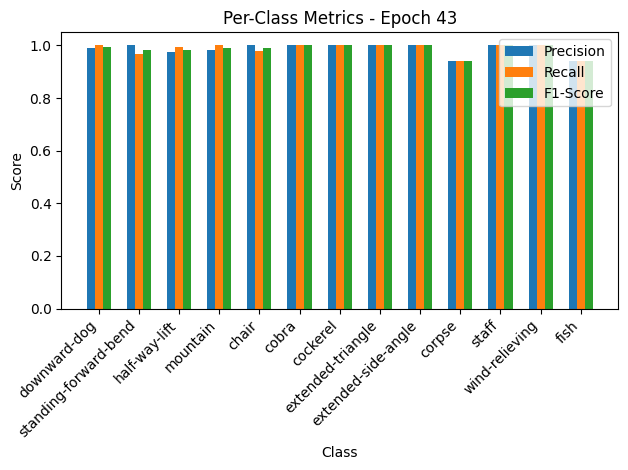

Validation: 100%|██████████| 21/21 [00:00<00:00, 28.95it/s, loss=0.316, accuracy=95.1]


Per-Class Metrics for Epoch 43:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.86, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.88, Recall=0.83, F1-Score=0.86
corpse: Precision=0.85, Recall=0.94, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.82, F1-Score=0.88


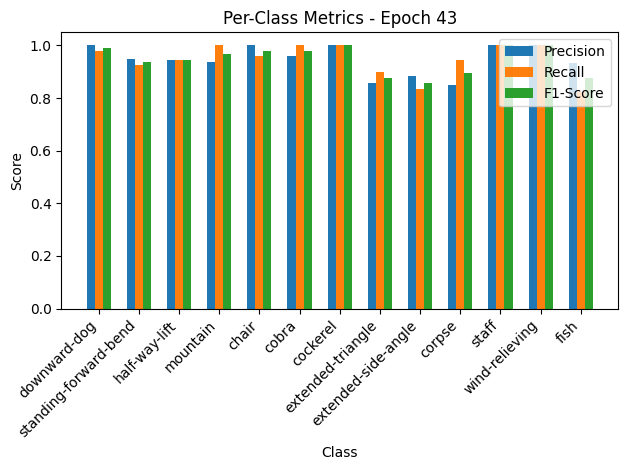


Epoch 44/50 Summary:
Train Loss: 0.0398 | Train Acc: 98.78% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.3242 | Val Acc: 95.11% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 45/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:09<00:00,  8.81it/s, loss=0.0389, accuracy=98.6]


Per-Class Metrics for Epoch 44:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.98, F1-Score=0.98
mountain: Precision=0.99, Recall=0.99, F1-Score=0.99
chair: Precision=0.99, Recall=0.99, F1-Score=0.99
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-side-angle: Precision=1.00, Recall=0.99, F1-Score=0.99
corpse: Precision=0.93, Recall=0.97, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.93, F1-Score=0.95


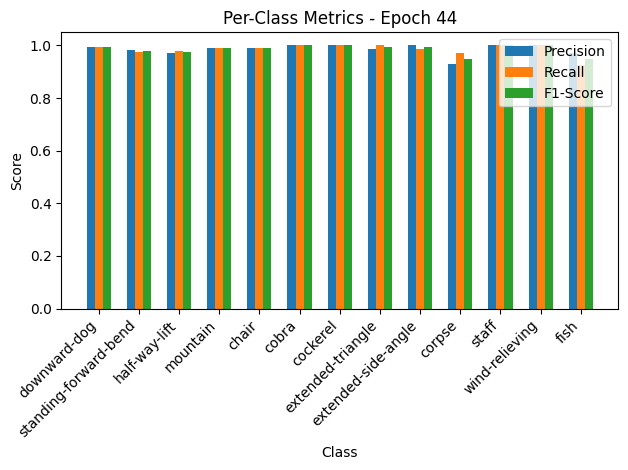

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.45it/s, loss=0.299, accuracy=95.4]


Per-Class Metrics for Epoch 44:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.86, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.88, Recall=0.83, F1-Score=0.86
corpse: Precision=0.89, Recall=0.94, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.88, F1-Score=0.91


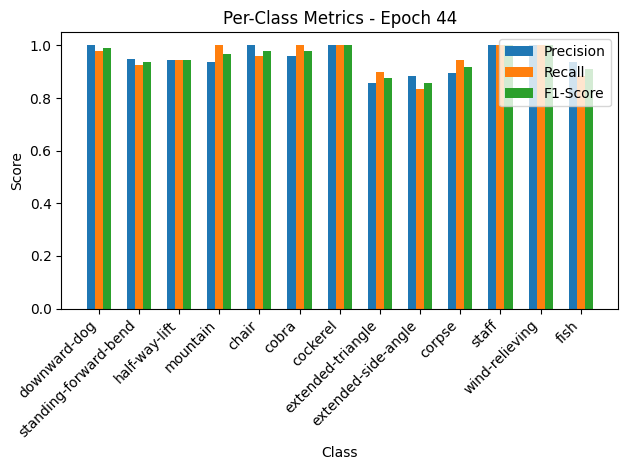


Epoch 45/50 Summary:
Train Loss: 0.0389 | Train Acc: 98.63% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.3076 | Val Acc: 95.41% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 46/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:08<00:00,  9.52it/s, loss=0.0386, accuracy=98.8]


Per-Class Metrics for Epoch 45:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.98, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.98
mountain: Precision=0.99, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.96, Recall=0.96, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.96, Recall=0.96, F1-Score=0.96


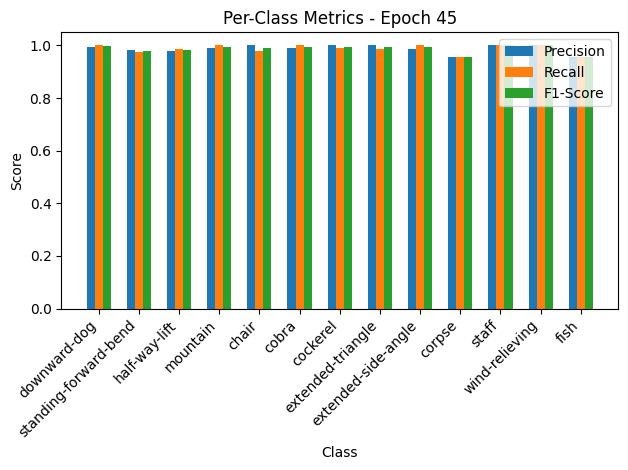

Validation: 100%|██████████| 21/21 [00:00<00:00, 28.93it/s, loss=0.328, accuracy=95.1]


Per-Class Metrics for Epoch 45:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.86, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.88, Recall=0.83, F1-Score=0.86
corpse: Precision=0.85, Recall=0.94, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.82, F1-Score=0.88


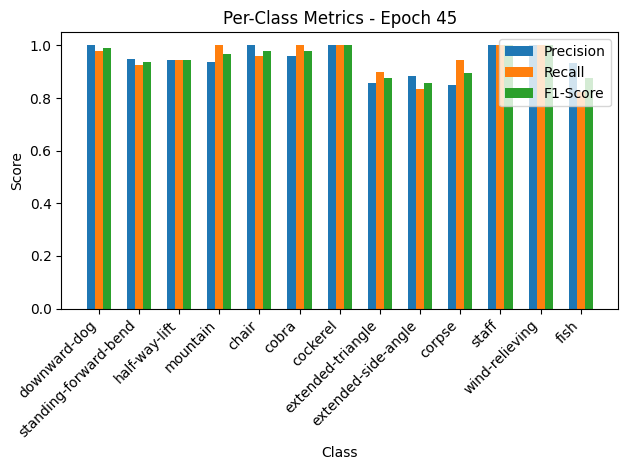


Epoch 46/50 Summary:
Train Loss: 0.0387 | Train Acc: 98.78% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.3369 | Val Acc: 95.11% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 47/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:09<00:00,  8.63it/s, loss=0.0343, accuracy=98.6]


Per-Class Metrics for Epoch 46:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.97, F1-Score=0.97
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=0.98, Recall=0.98, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.93, Recall=0.96, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.96, Recall=0.93, F1-Score=0.94


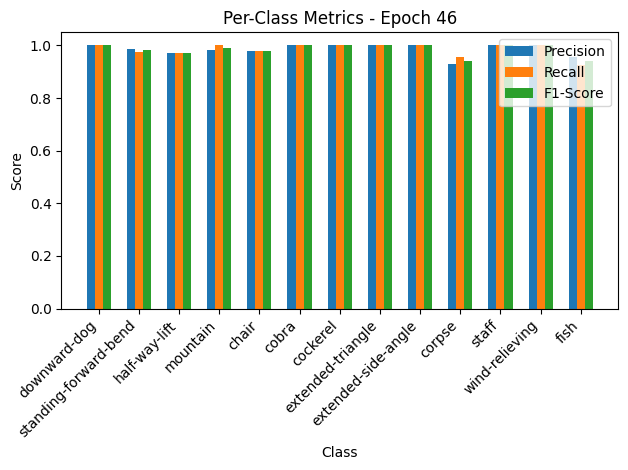

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.29it/s, loss=0.314, accuracy=95.4]


Per-Class Metrics for Epoch 46:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.86, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.88, Recall=0.83, F1-Score=0.86
corpse: Precision=0.89, Recall=0.94, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.88, F1-Score=0.91


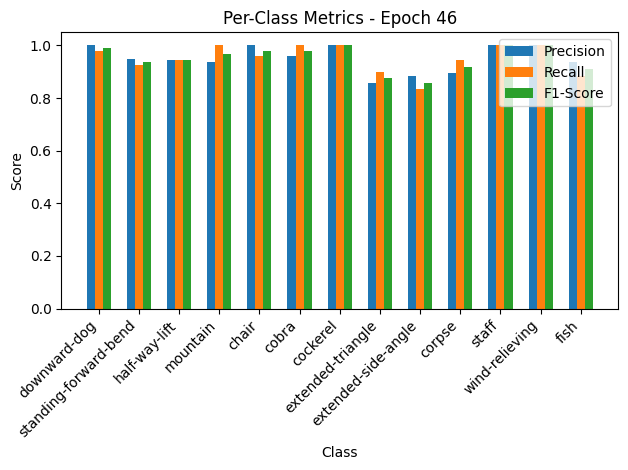


Epoch 47/50 Summary:
Train Loss: 0.0344 | Train Acc: 98.63% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.3226 | Val Acc: 95.41% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 48/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:09<00:00,  8.68it/s, loss=0.0421, accuracy=98.5]


Per-Class Metrics for Epoch 47:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.98, F1-Score=0.98
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=0.99, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.97, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.97, Recall=0.97, F1-Score=0.97


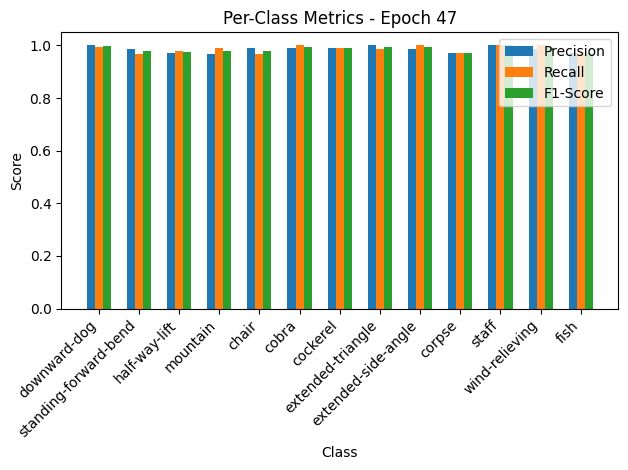

Validation: 100%|██████████| 21/21 [00:00<00:00, 28.70it/s, loss=0.304, accuracy=95.1]


Per-Class Metrics for Epoch 47:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.86, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.88, Recall=0.83, F1-Score=0.86
corpse: Precision=0.85, Recall=0.94, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.82, F1-Score=0.88


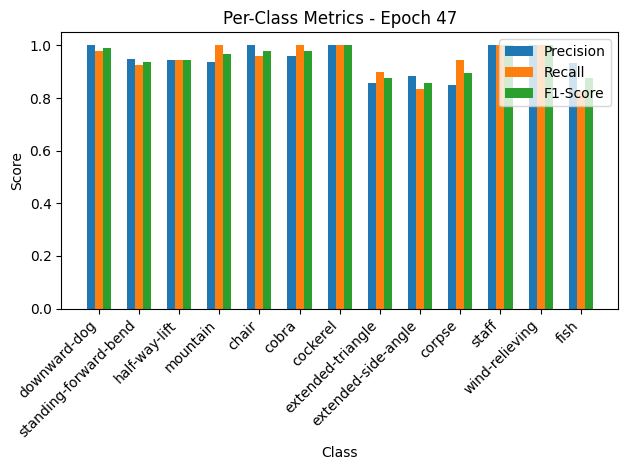


Epoch 48/50 Summary:
Train Loss: 0.0421 | Train Acc: 98.55% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.3125 | Val Acc: 95.11% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 49/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:08<00:00,  9.57it/s, loss=0.0481, accuracy=98.7]


Per-Class Metrics for Epoch 48:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.99, Recall=1.00, F1-Score=1.00
chair: Precision=0.99, Recall=0.98, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.92, Recall=0.97, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.97, F1-Score=0.99
fish: Precision=0.97, Recall=0.94, F1-Score=0.96


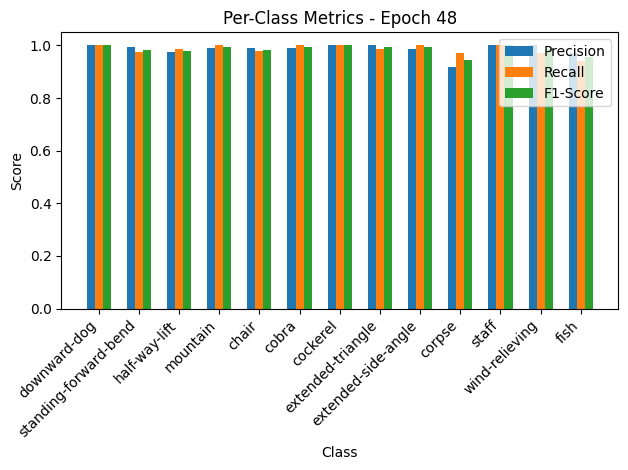

Validation: 100%|██████████| 21/21 [00:00<00:00, 22.66it/s, loss=0.288, accuracy=95.1]


Per-Class Metrics for Epoch 48:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.86, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.88, Recall=0.83, F1-Score=0.86
corpse: Precision=0.85, Recall=0.94, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.82, F1-Score=0.88


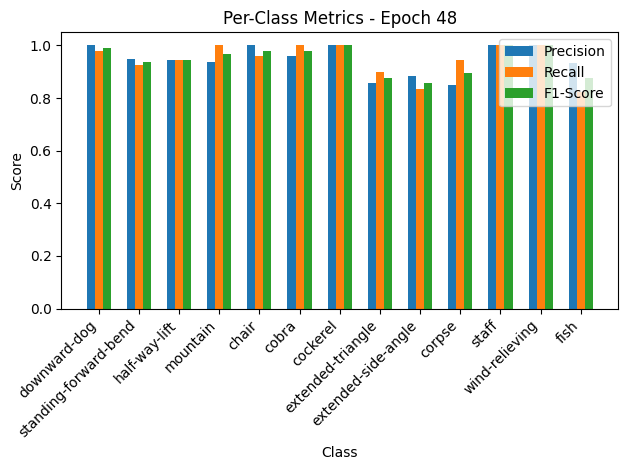


Epoch 49/50 Summary:
Train Loss: 0.0481 | Train Acc: 98.70% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2963 | Val Acc: 95.11% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 50/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:10<00:00,  8.11it/s, loss=0.065, accuracy=98.2]


Per-Class Metrics for Epoch 49:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.98, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=0.97, Recall=0.95, F1-Score=0.96
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.96, Recall=0.96, F1-Score=0.96
staff: Precision=1.00, Recall=0.98, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.96, Recall=0.96, F1-Score=0.96


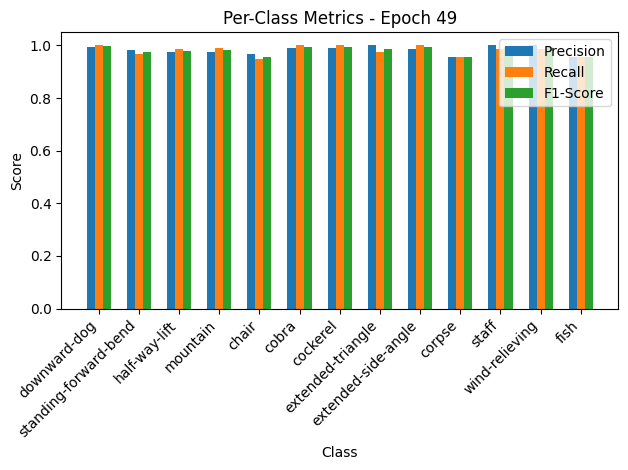

Validation: 100%|██████████| 21/21 [00:00<00:00, 28.61it/s, loss=0.321, accuracy=95.4]


Per-Class Metrics for Epoch 49:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.86, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.88, Recall=0.83, F1-Score=0.86
corpse: Precision=0.89, Recall=0.94, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.88, F1-Score=0.91


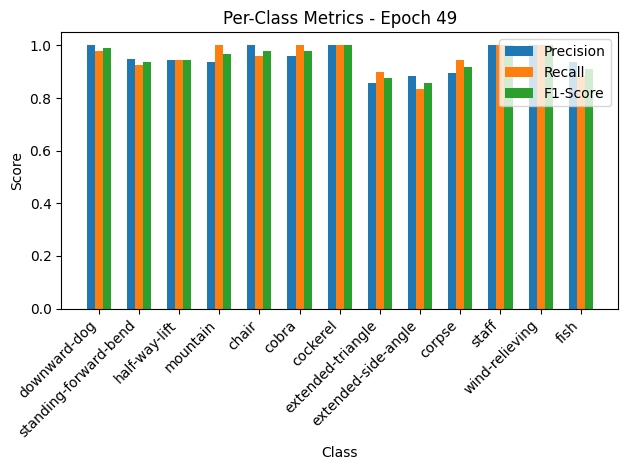


Epoch 50/50 Summary:
Train Loss: 0.0651 | Train Acc: 98.24% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.3299 | Val Acc: 95.41% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95


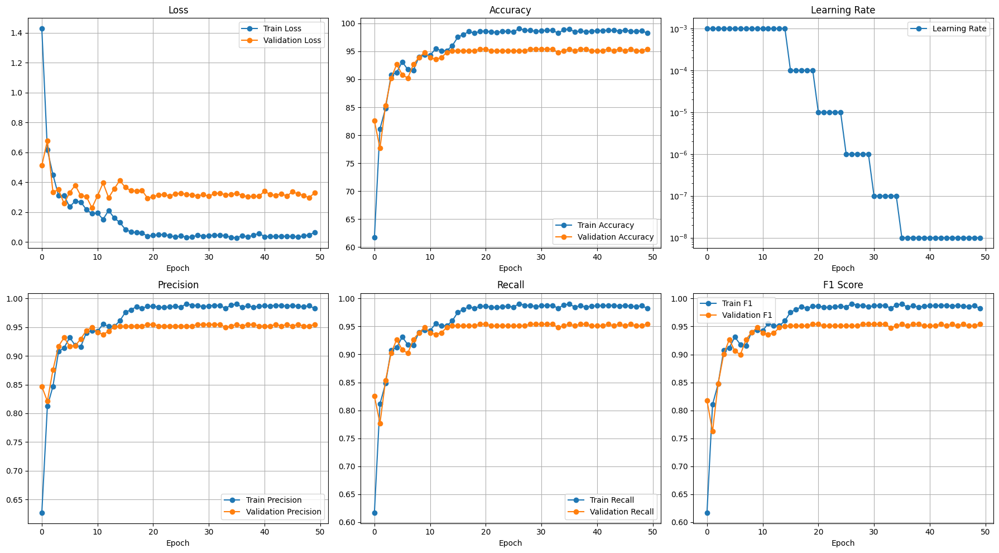

Fold 4/5

Class Distribution Analysis:
--------------------------------------------------
Class 0: 245 samples (13.48%)
Class 1: 225 samples (12.38%)
Class 2: 209 samples (11.50%)
Class 3: 165 samples (9.08%)
Class 4: 140 samples (7.70%)
Class 5: 129 samples (7.10%)
Class 6: 120 samples (6.60%)
Class 7: 108 samples (5.94%)
Class 8: 101 samples (5.56%)
Class 9: 95 samples (5.23%)
Class 10: 94 samples (5.17%)
Class 11: 94 samples (5.17%)
Class 12: 93 samples (5.12%)

Imbalance Statistics:
Imbalance Ratio (max/min): 2.63
Maximum class size: 245
Minimum class size: 93
Average class size: 139.85
Class weights aligned with indices: tensor([0.5117, 0.5567, 0.5988, 0.7568, 0.8908, 0.9663, 1.0383, 1.1529, 1.2324,
        1.3099, 1.3237, 1.3237, 1.3379])
Using device: cuda

Epoch 1/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.70it/s, loss=1.39, accuracy=65]


Per-Class Metrics for Epoch 0:
downward-dog: Precision=0.80, Recall=0.68, F1-Score=0.74
standing-forward-bend: Precision=0.77, Recall=0.56, F1-Score=0.65
half-way-lift: Precision=0.73, Recall=0.79, F1-Score=0.76
mountain: Precision=0.69, Recall=0.77, F1-Score=0.72
chair: Precision=0.55, Recall=0.59, F1-Score=0.57
cobra: Precision=0.67, Recall=0.63, F1-Score=0.65
cockerel: Precision=0.70, Recall=0.70, F1-Score=0.70
extended-triangle: Precision=0.61, Recall=0.60, F1-Score=0.61
extended-side-angle: Precision=0.41, Recall=0.57, F1-Score=0.48
corpse: Precision=0.47, Recall=0.46, F1-Score=0.47
staff: Precision=0.59, Recall=0.77, F1-Score=0.67
wind-relieving: Precision=0.68, Recall=0.71, F1-Score=0.70
fish: Precision=0.50, Recall=0.48, F1-Score=0.49


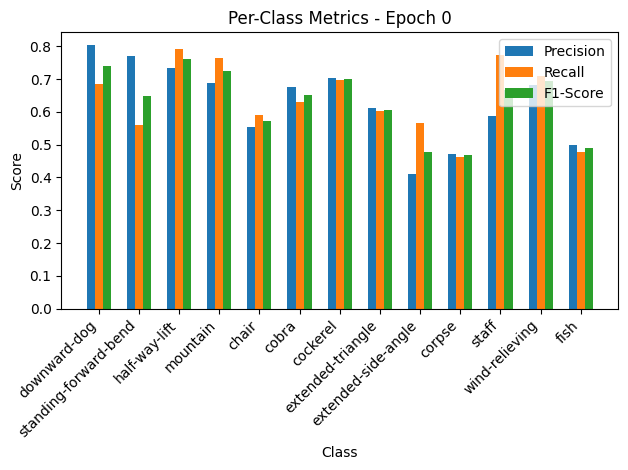

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.44it/s, loss=0.609, accuracy=80.1]


Per-Class Metrics for Epoch 0:
downward-dog: Precision=0.93, Recall=0.89, F1-Score=0.91
standing-forward-bend: Precision=0.96, Recall=0.54, F1-Score=0.69
half-way-lift: Precision=0.85, Recall=0.89, F1-Score=0.87
mountain: Precision=0.64, Recall=0.93, F1-Score=0.76
chair: Precision=1.00, Recall=0.78, F1-Score=0.88
cobra: Precision=0.74, Recall=1.00, F1-Score=0.85
cockerel: Precision=0.87, Recall=0.59, F1-Score=0.70
extended-triangle: Precision=0.82, Recall=0.90, F1-Score=0.86
extended-side-angle: Precision=0.89, Recall=0.89, F1-Score=0.89
corpse: Precision=1.00, Recall=0.11, F1-Score=0.20
staff: Precision=0.64, Recall=1.00, F1-Score=0.78
wind-relieving: Precision=0.85, Recall=1.00, F1-Score=0.92
fish: Precision=0.57, Recall=0.94, F1-Score=0.71


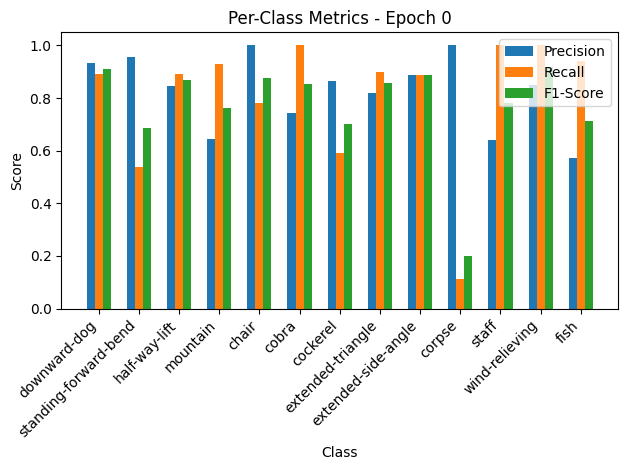


Epoch 1/50 Summary:
Train Loss: 1.3905 | Train Acc: 65.04% | Train Precision: 0.66 | Train Recall: 0.65 | Train F1: 0.65
Val Loss: 0.6257 | Val Acc: 80.12% | Val Precision: 0.84 | Val Recall: 0.80 | Val F1: 0.78
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model.pth
Checkpoint saved at epoch 1
New best model saved! Validation Loss: 0.6257

Epoch 2/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.75it/s, loss=0.567, accuracy=82.7]


Per-Class Metrics for Epoch 1:
downward-dog: Precision=0.95, Recall=0.92, F1-Score=0.93
standing-forward-bend: Precision=0.87, Recall=0.74, F1-Score=0.80
half-way-lift: Precision=0.84, Recall=0.93, F1-Score=0.88
mountain: Precision=0.84, Recall=0.84, F1-Score=0.84
chair: Precision=0.81, Recall=0.84, F1-Score=0.82
cobra: Precision=0.91, Recall=0.95, F1-Score=0.93
cockerel: Precision=0.90, Recall=0.90, F1-Score=0.90
extended-triangle: Precision=0.68, Recall=0.68, F1-Score=0.68
extended-side-angle: Precision=0.68, Recall=0.68, F1-Score=0.68
corpse: Precision=0.68, Recall=0.58, F1-Score=0.62
staff: Precision=0.77, Recall=0.92, F1-Score=0.84
wind-relieving: Precision=0.91, Recall=0.91, F1-Score=0.91
fish: Precision=0.64, Recall=0.68, F1-Score=0.66


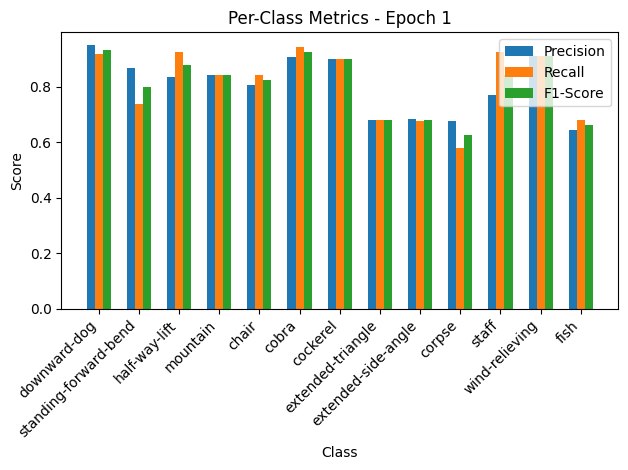

Validation: 100%|██████████| 21/21 [00:00<00:00, 22.84it/s, loss=0.394, accuracy=88.1]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 1:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=1.00, Recall=0.83, F1-Score=0.91
half-way-lift: Precision=0.82, Recall=0.97, F1-Score=0.89
mountain: Precision=1.00, Recall=0.79, F1-Score=0.88
chair: Precision=0.81, Recall=0.96, F1-Score=0.88
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.80, Recall=1.00, F1-Score=0.89
extended-side-angle: Precision=1.00, Recall=0.72, F1-Score=0.84
corpse: Precision=0.50, Recall=0.94, F1-Score=0.65
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.94, Recall=1.00, F1-Score=0.97
fish: Precision=0.00, Recall=0.00, F1-Score=0.00


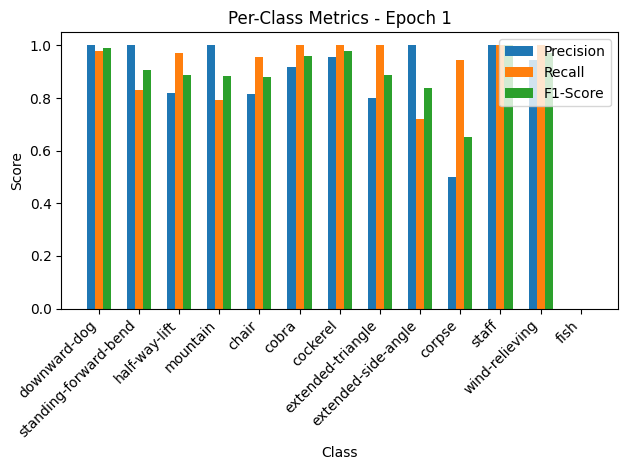


Epoch 2/50 Summary:
Train Loss: 0.5678 | Train Acc: 82.75% | Train Precision: 0.83 | Train Recall: 0.83 | Train F1: 0.83
Val Loss: 0.4046 | Val Acc: 88.07% | Val Precision: 0.86 | Val Recall: 0.88 | Val F1: 0.86
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model.pth
Checkpoint saved at epoch 2
New best model saved! Validation Loss: 0.4046

Epoch 3/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.96it/s, loss=0.395, accuracy=88.3]


Per-Class Metrics for Epoch 2:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=0.92, Recall=0.81, F1-Score=0.86
half-way-lift: Precision=0.86, Recall=0.94, F1-Score=0.90
mountain: Precision=0.86, Recall=0.88, F1-Score=0.87
chair: Precision=0.82, Recall=0.88, F1-Score=0.85
cobra: Precision=0.95, Recall=0.97, F1-Score=0.96
cockerel: Precision=0.89, Recall=0.96, F1-Score=0.92
extended-triangle: Precision=0.88, Recall=0.95, F1-Score=0.91
extended-side-angle: Precision=0.93, Recall=0.85, F1-Score=0.89
corpse: Precision=0.71, Recall=0.65, F1-Score=0.68
staff: Precision=0.94, Recall=0.94, F1-Score=0.94
wind-relieving: Precision=0.96, Recall=0.93, F1-Score=0.94
fish: Precision=0.72, Recall=0.78, F1-Score=0.75


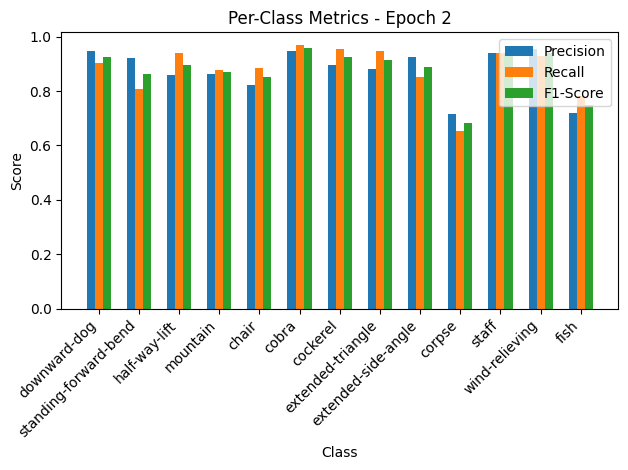

Validation: 100%|██████████| 21/21 [00:00<00:00, 28.42it/s, loss=0.364, accuracy=83.2]


Per-Class Metrics for Epoch 2:
downward-dog: Precision=0.67, Recall=1.00, F1-Score=0.80
standing-forward-bend: Precision=0.74, Recall=0.85, F1-Score=0.80
half-way-lift: Precision=0.89, Recall=0.22, F1-Score=0.35
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.91, Recall=0.91, F1-Score=0.91
cobra: Precision=1.00, Recall=0.87, F1-Score=0.93
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.86, Recall=0.95, F1-Score=0.90
extended-side-angle: Precision=0.94, Recall=0.83, F1-Score=0.88
corpse: Precision=0.79, Recall=0.61, F1-Score=0.69
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.94, Recall=1.00, F1-Score=0.97
fish: Precision=0.70, Recall=0.82, F1-Score=0.76


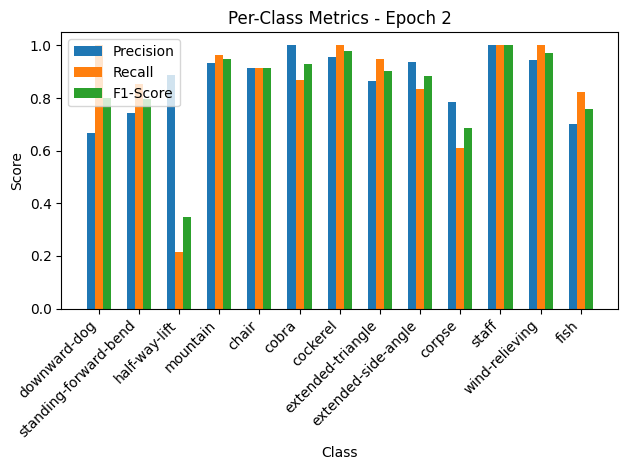


Epoch 3/50 Summary:
Train Loss: 0.3955 | Train Acc: 88.32% | Train Precision: 0.88 | Train Recall: 0.88 | Train F1: 0.88
Val Loss: 0.3739 | Val Acc: 83.18% | Val Precision: 0.85 | Val Recall: 0.83 | Val F1: 0.81
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model.pth
Checkpoint saved at epoch 3
New best model saved! Validation Loss: 0.3739

Epoch 4/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.88it/s, loss=0.332, accuracy=88.7]


Per-Class Metrics for Epoch 3:
downward-dog: Precision=0.96, Recall=0.95, F1-Score=0.95
standing-forward-bend: Precision=0.85, Recall=0.80, F1-Score=0.82
half-way-lift: Precision=0.88, Recall=0.87, F1-Score=0.88
mountain: Precision=0.87, Recall=0.95, F1-Score=0.91
chair: Precision=0.88, Recall=0.86, F1-Score=0.87
cobra: Precision=0.93, Recall=0.95, F1-Score=0.94
cockerel: Precision=0.98, Recall=0.98, F1-Score=0.98
extended-triangle: Precision=0.88, Recall=0.83, F1-Score=0.86
extended-side-angle: Precision=0.79, Recall=0.88, F1-Score=0.83
corpse: Precision=0.79, Recall=0.70, F1-Score=0.74
staff: Precision=0.95, Recall=0.95, F1-Score=0.95
wind-relieving: Precision=0.96, Recall=0.99, F1-Score=0.97
fish: Precision=0.74, Recall=0.81, F1-Score=0.77


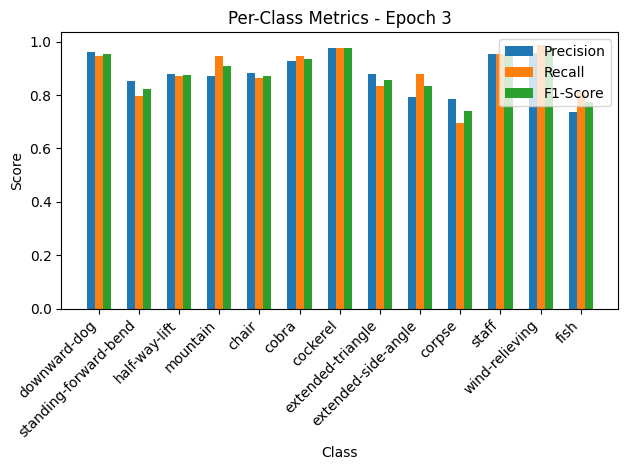

Validation: 100%|██████████| 21/21 [00:00<00:00, 28.77it/s, loss=0.444, accuracy=87.8]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 3:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.94, Recall=0.83, F1-Score=0.88
half-way-lift: Precision=0.81, Recall=0.92, F1-Score=0.86
mountain: Precision=1.00, Recall=0.86, F1-Score=0.93
chair: Precision=0.85, Recall=0.96, F1-Score=0.90
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=1.00, Recall=0.95, F1-Score=0.98
extended-triangle: Precision=0.83, Recall=1.00, F1-Score=0.91
extended-side-angle: Precision=1.00, Recall=0.78, F1-Score=0.88
corpse: Precision=0.50, Recall=0.89, F1-Score=0.64
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.85, Recall=1.00, F1-Score=0.92
fish: Precision=0.00, Recall=0.00, F1-Score=0.00


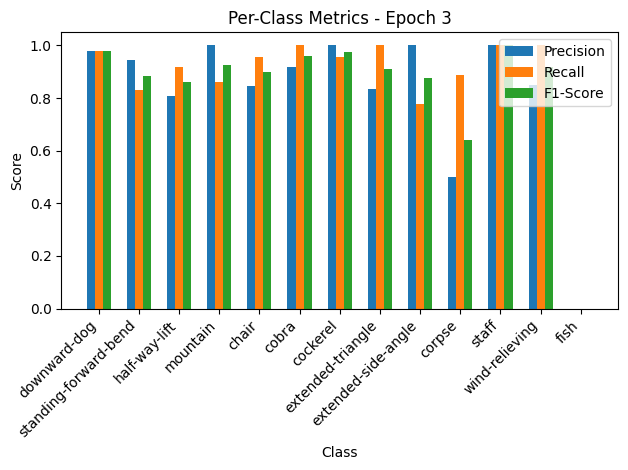


Epoch 4/50 Summary:
Train Loss: 0.3325 | Train Acc: 88.70% | Train Precision: 0.89 | Train Recall: 0.89 | Train F1: 0.89
Val Loss: 0.4563 | Val Acc: 87.77% | Val Precision: 0.85 | Val Recall: 0.88 | Val F1: 0.86

Epoch 5/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.75it/s, loss=0.336, accuracy=89.2]


Per-Class Metrics for Epoch 4:
downward-dog: Precision=0.97, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.87, Recall=0.85, F1-Score=0.86
half-way-lift: Precision=0.88, Recall=0.89, F1-Score=0.88
mountain: Precision=0.93, Recall=0.93, F1-Score=0.93
chair: Precision=0.91, Recall=0.88, F1-Score=0.90
cobra: Precision=0.95, Recall=0.96, F1-Score=0.95
cockerel: Precision=0.90, Recall=0.96, F1-Score=0.93
extended-triangle: Precision=0.92, Recall=0.92, F1-Score=0.92
extended-side-angle: Precision=0.86, Recall=0.88, F1-Score=0.87
corpse: Precision=0.67, Recall=0.74, F1-Score=0.70
staff: Precision=0.93, Recall=0.97, F1-Score=0.95
wind-relieving: Precision=0.93, Recall=0.96, F1-Score=0.94
fish: Precision=0.74, Recall=0.61, F1-Score=0.67


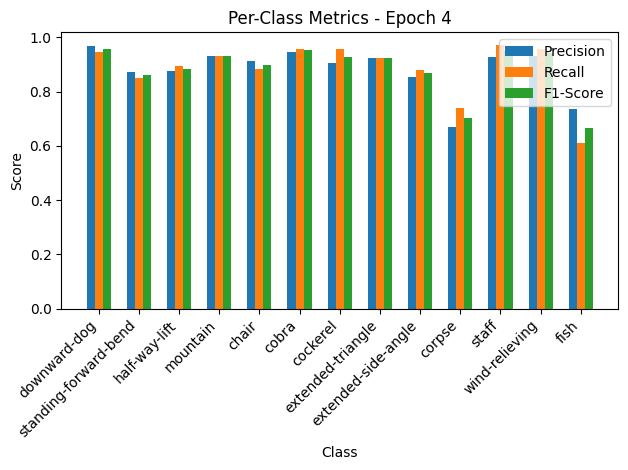

Validation: 100%|██████████| 21/21 [00:00<00:00, 24.95it/s, loss=0.315, accuracy=92.4]


Per-Class Metrics for Epoch 4:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.93, Recall=0.98, F1-Score=0.95
half-way-lift: Precision=0.94, Recall=0.86, F1-Score=0.90
mountain: Precision=1.00, Recall=0.93, F1-Score=0.96
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.95, Recall=0.91, F1-Score=0.93
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.82, Recall=1.00, F1-Score=0.90
corpse: Precision=0.75, Recall=0.67, F1-Score=0.71
staff: Precision=0.89, Recall=1.00, F1-Score=0.94
wind-relieving: Precision=0.85, Recall=1.00, F1-Score=0.92
fish: Precision=0.79, Recall=0.65, F1-Score=0.71


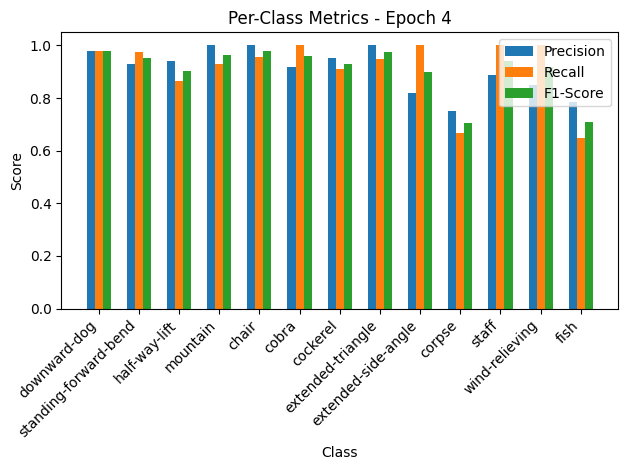


Epoch 5/50 Summary:
Train Loss: 0.3365 | Train Acc: 89.16% | Train Precision: 0.89 | Train Recall: 0.89 | Train F1: 0.89
Val Loss: 0.3239 | Val Acc: 92.35% | Val Precision: 0.92 | Val Recall: 0.92 | Val F1: 0.92
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model.pth
Checkpoint saved at epoch 5
New best model saved! Validation Loss: 0.3239

Epoch 6/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  8.17it/s, loss=0.251, accuracy=91.6]


Per-Class Metrics for Epoch 5:
downward-dog: Precision=0.96, Recall=0.93, F1-Score=0.95
standing-forward-bend: Precision=0.93, Recall=0.89, F1-Score=0.91
half-way-lift: Precision=0.94, Recall=0.93, F1-Score=0.93
mountain: Precision=0.89, Recall=0.98, F1-Score=0.93
chair: Precision=0.98, Recall=0.95, F1-Score=0.96
cobra: Precision=0.92, Recall=0.96, F1-Score=0.94
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.88, Recall=0.88, F1-Score=0.88
extended-side-angle: Precision=0.88, Recall=0.86, F1-Score=0.87
corpse: Precision=0.77, Recall=0.72, F1-Score=0.75
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.97, Recall=0.94, F1-Score=0.96
fish: Precision=0.72, Recall=0.78, F1-Score=0.75


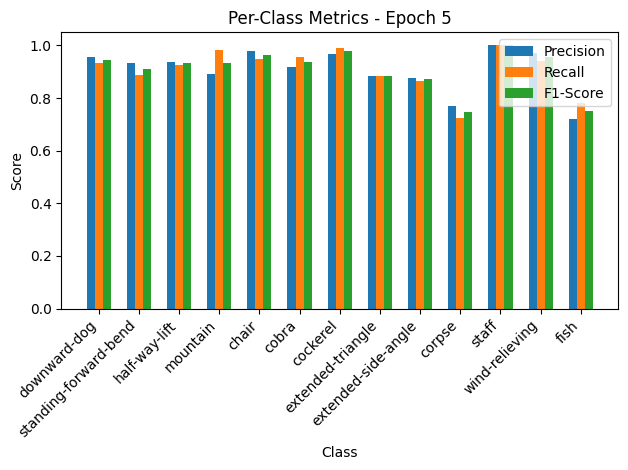

Validation: 100%|██████████| 21/21 [00:00<00:00, 27.01it/s, loss=0.294, accuracy=90.5]


Per-Class Metrics for Epoch 5:
downward-dog: Precision=0.96, Recall=1.00, F1-Score=0.98
standing-forward-bend: Precision=0.80, Recall=0.90, F1-Score=0.85
half-way-lift: Precision=0.88, Recall=0.95, F1-Score=0.91
mountain: Precision=0.95, Recall=0.69, F1-Score=0.80
chair: Precision=1.00, Recall=0.83, F1-Score=0.90
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.73, Recall=0.95, F1-Score=0.83
extended-side-angle: Precision=0.92, Recall=0.61, F1-Score=0.73
corpse: Precision=0.89, Recall=0.89, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.88, Recall=0.88, F1-Score=0.88


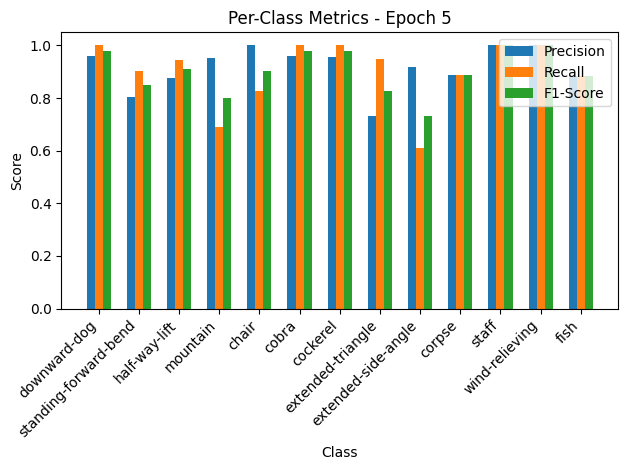


Epoch 6/50 Summary:
Train Loss: 0.2514 | Train Acc: 91.60% | Train Precision: 0.92 | Train Recall: 0.92 | Train F1: 0.92
Val Loss: 0.3024 | Val Acc: 90.52% | Val Precision: 0.91 | Val Recall: 0.91 | Val F1: 0.90
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model.pth
Checkpoint saved at epoch 6
New best model saved! Validation Loss: 0.3024

Epoch 7/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.35it/s, loss=0.24, accuracy=92.5]


Per-Class Metrics for Epoch 6:
downward-dog: Precision=0.97, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.92, Recall=0.90, F1-Score=0.91
half-way-lift: Precision=0.92, Recall=0.94, F1-Score=0.93
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.97, Recall=0.96, F1-Score=0.96
cobra: Precision=0.98, Recall=0.96, F1-Score=0.97
cockerel: Precision=0.97, Recall=0.96, F1-Score=0.96
extended-triangle: Precision=0.88, Recall=0.86, F1-Score=0.87
extended-side-angle: Precision=0.86, Recall=0.89, F1-Score=0.87
corpse: Precision=0.80, Recall=0.74, F1-Score=0.77
staff: Precision=0.96, Recall=0.98, F1-Score=0.97
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.78, Recall=0.83, F1-Score=0.80


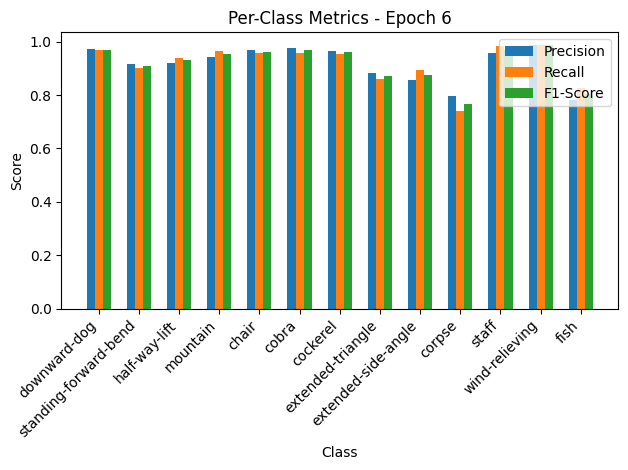

Validation: 100%|██████████| 21/21 [00:00<00:00, 27.90it/s, loss=0.29, accuracy=93]


Per-Class Metrics for Epoch 6:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.95, Recall=0.98, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.92, F1-Score=0.93
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=1.00, Recall=0.91, F1-Score=0.95
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.91, Recall=1.00, F1-Score=0.95
extended-side-angle: Precision=1.00, Recall=0.89, F1-Score=0.94
corpse: Precision=0.56, Recall=1.00, F1-Score=0.72
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.18, F1-Score=0.30


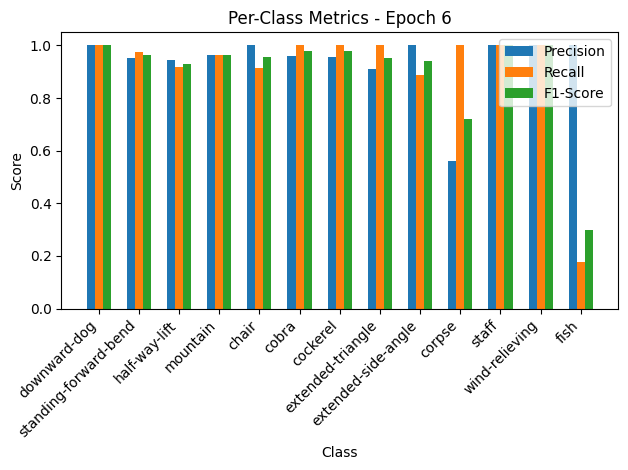


Epoch 7/50 Summary:
Train Loss: 0.2407 | Train Acc: 92.52% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.2981 | Val Acc: 92.97% | Val Precision: 0.95 | Val Recall: 0.93 | Val F1: 0.92
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model.pth
Checkpoint saved at epoch 7
New best model saved! Validation Loss: 0.2981

Epoch 8/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.88it/s, loss=0.25, accuracy=92.4]


Per-Class Metrics for Epoch 7:
downward-dog: Precision=0.97, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.91, Recall=0.89, F1-Score=0.90
half-way-lift: Precision=0.94, Recall=0.93, F1-Score=0.93
mountain: Precision=0.95, Recall=0.93, F1-Score=0.94
chair: Precision=0.91, Recall=0.94, F1-Score=0.92
cobra: Precision=0.97, Recall=0.96, F1-Score=0.96
cockerel: Precision=0.94, Recall=0.96, F1-Score=0.95
extended-triangle: Precision=0.96, Recall=0.95, F1-Score=0.95
extended-side-angle: Precision=0.91, Recall=0.95, F1-Score=0.93
corpse: Precision=0.75, Recall=0.80, F1-Score=0.77
staff: Precision=0.93, Recall=0.98, F1-Score=0.96
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.81, Recall=0.74, F1-Score=0.77


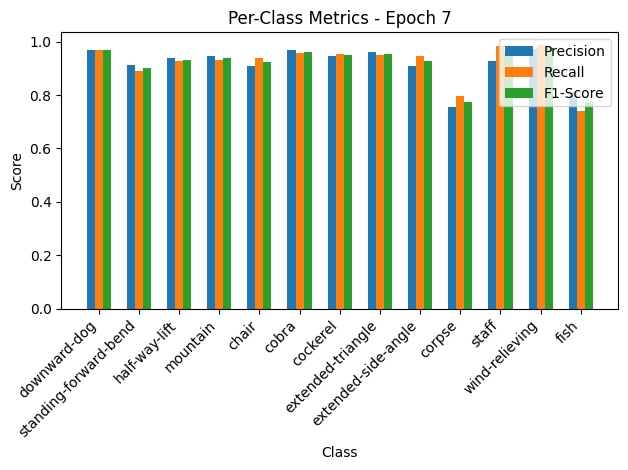

Validation: 100%|██████████| 21/21 [00:00<00:00, 26.88it/s, loss=0.247, accuracy=93]


Per-Class Metrics for Epoch 7:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=1.00, Recall=0.83, F1-Score=0.91
half-way-lift: Precision=0.80, Recall=0.95, F1-Score=0.86
mountain: Precision=1.00, Recall=0.97, F1-Score=0.98
chair: Precision=0.96, Recall=0.96, F1-Score=0.96
cobra: Precision=0.92, Recall=0.96, F1-Score=0.94
cockerel: Precision=0.95, Recall=0.91, F1-Score=0.93
extended-triangle: Precision=1.00, Recall=0.90, F1-Score=0.95
extended-side-angle: Precision=0.90, Recall=1.00, F1-Score=0.95
corpse: Precision=0.78, Recall=1.00, F1-Score=0.88
staff: Precision=0.89, Recall=1.00, F1-Score=0.94
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.71, F1-Score=0.83


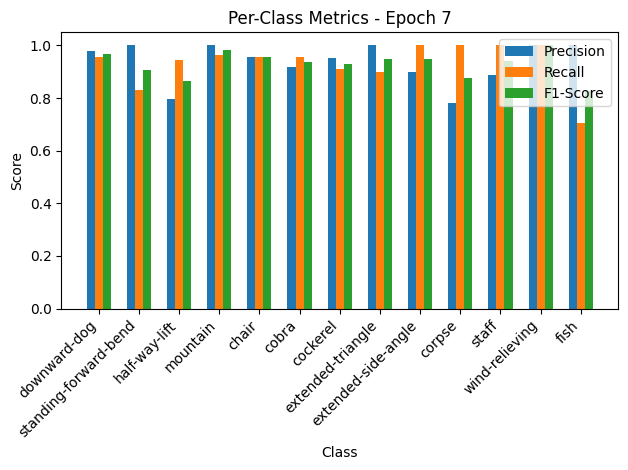


Epoch 8/50 Summary:
Train Loss: 0.2500 | Train Acc: 92.44% | Train Precision: 0.92 | Train Recall: 0.92 | Train F1: 0.92
Val Loss: 0.2541 | Val Acc: 92.97% | Val Precision: 0.94 | Val Recall: 0.93 | Val F1: 0.93
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model.pth
Checkpoint saved at epoch 8
New best model saved! Validation Loss: 0.2541

Epoch 9/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.16it/s, loss=0.204, accuracy=93.7]


Per-Class Metrics for Epoch 8:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.96, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.92, Recall=0.94, F1-Score=0.93
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.92, Recall=0.95, F1-Score=0.93
cobra: Precision=0.95, Recall=0.97, F1-Score=0.96
cockerel: Precision=0.98, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.94, F1-Score=0.96
extended-side-angle: Precision=0.92, Recall=0.96, F1-Score=0.94
corpse: Precision=0.82, Recall=0.81, F1-Score=0.82
staff: Precision=0.98, Recall=0.95, F1-Score=0.97
wind-relieving: Precision=0.96, Recall=0.97, F1-Score=0.96
fish: Precision=0.81, Recall=0.86, F1-Score=0.83


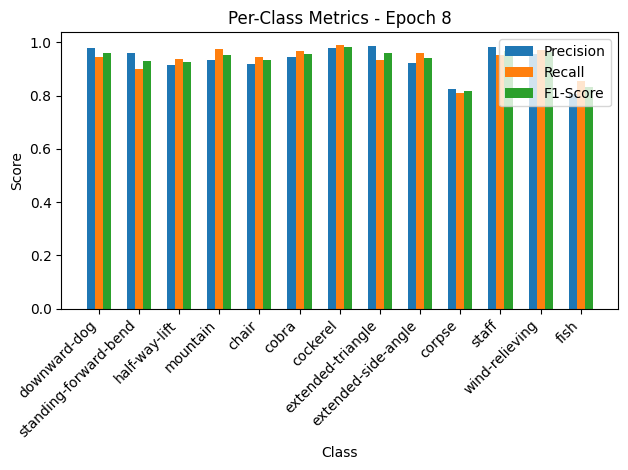

Validation: 100%|██████████| 21/21 [00:00<00:00, 22.29it/s, loss=0.279, accuracy=93.3]


Per-Class Metrics for Epoch 8:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.93, F1-Score=0.95
half-way-lift: Precision=0.89, Recall=0.92, F1-Score=0.91
mountain: Precision=1.00, Recall=0.97, F1-Score=0.98
chair: Precision=0.96, Recall=0.96, F1-Score=0.96
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.77, Recall=1.00, F1-Score=0.87
extended-side-angle: Precision=1.00, Recall=0.67, F1-Score=0.80
corpse: Precision=0.72, Recall=1.00, F1-Score=0.84
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.59, F1-Score=0.74


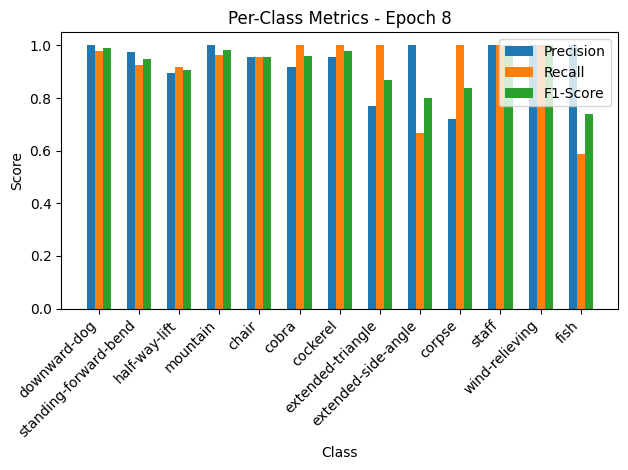


Epoch 9/50 Summary:
Train Loss: 0.2045 | Train Acc: 93.66% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.2863 | Val Acc: 93.27% | Val Precision: 0.94 | Val Recall: 0.93 | Val F1: 0.93

Epoch 10/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.69it/s, loss=0.2, accuracy=94.2]


Per-Class Metrics for Epoch 9:
downward-dog: Precision=0.97, Recall=0.96, F1-Score=0.96
standing-forward-bend: Precision=0.94, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.95, Recall=0.96, F1-Score=0.96
mountain: Precision=0.94, Recall=0.96, F1-Score=0.95
chair: Precision=0.96, Recall=0.97, F1-Score=0.96
cobra: Precision=0.95, Recall=0.96, F1-Score=0.95
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.96, Recall=0.95, F1-Score=0.95
extended-side-angle: Precision=0.93, Recall=0.95, F1-Score=0.94
corpse: Precision=0.82, Recall=0.81, F1-Score=0.82
staff: Precision=0.93, Recall=0.98, F1-Score=0.96
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.85, Recall=0.81, F1-Score=0.83


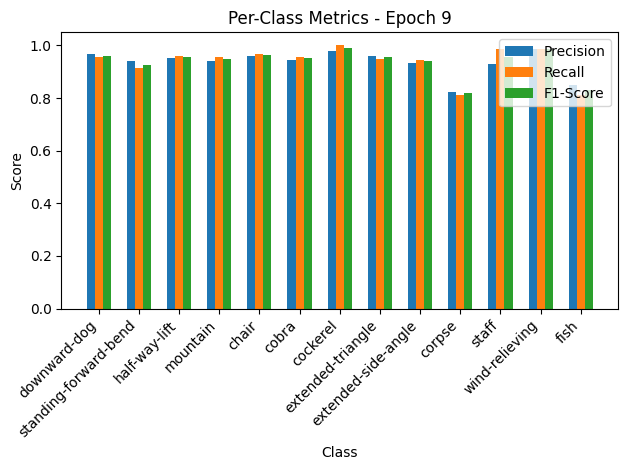

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.04it/s, loss=0.184, accuracy=95.7]


Per-Class Metrics for Epoch 9:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=1.00, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.94, Recall=0.92, F1-Score=0.93
mountain: Precision=1.00, Recall=0.97, F1-Score=0.98
chair: Precision=0.92, Recall=0.96, F1-Score=0.94
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=0.90, F1-Score=0.92
extended-side-angle: Precision=0.94, Recall=0.94, F1-Score=0.94
corpse: Precision=0.82, Recall=1.00, F1-Score=0.90
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.76, F1-Score=0.87


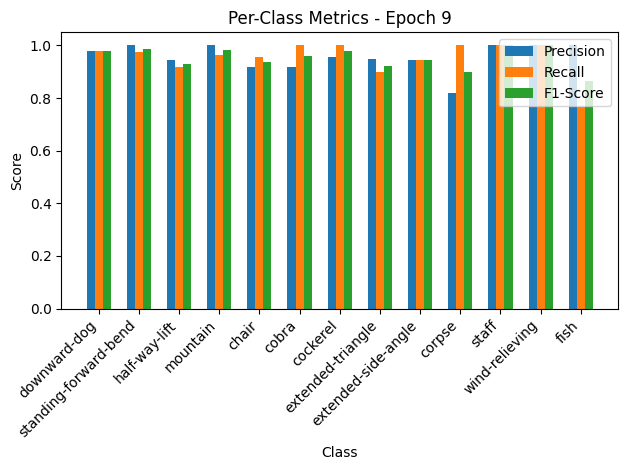


Epoch 10/50 Summary:
Train Loss: 0.1998 | Train Acc: 94.20% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.1894 | Val Acc: 95.72% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model.pth
Checkpoint saved at epoch 10
New best model saved! Validation Loss: 0.1894

Epoch 11/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.67it/s, loss=0.168, accuracy=95.4]


Per-Class Metrics for Epoch 10:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.96, Recall=0.92, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.97, F1-Score=0.95
mountain: Precision=0.96, Recall=0.99, F1-Score=0.97
chair: Precision=0.97, Recall=0.96, F1-Score=0.96
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.98, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.94, F1-Score=0.95
extended-side-angle: Precision=0.94, Recall=0.97, F1-Score=0.95
corpse: Precision=0.89, Recall=0.83, F1-Score=0.86
staff: Precision=0.98, Recall=0.98, F1-Score=0.98
wind-relieving: Precision=0.95, Recall=1.00, F1-Score=0.97
fish: Precision=0.87, Recall=0.88, F1-Score=0.88


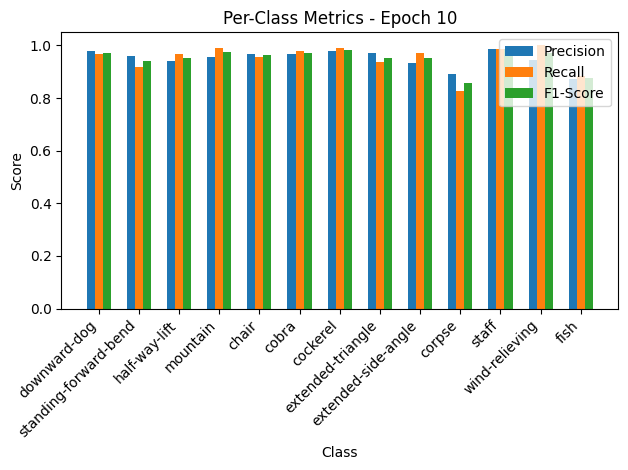

Validation: 100%|██████████| 21/21 [00:00<00:00, 30.23it/s, loss=0.286, accuracy=93.6]


Per-Class Metrics for Epoch 10:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.95, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.89, Recall=0.92, F1-Score=0.91
mountain: Precision=1.00, Recall=0.90, F1-Score=0.95
chair: Precision=0.96, Recall=0.96, F1-Score=0.96
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.71, Recall=1.00, F1-Score=0.83
extended-side-angle: Precision=1.00, Recall=0.61, F1-Score=0.76
corpse: Precision=0.82, Recall=1.00, F1-Score=0.90
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.76, F1-Score=0.87


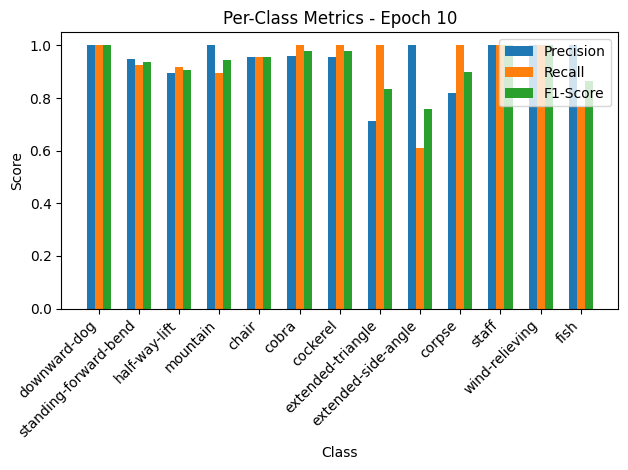


Epoch 11/50 Summary:
Train Loss: 0.1678 | Train Acc: 95.42% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.2939 | Val Acc: 93.58% | Val Precision: 0.95 | Val Recall: 0.94 | Val F1: 0.93

Epoch 12/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.60it/s, loss=0.19, accuracy=95.6]


Per-Class Metrics for Epoch 11:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.95, Recall=0.97, F1-Score=0.96
mountain: Precision=0.96, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.97, F1-Score=0.96
cobra: Precision=0.99, Recall=0.99, F1-Score=0.99
cockerel: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.92, Recall=0.91, F1-Score=0.92
extended-side-angle: Precision=0.91, Recall=0.91, F1-Score=0.91
corpse: Precision=0.89, Recall=0.83, F1-Score=0.86
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.85, Recall=0.90, F1-Score=0.87


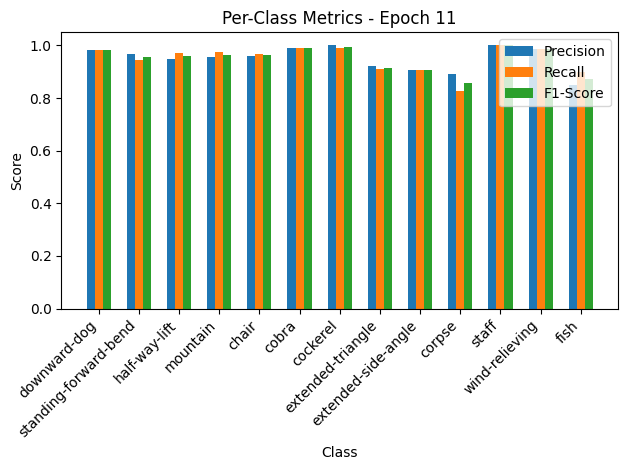

Validation: 100%|██████████| 21/21 [00:00<00:00, 22.11it/s, loss=0.397, accuracy=93.6]


Per-Class Metrics for Epoch 11:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.94, Recall=0.92, F1-Score=0.93
mountain: Precision=1.00, Recall=0.93, F1-Score=0.96
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.88, Recall=1.00, F1-Score=0.94
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.90, Recall=1.00, F1-Score=0.95
corpse: Precision=0.61, Recall=0.94, F1-Score=0.74
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.94, Recall=1.00, F1-Score=0.97
fish: Precision=1.00, Recall=0.35, F1-Score=0.52


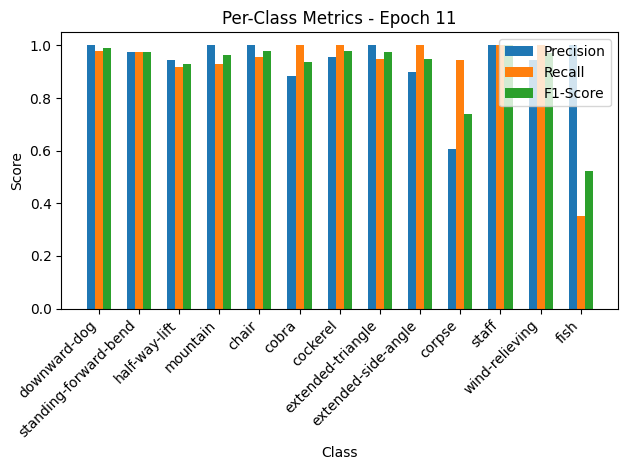


Epoch 12/50 Summary:
Train Loss: 0.1906 | Train Acc: 95.57% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.4083 | Val Acc: 93.58% | Val Precision: 0.95 | Val Recall: 0.94 | Val F1: 0.93

Epoch 13/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.52it/s, loss=0.173, accuracy=96]


Per-Class Metrics for Epoch 12:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.93, F1-Score=0.95
half-way-lift: Precision=0.94, Recall=0.96, F1-Score=0.95
mountain: Precision=0.97, Recall=0.98, F1-Score=0.98
chair: Precision=0.98, Recall=0.98, F1-Score=0.98
cobra: Precision=0.99, Recall=0.99, F1-Score=0.99
cockerel: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.97, Recall=0.94, F1-Score=0.95
extended-side-angle: Precision=0.94, Recall=1.00, F1-Score=0.97
corpse: Precision=0.83, Recall=0.87, F1-Score=0.85
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.88, Recall=0.83, F1-Score=0.85


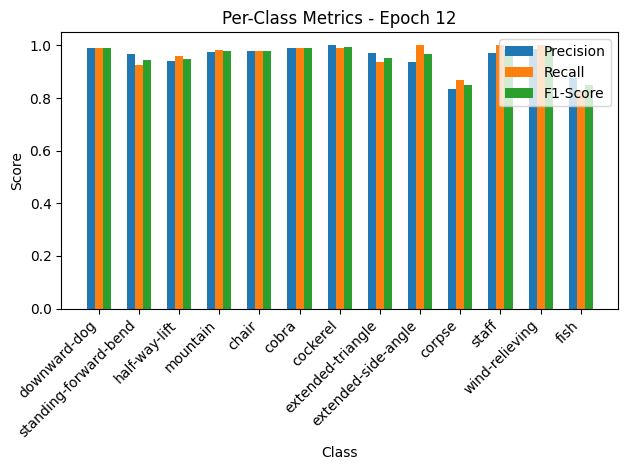

Validation: 100%|██████████| 21/21 [00:00<00:00, 25.72it/s, loss=0.275, accuracy=94.8]


Per-Class Metrics for Epoch 12:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.83, Recall=0.98, F1-Score=0.90
half-way-lift: Precision=0.94, Recall=0.92, F1-Score=0.93
mountain: Precision=1.00, Recall=0.72, F1-Score=0.84
chair: Precision=0.96, Recall=0.96, F1-Score=0.96
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.94, Recall=0.89, F1-Score=0.91
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.89, Recall=0.94, F1-Score=0.91


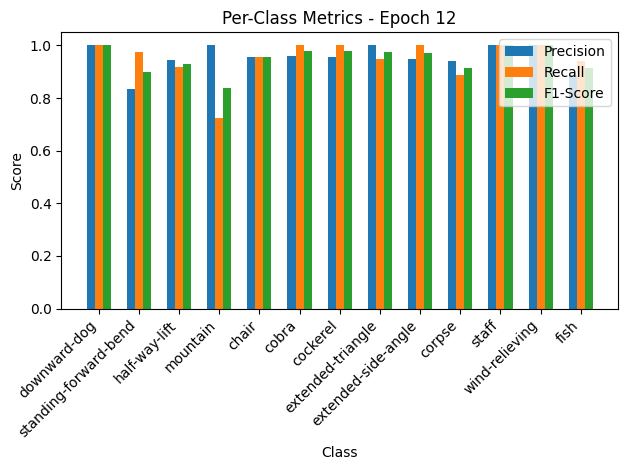


Epoch 13/50 Summary:
Train Loss: 0.1733 | Train Acc: 96.03% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.2824 | Val Acc: 94.80% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 14/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.95it/s, loss=0.157, accuracy=95.6]


Per-Class Metrics for Epoch 13:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.93, F1-Score=0.95
half-way-lift: Precision=0.94, Recall=0.97, F1-Score=0.96
mountain: Precision=0.96, Recall=0.97, F1-Score=0.96
chair: Precision=0.96, Recall=0.96, F1-Score=0.96
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.98, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.96, Recall=0.95, F1-Score=0.95
extended-side-angle: Precision=0.95, Recall=0.93, F1-Score=0.94
corpse: Precision=0.92, Recall=0.81, F1-Score=0.86
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.83, Recall=0.94, F1-Score=0.88


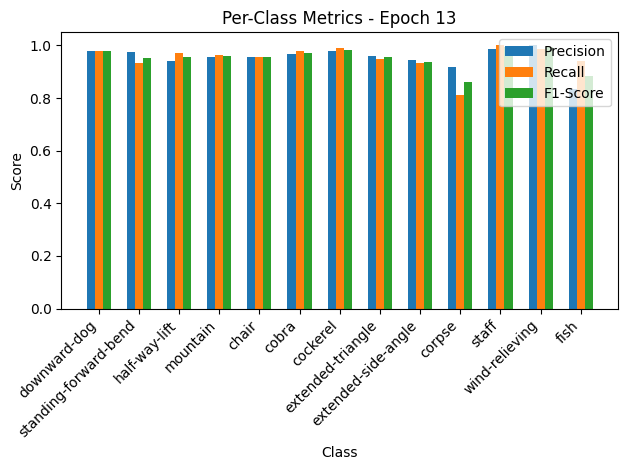

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.88it/s, loss=0.213, accuracy=95.7]


Per-Class Metrics for Epoch 13:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.98, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.92, F1-Score=0.93
mountain: Precision=0.96, Recall=0.93, F1-Score=0.95
chair: Precision=0.95, Recall=0.91, F1-Score=0.93
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=1.00, F1-Score=0.98
extended-side-angle: Precision=1.00, Recall=0.94, F1-Score=0.97
corpse: Precision=0.89, Recall=0.94, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.89, Recall=1.00, F1-Score=0.94
fish: Precision=1.00, Recall=0.82, F1-Score=0.90


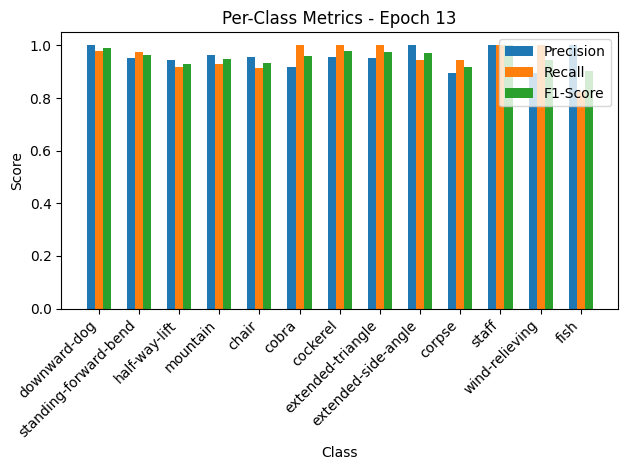


Epoch 14/50 Summary:
Train Loss: 0.1576 | Train Acc: 95.65% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.2186 | Val Acc: 95.72% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 15/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  8.08it/s, loss=0.153, accuracy=95.7]


Per-Class Metrics for Epoch 14:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.96, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.94, F1-Score=0.94
mountain: Precision=0.95, Recall=1.00, F1-Score=0.97
chair: Precision=0.99, Recall=0.97, F1-Score=0.98
cobra: Precision=0.96, Recall=0.97, F1-Score=0.96
cockerel: Precision=0.96, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.89, Recall=0.84, F1-Score=0.87
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.87, Recall=0.90, F1-Score=0.89


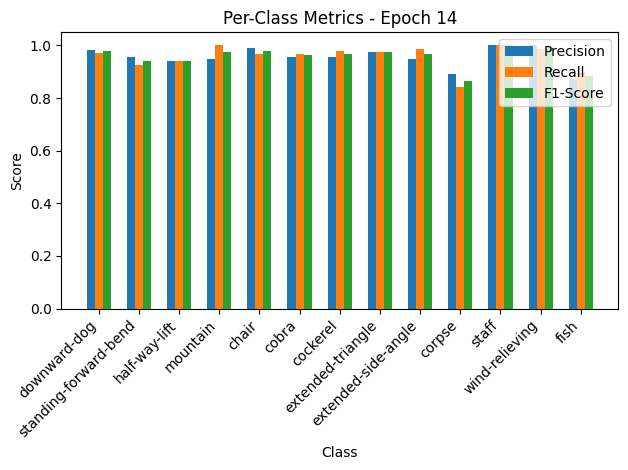

Validation: 100%|██████████| 21/21 [00:00<00:00, 31.28it/s, loss=0.306, accuracy=93.6]


Per-Class Metrics for Epoch 14:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.95, F1-Score=0.96
half-way-lift: Precision=0.92, Recall=0.92, F1-Score=0.92
mountain: Precision=1.00, Recall=0.93, F1-Score=0.96
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.90, Recall=0.90, F1-Score=0.90
extended-side-angle: Precision=0.84, Recall=0.89, F1-Score=0.86
corpse: Precision=1.00, Recall=0.56, F1-Score=0.71
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.94, Recall=1.00, F1-Score=0.97
fish: Precision=0.71, Recall=1.00, F1-Score=0.83


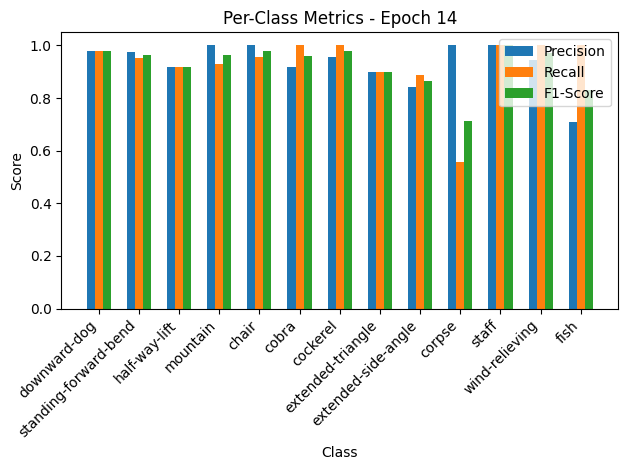


Epoch 15/50 Summary:
Train Loss: 0.1537 | Train Acc: 95.73% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.3148 | Val Acc: 93.58% | Val Precision: 0.94 | Val Recall: 0.94 | Val F1: 0.93

Epoch 16/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.80it/s, loss=0.142, accuracy=96.2]


Per-Class Metrics for Epoch 15:
downward-dog: Precision=0.97, Recall=0.99, F1-Score=0.98
standing-forward-bend: Precision=0.98, Recall=0.93, F1-Score=0.95
half-way-lift: Precision=0.95, Recall=0.97, F1-Score=0.96
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.92, F1-Score=0.95
extended-side-angle: Precision=0.95, Recall=0.97, F1-Score=0.96
corpse: Precision=0.95, Recall=0.75, F1-Score=0.84
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.80, Recall=0.96, F1-Score=0.87


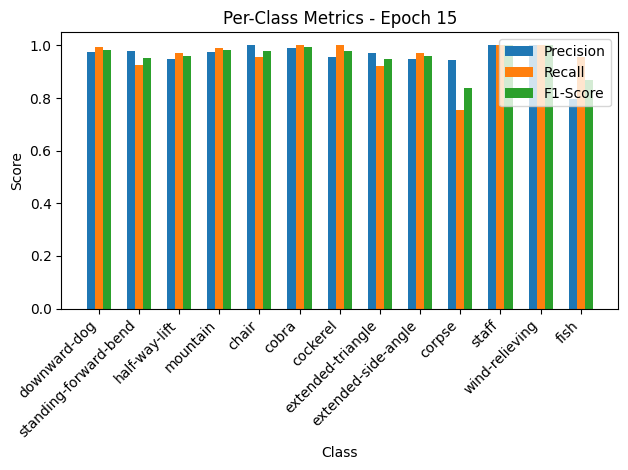

Validation: 100%|██████████| 21/21 [00:00<00:00, 23.82it/s, loss=0.229, accuracy=95.1]


Per-Class Metrics for Epoch 15:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.95, F1-Score=0.96
half-way-lift: Precision=0.92, Recall=0.92, F1-Score=0.92
mountain: Precision=1.00, Recall=0.93, F1-Score=0.96
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.90, Recall=0.95, F1-Score=0.93
extended-side-angle: Precision=0.89, Recall=0.89, F1-Score=0.89
corpse: Precision=0.82, Recall=1.00, F1-Score=0.90
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.76, F1-Score=0.87


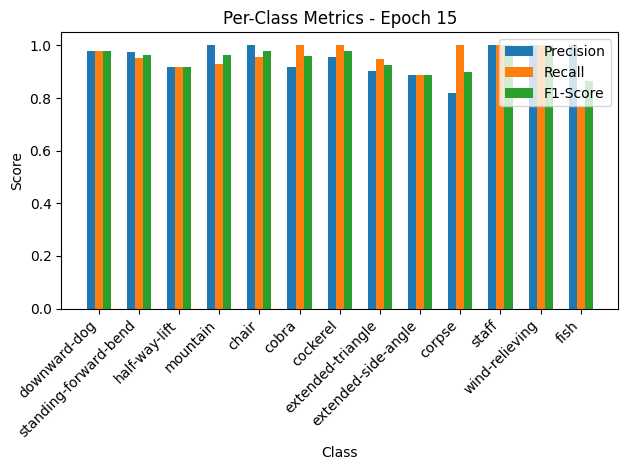


Epoch 16/50 Summary:
Train Loss: 0.1420 | Train Acc: 96.18% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.2353 | Val Acc: 95.11% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 17/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.23it/s, loss=0.0679, accuracy=97.8]


Per-Class Metrics for Epoch 16:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.96, Recall=0.96, F1-Score=0.96
half-way-lift: Precision=0.97, Recall=0.97, F1-Score=0.97
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.97, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.97, F1-Score=0.97
corpse: Precision=0.96, Recall=0.93, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.96, F1-Score=0.94


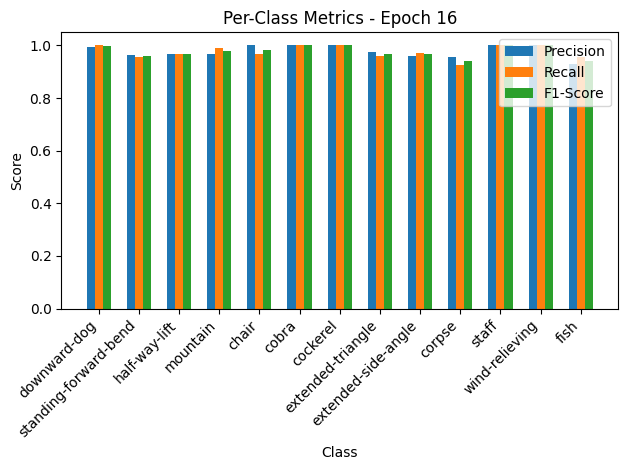

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.16it/s, loss=0.218, accuracy=95.7]


Per-Class Metrics for Epoch 16:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.95, F1-Score=0.96
half-way-lift: Precision=0.92, Recall=0.92, F1-Score=0.92
mountain: Precision=1.00, Recall=0.93, F1-Score=0.96
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=0.95, F1-Score=0.95
extended-side-angle: Precision=0.89, Recall=0.94, F1-Score=0.92
corpse: Precision=0.86, Recall=1.00, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.82, F1-Score=0.90


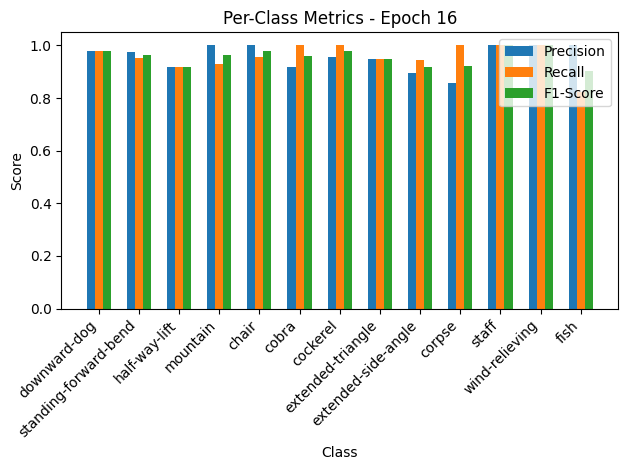


Epoch 17/50 Summary:
Train Loss: 0.0680 | Train Acc: 97.79% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.2242 | Val Acc: 95.72% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 18/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:10<00:00,  8.04it/s, loss=0.0847, accuracy=97.5]


Per-Class Metrics for Epoch 17:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.96, Recall=0.99, F1-Score=0.97
chair: Precision=0.98, Recall=0.97, F1-Score=0.97
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.97, F1-Score=0.97
corpse: Precision=0.93, Recall=0.91, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.91, Recall=0.93, F1-Score=0.92


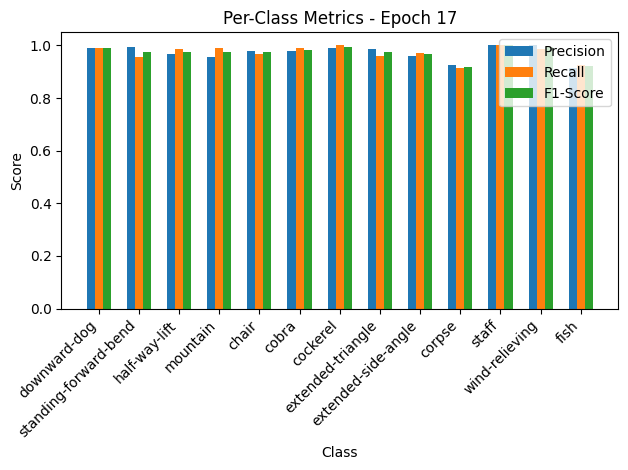

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.06it/s, loss=0.187, accuracy=97.2]


Per-Class Metrics for Epoch 17:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.98, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.94, Recall=0.92, F1-Score=0.93
mountain: Precision=1.00, Recall=0.93, F1-Score=0.96
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.95, Recall=1.00, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.94, F1-Score=0.97


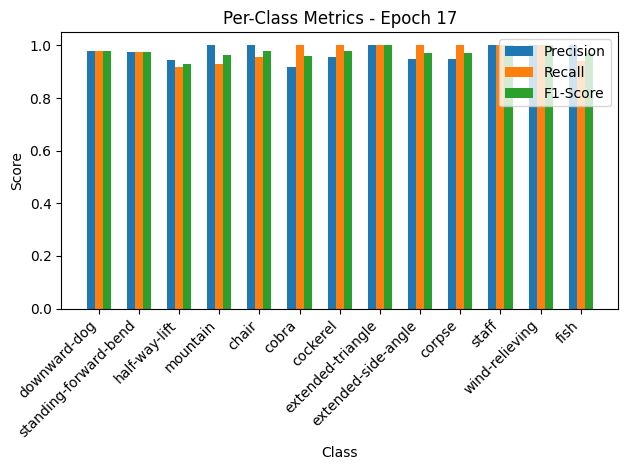


Epoch 18/50 Summary:
Train Loss: 0.0848 | Train Acc: 97.48% | Train Precision: 0.98 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.1921 | Val Acc: 97.25% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 19/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.77it/s, loss=0.0532, accuracy=97.9]


Per-Class Metrics for Epoch 18:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.98, F1-Score=0.98
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.99, Recall=0.98, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.97, Recall=0.97, F1-Score=0.97
corpse: Precision=0.97, Recall=0.91, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.92, Recall=0.97, F1-Score=0.94


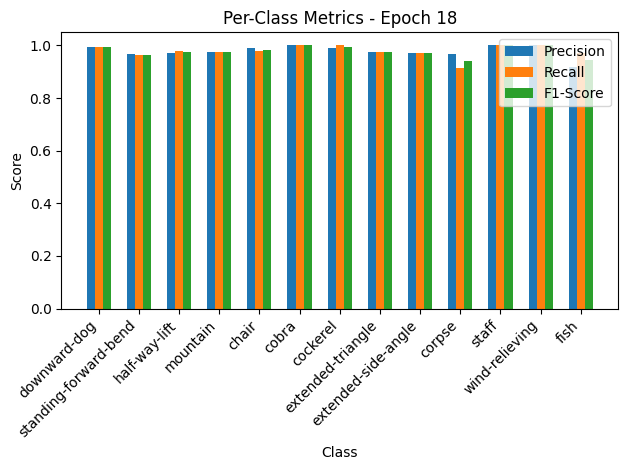

Validation: 100%|██████████| 21/21 [00:00<00:00, 22.90it/s, loss=0.202, accuracy=96.6]


Per-Class Metrics for Epoch 18:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.98, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.92, F1-Score=0.93
mountain: Precision=1.00, Recall=0.93, F1-Score=0.96
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.86, Recall=1.00, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.82, F1-Score=0.90


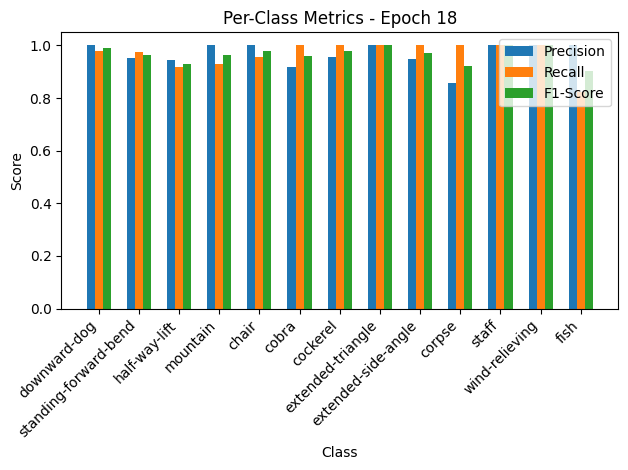


Epoch 19/50 Summary:
Train Loss: 0.0533 | Train Acc: 97.94% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.2080 | Val Acc: 96.64% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 20/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.90it/s, loss=0.0539, accuracy=98.1]


Per-Class Metrics for Epoch 19:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.96, Recall=1.00, F1-Score=0.98
chair: Precision=0.99, Recall=0.97, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=0.93, Recall=0.94, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.93, F1-Score=0.93


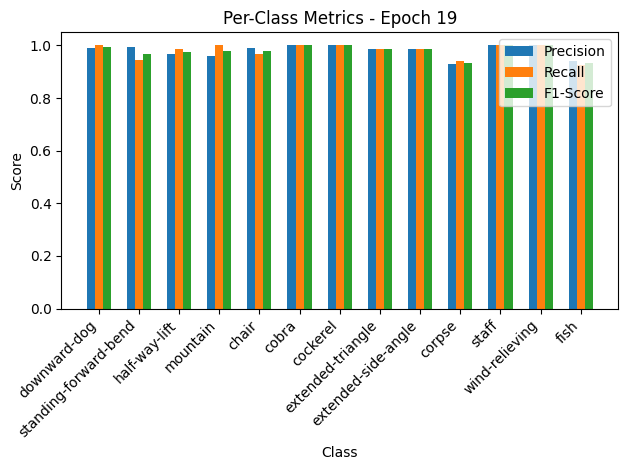

Validation: 100%|██████████| 21/21 [00:00<00:00, 24.53it/s, loss=0.187, accuracy=96.6]


Per-Class Metrics for Epoch 19:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.98, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.92, F1-Score=0.93
mountain: Precision=1.00, Recall=0.93, F1-Score=0.96
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.89, Recall=0.94, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.88, F1-Score=0.91


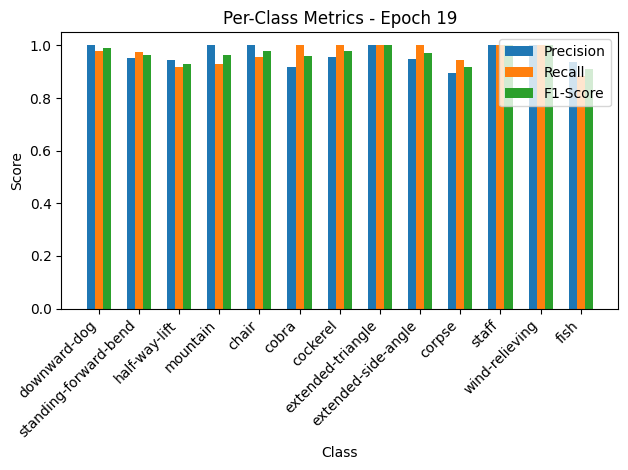


Epoch 20/50 Summary:
Train Loss: 0.0540 | Train Acc: 98.09% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1919 | Val Acc: 96.64% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 21/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:11<00:00,  7.32it/s, loss=0.0483, accuracy=98.2]


Per-Class Metrics for Epoch 20:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.97, Recall=0.95, F1-Score=0.96
half-way-lift: Precision=0.97, Recall=0.97, F1-Score=0.97
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=0.99, Recall=0.99, F1-Score=0.99
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.91, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.92, Recall=0.97, F1-Score=0.94


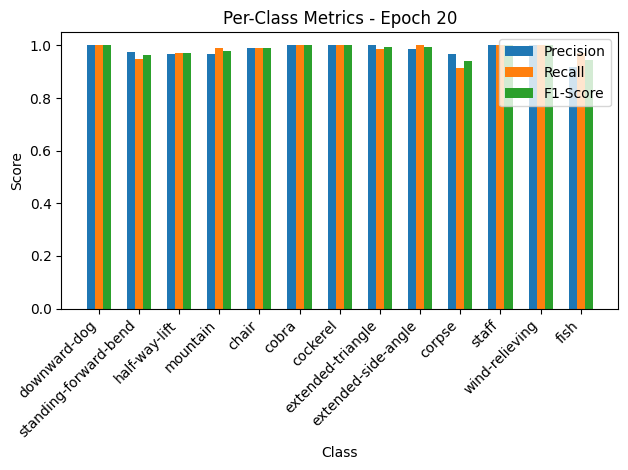

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.78it/s, loss=0.202, accuracy=96.6]


Per-Class Metrics for Epoch 20:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.98, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.92, F1-Score=0.93
mountain: Precision=1.00, Recall=0.93, F1-Score=0.96
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.86, Recall=1.00, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.82, F1-Score=0.90


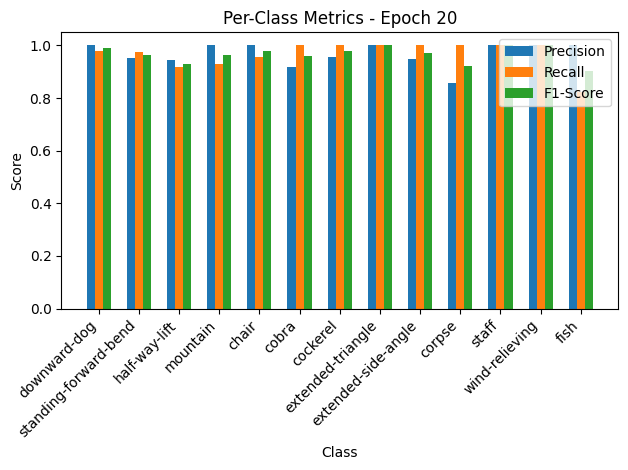


Epoch 21/50 Summary:
Train Loss: 0.0484 | Train Acc: 98.24% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.2073 | Val Acc: 96.64% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 22/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:09<00:00,  8.59it/s, loss=0.0457, accuracy=98.6]


Per-Class Metrics for Epoch 21:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.99, F1-Score=0.99
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.94, Recall=0.94, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.94, F1-Score=0.94


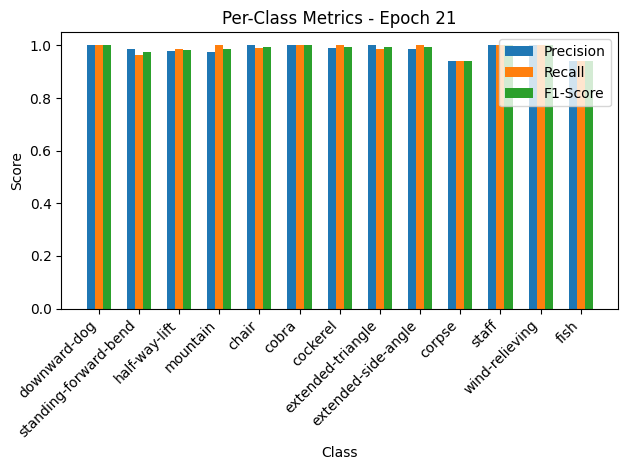

Validation: 100%|██████████| 21/21 [00:00<00:00, 22.26it/s, loss=0.193, accuracy=96.6]


Per-Class Metrics for Epoch 21:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.98, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.92, F1-Score=0.93
mountain: Precision=1.00, Recall=0.93, F1-Score=0.96
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=1.00, F1-Score=0.98
extended-side-angle: Precision=0.94, Recall=0.94, F1-Score=0.94
corpse: Precision=0.90, Recall=1.00, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.88, F1-Score=0.94


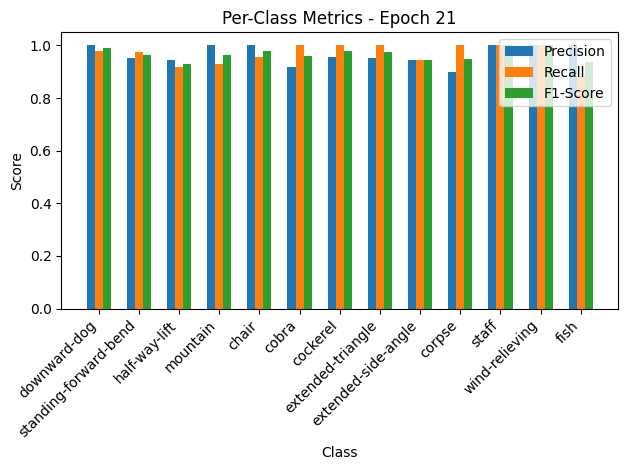


Epoch 22/50 Summary:
Train Loss: 0.0458 | Train Acc: 98.63% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1984 | Val Acc: 96.64% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 23/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:09<00:00,  9.08it/s, loss=0.0442, accuracy=98.7]


Per-Class Metrics for Epoch 22:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.99
mountain: Precision=0.98, Recall=0.99, F1-Score=0.99
chair: Precision=0.99, Recall=0.98, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.91, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.92, Recall=0.97, F1-Score=0.94


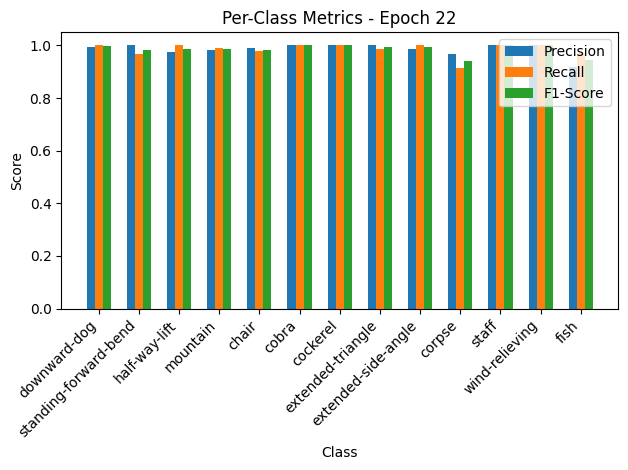

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.07it/s, loss=0.182, accuracy=96.6]


Per-Class Metrics for Epoch 22:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.98, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.92, F1-Score=0.93
mountain: Precision=1.00, Recall=0.93, F1-Score=0.96
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=1.00, F1-Score=0.98
extended-side-angle: Precision=0.94, Recall=0.94, F1-Score=0.94
corpse: Precision=0.90, Recall=1.00, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.88, F1-Score=0.94


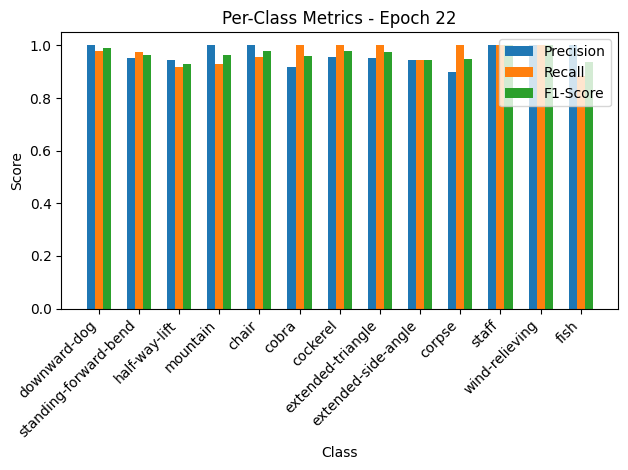


Epoch 23/50 Summary:
Train Loss: 0.0443 | Train Acc: 98.70% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1867 | Val Acc: 96.64% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model.pth
Checkpoint saved at epoch 23
New best model saved! Validation Loss: 0.1867

Epoch 24/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:10<00:00,  7.77it/s, loss=0.0348, accuracy=98.5]


Per-Class Metrics for Epoch 23:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.98, Recall=0.98, F1-Score=0.98
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=0.99, Recall=0.96, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.96, Recall=0.99, F1-Score=0.97


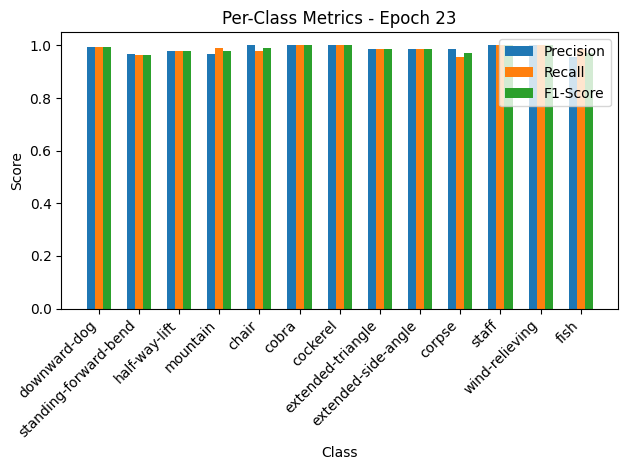

Validation: 100%|██████████| 21/21 [00:00<00:00, 28.78it/s, loss=0.19, accuracy=96.6]


Per-Class Metrics for Epoch 23:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.98, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.92, F1-Score=0.93
mountain: Precision=1.00, Recall=0.93, F1-Score=0.96
chair: Precision=0.96, Recall=0.96, F1-Score=0.96
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.89, Recall=0.94, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.94, Recall=1.00, F1-Score=0.97
fish: Precision=1.00, Recall=0.88, F1-Score=0.94


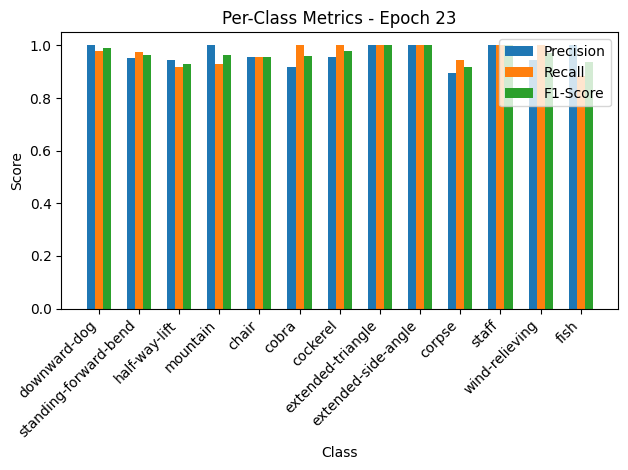


Epoch 24/50 Summary:
Train Loss: 0.0348 | Train Acc: 98.55% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1957 | Val Acc: 96.64% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 25/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:10<00:00,  7.73it/s, loss=0.0699, accuracy=97.9]


Per-Class Metrics for Epoch 24:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.96, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=0.98, F1-Score=0.97
chair: Precision=0.99, Recall=0.99, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.97, Recall=0.97, F1-Score=0.97
corpse: Precision=0.95, Recall=0.90, F1-Score=0.93
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.90, Recall=0.96, F1-Score=0.93


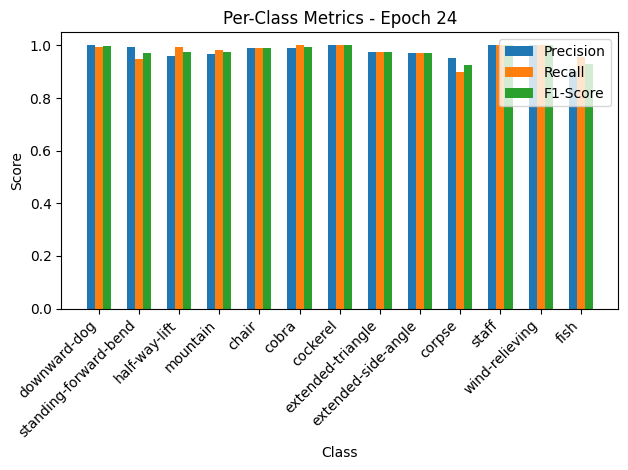

Validation: 100%|██████████| 21/21 [00:00<00:00, 23.71it/s, loss=0.19, accuracy=96.3]


Per-Class Metrics for Epoch 24:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.98, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.92, F1-Score=0.93
mountain: Precision=1.00, Recall=0.93, F1-Score=0.96
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.90, Recall=1.00, F1-Score=0.95
corpse: Precision=0.89, Recall=0.94, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.88, F1-Score=0.91


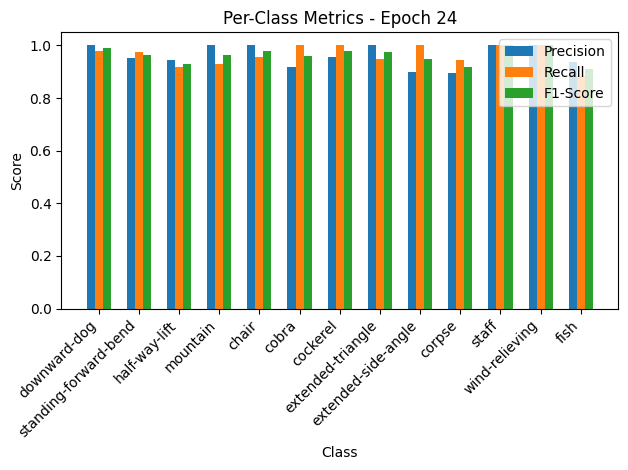


Epoch 25/50 Summary:
Train Loss: 0.0700 | Train Acc: 97.94% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1955 | Val Acc: 96.33% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 26/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:08<00:00,  9.16it/s, loss=0.0473, accuracy=98.5]


Per-Class Metrics for Epoch 25:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.99, F1-Score=0.99
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=1.00, Recall=0.93, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.93, Recall=1.00, F1-Score=0.97


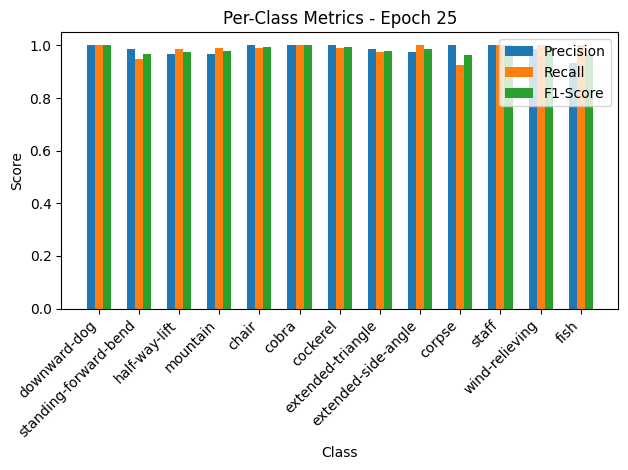

Validation: 100%|██████████| 21/21 [00:00<00:00, 25.25it/s, loss=0.199, accuracy=96.6]


Per-Class Metrics for Epoch 25:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.98, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.92, F1-Score=0.93
mountain: Precision=1.00, Recall=0.93, F1-Score=0.96
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.86, Recall=1.00, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.82, F1-Score=0.90


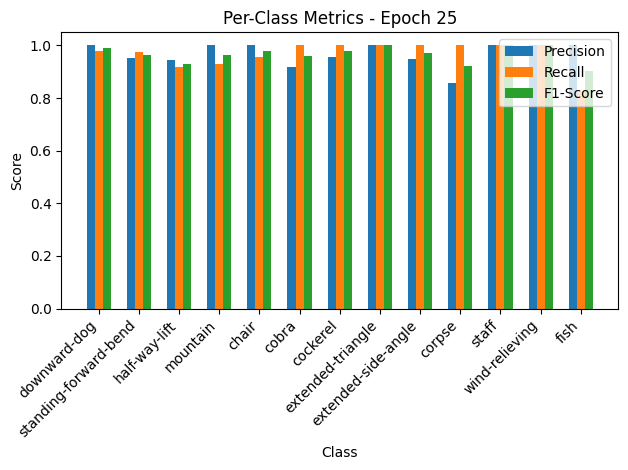


Epoch 26/50 Summary:
Train Loss: 0.0474 | Train Acc: 98.47% | Train Precision: 0.99 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.2042 | Val Acc: 96.64% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 27/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:09<00:00,  8.24it/s, loss=0.0499, accuracy=98.3]


Per-Class Metrics for Epoch 26:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.98, Recall=0.98, F1-Score=0.98
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=0.99, Recall=0.99, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.93, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.97, F1-Score=0.95


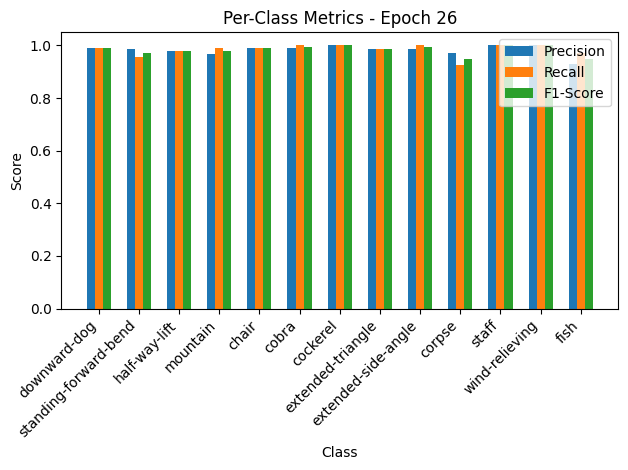

Validation: 100%|██████████| 21/21 [00:00<00:00, 30.53it/s, loss=0.198, accuracy=96.6]


Per-Class Metrics for Epoch 26:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.98, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.92, F1-Score=0.93
mountain: Precision=1.00, Recall=0.93, F1-Score=0.96
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.86, Recall=1.00, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.82, F1-Score=0.90


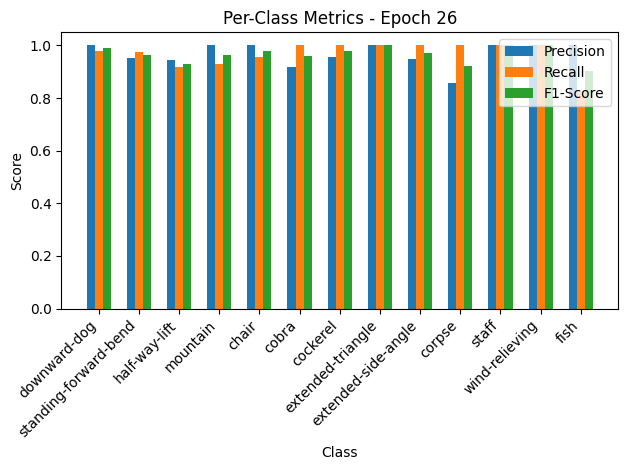


Epoch 27/50 Summary:
Train Loss: 0.0500 | Train Acc: 98.32% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.2037 | Val Acc: 96.64% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 28/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:10<00:00,  7.84it/s, loss=0.0446, accuracy=98.7]


Per-Class Metrics for Epoch 27:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=1.00, F1-Score=0.99
mountain: Precision=0.97, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.99, F1-Score=0.99
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.94, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.97, F1-Score=0.96


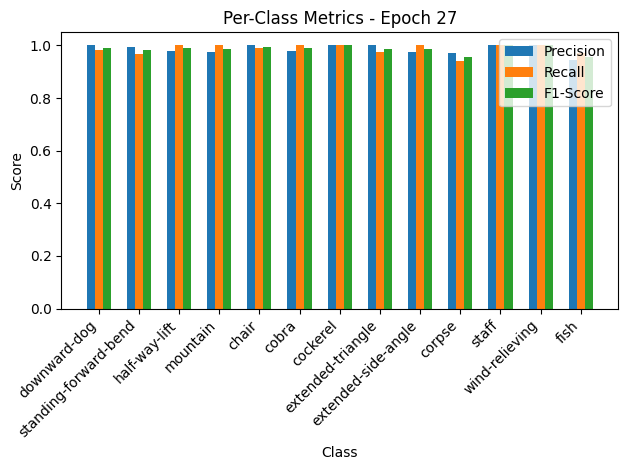

Validation: 100%|██████████| 21/21 [00:00<00:00, 28.71it/s, loss=0.197, accuracy=96.9]


Per-Class Metrics for Epoch 27:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.98, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.92, F1-Score=0.93
mountain: Precision=1.00, Recall=0.93, F1-Score=0.96
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.90, Recall=1.00, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.88, F1-Score=0.94


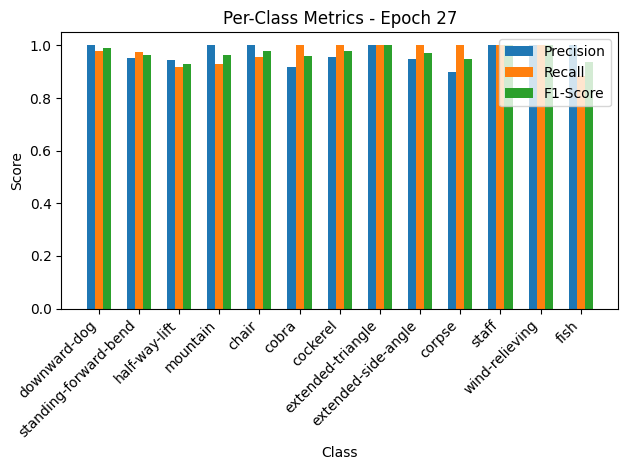


Epoch 28/50 Summary:
Train Loss: 0.0447 | Train Acc: 98.70% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2019 | Val Acc: 96.94% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 29/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:08<00:00,  9.26it/s, loss=0.0481, accuracy=98.2]


Per-Class Metrics for Epoch 28:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.98, F1-Score=0.98
mountain: Precision=0.96, Recall=0.99, F1-Score=0.97
chair: Precision=0.99, Recall=0.99, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=0.97, Recall=0.91, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.92, Recall=0.97, F1-Score=0.94


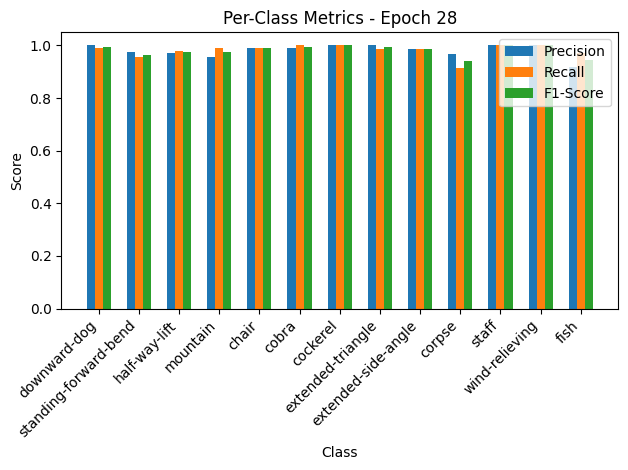

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.81it/s, loss=0.179, accuracy=96.9]


Per-Class Metrics for Epoch 28:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.98, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.92, F1-Score=0.93
mountain: Precision=1.00, Recall=0.93, F1-Score=0.96
chair: Precision=0.96, Recall=0.96, F1-Score=0.96
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.90, Recall=1.00, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.88, F1-Score=0.94


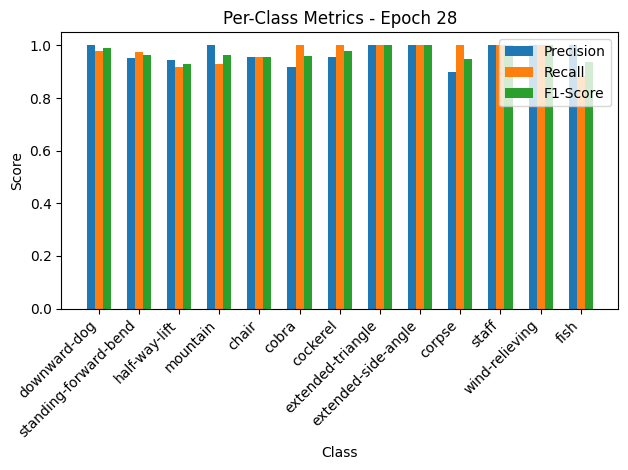


Epoch 29/50 Summary:
Train Loss: 0.0481 | Train Acc: 98.17% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1839 | Val Acc: 96.94% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model.pth
Checkpoint saved at epoch 29
New best model saved! Validation Loss: 0.1839

Epoch 30/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:09<00:00,  8.39it/s, loss=0.0374, accuracy=98.7]


Per-Class Metrics for Epoch 29:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=1.00, F1-Score=0.99
mountain: Precision=0.98, Recall=0.98, F1-Score=0.98
chair: Precision=0.99, Recall=0.99, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-side-angle: Precision=0.99, Recall=0.97, F1-Score=0.98
corpse: Precision=0.99, Recall=0.96, F1-Score=0.97
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.96, Recall=0.99, F1-Score=0.97


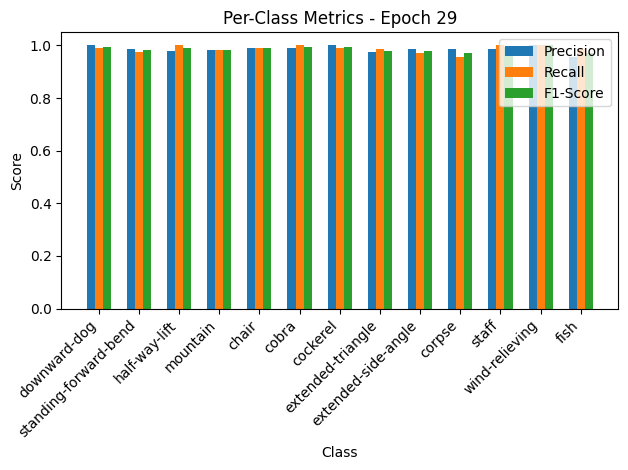

Validation: 100%|██████████| 21/21 [00:00<00:00, 30.50it/s, loss=0.189, accuracy=96.3]


Per-Class Metrics for Epoch 29:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.98, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.92, F1-Score=0.93
mountain: Precision=1.00, Recall=0.93, F1-Score=0.96
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=1.00, F1-Score=0.98
extended-side-angle: Precision=0.94, Recall=0.94, F1-Score=0.94
corpse: Precision=0.86, Recall=1.00, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.82, F1-Score=0.90


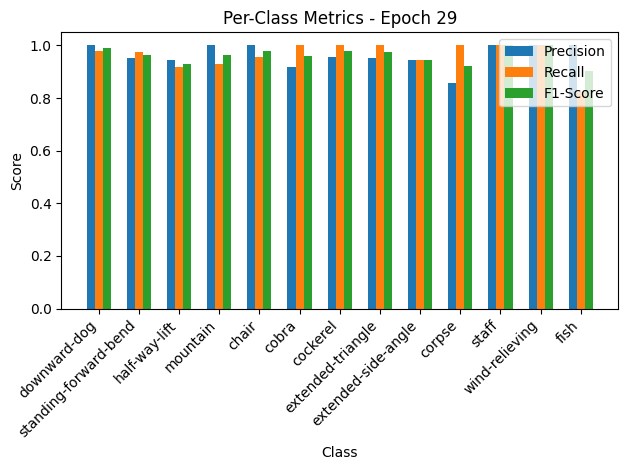


Epoch 30/50 Summary:
Train Loss: 0.0375 | Train Acc: 98.70% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1947 | Val Acc: 96.33% | Val Precision: 0.97 | Val Recall: 0.96 | Val F1: 0.96

Epoch 31/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:10<00:00,  8.17it/s, loss=0.0479, accuracy=98.5]


Per-Class Metrics for Epoch 30:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=1.00, F1-Score=0.99
mountain: Precision=0.97, Recall=1.00, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.95, Recall=0.91, F1-Score=0.93
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.92, Recall=0.94, F1-Score=0.93


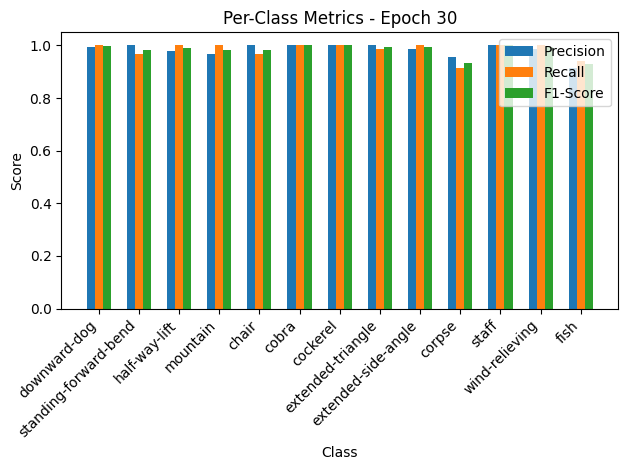

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.48it/s, loss=0.182, accuracy=96.9]


Per-Class Metrics for Epoch 30:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.98, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.92, F1-Score=0.93
mountain: Precision=1.00, Recall=0.93, F1-Score=0.96
chair: Precision=0.96, Recall=0.96, F1-Score=0.96
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.90, Recall=1.00, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.88, F1-Score=0.94


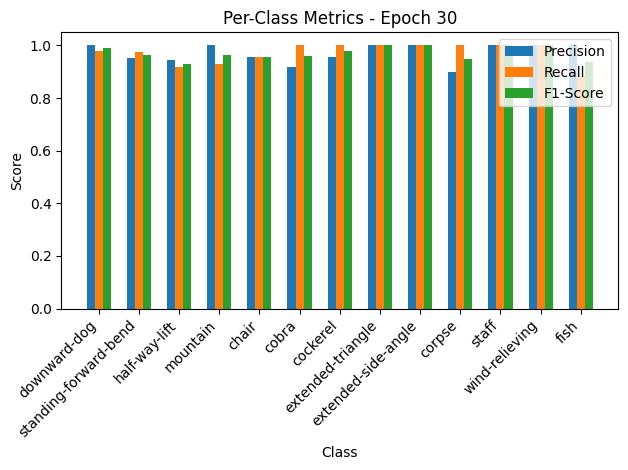


Epoch 31/50 Summary:
Train Loss: 0.0479 | Train Acc: 98.55% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1874 | Val Acc: 96.94% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 32/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:09<00:00,  8.88it/s, loss=0.0572, accuracy=98.2]


Per-Class Metrics for Epoch 31:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.99
mountain: Precision=0.96, Recall=0.99, F1-Score=0.97
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.91, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.92, Recall=0.97, F1-Score=0.94


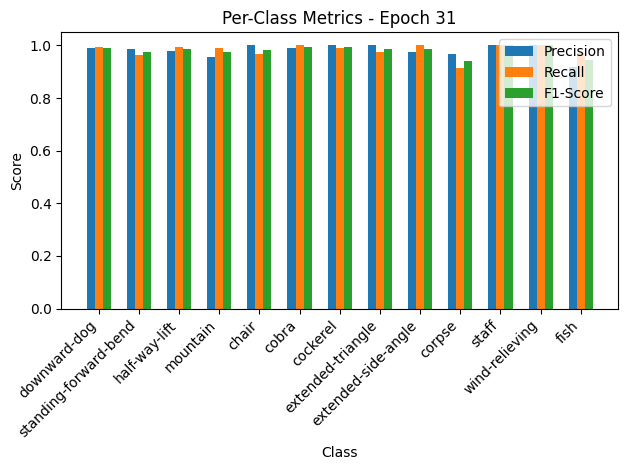

Validation: 100%|██████████| 21/21 [00:00<00:00, 23.16it/s, loss=0.188, accuracy=96.6]


Per-Class Metrics for Epoch 31:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.98, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.92, F1-Score=0.93
mountain: Precision=1.00, Recall=0.93, F1-Score=0.96
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=1.00, F1-Score=0.98
extended-side-angle: Precision=0.94, Recall=0.94, F1-Score=0.94
corpse: Precision=0.90, Recall=1.00, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.88, F1-Score=0.94


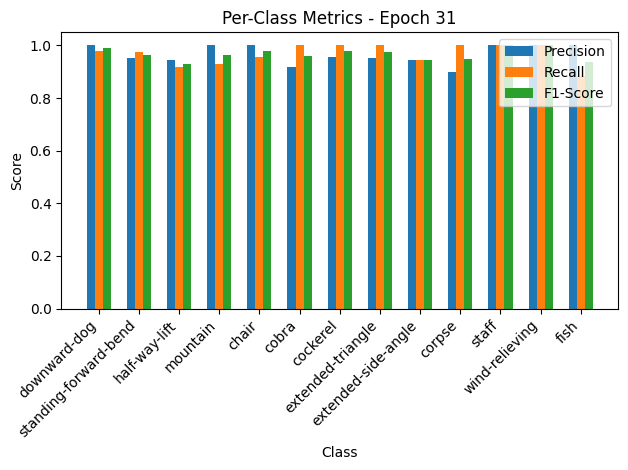


Epoch 32/50 Summary:
Train Loss: 0.0573 | Train Acc: 98.24% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1931 | Val Acc: 96.64% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 33/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:09<00:00,  8.65it/s, loss=0.0495, accuracy=98.7]


Per-Class Metrics for Epoch 32:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.96, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.99
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=0.99, Recall=0.98, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.96, Recall=0.96, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.96, Recall=0.96, F1-Score=0.96


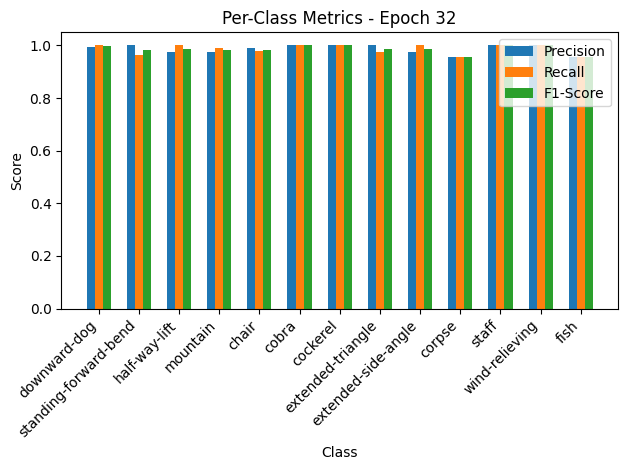

Validation: 100%|██████████| 21/21 [00:00<00:00, 30.53it/s, loss=0.197, accuracy=96.6]


Per-Class Metrics for Epoch 32:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.98, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.92, F1-Score=0.93
mountain: Precision=1.00, Recall=0.93, F1-Score=0.96
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.86, Recall=1.00, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.82, F1-Score=0.90


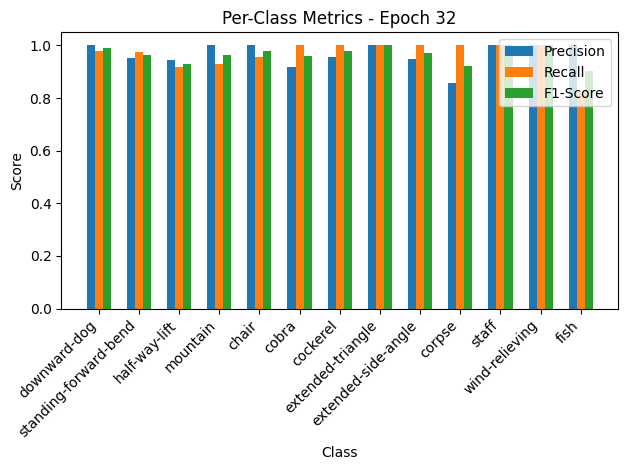


Epoch 33/50 Summary:
Train Loss: 0.0495 | Train Acc: 98.70% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2023 | Val Acc: 96.64% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 34/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:09<00:00,  8.33it/s, loss=0.0371, accuracy=98.7]


Per-Class Metrics for Epoch 33:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.96, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.98
mountain: Precision=0.97, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.98, Recall=0.94, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.99, F1-Score=0.96


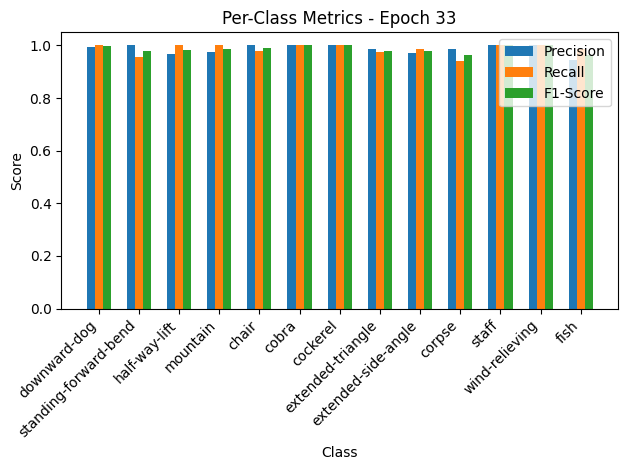

Validation: 100%|██████████| 21/21 [00:00<00:00, 30.27it/s, loss=0.197, accuracy=96.6]


Per-Class Metrics for Epoch 33:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.98, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.92, F1-Score=0.93
mountain: Precision=1.00, Recall=0.93, F1-Score=0.96
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.86, Recall=1.00, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.82, F1-Score=0.90


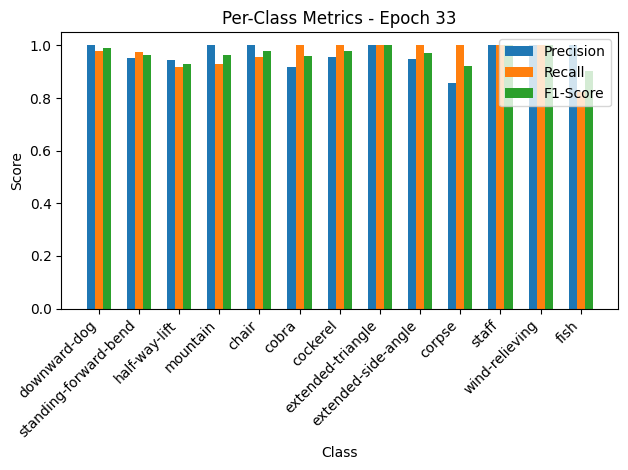


Epoch 34/50 Summary:
Train Loss: 0.0371 | Train Acc: 98.70% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.2026 | Val Acc: 96.64% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 35/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:08<00:00,  9.12it/s, loss=0.0413, accuracy=98.2]


Per-Class Metrics for Epoch 34:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.99
mountain: Precision=0.96, Recall=0.97, F1-Score=0.97
chair: Precision=0.98, Recall=0.98, F1-Score=0.98
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-side-angle: Precision=0.99, Recall=0.97, F1-Score=0.98
corpse: Precision=0.99, Recall=0.96, F1-Score=0.97
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.96, Recall=0.99, F1-Score=0.97


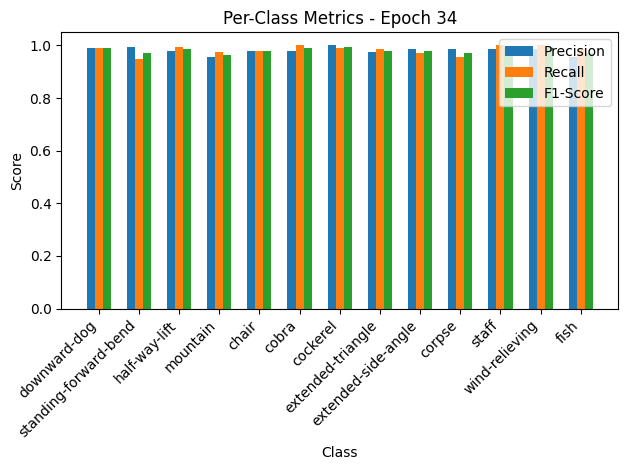

Validation: 100%|██████████| 21/21 [00:00<00:00, 26.62it/s, loss=0.189, accuracy=96.9]


Per-Class Metrics for Epoch 34:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.98, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.92, F1-Score=0.93
mountain: Precision=1.00, Recall=0.93, F1-Score=0.96
chair: Precision=0.96, Recall=0.96, F1-Score=0.96
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.90, Recall=1.00, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.88, F1-Score=0.94


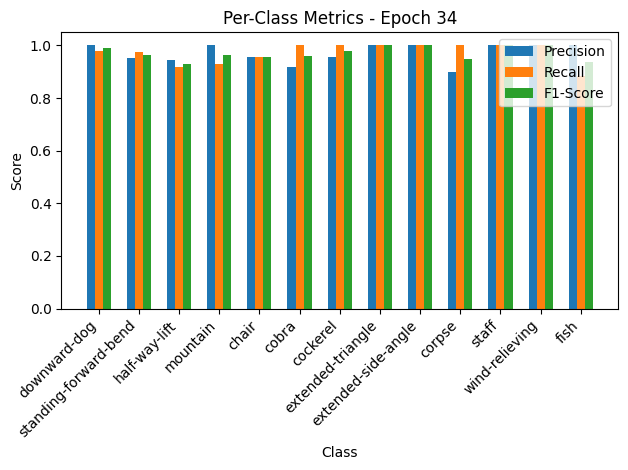


Epoch 35/50 Summary:
Train Loss: 0.0414 | Train Acc: 98.17% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1938 | Val Acc: 96.94% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 36/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:10<00:00,  7.97it/s, loss=0.0545, accuracy=97.9]


Per-Class Metrics for Epoch 35:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=0.99, Recall=0.98, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.93, Recall=0.93, F1-Score=0.93
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.93, Recall=0.93, F1-Score=0.93


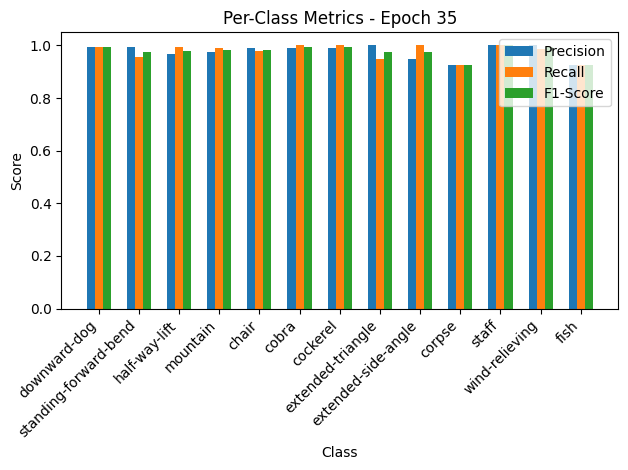

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.27it/s, loss=0.186, accuracy=96.6]


Per-Class Metrics for Epoch 35:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.98, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.92, F1-Score=0.93
mountain: Precision=1.00, Recall=0.93, F1-Score=0.96
chair: Precision=0.96, Recall=0.96, F1-Score=0.96
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.86, Recall=1.00, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.82, F1-Score=0.90


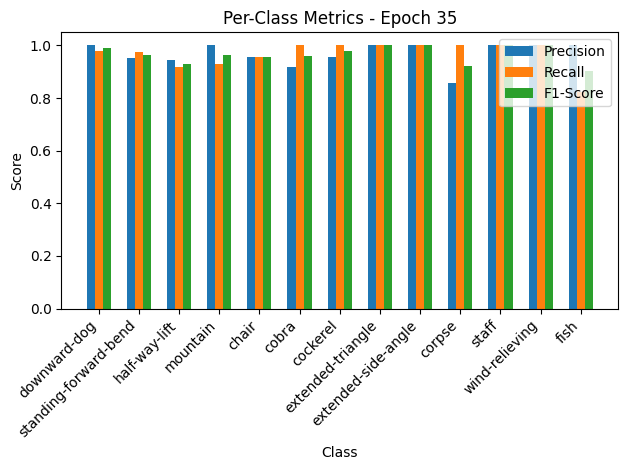


Epoch 36/50 Summary:
Train Loss: 0.0546 | Train Acc: 97.94% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1913 | Val Acc: 96.64% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 37/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:10<00:00,  7.70it/s, loss=0.0392, accuracy=98.5]


Per-Class Metrics for Epoch 36:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.98, Recall=0.98, F1-Score=0.98
mountain: Precision=0.97, Recall=1.00, F1-Score=0.98
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.99, Recall=0.96, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.96, Recall=0.99, F1-Score=0.97


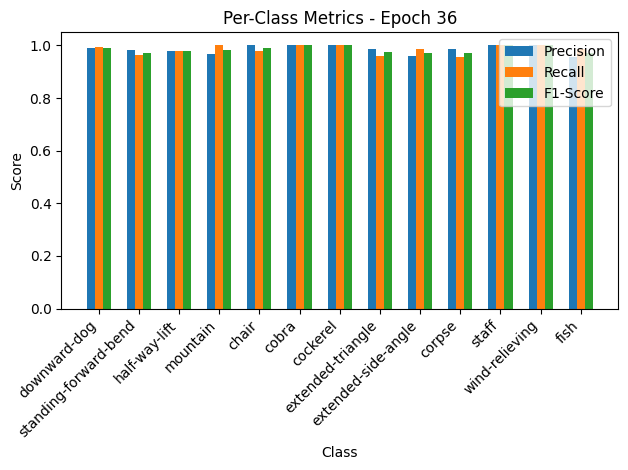

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.12it/s, loss=0.191, accuracy=96.6]


Per-Class Metrics for Epoch 36:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.98, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.92, F1-Score=0.93
mountain: Precision=1.00, Recall=0.93, F1-Score=0.96
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.86, Recall=1.00, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.82, F1-Score=0.90


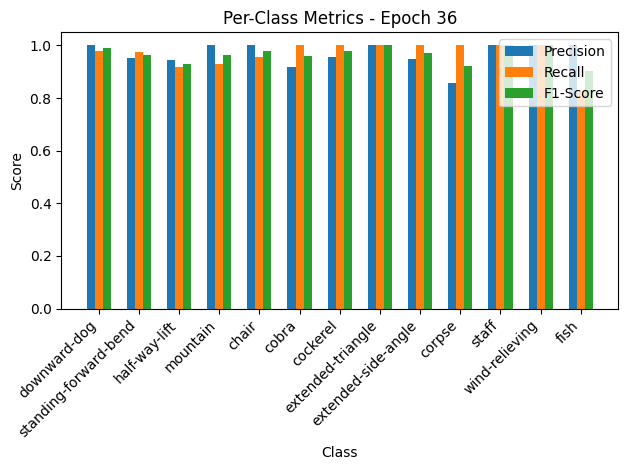


Epoch 37/50 Summary:
Train Loss: 0.0392 | Train Acc: 98.47% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1966 | Val Acc: 96.64% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 38/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:09<00:00,  8.72it/s, loss=0.0457, accuracy=98.7]


Per-Class Metrics for Epoch 37:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.96, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=1.00, F1-Score=0.99
mountain: Precision=0.97, Recall=1.00, F1-Score=0.98
chair: Precision=1.00, Recall=0.99, F1-Score=0.99
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.97, Recall=0.93, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.97, F1-Score=0.95


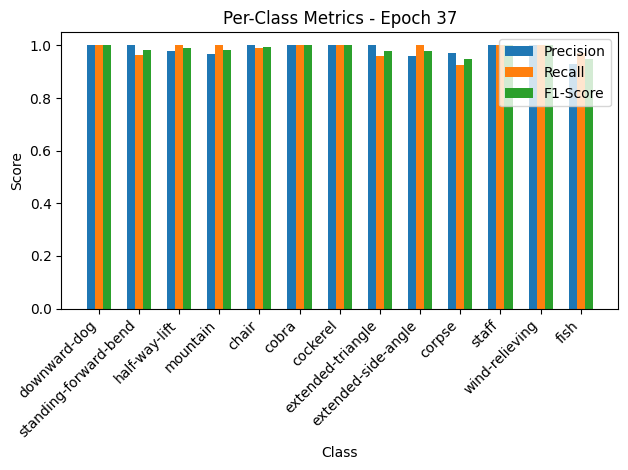

Validation: 100%|██████████| 21/21 [00:00<00:00, 23.20it/s, loss=0.187, accuracy=96.9]


Per-Class Metrics for Epoch 37:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.98, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.92, F1-Score=0.93
mountain: Precision=1.00, Recall=0.93, F1-Score=0.96
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.90, Recall=1.00, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.88, F1-Score=0.94


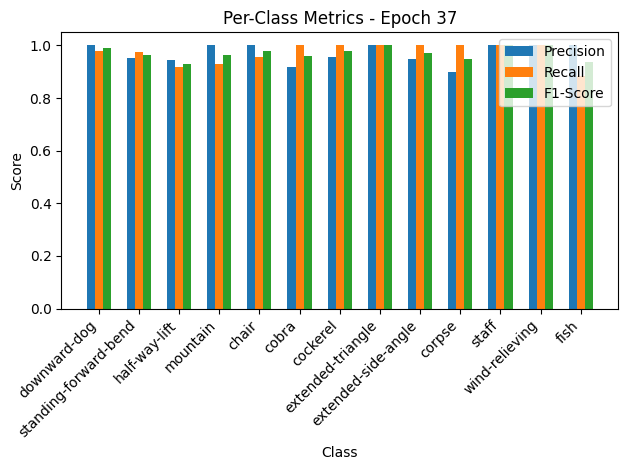


Epoch 38/50 Summary:
Train Loss: 0.0458 | Train Acc: 98.70% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1920 | Val Acc: 96.94% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 39/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:09<00:00,  8.72it/s, loss=0.0415, accuracy=98.5]


Per-Class Metrics for Epoch 38:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.99
mountain: Precision=0.97, Recall=1.00, F1-Score=0.98
chair: Precision=0.99, Recall=0.99, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.96, Recall=0.94, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.96, F1-Score=0.95


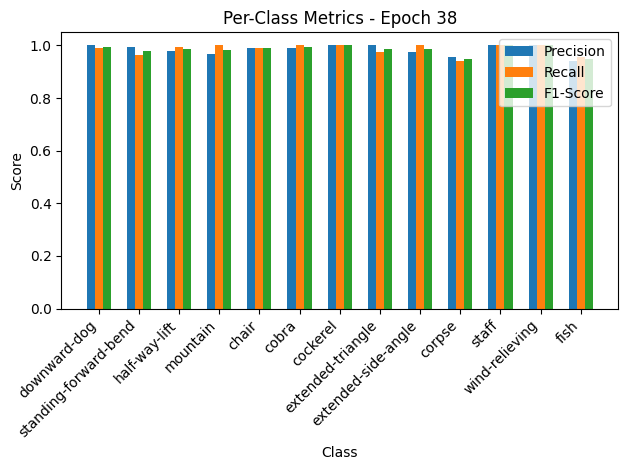

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.91it/s, loss=0.191, accuracy=96.9]


Per-Class Metrics for Epoch 38:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.98, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.92, F1-Score=0.93
mountain: Precision=1.00, Recall=0.93, F1-Score=0.96
chair: Precision=0.96, Recall=0.96, F1-Score=0.96
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.90, Recall=1.00, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.88, F1-Score=0.94


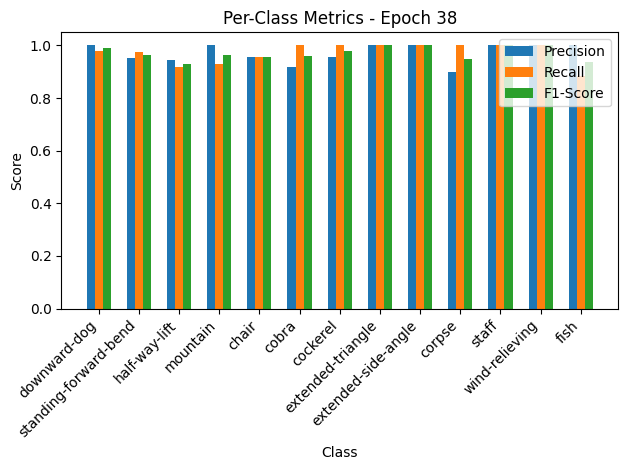


Epoch 39/50 Summary:
Train Loss: 0.0415 | Train Acc: 98.55% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1960 | Val Acc: 96.94% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 40/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:09<00:00,  8.34it/s, loss=0.0456, accuracy=98.3]


Per-Class Metrics for Epoch 39:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=1.00, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.99
mountain: Precision=0.97, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.94, Recall=0.94, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.94, Recall=0.93, F1-Score=0.93


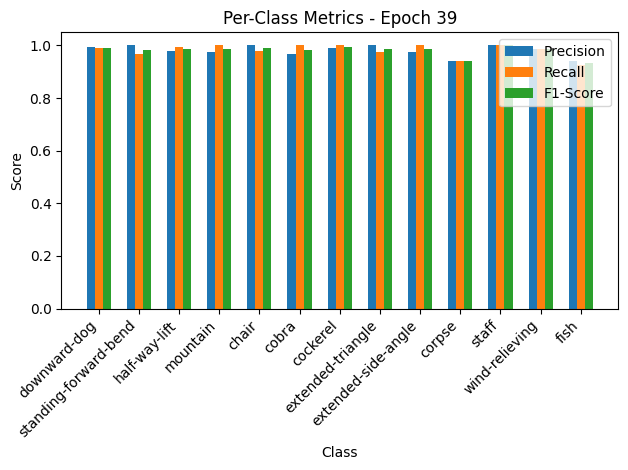

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.32it/s, loss=0.197, accuracy=96.6]


Per-Class Metrics for Epoch 39:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.98, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.92, F1-Score=0.93
mountain: Precision=1.00, Recall=0.93, F1-Score=0.96
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.86, Recall=1.00, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.82, F1-Score=0.90


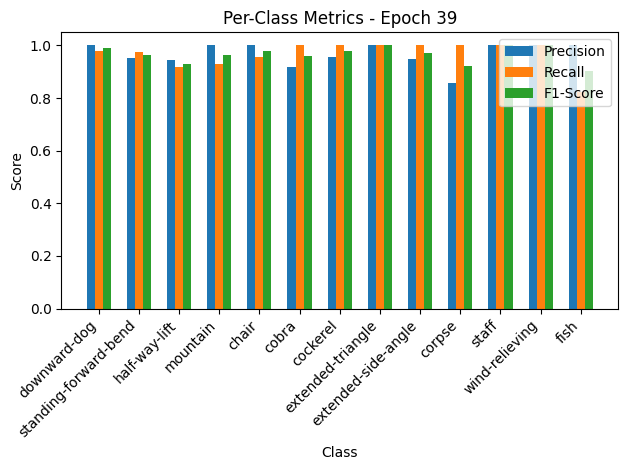


Epoch 40/50 Summary:
Train Loss: 0.0457 | Train Acc: 98.32% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.2020 | Val Acc: 96.64% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 41/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:09<00:00,  8.76it/s, loss=0.0475, accuracy=98.3]


Per-Class Metrics for Epoch 40:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=0.99, Recall=0.98, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.94, Recall=0.96, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.96, Recall=0.94, F1-Score=0.95


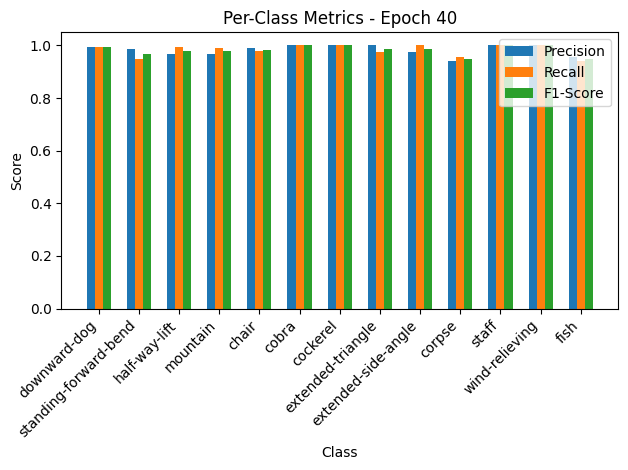

Validation: 100%|██████████| 21/21 [00:00<00:00, 26.49it/s, loss=0.188, accuracy=96.6]


Per-Class Metrics for Epoch 40:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.98, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.92, F1-Score=0.93
mountain: Precision=1.00, Recall=0.93, F1-Score=0.96
chair: Precision=0.96, Recall=0.96, F1-Score=0.96
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.86, Recall=1.00, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.82, F1-Score=0.90


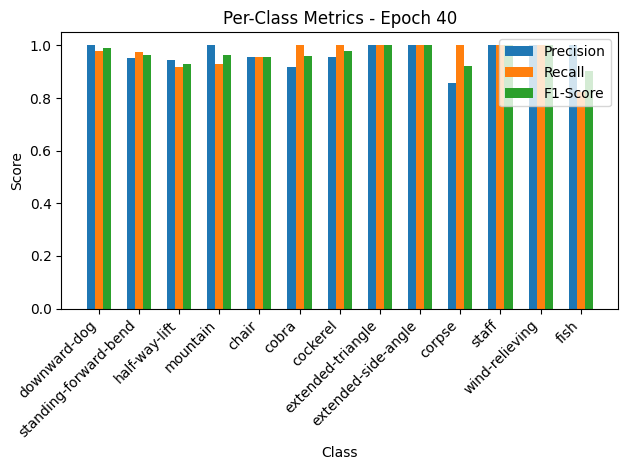


Epoch 41/50 Summary:
Train Loss: 0.0475 | Train Acc: 98.32% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1928 | Val Acc: 96.64% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 42/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:09<00:00,  8.60it/s, loss=0.0509, accuracy=98.2]


Per-Class Metrics for Epoch 41:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.98, F1-Score=0.97
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.98, Recall=0.90, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.91, Recall=0.99, F1-Score=0.94


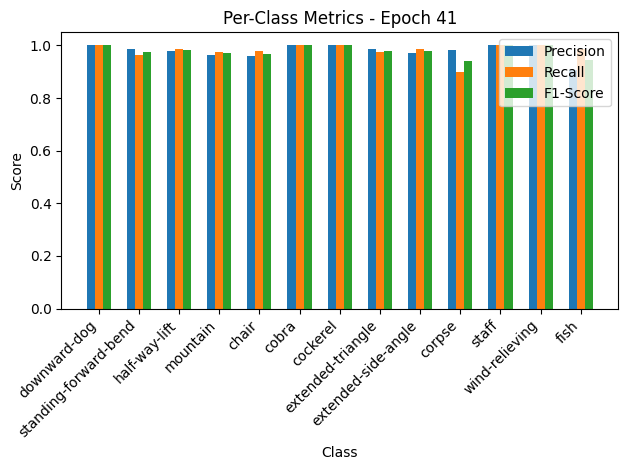

Validation: 100%|██████████| 21/21 [00:00<00:00, 30.67it/s, loss=0.187, accuracy=96.9]


Per-Class Metrics for Epoch 41:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.98, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.92, F1-Score=0.93
mountain: Precision=1.00, Recall=0.93, F1-Score=0.96
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.90, Recall=1.00, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.88, F1-Score=0.94


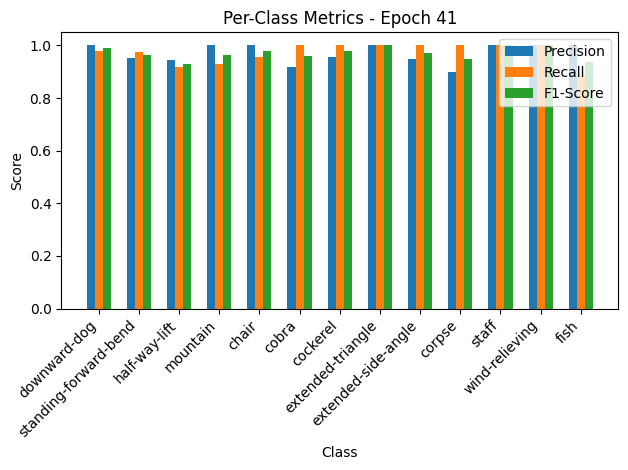


Epoch 42/50 Summary:
Train Loss: 0.0510 | Train Acc: 98.17% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1921 | Val Acc: 96.94% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 43/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:11<00:00,  7.42it/s, loss=0.0486, accuracy=98.4]


Per-Class Metrics for Epoch 42:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=0.99, Recall=0.98, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.93, Recall=0.97, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.93, F1-Score=0.95


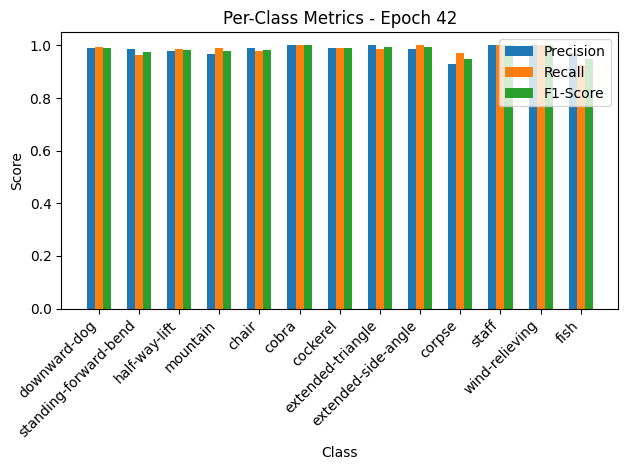

Validation: 100%|██████████| 21/21 [00:00<00:00, 30.24it/s, loss=0.184, accuracy=96.9]


Per-Class Metrics for Epoch 42:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.98, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.92, F1-Score=0.93
mountain: Precision=1.00, Recall=0.93, F1-Score=0.96
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.90, Recall=1.00, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.88, F1-Score=0.94


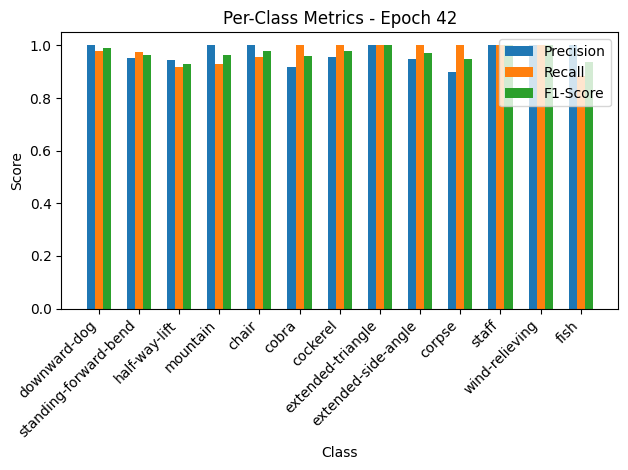


Epoch 43/50 Summary:
Train Loss: 0.0487 | Train Acc: 98.40% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1890 | Val Acc: 96.94% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 44/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:09<00:00,  8.68it/s, loss=0.0636, accuracy=98.3]


Per-Class Metrics for Epoch 43:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.97, Recall=0.99, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.94, F1-Score=0.96
staff: Precision=0.98, Recall=0.98, F1-Score=0.98
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.97, F1-Score=0.96


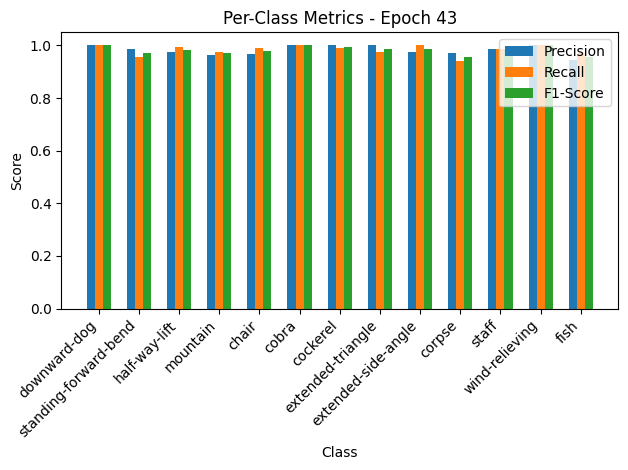

Validation: 100%|██████████| 21/21 [00:00<00:00, 24.27it/s, loss=0.189, accuracy=96.6]


Per-Class Metrics for Epoch 43:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.98, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.92, F1-Score=0.93
mountain: Precision=1.00, Recall=0.93, F1-Score=0.96
chair: Precision=0.96, Recall=0.96, F1-Score=0.96
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.86, Recall=1.00, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.82, F1-Score=0.90


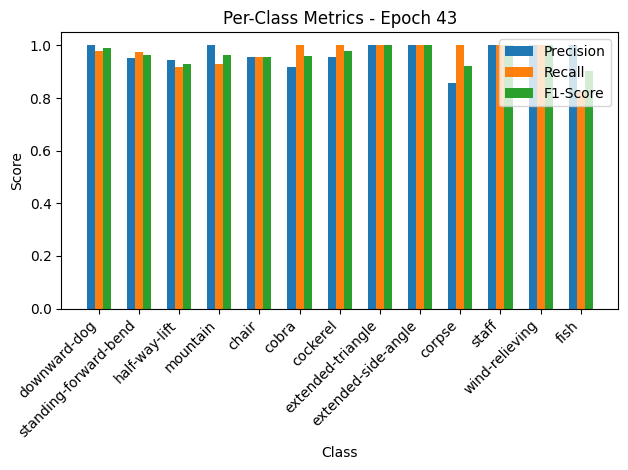


Epoch 44/50 Summary:
Train Loss: 0.0637 | Train Acc: 98.32% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1941 | Val Acc: 96.64% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 45/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:08<00:00,  9.26it/s, loss=0.0522, accuracy=98.5]


Per-Class Metrics for Epoch 44:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.99, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.97, Recall=0.97, F1-Score=0.97
corpse: Precision=0.98, Recall=0.94, F1-Score=0.96
staff: Precision=1.00, Recall=0.98, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.99, F1-Score=0.96


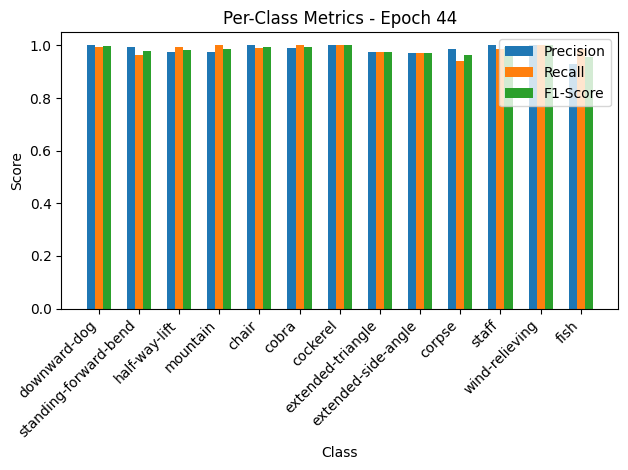

Validation: 100%|██████████| 21/21 [00:00<00:00, 24.06it/s, loss=0.179, accuracy=96.9]


Per-Class Metrics for Epoch 44:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.98, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.92, F1-Score=0.93
mountain: Precision=1.00, Recall=0.93, F1-Score=0.96
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.90, Recall=1.00, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.88, F1-Score=0.94


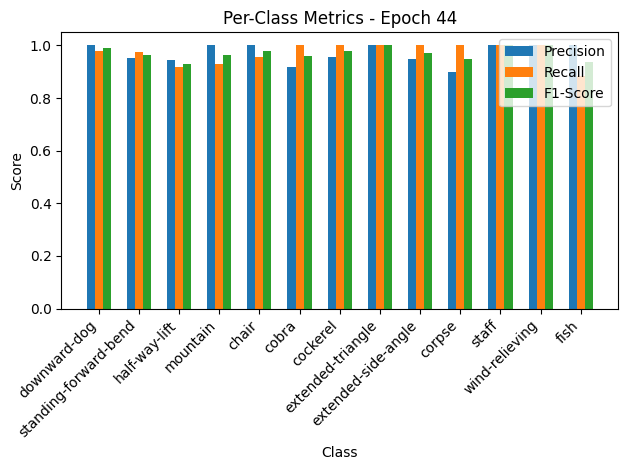


Epoch 45/50 Summary:
Train Loss: 0.0522 | Train Acc: 98.55% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1841 | Val Acc: 96.94% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 46/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:09<00:00,  8.21it/s, loss=0.0321, accuracy=99]


Per-Class Metrics for Epoch 45:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.99
mountain: Precision=0.97, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.99, F1-Score=0.99
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.99, Recall=0.96, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.96, Recall=0.99, F1-Score=0.97


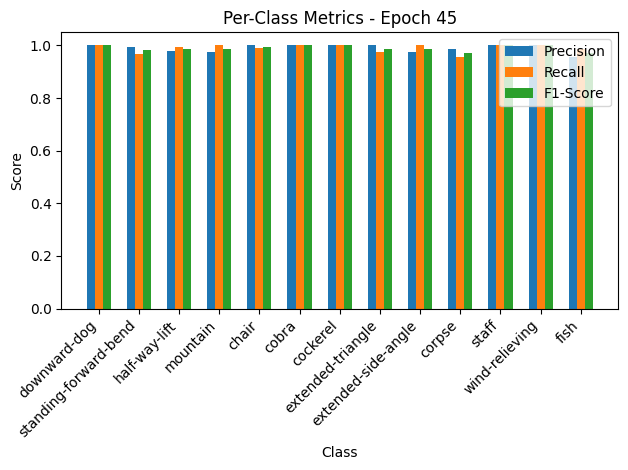

Validation: 100%|██████████| 21/21 [00:00<00:00, 30.44it/s, loss=0.181, accuracy=96.6]


Per-Class Metrics for Epoch 45:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.98, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.92, F1-Score=0.93
mountain: Precision=1.00, Recall=0.93, F1-Score=0.96
chair: Precision=0.96, Recall=0.96, F1-Score=0.96
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.89, Recall=0.94, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.88, F1-Score=0.91


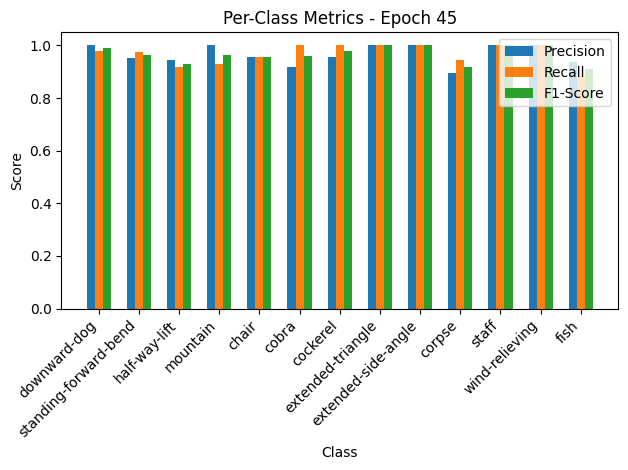


Epoch 46/50 Summary:
Train Loss: 0.0321 | Train Acc: 99.01% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1861 | Val Acc: 96.64% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 47/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:09<00:00,  8.65it/s, loss=0.0489, accuracy=98.4]


Per-Class Metrics for Epoch 46:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.97, F1-Score=0.97
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.99
mountain: Precision=0.97, Recall=0.98, F1-Score=0.98
chair: Precision=0.99, Recall=0.98, F1-Score=0.98
cobra: Precision=1.00, Recall=0.99, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.94, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.94, Recall=0.97, F1-Score=0.96


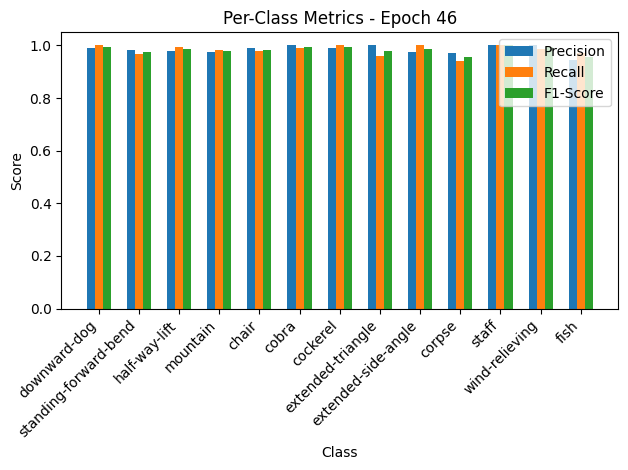

Validation: 100%|██████████| 21/21 [00:00<00:00, 26.26it/s, loss=0.191, accuracy=96.9]


Per-Class Metrics for Epoch 46:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.98, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.92, F1-Score=0.93
mountain: Precision=1.00, Recall=0.93, F1-Score=0.96
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.90, Recall=1.00, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.88, F1-Score=0.94


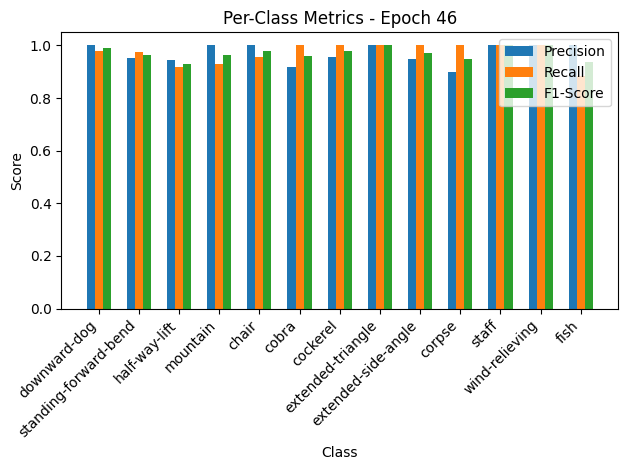


Epoch 47/50 Summary:
Train Loss: 0.0490 | Train Acc: 98.40% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1960 | Val Acc: 96.94% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 48/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:08<00:00,  9.56it/s, loss=0.0454, accuracy=98.5]


Per-Class Metrics for Epoch 47:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=0.99, Recall=0.97, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=0.98, Recall=0.91, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.92, Recall=0.99, F1-Score=0.95


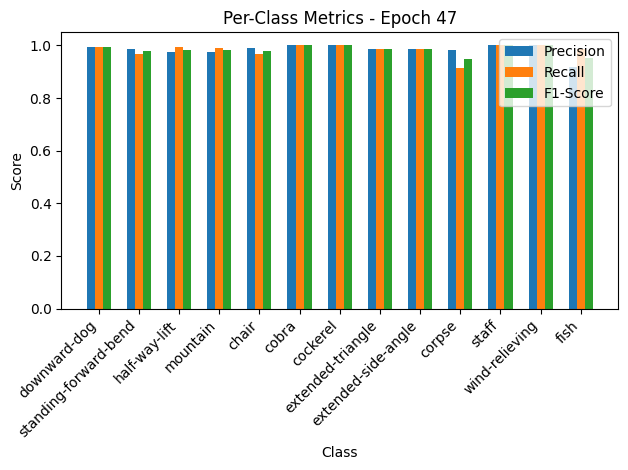

Validation: 100%|██████████| 21/21 [00:00<00:00, 25.14it/s, loss=0.182, accuracy=96.9]


Per-Class Metrics for Epoch 47:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.98, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.92, F1-Score=0.93
mountain: Precision=1.00, Recall=0.93, F1-Score=0.96
chair: Precision=0.96, Recall=0.96, F1-Score=0.96
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.90, Recall=1.00, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.88, F1-Score=0.94


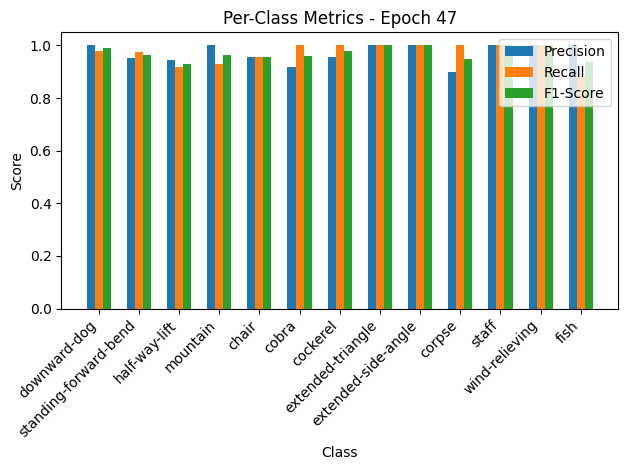


Epoch 48/50 Summary:
Train Loss: 0.0455 | Train Acc: 98.47% | Train Precision: 0.99 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1869 | Val Acc: 96.94% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 49/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:10<00:00,  8.17it/s, loss=0.0577, accuracy=98.4]


Per-Class Metrics for Epoch 48:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.98
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=0.99, Recall=0.98, F1-Score=0.98
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.97, Recall=0.96, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.96, Recall=0.97, F1-Score=0.96


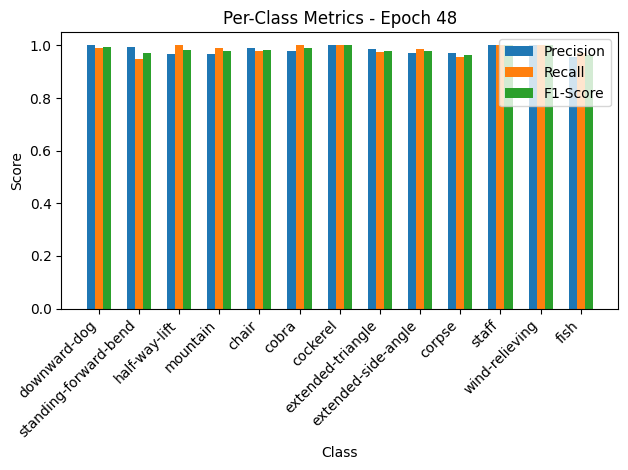

Validation: 100%|██████████| 21/21 [00:00<00:00, 26.82it/s, loss=0.184, accuracy=96.9]


Per-Class Metrics for Epoch 48:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.98, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.92, F1-Score=0.93
mountain: Precision=1.00, Recall=0.93, F1-Score=0.96
chair: Precision=0.96, Recall=0.96, F1-Score=0.96
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.90, Recall=1.00, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.88, F1-Score=0.94


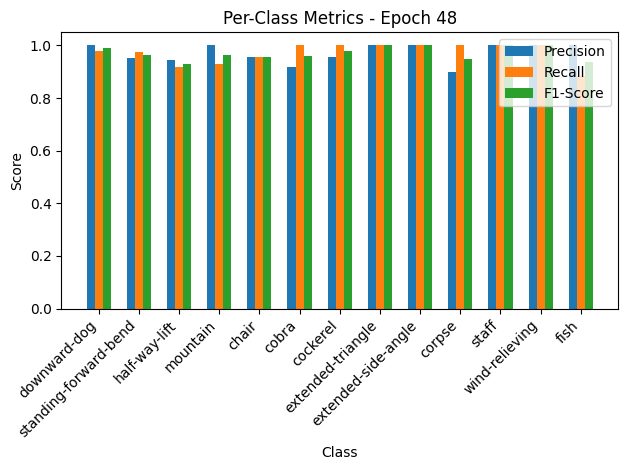


Epoch 49/50 Summary:
Train Loss: 0.0578 | Train Acc: 98.40% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1890 | Val Acc: 96.94% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 50/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:09<00:00,  8.58it/s, loss=0.0501, accuracy=98]


Per-Class Metrics for Epoch 49:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=1.00, F1-Score=0.98
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=0.93, Recall=0.90, F1-Score=0.91
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.90, Recall=0.91, F1-Score=0.91


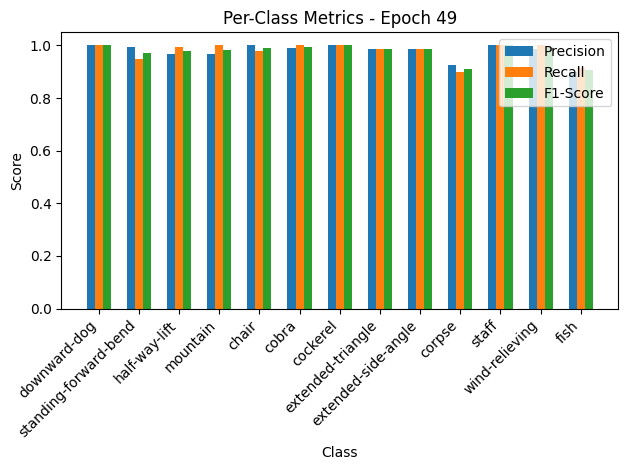

Validation: 100%|██████████| 21/21 [00:00<00:00, 23.31it/s, loss=0.19, accuracy=96.6]


Per-Class Metrics for Epoch 49:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.98, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.92, F1-Score=0.93
mountain: Precision=1.00, Recall=0.93, F1-Score=0.96
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.86, Recall=1.00, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.82, F1-Score=0.90


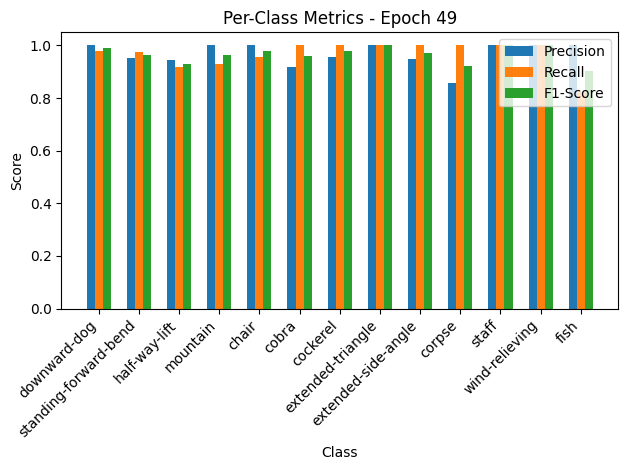


Epoch 50/50 Summary:
Train Loss: 0.0501 | Train Acc: 98.02% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1956 | Val Acc: 96.64% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97


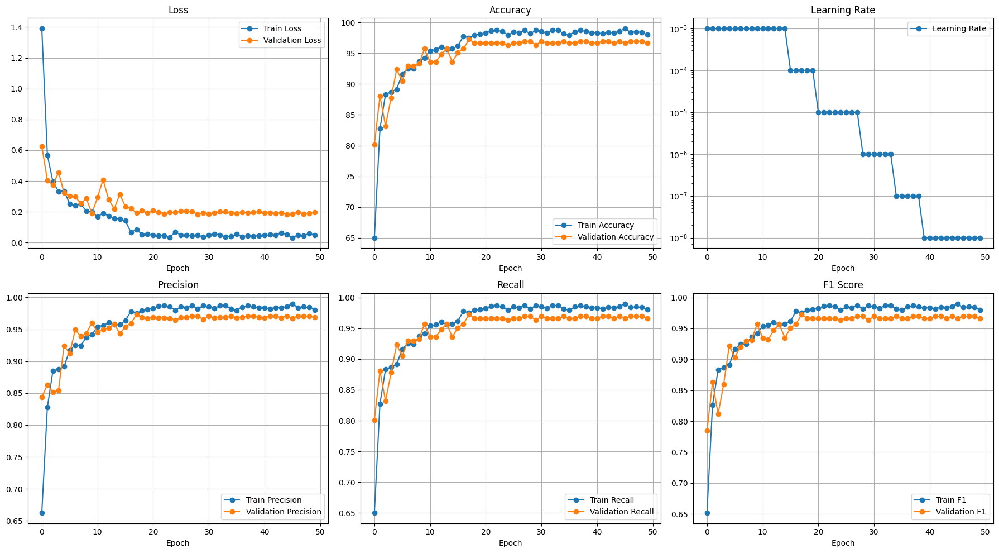

Fold 5/5

Class Distribution Analysis:
--------------------------------------------------
Class 0: 245 samples (13.48%)
Class 1: 225 samples (12.38%)
Class 2: 209 samples (11.50%)
Class 3: 165 samples (9.08%)
Class 4: 140 samples (7.70%)
Class 5: 129 samples (7.10%)
Class 6: 120 samples (6.60%)
Class 7: 108 samples (5.94%)
Class 8: 101 samples (5.56%)
Class 9: 95 samples (5.23%)
Class 10: 94 samples (5.17%)
Class 11: 94 samples (5.17%)
Class 12: 93 samples (5.12%)

Imbalance Statistics:
Imbalance Ratio (max/min): 2.63
Maximum class size: 245
Minimum class size: 93
Average class size: 139.85
Class weights aligned with indices: tensor([0.5117, 0.5567, 0.5988, 0.7568, 0.8908, 0.9663, 1.0383, 1.1529, 1.2324,
        1.3099, 1.3237, 1.3237, 1.3379])
Using device: cuda

Epoch 1/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.90it/s, loss=1.57, accuracy=64.3]


Per-Class Metrics for Epoch 0:
downward-dog: Precision=0.84, Recall=0.74, F1-Score=0.79
standing-forward-bend: Precision=0.78, Recall=0.58, F1-Score=0.67
half-way-lift: Precision=0.82, Recall=0.81, F1-Score=0.81
mountain: Precision=0.70, Recall=0.72, F1-Score=0.71
chair: Precision=0.58, Recall=0.55, F1-Score=0.57
cobra: Precision=0.67, Recall=0.78, F1-Score=0.72
cockerel: Precision=0.40, Recall=0.69, F1-Score=0.51
extended-triangle: Precision=0.56, Recall=0.51, F1-Score=0.53
extended-side-angle: Precision=0.45, Recall=0.47, F1-Score=0.46
corpse: Precision=0.35, Recall=0.37, F1-Score=0.36
staff: Precision=0.73, Recall=0.70, F1-Score=0.71
wind-relieving: Precision=0.83, Recall=0.70, F1-Score=0.76
fish: Precision=0.42, Recall=0.43, F1-Score=0.43


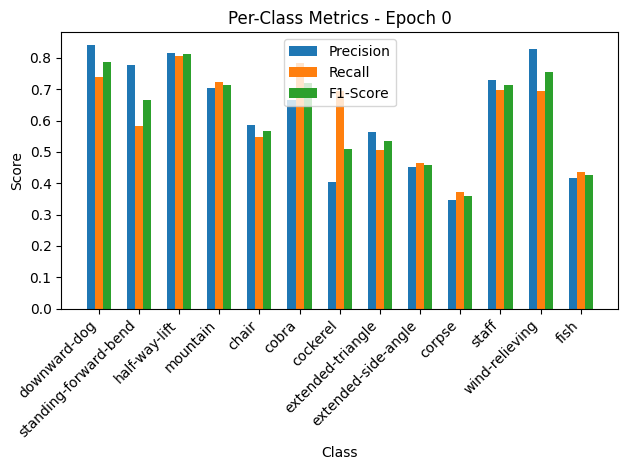

Validation: 100%|██████████| 21/21 [00:00<00:00, 24.53it/s, loss=0.605, accuracy=75.2]


Per-Class Metrics for Epoch 0:
downward-dog: Precision=0.68, Recall=1.00, F1-Score=0.81
standing-forward-bend: Precision=0.87, Recall=0.63, F1-Score=0.73
half-way-lift: Precision=0.82, Recall=0.86, F1-Score=0.84
mountain: Precision=0.75, Recall=0.93, F1-Score=0.83
chair: Precision=0.86, Recall=0.83, F1-Score=0.84
cobra: Precision=1.00, Recall=0.17, F1-Score=0.30
cockerel: Precision=1.00, Recall=0.74, F1-Score=0.85
extended-triangle: Precision=1.00, Recall=0.37, F1-Score=0.54
extended-side-angle: Precision=0.58, Recall=0.95, F1-Score=0.72
corpse: Precision=1.00, Recall=0.06, F1-Score=0.11
staff: Precision=0.70, Recall=1.00, F1-Score=0.82
wind-relieving: Precision=0.94, Recall=0.94, F1-Score=0.94
fish: Precision=0.53, Recall=1.00, F1-Score=0.69


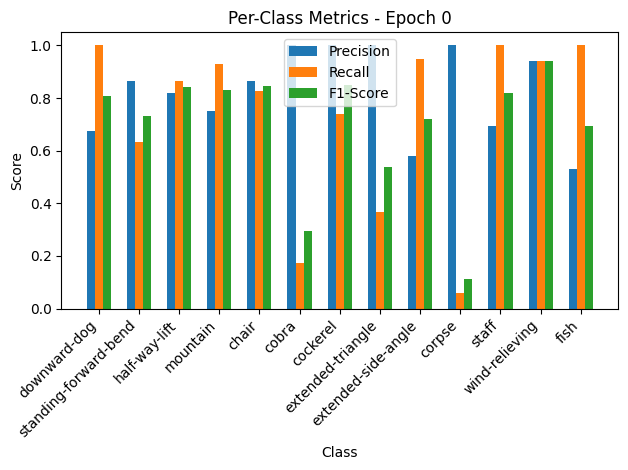


Epoch 1/50 Summary:
Train Loss: 1.5759 | Train Acc: 64.27% | Train Precision: 0.66 | Train Recall: 0.64 | Train F1: 0.65
Val Loss: 0.6221 | Val Acc: 75.23% | Val Precision: 0.82 | Val Recall: 0.75 | Val F1: 0.72
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model.pth
Checkpoint saved at epoch 1
New best model saved! Validation Loss: 0.6221

Epoch 2/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.64it/s, loss=0.602, accuracy=80.7]


Per-Class Metrics for Epoch 1:
downward-dog: Precision=0.93, Recall=0.85, F1-Score=0.89
standing-forward-bend: Precision=0.86, Recall=0.75, F1-Score=0.80
half-way-lift: Precision=0.81, Recall=0.89, F1-Score=0.85
mountain: Precision=0.86, Recall=0.88, F1-Score=0.87
chair: Precision=0.76, Recall=0.82, F1-Score=0.79
cobra: Precision=0.78, Recall=0.86, F1-Score=0.82
cockerel: Precision=0.94, Recall=0.89, F1-Score=0.91
extended-triangle: Precision=0.75, Recall=0.77, F1-Score=0.76
extended-side-angle: Precision=0.77, Recall=0.74, F1-Score=0.76
corpse: Precision=0.51, Recall=0.56, F1-Score=0.53
staff: Precision=0.88, Recall=0.91, F1-Score=0.90
wind-relieving: Precision=0.84, Recall=0.90, F1-Score=0.87
fish: Precision=0.56, Recall=0.51, F1-Score=0.53


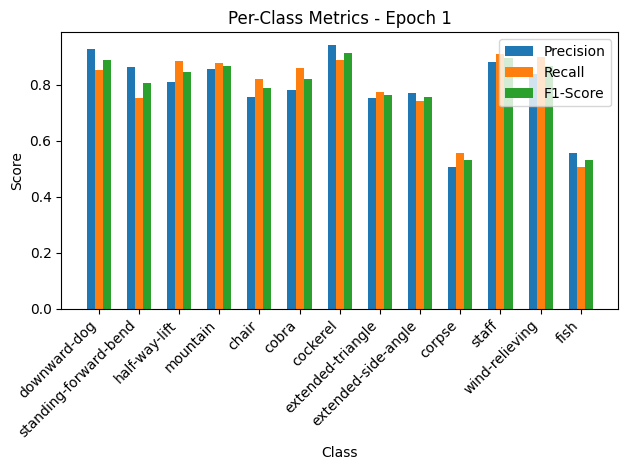

Validation: 100%|██████████| 21/21 [00:00<00:00, 31.29it/s, loss=0.368, accuracy=85.6]


Per-Class Metrics for Epoch 1:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.85, Recall=0.83, F1-Score=0.84
half-way-lift: Precision=0.78, Recall=0.84, F1-Score=0.81
mountain: Precision=0.88, Recall=1.00, F1-Score=0.94
chair: Precision=1.00, Recall=0.83, F1-Score=0.90
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.42, F1-Score=0.59
extended-side-angle: Precision=0.64, Recall=0.95, F1-Score=0.77
corpse: Precision=0.80, Recall=0.24, F1-Score=0.36
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.82, F1-Score=0.90
fish: Precision=0.52, Recall=1.00, F1-Score=0.68


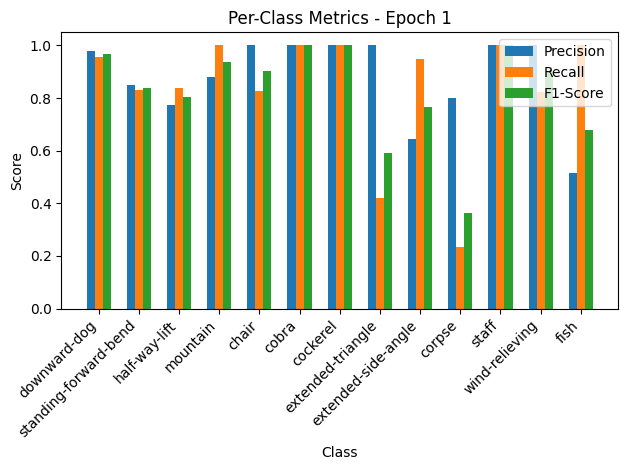


Epoch 2/50 Summary:
Train Loss: 0.6026 | Train Acc: 80.69% | Train Precision: 0.81 | Train Recall: 0.81 | Train F1: 0.81
Val Loss: 0.3781 | Val Acc: 85.63% | Val Precision: 0.89 | Val Recall: 0.86 | Val F1: 0.85
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model.pth
Checkpoint saved at epoch 2
New best model saved! Validation Loss: 0.3781

Epoch 3/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.76it/s, loss=0.406, accuracy=87.1]


Per-Class Metrics for Epoch 2:
downward-dog: Precision=0.96, Recall=0.92, F1-Score=0.94
standing-forward-bend: Precision=0.86, Recall=0.85, F1-Score=0.86
half-way-lift: Precision=0.85, Recall=0.88, F1-Score=0.86
mountain: Precision=0.90, Recall=0.91, F1-Score=0.91
chair: Precision=0.93, Recall=0.86, F1-Score=0.90
cobra: Precision=0.92, Recall=0.93, F1-Score=0.93
cockerel: Precision=0.90, Recall=0.98, F1-Score=0.93
extended-triangle: Precision=0.80, Recall=0.81, F1-Score=0.81
extended-side-angle: Precision=0.77, Recall=0.75, F1-Score=0.76
corpse: Precision=0.71, Recall=0.67, F1-Score=0.69
staff: Precision=0.90, Recall=0.95, F1-Score=0.93
wind-relieving: Precision=0.92, Recall=0.87, F1-Score=0.90
fish: Precision=0.75, Recall=0.80, F1-Score=0.77


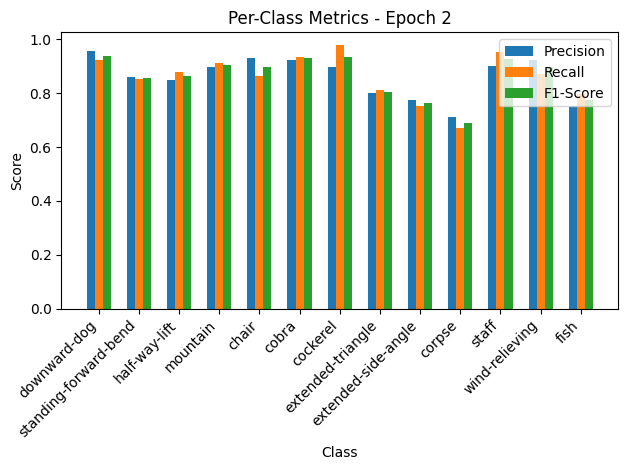

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.61it/s, loss=0.382, accuracy=87.2]


Per-Class Metrics for Epoch 2:
downward-dog: Precision=1.00, Recall=0.89, F1-Score=0.94
standing-forward-bend: Precision=1.00, Recall=0.56, F1-Score=0.72
half-way-lift: Precision=0.80, Recall=1.00, F1-Score=0.89
mountain: Precision=0.87, Recall=0.90, F1-Score=0.88
chair: Precision=0.61, Recall=0.96, F1-Score=0.75
cobra: Precision=0.85, Recall=1.00, F1-Score=0.92
cockerel: Precision=0.95, Recall=0.91, F1-Score=0.93
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.94, Recall=0.79, F1-Score=0.86
corpse: Precision=1.00, Recall=0.65, F1-Score=0.79
staff: Precision=0.94, Recall=0.94, F1-Score=0.94
wind-relieving: Precision=0.85, Recall=1.00, F1-Score=0.92
fish: Precision=0.76, Recall=0.94, F1-Score=0.84


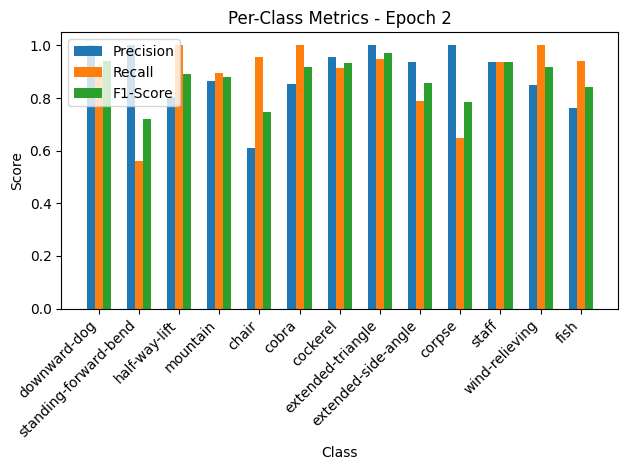


Epoch 3/50 Summary:
Train Loss: 0.4065 | Train Acc: 87.10% | Train Precision: 0.87 | Train Recall: 0.87 | Train F1: 0.87
Val Loss: 0.3923 | Val Acc: 87.16% | Val Precision: 0.90 | Val Recall: 0.87 | Val F1: 0.87

Epoch 4/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  8.08it/s, loss=0.362, accuracy=88.5]


Per-Class Metrics for Epoch 3:
downward-dog: Precision=0.94, Recall=0.92, F1-Score=0.93
standing-forward-bend: Precision=0.92, Recall=0.83, F1-Score=0.88
half-way-lift: Precision=0.87, Recall=0.93, F1-Score=0.90
mountain: Precision=0.91, Recall=0.95, F1-Score=0.93
chair: Precision=0.90, Recall=0.85, F1-Score=0.88
cobra: Precision=0.89, Recall=0.93, F1-Score=0.91
cockerel: Precision=0.92, Recall=0.97, F1-Score=0.94
extended-triangle: Precision=0.85, Recall=0.92, F1-Score=0.88
extended-side-angle: Precision=0.85, Recall=0.78, F1-Score=0.81
corpse: Precision=0.73, Recall=0.74, F1-Score=0.74
staff: Precision=0.91, Recall=0.94, F1-Score=0.93
wind-relieving: Precision=0.93, Recall=0.93, F1-Score=0.93
fish: Precision=0.74, Recall=0.70, F1-Score=0.72


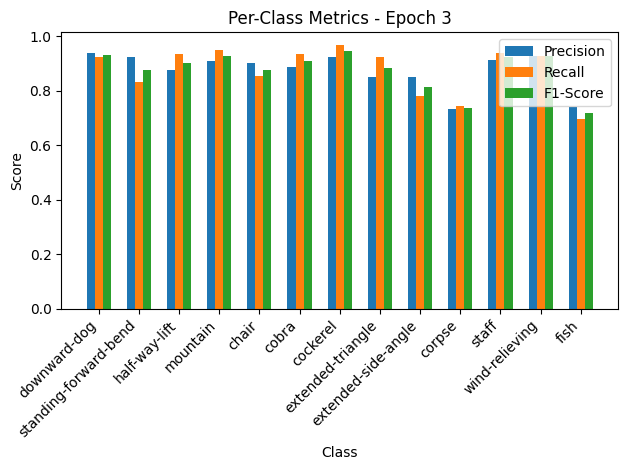

Validation: 100%|██████████| 21/21 [00:00<00:00, 27.79it/s, loss=0.224, accuracy=91.4]


Per-Class Metrics for Epoch 3:
downward-dog: Precision=0.96, Recall=1.00, F1-Score=0.98
standing-forward-bend: Precision=0.80, Recall=0.95, F1-Score=0.87
half-way-lift: Precision=0.97, Recall=0.78, F1-Score=0.87
mountain: Precision=0.96, Recall=0.79, F1-Score=0.87
chair: Precision=0.78, Recall=0.91, F1-Score=0.84
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=1.00, F1-Score=0.97
extended-side-angle: Precision=1.00, Recall=0.84, F1-Score=0.91
corpse: Precision=0.76, Recall=0.94, F1-Score=0.84
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.94, Recall=1.00, F1-Score=0.97
fish: Precision=0.92, Recall=0.71, F1-Score=0.80


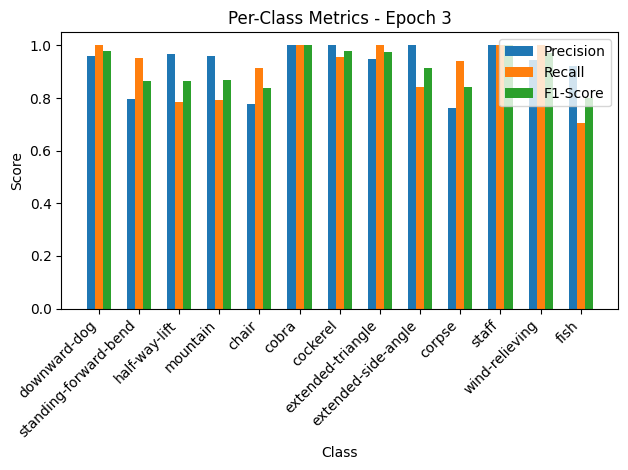


Epoch 4/50 Summary:
Train Loss: 0.3627 | Train Acc: 88.55% | Train Precision: 0.89 | Train Recall: 0.89 | Train F1: 0.88
Val Loss: 0.2305 | Val Acc: 91.44% | Val Precision: 0.92 | Val Recall: 0.91 | Val F1: 0.91
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model.pth
Checkpoint saved at epoch 4
New best model saved! Validation Loss: 0.2305

Epoch 5/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.78it/s, loss=0.34, accuracy=89.6]


Per-Class Metrics for Epoch 4:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.87, Recall=0.84, F1-Score=0.85
half-way-lift: Precision=0.84, Recall=0.87, F1-Score=0.85
mountain: Precision=0.92, Recall=0.95, F1-Score=0.93
chair: Precision=0.91, Recall=0.88, F1-Score=0.90
cobra: Precision=0.94, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-triangle: Precision=0.90, Recall=0.94, F1-Score=0.92
extended-side-angle: Precision=0.90, Recall=0.89, F1-Score=0.90
corpse: Precision=0.72, Recall=0.66, F1-Score=0.69
staff: Precision=0.96, Recall=0.97, F1-Score=0.96
wind-relieving: Precision=0.96, Recall=0.97, F1-Score=0.96
fish: Precision=0.70, Recall=0.75, F1-Score=0.73


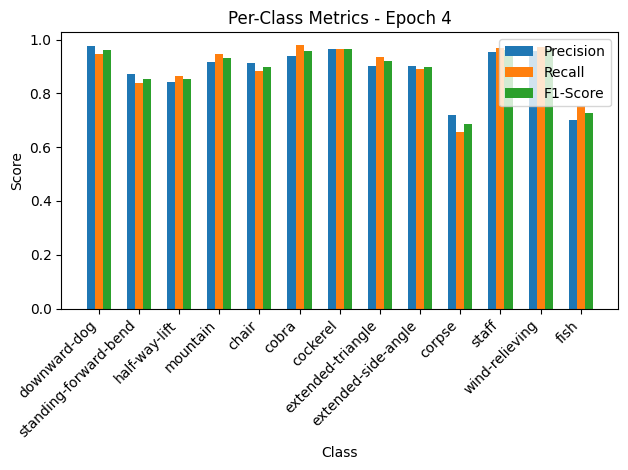

Validation: 100%|██████████| 21/21 [00:00<00:00, 27.94it/s, loss=0.343, accuracy=89.6]


Per-Class Metrics for Epoch 4:
downward-dog: Precision=0.96, Recall=0.98, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.90, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.91, Recall=1.00, F1-Score=0.95
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.92, Recall=0.96, F1-Score=0.94
cockerel: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=0.95, F1-Score=0.95
extended-side-angle: Precision=0.94, Recall=0.84, F1-Score=0.89
corpse: Precision=0.44, Recall=0.94, F1-Score=0.60
staff: Precision=0.94, Recall=1.00, F1-Score=0.97
wind-relieving: Precision=1.00, Recall=0.53, F1-Score=0.69
fish: Precision=0.86, Recall=0.35, F1-Score=0.50


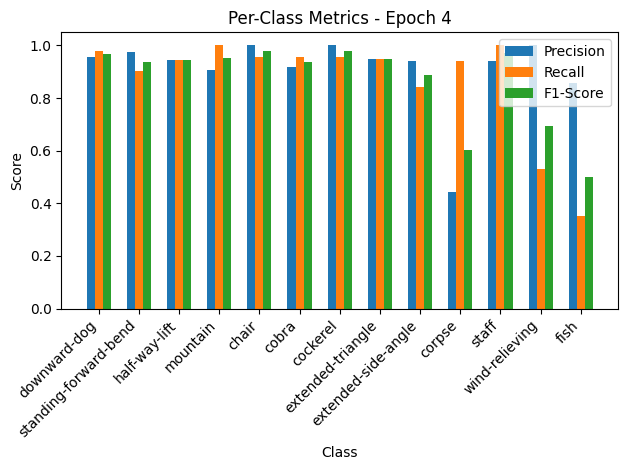


Epoch 5/50 Summary:
Train Loss: 0.3403 | Train Acc: 89.62% | Train Precision: 0.90 | Train Recall: 0.90 | Train F1: 0.90
Val Loss: 0.3527 | Val Acc: 89.60% | Val Precision: 0.92 | Val Recall: 0.90 | Val F1: 0.90

Epoch 6/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.39it/s, loss=0.298, accuracy=90.8]


Per-Class Metrics for Epoch 5:
downward-dog: Precision=0.96, Recall=0.95, F1-Score=0.95
standing-forward-bend: Precision=0.91, Recall=0.89, F1-Score=0.90
half-way-lift: Precision=0.90, Recall=0.87, F1-Score=0.89
mountain: Precision=0.95, Recall=0.97, F1-Score=0.96
chair: Precision=0.94, Recall=0.95, F1-Score=0.94
cobra: Precision=0.88, Recall=0.92, F1-Score=0.90
cockerel: Precision=0.92, Recall=0.92, F1-Score=0.92
extended-triangle: Precision=0.94, Recall=0.94, F1-Score=0.94
extended-side-angle: Precision=0.90, Recall=0.89, F1-Score=0.90
corpse: Precision=0.74, Recall=0.80, F1-Score=0.77
staff: Precision=0.94, Recall=1.00, F1-Score=0.97
wind-relieving: Precision=0.99, Recall=0.96, F1-Score=0.97
fish: Precision=0.76, Recall=0.70, F1-Score=0.73


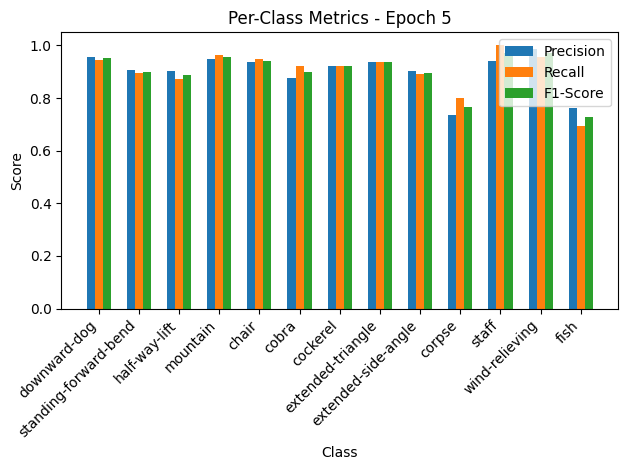

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.63it/s, loss=0.215, accuracy=92]


Per-Class Metrics for Epoch 5:
downward-dog: Precision=1.00, Recall=0.93, F1-Score=0.97
standing-forward-bend: Precision=1.00, Recall=0.76, F1-Score=0.86
half-way-lift: Precision=0.82, Recall=1.00, F1-Score=0.90
mountain: Precision=0.91, Recall=1.00, F1-Score=0.95
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.85, Recall=1.00, F1-Score=0.92
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.79, F1-Score=0.88
extended-side-angle: Precision=0.82, Recall=0.95, F1-Score=0.88
corpse: Precision=1.00, Recall=0.59, F1-Score=0.74
staff: Precision=0.94, Recall=1.00, F1-Score=0.97
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.74, Recall=1.00, F1-Score=0.85


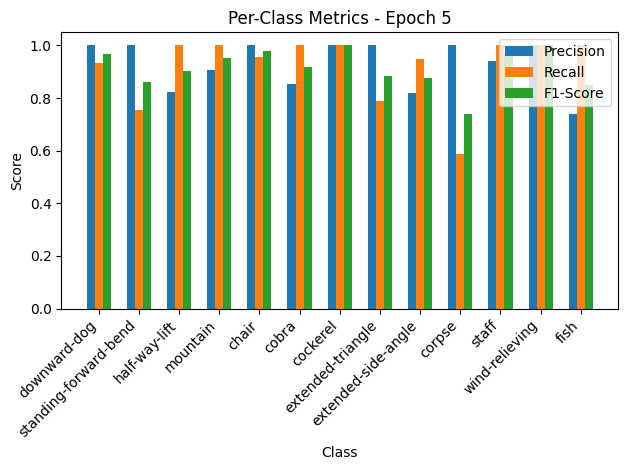


Epoch 6/50 Summary:
Train Loss: 0.2981 | Train Acc: 90.84% | Train Precision: 0.91 | Train Recall: 0.91 | Train F1: 0.91
Val Loss: 0.2211 | Val Acc: 92.05% | Val Precision: 0.93 | Val Recall: 0.92 | Val F1: 0.92
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model.pth
Checkpoint saved at epoch 6
New best model saved! Validation Loss: 0.2211

Epoch 7/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.79it/s, loss=0.285, accuracy=91.8]


Per-Class Metrics for Epoch 6:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.94, Recall=0.86, F1-Score=0.90
half-way-lift: Precision=0.90, Recall=0.93, F1-Score=0.91
mountain: Precision=0.87, Recall=0.96, F1-Score=0.91
chair: Precision=0.93, Recall=0.89, F1-Score=0.91
cobra: Precision=0.98, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-triangle: Precision=0.89, Recall=0.89, F1-Score=0.89
extended-side-angle: Precision=0.88, Recall=0.86, F1-Score=0.87
corpse: Precision=0.81, Recall=0.77, F1-Score=0.79
staff: Precision=0.96, Recall=0.98, F1-Score=0.97
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.79, Recall=0.83, F1-Score=0.81


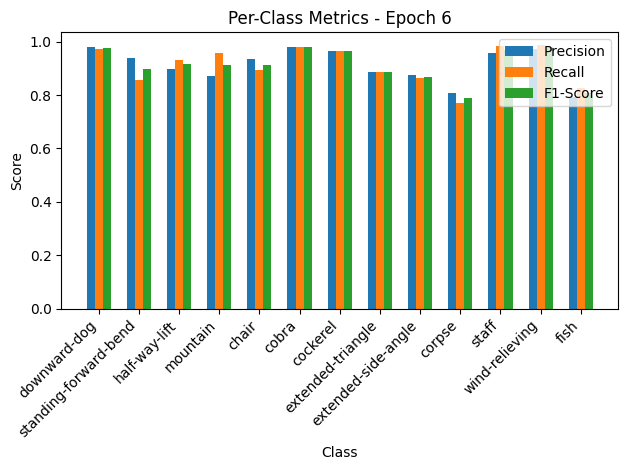

Validation: 100%|██████████| 21/21 [00:00<00:00, 22.49it/s, loss=0.361, accuracy=89.6]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 6:
downward-dog: Precision=0.98, Recall=1.00, F1-Score=0.99
standing-forward-bend: Precision=1.00, Recall=0.80, F1-Score=0.89
half-way-lift: Precision=0.90, Recall=1.00, F1-Score=0.95
mountain: Precision=0.83, Recall=1.00, F1-Score=0.91
chair: Precision=1.00, Recall=0.91, F1-Score=0.95
cobra: Precision=0.85, Recall=1.00, F1-Score=0.92
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.94, Recall=0.79, F1-Score=0.86
corpse: Precision=0.49, Recall=1.00, F1-Score=0.65
staff: Precision=1.00, Recall=0.94, F1-Score=0.97
wind-relieving: Precision=1.00, Recall=0.94, F1-Score=0.97
fish: Precision=0.00, Recall=0.00, F1-Score=0.00


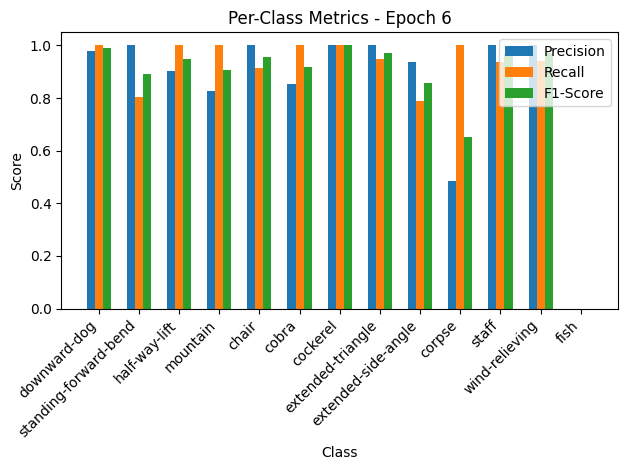


Epoch 7/50 Summary:
Train Loss: 0.2851 | Train Acc: 91.83% | Train Precision: 0.92 | Train Recall: 0.92 | Train F1: 0.92
Val Loss: 0.3711 | Val Acc: 89.60% | Val Precision: 0.88 | Val Recall: 0.90 | Val F1: 0.88

Epoch 8/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.44it/s, loss=0.243, accuracy=93.3]


Per-Class Metrics for Epoch 7:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.95, Recall=0.89, F1-Score=0.92
half-way-lift: Precision=0.93, Recall=0.94, F1-Score=0.93
mountain: Precision=0.94, Recall=0.95, F1-Score=0.94
chair: Precision=0.96, Recall=0.95, F1-Score=0.95
cobra: Precision=0.93, Recall=0.97, F1-Score=0.95
cockerel: Precision=0.98, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.95, F1-Score=0.96
extended-side-angle: Precision=0.95, Recall=0.97, F1-Score=0.96
corpse: Precision=0.77, Recall=0.73, F1-Score=0.75
staff: Precision=0.96, Recall=1.00, F1-Score=0.98
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.72, Recall=0.75, F1-Score=0.74


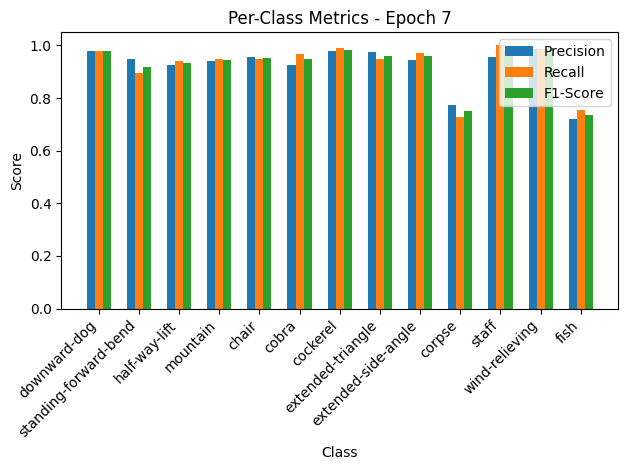

Validation: 100%|██████████| 21/21 [00:00<00:00, 24.92it/s, loss=0.114, accuracy=96]


Per-Class Metrics for Epoch 7:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.90, F1-Score=0.95
half-way-lift: Precision=0.95, Recall=1.00, F1-Score=0.97
mountain: Precision=0.91, Recall=1.00, F1-Score=0.95
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=0.91, F1-Score=0.95
extended-triangle: Precision=0.95, Recall=1.00, F1-Score=0.97
extended-side-angle: Precision=1.00, Recall=0.89, F1-Score=0.94
corpse: Precision=0.88, Recall=0.88, F1-Score=0.88
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.85, Recall=1.00, F1-Score=0.92
fish: Precision=0.88, Recall=0.88, F1-Score=0.88


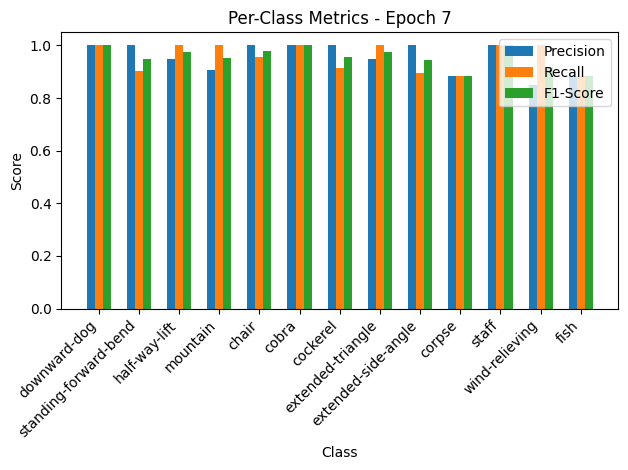


Epoch 8/50 Summary:
Train Loss: 0.2432 | Train Acc: 93.28% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.1174 | Val Acc: 96.02% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model.pth
Checkpoint saved at epoch 8
New best model saved! Validation Loss: 0.1174

Epoch 9/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.70it/s, loss=0.242, accuracy=93.4]


Per-Class Metrics for Epoch 8:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.96, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.91, Recall=0.95, F1-Score=0.93
mountain: Precision=0.92, Recall=0.94, F1-Score=0.93
chair: Precision=0.97, Recall=0.95, F1-Score=0.96
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.97, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=0.91, Recall=0.89, F1-Score=0.90
extended-side-angle: Precision=0.91, Recall=0.93, F1-Score=0.92
corpse: Precision=0.78, Recall=0.77, F1-Score=0.78
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.77, Recall=0.80, F1-Score=0.79


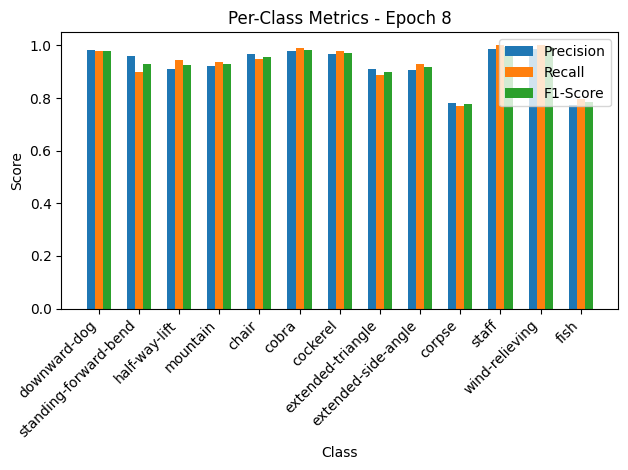

Validation: 100%|██████████| 21/21 [00:00<00:00, 27.47it/s, loss=0.133, accuracy=96]


Per-Class Metrics for Epoch 8:
downward-dog: Precision=1.00, Recall=0.93, F1-Score=0.97
standing-forward-bend: Precision=1.00, Recall=0.93, F1-Score=0.96
half-way-lift: Precision=0.95, Recall=1.00, F1-Score=0.97
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=0.96, Recall=0.96, F1-Score=0.96
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.92, Recall=1.00, F1-Score=0.96
extended-triangle: Precision=1.00, Recall=0.89, F1-Score=0.94
extended-side-angle: Precision=0.90, Recall=0.95, F1-Score=0.92
corpse: Precision=0.94, Recall=0.94, F1-Score=0.94
staff: Precision=1.00, Recall=0.94, F1-Score=0.97
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.94, F1-Score=0.94


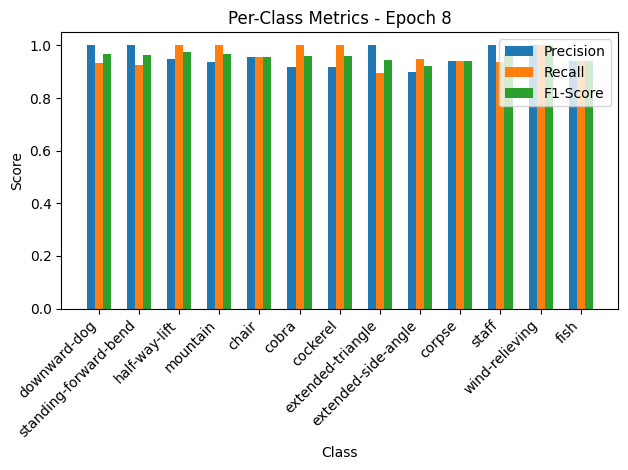


Epoch 9/50 Summary:
Train Loss: 0.2426 | Train Acc: 93.36% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.1362 | Val Acc: 96.02% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 10/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.97it/s, loss=0.218, accuracy=94]


Per-Class Metrics for Epoch 9:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.90, Recall=0.92, F1-Score=0.91
mountain: Precision=0.95, Recall=0.95, F1-Score=0.95
chair: Precision=0.94, Recall=0.96, F1-Score=0.95
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.91, Recall=0.94, F1-Score=0.93
extended-side-angle: Precision=0.90, Recall=0.90, F1-Score=0.90
corpse: Precision=0.85, Recall=0.83, F1-Score=0.84
staff: Precision=1.00, Recall=0.97, F1-Score=0.98
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.84, Recall=0.84, F1-Score=0.84


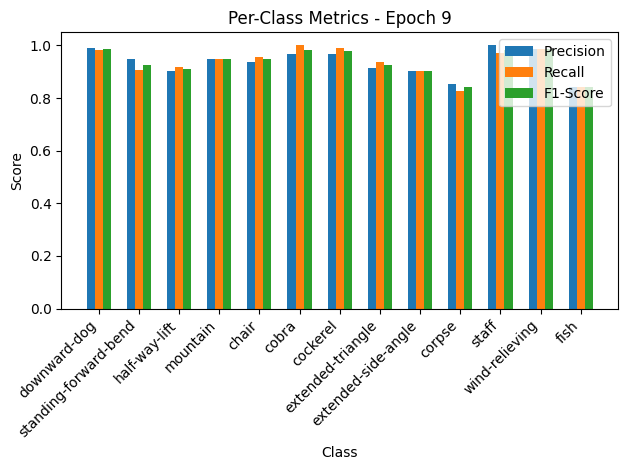

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.52it/s, loss=0.129, accuracy=95.1]


Per-Class Metrics for Epoch 9:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.93, F1-Score=0.95
half-way-lift: Precision=0.97, Recall=0.95, F1-Score=0.96
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.96, Recall=0.96, F1-Score=0.96
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.95, Recall=0.95, F1-Score=0.95
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=0.82, Recall=0.82, F1-Score=0.82
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.83, Recall=0.88, F1-Score=0.86


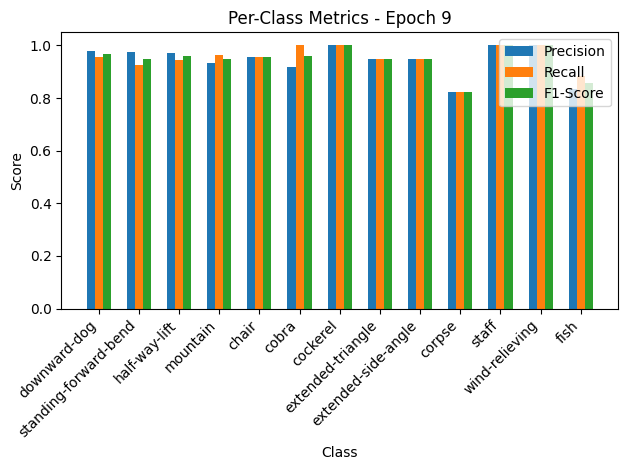


Epoch 10/50 Summary:
Train Loss: 0.2188 | Train Acc: 93.97% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.1325 | Val Acc: 95.11% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 11/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.97it/s, loss=0.167, accuracy=94.8]


Per-Class Metrics for Epoch 10:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.95, Recall=0.92, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.96, F1-Score=0.95
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.96, F1-Score=0.96
cobra: Precision=0.94, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.98, Recall=0.98, F1-Score=0.98
extended-triangle: Precision=0.96, Recall=0.95, F1-Score=0.96
extended-side-angle: Precision=0.92, Recall=0.93, F1-Score=0.93
corpse: Precision=0.86, Recall=0.81, F1-Score=0.84
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.81, Recall=0.87, F1-Score=0.84


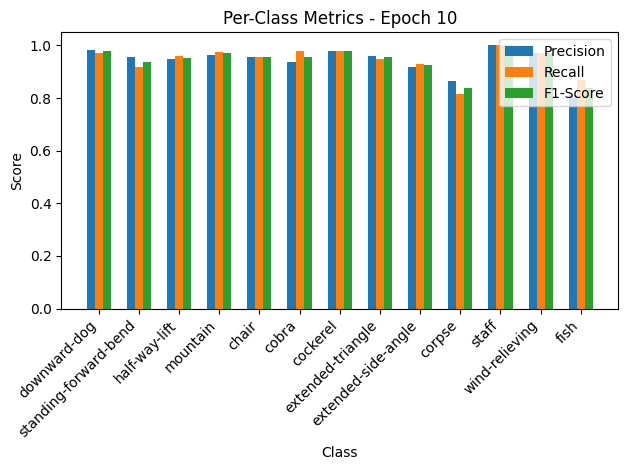

Validation: 100%|██████████| 21/21 [00:00<00:00, 30.14it/s, loss=0.149, accuracy=95.4]


Per-Class Metrics for Epoch 10:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=1.00, Recall=0.80, F1-Score=0.89
half-way-lift: Precision=0.93, Recall=1.00, F1-Score=0.96
mountain: Precision=0.83, Recall=1.00, F1-Score=0.91
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=1.00, Recall=0.76, F1-Score=0.87
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.81, Recall=1.00, F1-Score=0.89


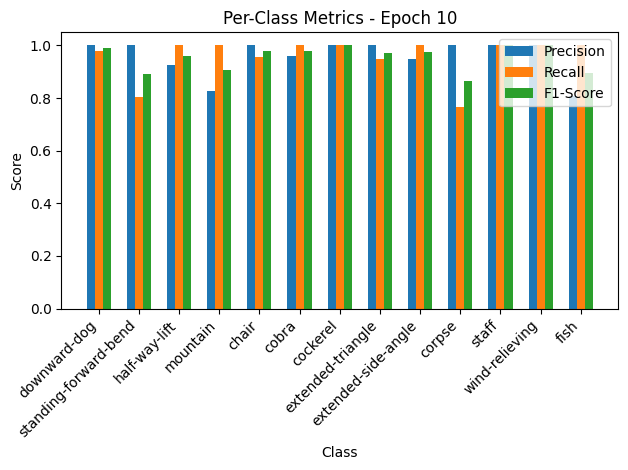


Epoch 11/50 Summary:
Train Loss: 0.1676 | Train Acc: 94.81% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.1527 | Val Acc: 95.41% | Val Precision: 0.96 | Val Recall: 0.95 | Val F1: 0.95

Epoch 12/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.91it/s, loss=0.207, accuracy=94.6]


Per-Class Metrics for Epoch 11:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.96, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.97, F1-Score=0.95
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.98, Recall=0.96, F1-Score=0.97
cobra: Precision=0.96, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.97, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=0.93, Recall=0.95, F1-Score=0.94
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=0.85, Recall=0.83, F1-Score=0.84
staff: Precision=0.94, Recall=0.97, F1-Score=0.96
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.81, Recall=0.84, F1-Score=0.82


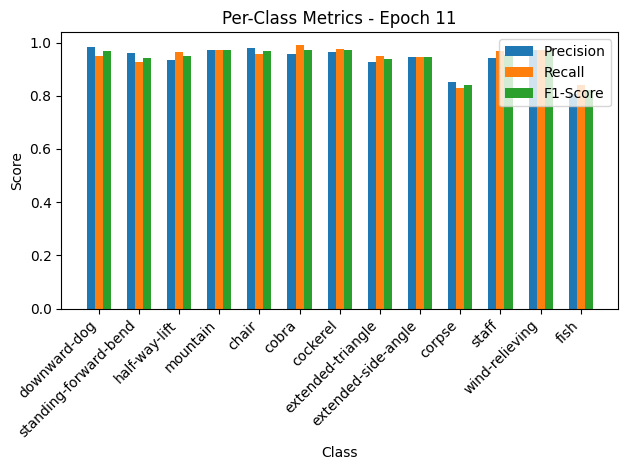

Validation: 100%|██████████| 21/21 [00:00<00:00, 30.40it/s, loss=0.185, accuracy=96]


Per-Class Metrics for Epoch 11:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.88, F1-Score=0.92
half-way-lift: Precision=0.92, Recall=0.97, F1-Score=0.95
mountain: Precision=0.91, Recall=1.00, F1-Score=0.95
chair: Precision=0.96, Recall=0.96, F1-Score=0.96
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=1.00, Recall=0.76, F1-Score=0.87
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.81, Recall=1.00, F1-Score=0.89


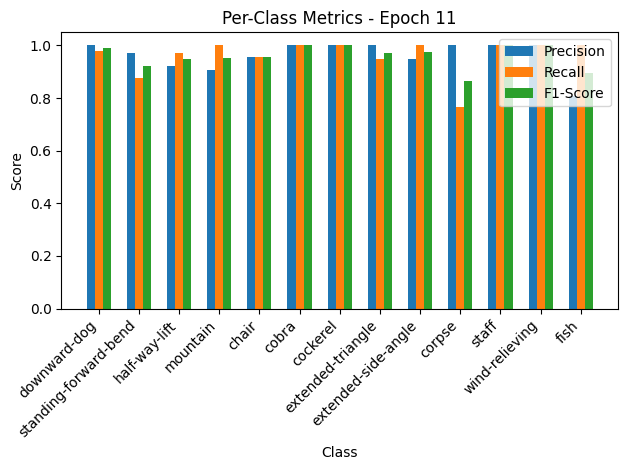


Epoch 12/50 Summary:
Train Loss: 0.2070 | Train Acc: 94.58% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.1900 | Val Acc: 96.02% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 13/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.25it/s, loss=0.163, accuracy=95.1]


Per-Class Metrics for Epoch 12:
downward-dog: Precision=0.97, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.92, Recall=0.91, F1-Score=0.92
half-way-lift: Precision=0.93, Recall=0.93, F1-Score=0.93
mountain: Precision=0.96, Recall=0.98, F1-Score=0.97
chair: Precision=0.97, Recall=0.94, F1-Score=0.95
cobra: Precision=0.97, Recall=0.97, F1-Score=0.97
cockerel: Precision=0.96, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.96, Recall=0.96, F1-Score=0.96
extended-side-angle: Precision=0.97, Recall=0.97, F1-Score=0.97
corpse: Precision=0.91, Recall=0.89, F1-Score=0.90
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.97, Recall=0.96, F1-Score=0.96
fish: Precision=0.89, Recall=0.91, F1-Score=0.90


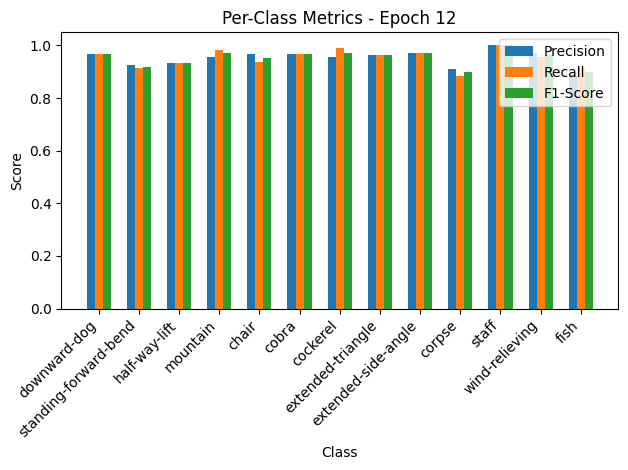

Validation: 100%|██████████| 21/21 [00:00<00:00, 30.90it/s, loss=0.104, accuracy=97.2]


Per-Class Metrics for Epoch 12:
downward-dog: Precision=1.00, Recall=0.93, F1-Score=0.97
standing-forward-bend: Precision=1.00, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.99
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.92, Recall=0.96, F1-Score=0.94
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=1.00, Recall=0.94, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=1.00, F1-Score=0.97


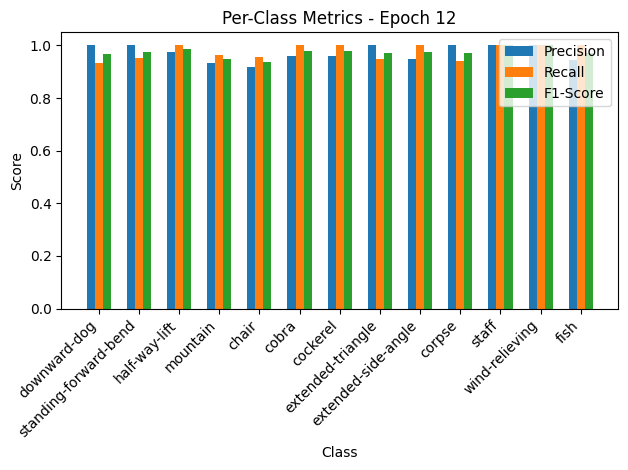


Epoch 13/50 Summary:
Train Loss: 0.1632 | Train Acc: 95.11% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.1070 | Val Acc: 97.25% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model.pth
Checkpoint saved at epoch 13
New best model saved! Validation Loss: 0.1070

Epoch 14/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  9.00it/s, loss=0.151, accuracy=96]


Per-Class Metrics for Epoch 13:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.96, Recall=0.93, F1-Score=0.95
half-way-lift: Precision=0.97, Recall=0.95, F1-Score=0.96
mountain: Precision=0.95, Recall=0.97, F1-Score=0.96
chair: Precision=0.97, Recall=0.96, F1-Score=0.96
cobra: Precision=0.96, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.96, Recall=0.92, F1-Score=0.94
extended-side-angle: Precision=0.91, Recall=0.97, F1-Score=0.94
corpse: Precision=0.95, Recall=0.87, F1-Score=0.91
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.88, Recall=0.96, F1-Score=0.92


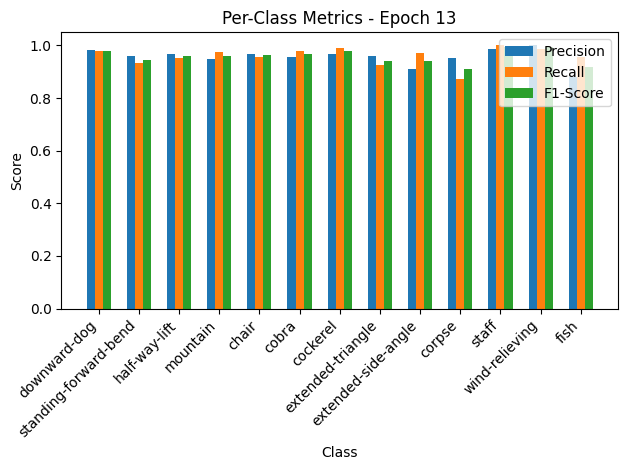

Validation: 100%|██████████| 21/21 [00:00<00:00, 25.01it/s, loss=0.118, accuracy=96.9]


Per-Class Metrics for Epoch 13:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.95, F1-Score=0.96
half-way-lift: Precision=0.97, Recall=0.97, F1-Score=0.97
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.88, Recall=0.96, F1-Score=0.92
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=0.94, Recall=0.94, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.94, F1-Score=0.94


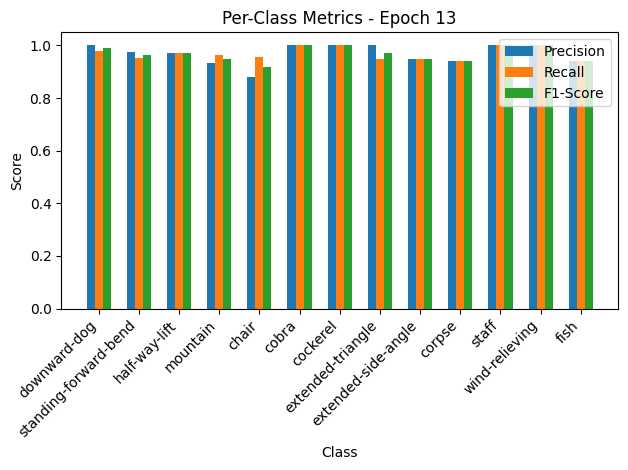


Epoch 14/50 Summary:
Train Loss: 0.1509 | Train Acc: 95.95% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.1210 | Val Acc: 96.94% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 15/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  8.03it/s, loss=0.153, accuracy=95.5]


Per-Class Metrics for Epoch 14:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.94, Recall=0.93, F1-Score=0.93
half-way-lift: Precision=0.94, Recall=0.95, F1-Score=0.94
mountain: Precision=0.94, Recall=0.96, F1-Score=0.95
chair: Precision=0.97, Recall=0.95, F1-Score=0.96
cobra: Precision=0.98, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.95, F1-Score=0.96
extended-side-angle: Precision=0.95, Recall=0.97, F1-Score=0.96
corpse: Precision=0.89, Recall=0.94, F1-Score=0.92
staff: Precision=0.96, Recall=0.97, F1-Score=0.96
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.92, Recall=0.86, F1-Score=0.89


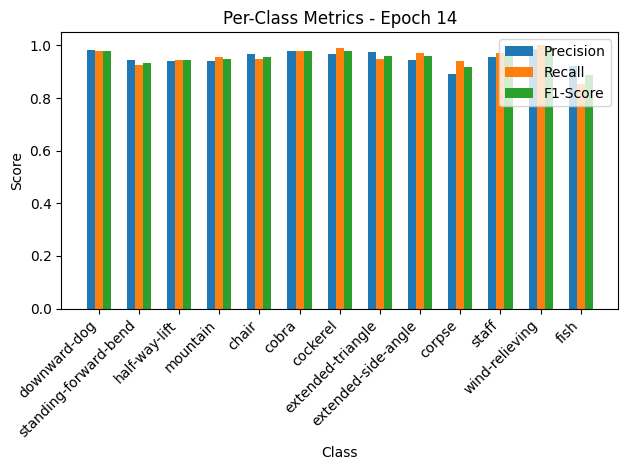

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.32it/s, loss=0.203, accuracy=96]


Per-Class Metrics for Epoch 14:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=1.00, Recall=0.90, F1-Score=0.95
half-way-lift: Precision=0.90, Recall=1.00, F1-Score=0.95
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=1.00, Recall=0.71, F1-Score=0.83
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.74, Recall=1.00, F1-Score=0.85


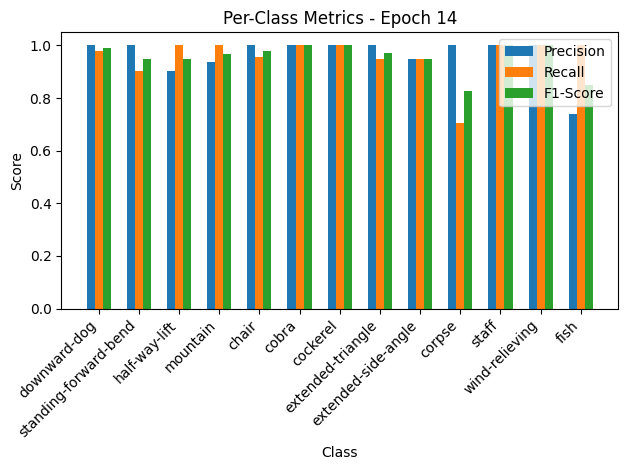


Epoch 15/50 Summary:
Train Loss: 0.1535 | Train Acc: 95.50% | Train Precision: 0.96 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.2081 | Val Acc: 96.02% | Val Precision: 0.97 | Val Recall: 0.96 | Val F1: 0.96

Epoch 16/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.80it/s, loss=0.115, accuracy=96]


Per-Class Metrics for Epoch 15:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.93, Recall=0.92, F1-Score=0.93
half-way-lift: Precision=0.94, Recall=0.94, F1-Score=0.94
mountain: Precision=0.95, Recall=0.97, F1-Score=0.96
chair: Precision=0.95, Recall=0.95, F1-Score=0.95
cobra: Precision=0.98, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.90, Recall=0.90, F1-Score=0.90
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.89, Recall=0.90, F1-Score=0.89


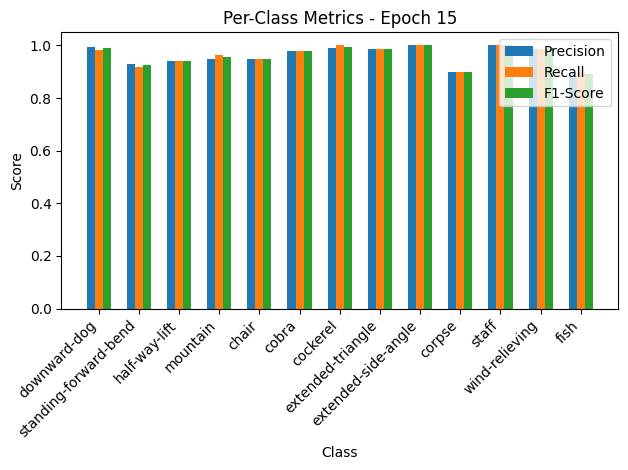

Validation: 100%|██████████| 21/21 [00:00<00:00, 26.13it/s, loss=0.2, accuracy=92.7]


Per-Class Metrics for Epoch 15:
downward-dog: Precision=0.98, Recall=1.00, F1-Score=0.99
standing-forward-bend: Precision=0.74, Recall=0.95, F1-Score=0.83
half-way-lift: Precision=0.96, Recall=0.68, F1-Score=0.79
mountain: Precision=0.91, Recall=1.00, F1-Score=0.95
chair: Precision=1.00, Recall=0.83, F1-Score=0.90
cobra: Precision=1.00, Recall=0.96, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.86, Recall=1.00, F1-Score=0.93
extended-side-angle: Precision=1.00, Recall=0.79, F1-Score=0.88
corpse: Precision=0.94, Recall=0.94, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=1.00, F1-Score=0.97


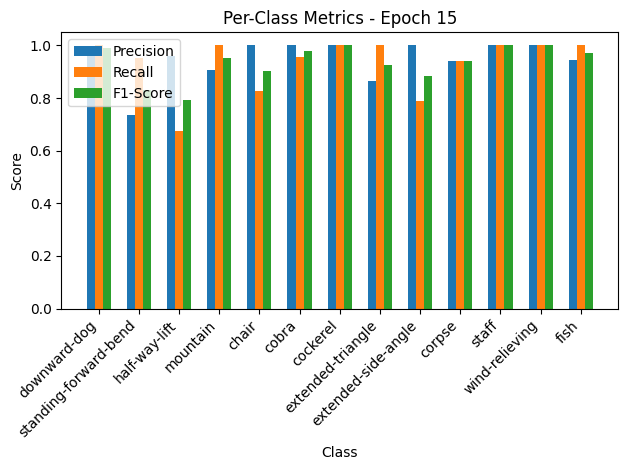


Epoch 16/50 Summary:
Train Loss: 0.1153 | Train Acc: 96.03% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.2058 | Val Acc: 92.66% | Val Precision: 0.94 | Val Recall: 0.93 | Val F1: 0.93

Epoch 17/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.11it/s, loss=0.122, accuracy=96.5]


Per-Class Metrics for Epoch 16:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.96, Recall=0.95, F1-Score=0.96
half-way-lift: Precision=0.96, Recall=0.95, F1-Score=0.95
mountain: Precision=0.97, Recall=0.98, F1-Score=0.97
chair: Precision=0.98, Recall=0.95, F1-Score=0.96
cobra: Precision=0.96, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.96, Recall=0.96, F1-Score=0.96
extended-side-angle: Precision=0.96, Recall=0.96, F1-Score=0.96
corpse: Precision=0.93, Recall=0.91, F1-Score=0.92
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.91, Recall=0.91, F1-Score=0.91


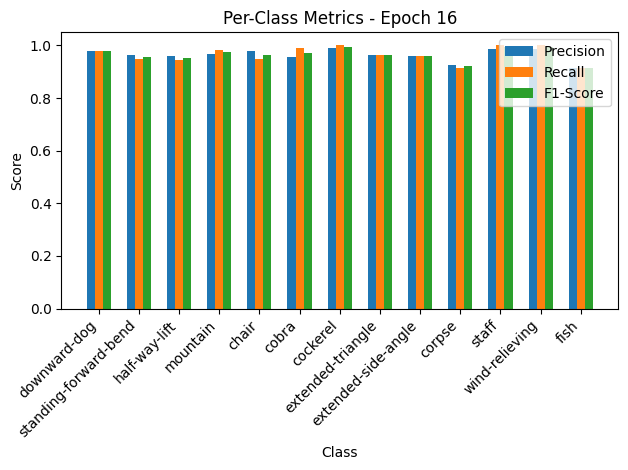

Validation: 100%|██████████| 21/21 [00:00<00:00, 28.37it/s, loss=0.154, accuracy=96]


Per-Class Metrics for Epoch 16:
downward-dog: Precision=1.00, Recall=0.96, F1-Score=0.98
standing-forward-bend: Precision=1.00, Recall=0.88, F1-Score=0.94
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.99
mountain: Precision=0.85, Recall=1.00, F1-Score=0.92
chair: Precision=0.96, Recall=0.96, F1-Score=0.96
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.93, Recall=0.82, F1-Score=0.88
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.84, Recall=0.94, F1-Score=0.89


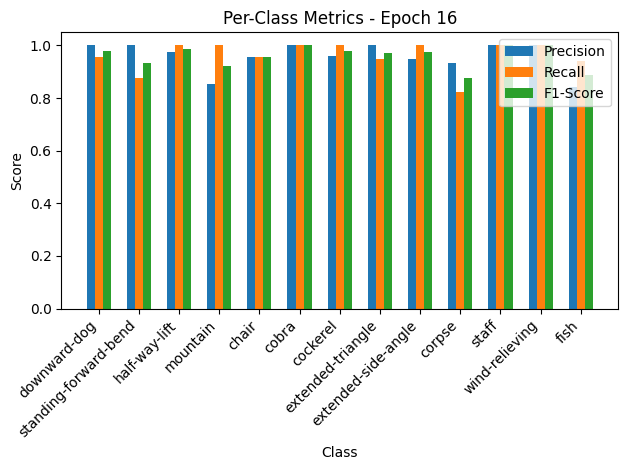


Epoch 17/50 Summary:
Train Loss: 0.1217 | Train Acc: 96.49% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.1583 | Val Acc: 96.02% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 18/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.36it/s, loss=0.113, accuracy=96.9]


Per-Class Metrics for Epoch 17:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.97, Recall=0.98, F1-Score=0.97
mountain: Precision=0.95, Recall=0.97, F1-Score=0.96
chair: Precision=0.97, Recall=0.97, F1-Score=0.97
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.94, Recall=1.00, F1-Score=0.97
corpse: Precision=0.93, Recall=0.93, F1-Score=0.93
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.93, Recall=0.93, F1-Score=0.93


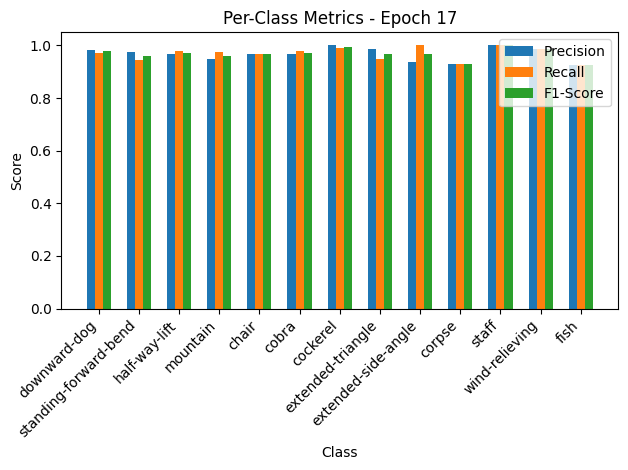

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.89it/s, loss=0.144, accuracy=96.3]


Per-Class Metrics for Epoch 17:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=1.00, Recall=0.88, F1-Score=0.94
half-way-lift: Precision=0.88, Recall=1.00, F1-Score=0.94
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=0.96, Recall=0.96, F1-Score=0.96
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.95, Recall=0.95, F1-Score=0.95
extended-side-angle: Precision=0.94, Recall=0.89, F1-Score=0.92
corpse: Precision=1.00, Recall=0.88, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.89, Recall=1.00, F1-Score=0.94


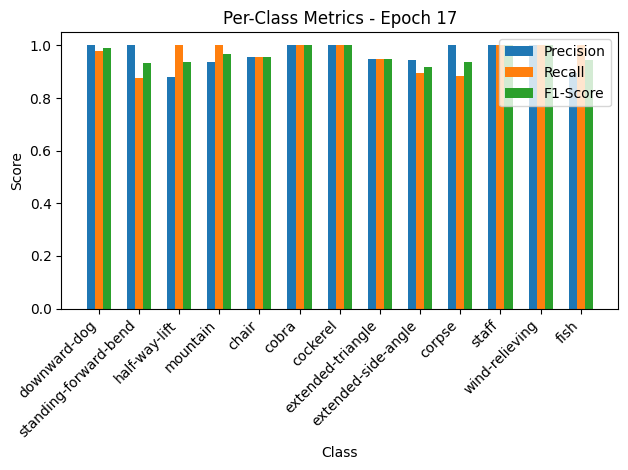


Epoch 18/50 Summary:
Train Loss: 0.1135 | Train Acc: 96.87% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.1478 | Val Acc: 96.33% | Val Precision: 0.97 | Val Recall: 0.96 | Val F1: 0.96

Epoch 19/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.93it/s, loss=0.0579, accuracy=98.2]


Per-Class Metrics for Epoch 18:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.96, Recall=0.99, F1-Score=0.97
mountain: Precision=0.96, Recall=0.99, F1-Score=0.97
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=0.99, Recall=0.96, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.96, Recall=0.99, F1-Score=0.97


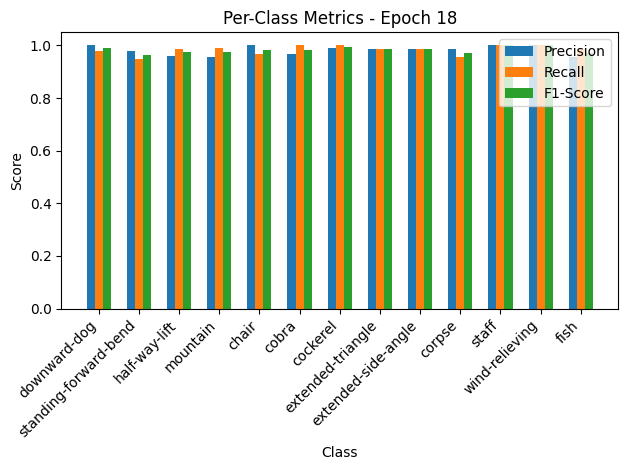

Validation: 100%|██████████| 21/21 [00:00<00:00, 28.98it/s, loss=0.102, accuracy=97.9]


Per-Class Metrics for Epoch 18:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.99
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=0.96, Recall=0.96, F1-Score=0.96
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=1.00, Recall=0.88, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.89, Recall=1.00, F1-Score=0.94


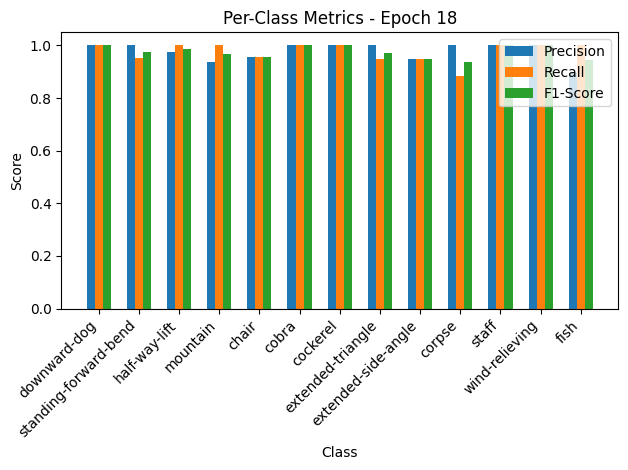


Epoch 19/50 Summary:
Train Loss: 0.0580 | Train Acc: 98.17% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1046 | Val Acc: 97.86% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model.pth
Checkpoint saved at epoch 19
New best model saved! Validation Loss: 0.1046

Epoch 20/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.97it/s, loss=0.0565, accuracy=97.9]


Per-Class Metrics for Epoch 19:
downward-dog: Precision=0.98, Recall=0.99, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.96, Recall=0.99, F1-Score=0.97
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.98, Recall=0.97, F1-Score=0.97
cobra: Precision=0.99, Recall=0.97, F1-Score=0.98
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.97, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.97, F1-Score=0.97


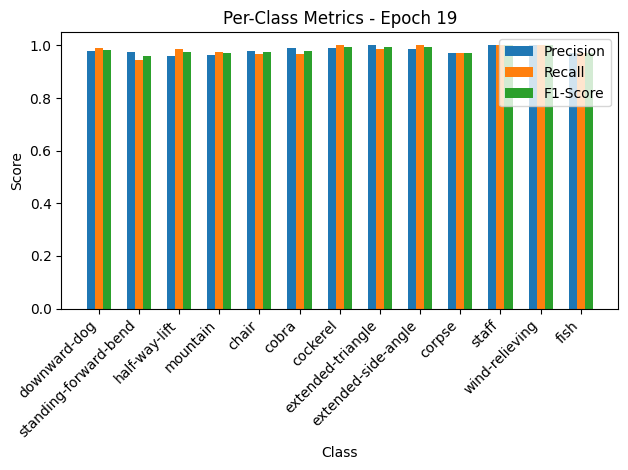

Validation: 100%|██████████| 21/21 [00:00<00:00, 28.61it/s, loss=0.106, accuracy=97.9]


Per-Class Metrics for Epoch 19:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=1.00, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.99
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=0.96, Recall=0.96, F1-Score=0.96
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=1.00, Recall=0.88, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.89, Recall=1.00, F1-Score=0.94


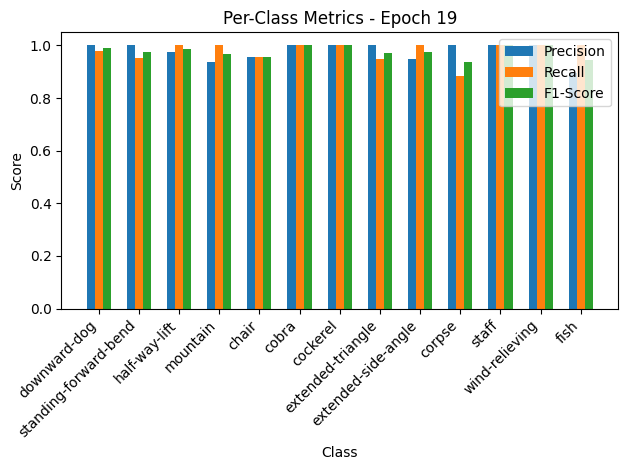


Epoch 20/50 Summary:
Train Loss: 0.0566 | Train Acc: 97.94% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1093 | Val Acc: 97.86% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 21/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.79it/s, loss=0.0482, accuracy=98.3]


Per-Class Metrics for Epoch 20:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.98, Recall=0.97, F1-Score=0.98
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=0.99, Recall=0.98, F1-Score=0.98
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.96, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.96, Recall=0.97, F1-Score=0.96


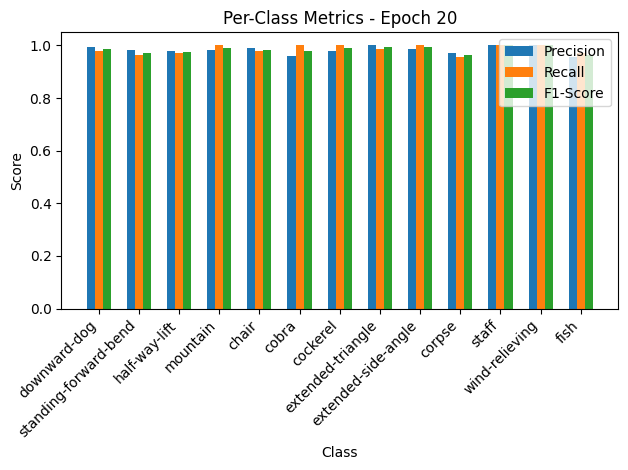

Validation: 100%|██████████| 21/21 [00:00<00:00, 30.58it/s, loss=0.14, accuracy=97.6]


Per-Class Metrics for Epoch 20:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.99
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=1.00, Recall=0.82, F1-Score=0.90
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.94, Recall=1.00, F1-Score=0.97
fish: Precision=0.85, Recall=1.00, F1-Score=0.92


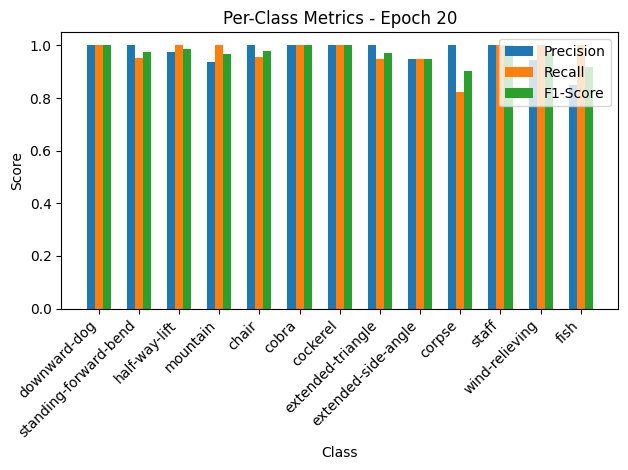


Epoch 21/50 Summary:
Train Loss: 0.0482 | Train Acc: 98.32% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1436 | Val Acc: 97.55% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 22/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.76it/s, loss=0.0517, accuracy=98.5]


Per-Class Metrics for Epoch 21:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.96, Recall=0.98, F1-Score=0.97
half-way-lift: Precision=0.98, Recall=0.95, F1-Score=0.97
mountain: Precision=0.97, Recall=0.98, F1-Score=0.98
chair: Precision=0.99, Recall=0.98, F1-Score=0.98
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=0.99, Recall=0.99, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.99, Recall=0.99, F1-Score=0.99


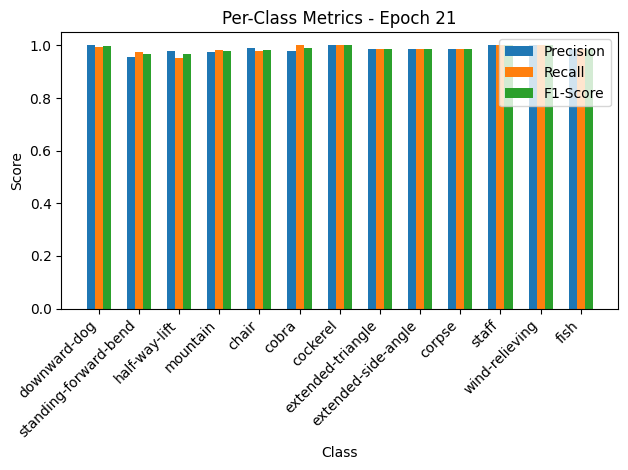

Validation: 100%|██████████| 21/21 [00:00<00:00, 28.13it/s, loss=0.0993, accuracy=97.9]


Per-Class Metrics for Epoch 21:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=1.00, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.95, Recall=1.00, F1-Score=0.97
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=1.00, Recall=0.94, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.94, Recall=1.00, F1-Score=0.97
fish: Precision=0.94, Recall=1.00, F1-Score=0.97


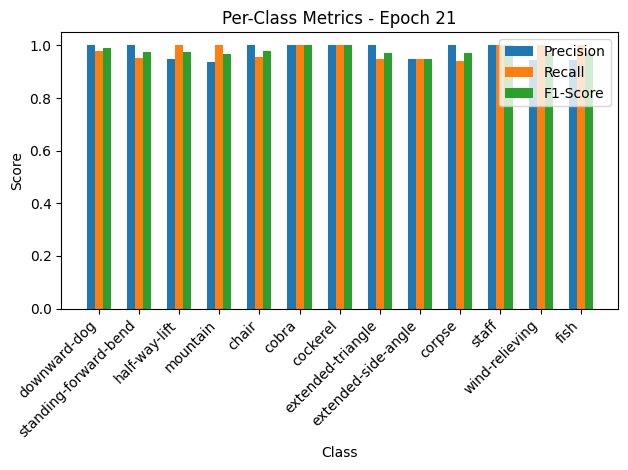


Epoch 22/50 Summary:
Train Loss: 0.0518 | Train Acc: 98.47% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1020 | Val Acc: 97.86% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model.pth
Checkpoint saved at epoch 22
New best model saved! Validation Loss: 0.1020

Epoch 23/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.20it/s, loss=0.0346, accuracy=98.9]


Per-Class Metrics for Epoch 22:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=1.00, Recall=0.96, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=1.00, F1-Score=0.99
chair: Precision=0.99, Recall=0.98, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=0.97, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.97, F1-Score=0.99


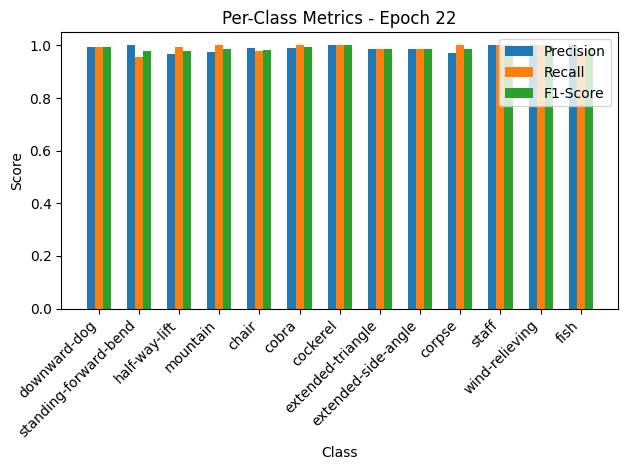

Validation: 100%|██████████| 21/21 [00:00<00:00, 24.59it/s, loss=0.101, accuracy=97.9]


Per-Class Metrics for Epoch 22:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.99
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=1.00, Recall=0.88, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.94, Recall=1.00, F1-Score=0.97
fish: Precision=0.89, Recall=1.00, F1-Score=0.94


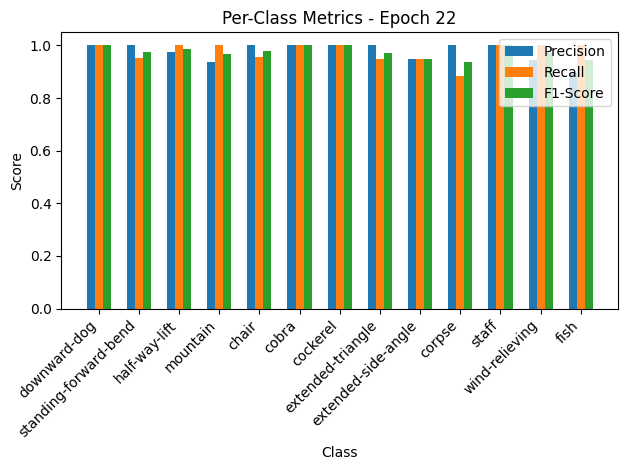


Epoch 23/50 Summary:
Train Loss: 0.0347 | Train Acc: 98.85% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1033 | Val Acc: 97.86% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 24/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.32it/s, loss=0.0313, accuracy=98.9]


Per-Class Metrics for Epoch 23:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=0.99, Recall=0.99, F1-Score=0.99
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.99, Recall=0.99, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.99, Recall=0.99, F1-Score=0.99


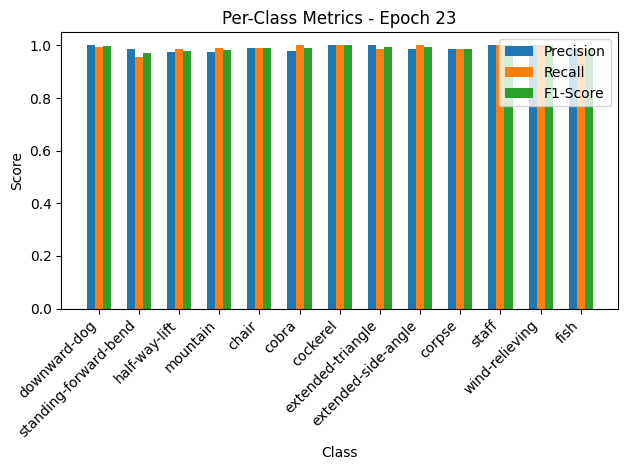

Validation: 100%|██████████| 21/21 [00:00<00:00, 30.29it/s, loss=0.1, accuracy=97.9]


Per-Class Metrics for Epoch 23:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=1.00, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.95, Recall=1.00, F1-Score=0.97
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=1.00, Recall=0.94, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.94, Recall=1.00, F1-Score=0.97
fish: Precision=0.94, Recall=1.00, F1-Score=0.97


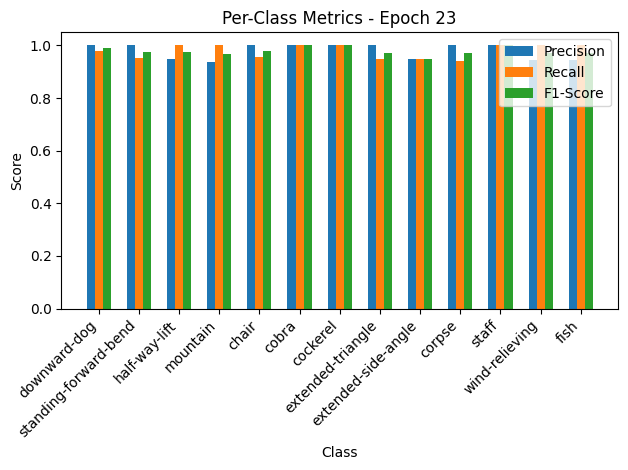


Epoch 24/50 Summary:
Train Loss: 0.0313 | Train Acc: 98.85% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1028 | Val Acc: 97.86% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 25/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.51it/s, loss=0.0277, accuracy=99]


Per-Class Metrics for Epoch 24:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.99
mountain: Precision=0.97, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.99, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.97, Recall=0.97, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.97, F1-Score=0.97


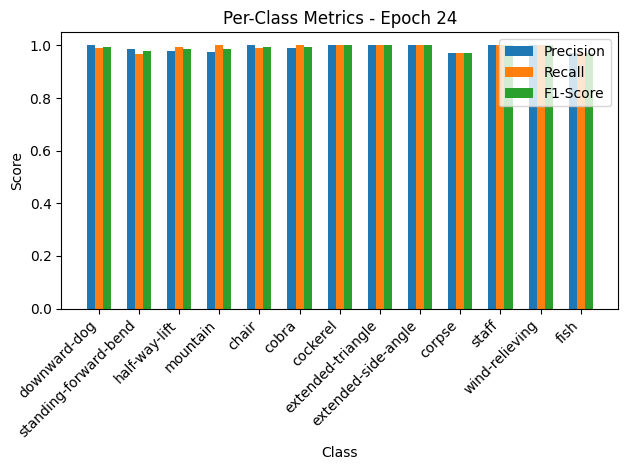

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.06it/s, loss=0.091, accuracy=98.5]


Per-Class Metrics for Epoch 24:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.99
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=1.00, F1-Score=0.97


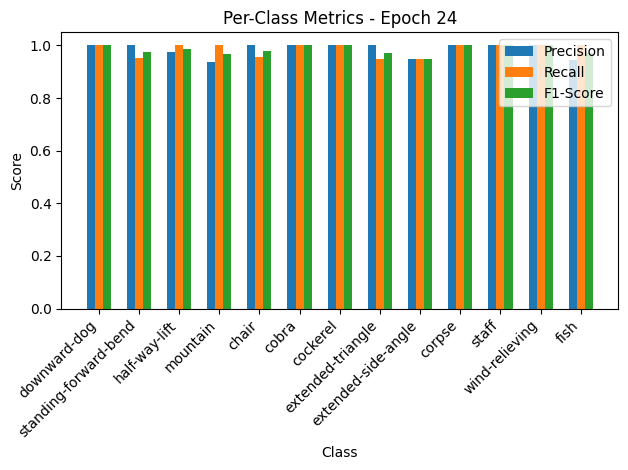


Epoch 25/50 Summary:
Train Loss: 0.0277 | Train Acc: 99.01% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0935 | Val Acc: 98.47% | Val Precision: 0.99 | Val Recall: 0.98 | Val F1: 0.98
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model.pth
Checkpoint saved at epoch 25
New best model saved! Validation Loss: 0.0935

Epoch 26/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.28it/s, loss=0.0373, accuracy=98.5]


Per-Class Metrics for Epoch 25:
downward-dog: Precision=0.98, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=0.99, Recall=1.00, F1-Score=0.99
cobra: Precision=1.00, Recall=0.98, F1-Score=0.99
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.97, F1-Score=0.98
corpse: Precision=0.97, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=0.98, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.99, Recall=0.97, F1-Score=0.98


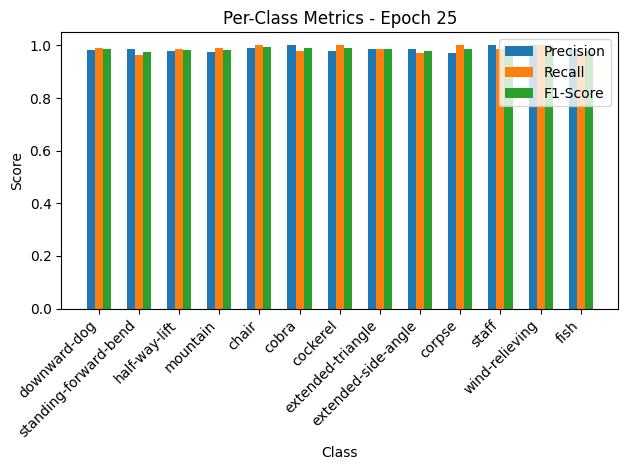

Validation: 100%|██████████| 21/21 [00:00<00:00, 22.72it/s, loss=0.0646, accuracy=98.5]


Per-Class Metrics for Epoch 25:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.99
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.94, Recall=1.00, F1-Score=0.97
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


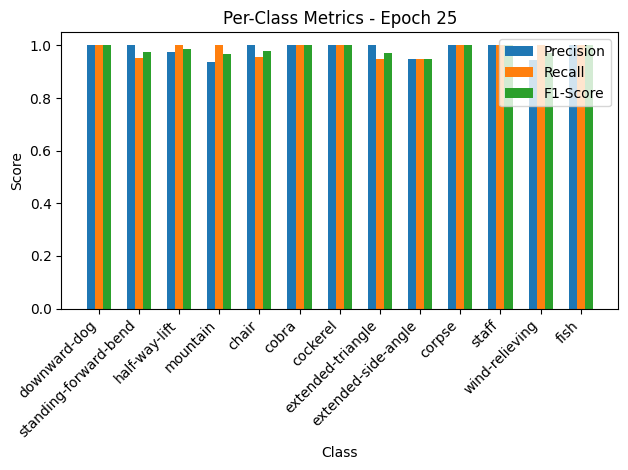


Epoch 26/50 Summary:
Train Loss: 0.0374 | Train Acc: 98.55% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0663 | Val Acc: 98.47% | Val Precision: 0.99 | Val Recall: 0.98 | Val F1: 0.98
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model.pth
Checkpoint saved at epoch 26
New best model saved! Validation Loss: 0.0663

Epoch 27/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.31it/s, loss=0.0364, accuracy=98.7]


Per-Class Metrics for Epoch 26:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=0.97, F1-Score=0.98
mountain: Precision=0.98, Recall=0.98, F1-Score=0.98
chair: Precision=0.96, Recall=0.97, F1-Score=0.96
cobra: Precision=0.99, Recall=0.99, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.97, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.97, F1-Score=0.99


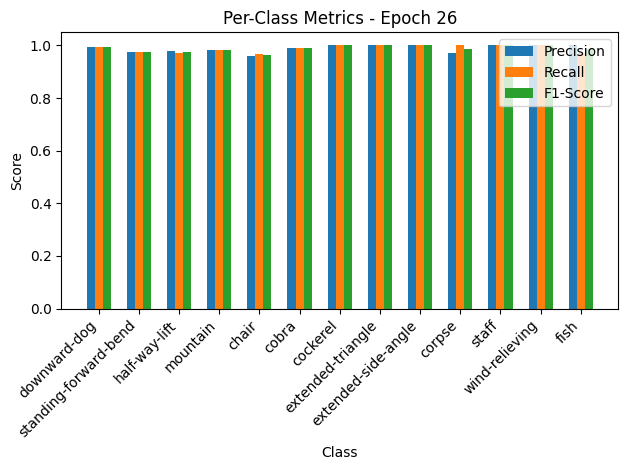

Validation: 100%|██████████| 21/21 [00:00<00:00, 30.49it/s, loss=0.0857, accuracy=97.6]


Per-Class Metrics for Epoch 26:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=1.00, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.95, Recall=1.00, F1-Score=0.97
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=1.00, Recall=0.88, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.94, Recall=1.00, F1-Score=0.97
fish: Precision=0.89, Recall=1.00, F1-Score=0.94


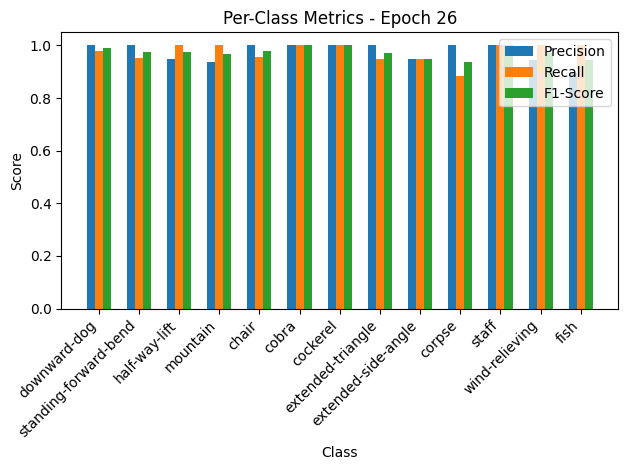


Epoch 27/50 Summary:
Train Loss: 0.0365 | Train Acc: 98.70% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0881 | Val Acc: 97.55% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 28/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.75it/s, loss=0.0273, accuracy=98.9]


Per-Class Metrics for Epoch 27:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.97, F1-Score=0.97
mountain: Precision=0.97, Recall=1.00, F1-Score=0.98
chair: Precision=0.99, Recall=0.98, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.99, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.99, F1-Score=0.99


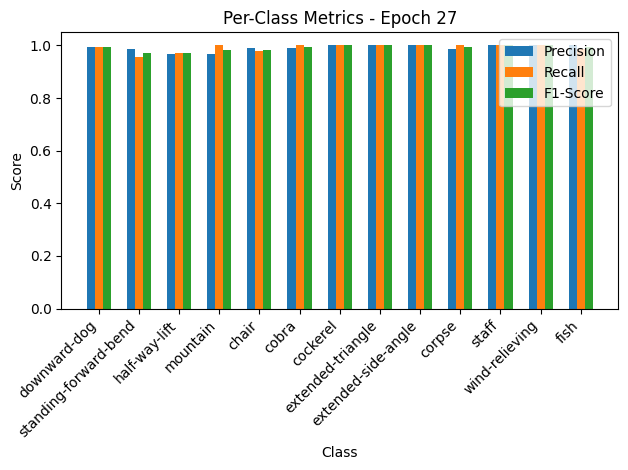

Validation: 100%|██████████| 21/21 [00:00<00:00, 30.16it/s, loss=0.0984, accuracy=98.2]


Per-Class Metrics for Epoch 27:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=1.00, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.95, Recall=1.00, F1-Score=0.97
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.94, Recall=1.00, F1-Score=0.97
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


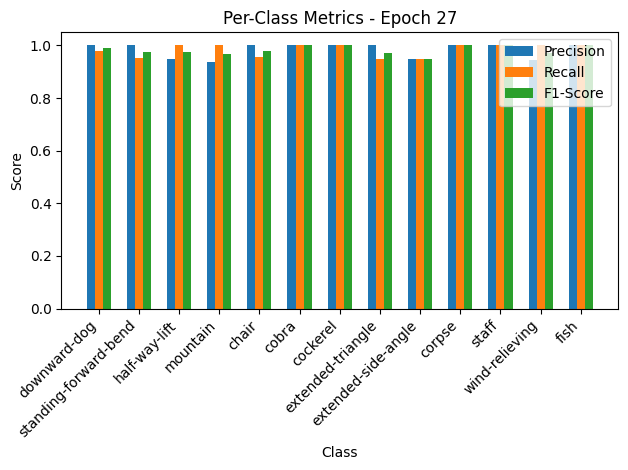


Epoch 28/50 Summary:
Train Loss: 0.0273 | Train Acc: 98.85% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1011 | Val Acc: 98.17% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 29/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:10<00:00,  8.03it/s, loss=0.032, accuracy=98.8]


Per-Class Metrics for Epoch 28:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.99
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.99, F1-Score=0.99
cobra: Precision=0.99, Recall=0.99, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-side-angle: Precision=0.99, Recall=0.97, F1-Score=0.98
corpse: Precision=0.97, Recall=0.96, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.96, Recall=0.97, F1-Score=0.96


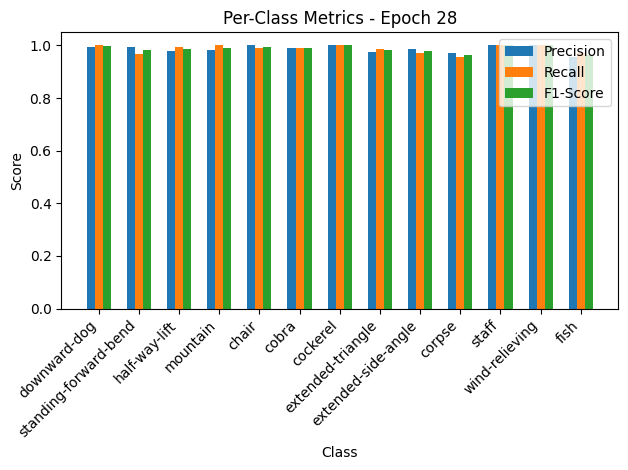

Validation: 100%|██████████| 21/21 [00:00<00:00, 24.26it/s, loss=0.0863, accuracy=98.5]


Per-Class Metrics for Epoch 28:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.99
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


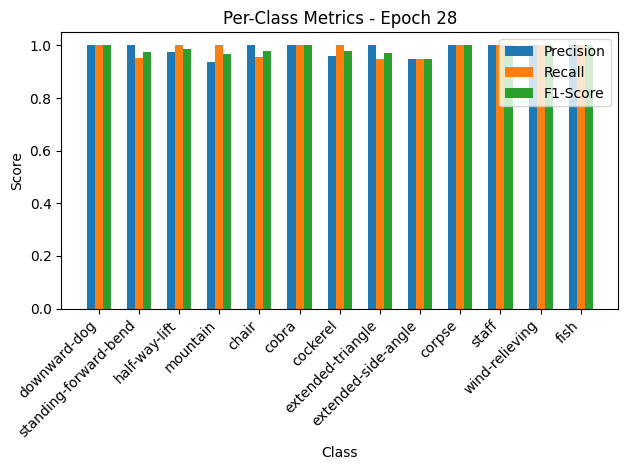


Epoch 29/50 Summary:
Train Loss: 0.0320 | Train Acc: 98.78% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0887 | Val Acc: 98.47% | Val Precision: 0.99 | Val Recall: 0.98 | Val F1: 0.98

Epoch 30/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.77it/s, loss=0.0318, accuracy=98.8]


Per-Class Metrics for Epoch 29:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.98
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=0.99, Recall=0.98, F1-Score=0.98
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.97, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.97, F1-Score=0.97


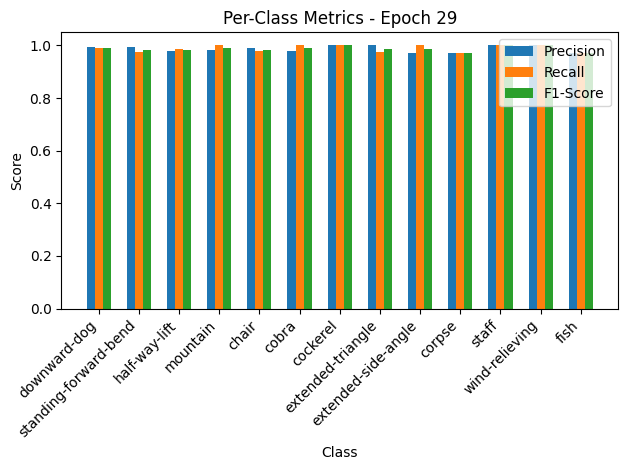

Validation: 100%|██████████| 21/21 [00:00<00:00, 30.44it/s, loss=0.0908, accuracy=98.5]


Per-Class Metrics for Epoch 29:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.99
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


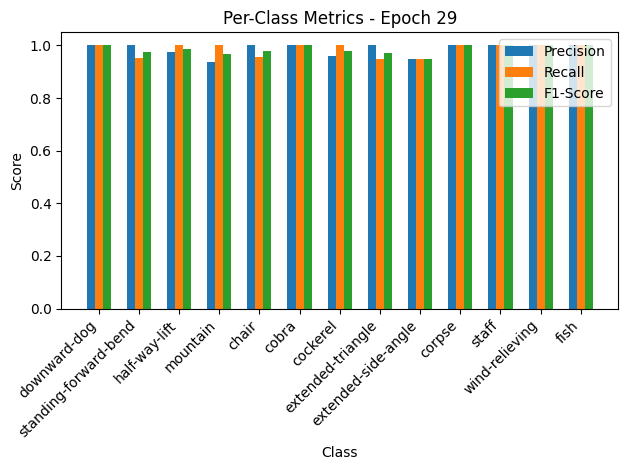


Epoch 30/50 Summary:
Train Loss: 0.0319 | Train Acc: 98.78% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0933 | Val Acc: 98.47% | Val Precision: 0.99 | Val Recall: 0.98 | Val F1: 0.98

Epoch 31/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.40it/s, loss=0.0268, accuracy=99.2]


Per-Class Metrics for Epoch 30:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.99, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=0.99, F1-Score=0.99
mountain: Precision=0.98, Recall=0.99, F1-Score=0.99
chair: Precision=0.99, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.99, Recall=0.99, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.99, Recall=0.99, F1-Score=0.99


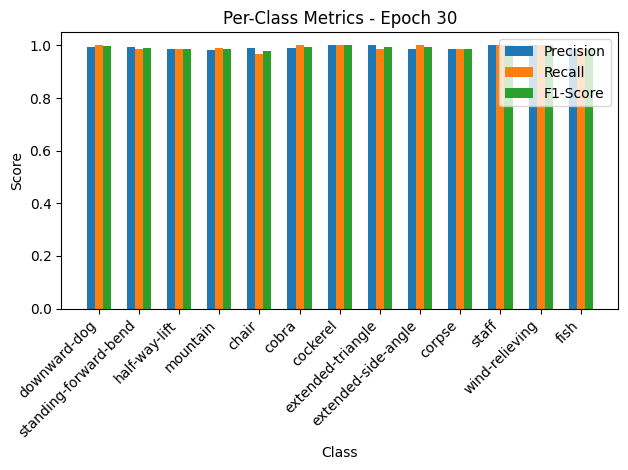

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.83it/s, loss=0.0886, accuracy=98.5]


Per-Class Metrics for Epoch 30:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.99
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


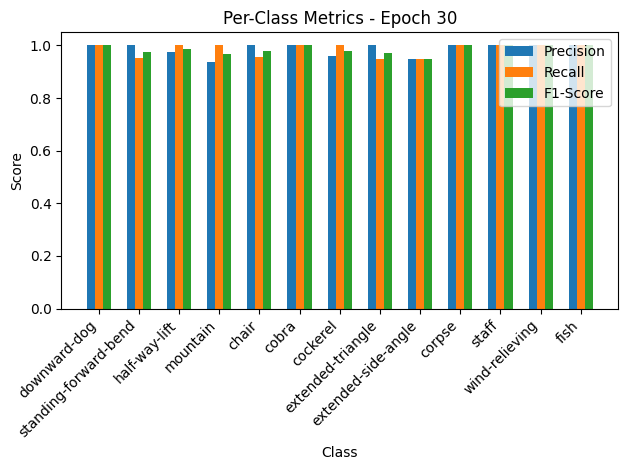


Epoch 31/50 Summary:
Train Loss: 0.0268 | Train Acc: 99.16% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0910 | Val Acc: 98.47% | Val Precision: 0.99 | Val Recall: 0.98 | Val F1: 0.98

Epoch 32/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:09<00:00,  9.01it/s, loss=0.0242, accuracy=99.3]


Per-Class Metrics for Epoch 31:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.99
mountain: Precision=0.99, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.99, Recall=0.97, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.99, F1-Score=0.98


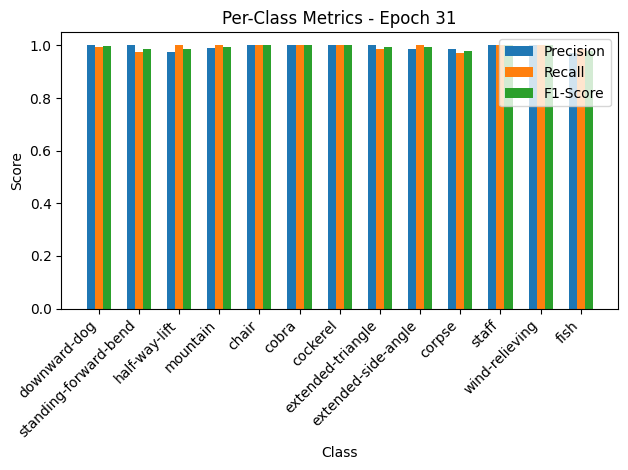

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.37it/s, loss=0.106, accuracy=97.9]


Per-Class Metrics for Epoch 31:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.99
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=1.00, Recall=0.88, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.89, Recall=1.00, F1-Score=0.94


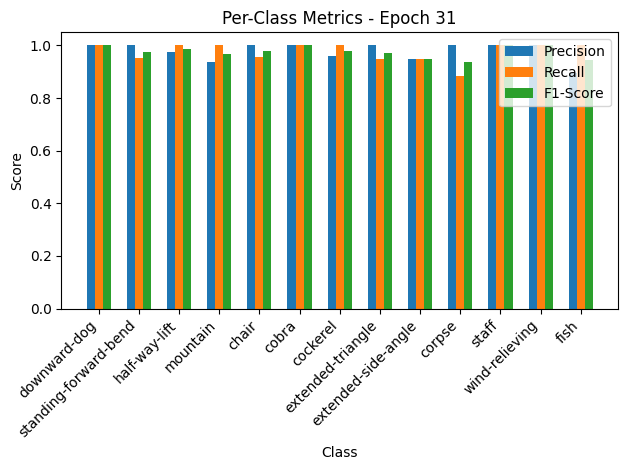


Epoch 32/50 Summary:
Train Loss: 0.0243 | Train Acc: 99.31% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1094 | Val Acc: 97.86% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 33/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:08<00:00, 10.05it/s, loss=0.0215, accuracy=99.3]


Per-Class Metrics for Epoch 32:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.99, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=0.99, F1-Score=0.99
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=0.99, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=0.99, Recall=0.97, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.99, F1-Score=0.98


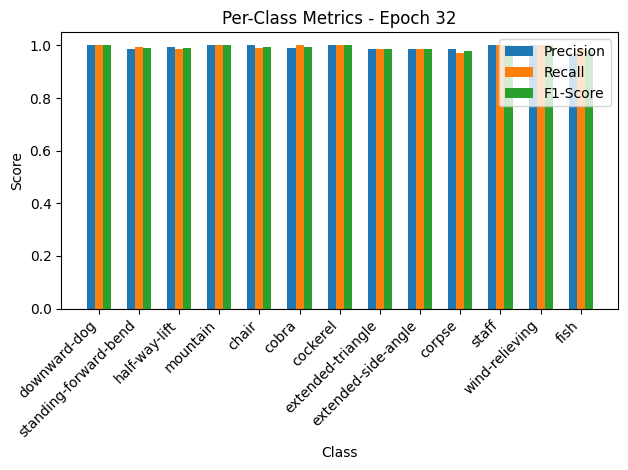

Validation: 100%|██████████| 21/21 [00:00<00:00, 31.69it/s, loss=0.0908, accuracy=98.2]


Per-Class Metrics for Epoch 32:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=1.00, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.95, Recall=1.00, F1-Score=0.97
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


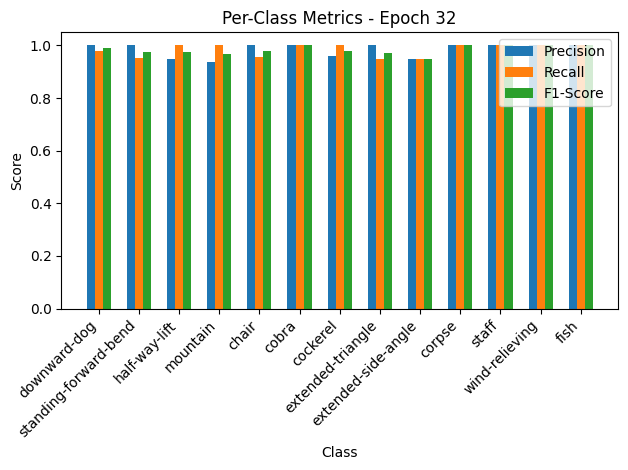


Epoch 33/50 Summary:
Train Loss: 0.0215 | Train Acc: 99.31% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0933 | Val Acc: 98.17% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 34/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:09<00:00,  8.79it/s, loss=0.0296, accuracy=99.1]


Per-Class Metrics for Epoch 33:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.97, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.98, Recall=0.99, F1-Score=0.99
chair: Precision=1.00, Recall=0.99, F1-Score=0.99
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.99, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.99, F1-Score=0.99


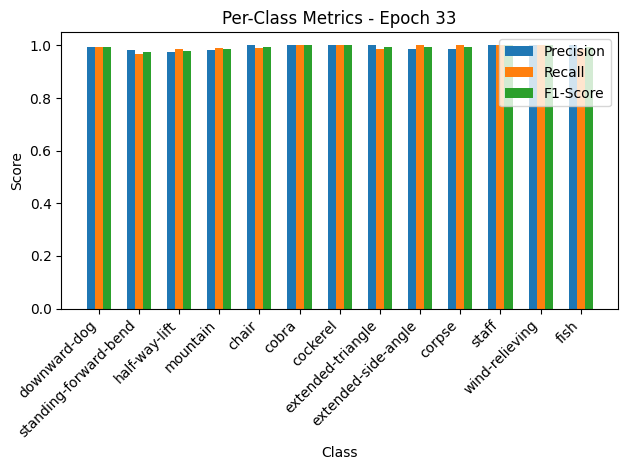

Validation: 100%|██████████| 21/21 [00:00<00:00, 30.91it/s, loss=0.0844, accuracy=98.5]


Per-Class Metrics for Epoch 33:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.99
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=1.00, F1-Score=0.97


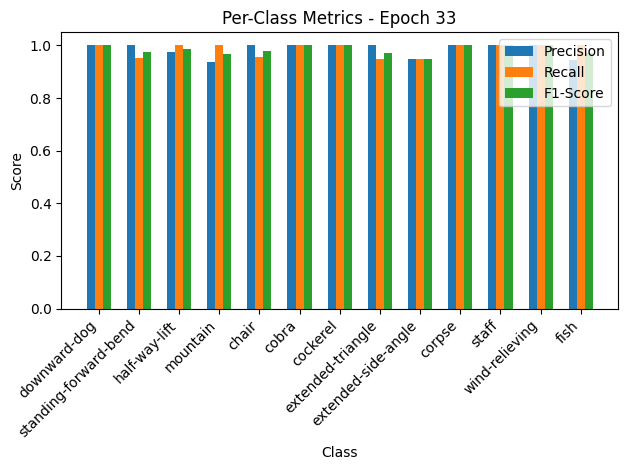


Epoch 34/50 Summary:
Train Loss: 0.0296 | Train Acc: 99.08% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0867 | Val Acc: 98.47% | Val Precision: 0.99 | Val Recall: 0.98 | Val F1: 0.98

Epoch 35/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:09<00:00,  9.00it/s, loss=0.0258, accuracy=99.1]


Per-Class Metrics for Epoch 34:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.99
mountain: Precision=1.00, Recall=0.99, F1-Score=1.00
chair: Precision=0.99, Recall=0.99, F1-Score=0.99
cobra: Precision=0.99, Recall=0.99, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.97, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.99, Recall=0.97, F1-Score=0.98


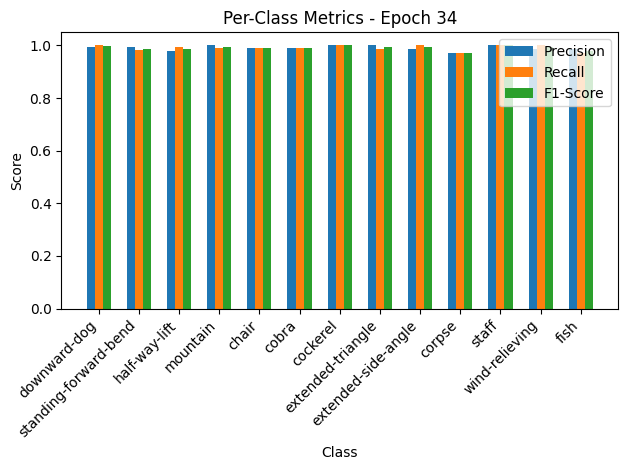

Validation: 100%|██████████| 21/21 [00:00<00:00, 22.11it/s, loss=0.0924, accuracy=98.5]


Per-Class Metrics for Epoch 34:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.99
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


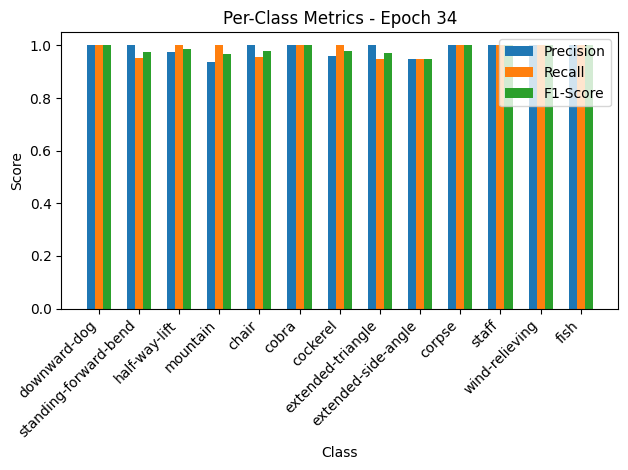


Epoch 35/50 Summary:
Train Loss: 0.0258 | Train Acc: 99.08% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0949 | Val Acc: 98.47% | Val Precision: 0.99 | Val Recall: 0.98 | Val F1: 0.98

Epoch 36/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:08<00:00,  9.68it/s, loss=0.021, accuracy=99.2]


Per-Class Metrics for Epoch 35:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.99, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=0.99, F1-Score=0.99
mountain: Precision=0.99, Recall=0.99, F1-Score=0.99
chair: Precision=0.99, Recall=0.98, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.96, Recall=1.00, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.96, F1-Score=0.98


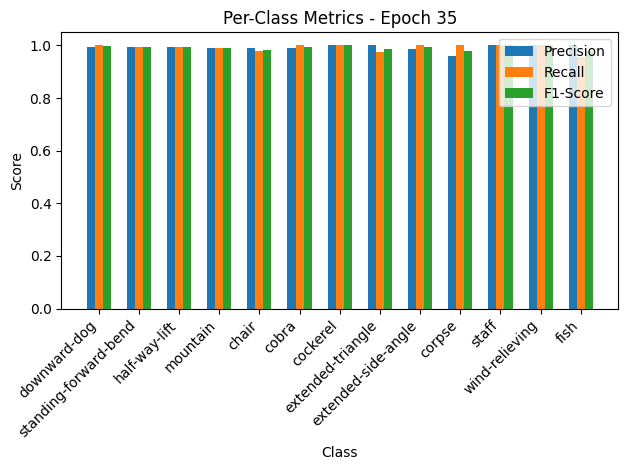

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.38it/s, loss=0.0948, accuracy=98.5]


Per-Class Metrics for Epoch 35:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.99
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=1.00, Recall=0.94, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=1.00, F1-Score=0.97


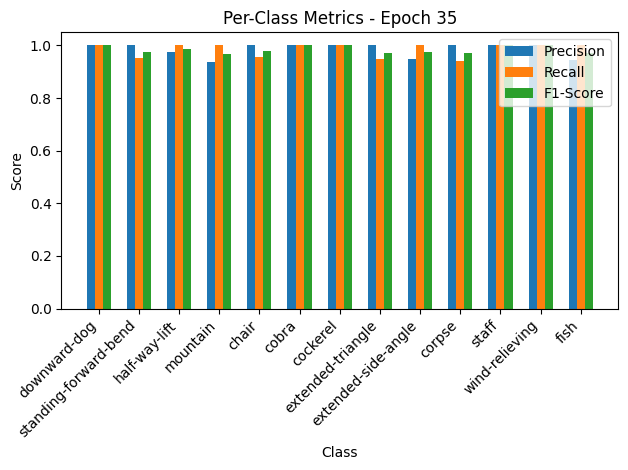


Epoch 36/50 Summary:
Train Loss: 0.0210 | Train Acc: 99.24% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0974 | Val Acc: 98.47% | Val Precision: 0.99 | Val Recall: 0.98 | Val F1: 0.98

Epoch 37/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:09<00:00,  8.57it/s, loss=0.0291, accuracy=99]


Per-Class Metrics for Epoch 36:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.99, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=0.99, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-side-angle: Precision=1.00, Recall=0.99, F1-Score=0.99
corpse: Precision=0.99, Recall=0.99, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.99, Recall=0.99, F1-Score=0.99


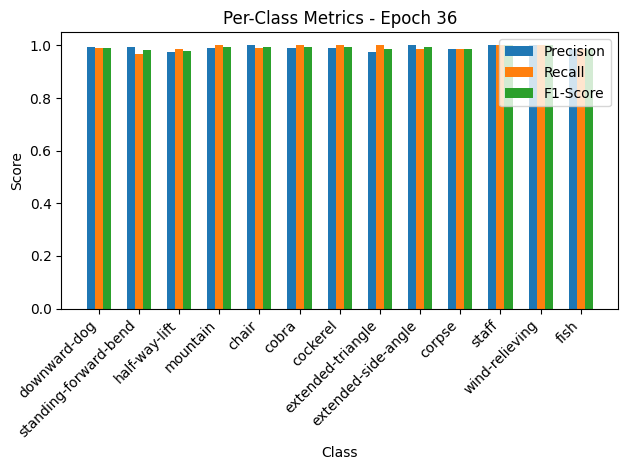

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.33it/s, loss=0.0966, accuracy=98.2]


Per-Class Metrics for Epoch 36:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.99
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=1.00, Recall=0.94, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=1.00, F1-Score=0.97


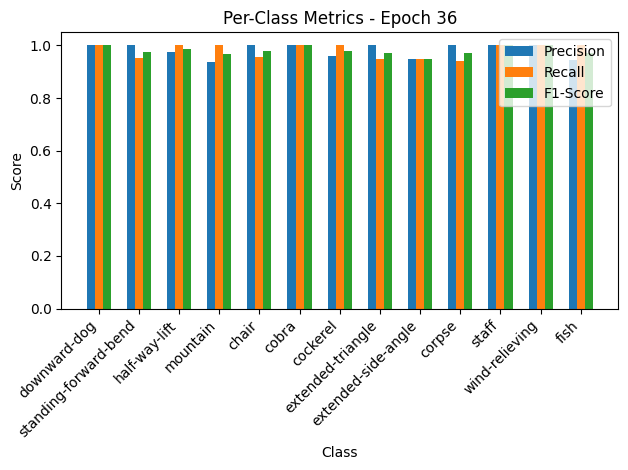


Epoch 37/50 Summary:
Train Loss: 0.0291 | Train Acc: 99.01% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0993 | Val Acc: 98.17% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 38/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:09<00:00,  8.97it/s, loss=0.0239, accuracy=99.2]


Per-Class Metrics for Epoch 37:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.99
mountain: Precision=0.97, Recall=1.00, F1-Score=0.99
chair: Precision=0.99, Recall=0.99, F1-Score=0.99
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=0.99, Recall=0.99, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.99, Recall=0.99, F1-Score=0.99


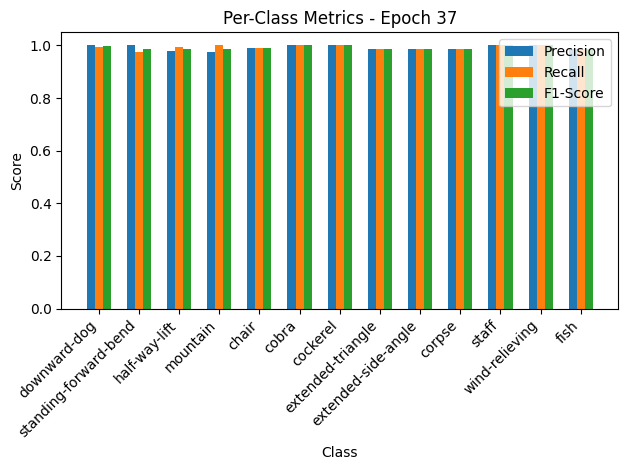

Validation: 100%|██████████| 21/21 [00:00<00:00, 27.43it/s, loss=0.0992, accuracy=98.2]


Per-Class Metrics for Epoch 37:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.99
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=1.00, Recall=0.94, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=1.00, F1-Score=0.97


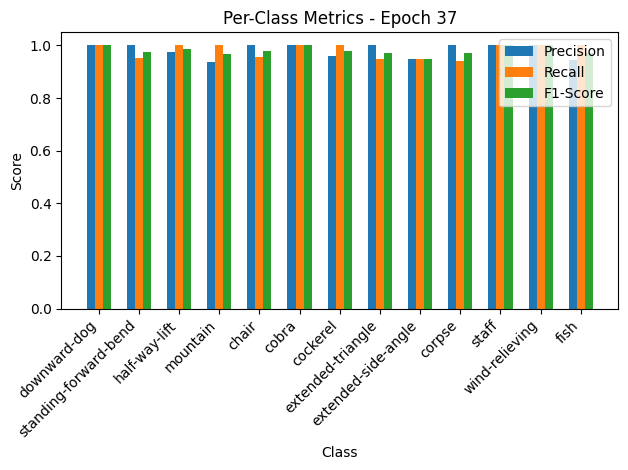


Epoch 38/50 Summary:
Train Loss: 0.0239 | Train Acc: 99.16% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1019 | Val Acc: 98.17% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 39/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:09<00:00,  8.69it/s, loss=0.0162, accuracy=99.3]


Per-Class Metrics for Epoch 38:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.98, Recall=1.00, F1-Score=0.99
mountain: Precision=0.99, Recall=1.00, F1-Score=1.00
chair: Precision=0.99, Recall=1.00, F1-Score=0.99
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.96, Recall=1.00, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.96, F1-Score=0.98


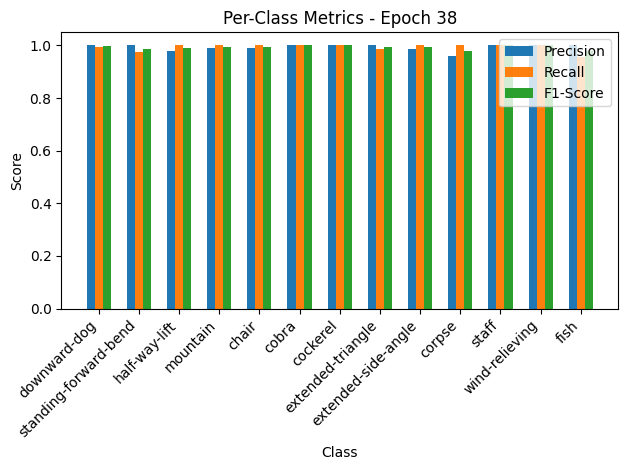

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.56it/s, loss=0.103, accuracy=98.2]


Per-Class Metrics for Epoch 38:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.99
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=1.00, Recall=0.94, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=1.00, F1-Score=0.97


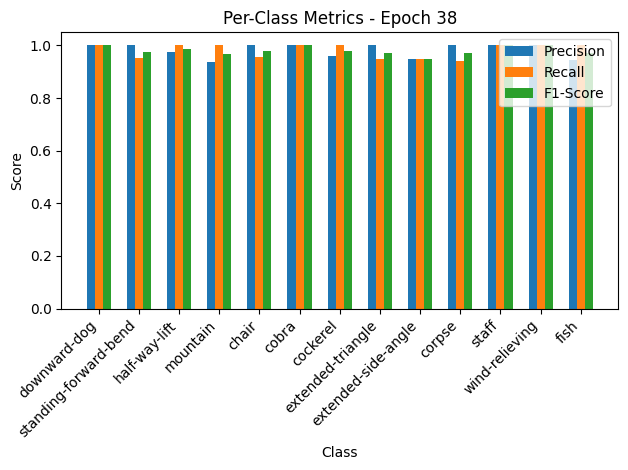


Epoch 39/50 Summary:
Train Loss: 0.0162 | Train Acc: 99.31% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1063 | Val Acc: 98.17% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 40/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:10<00:00,  7.49it/s, loss=0.0199, accuracy=99.2]


Per-Class Metrics for Epoch 39:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.99, Recall=0.98, F1-Score=0.98
mountain: Precision=0.98, Recall=0.99, F1-Score=0.99
chair: Precision=0.99, Recall=0.99, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.99, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.99, F1-Score=0.99


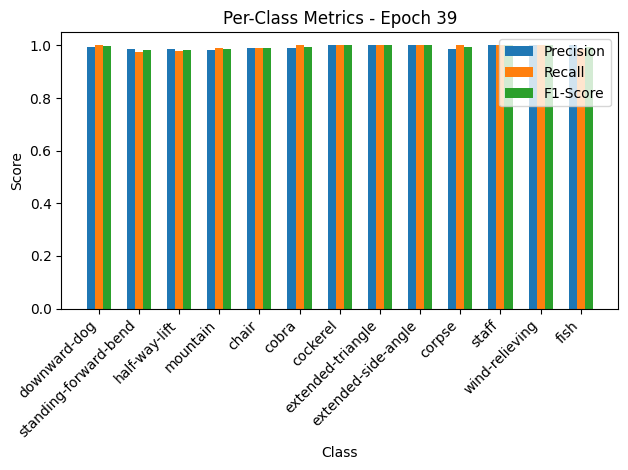

Validation: 100%|██████████| 21/21 [00:00<00:00, 28.81it/s, loss=0.0889, accuracy=98.5]


Per-Class Metrics for Epoch 39:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.99
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


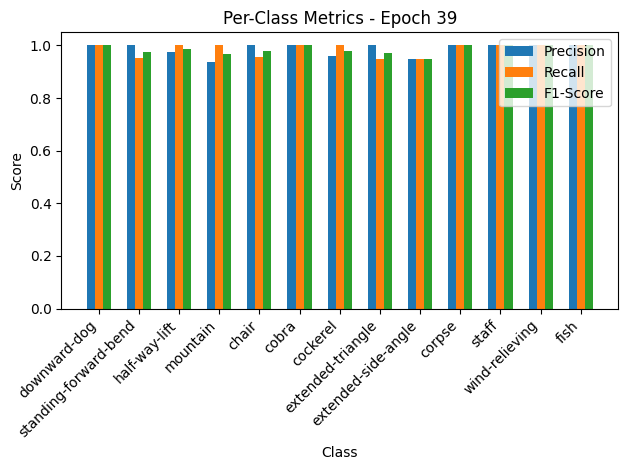


Epoch 40/50 Summary:
Train Loss: 0.0199 | Train Acc: 99.24% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0914 | Val Acc: 98.47% | Val Precision: 0.99 | Val Recall: 0.98 | Val F1: 0.98

Epoch 41/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:09<00:00,  8.25it/s, loss=0.0197, accuracy=99.5]


Per-Class Metrics for Epoch 40:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.99, Recall=1.00, F1-Score=0.99
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.99, F1-Score=0.99
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.99, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.99, F1-Score=0.99


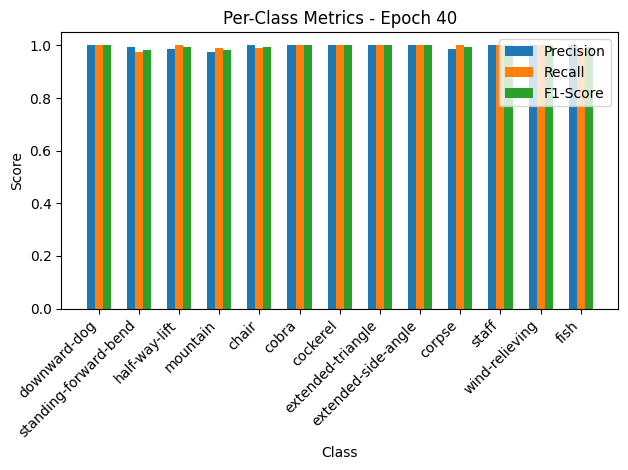

Validation: 100%|██████████| 21/21 [00:00<00:00, 27.51it/s, loss=0.0945, accuracy=98.5]


Per-Class Metrics for Epoch 40:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.99
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


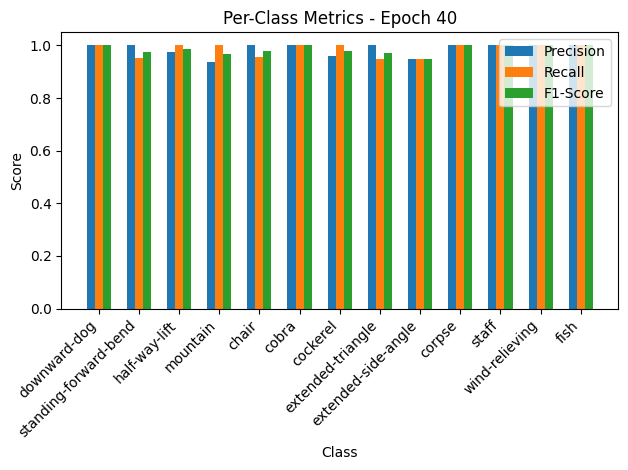


Epoch 41/50 Summary:
Train Loss: 0.0197 | Train Acc: 99.47% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0971 | Val Acc: 98.47% | Val Precision: 0.99 | Val Recall: 0.98 | Val F1: 0.98

Epoch 42/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:08<00:00,  9.24it/s, loss=0.0255, accuracy=98.9]


Per-Class Metrics for Epoch 41:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.98, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.98, Recall=0.97, F1-Score=0.98
mountain: Precision=0.97, Recall=1.00, F1-Score=0.99
chair: Precision=0.98, Recall=1.00, F1-Score=0.99
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.97, Recall=0.99, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.99, Recall=0.97, F1-Score=0.98


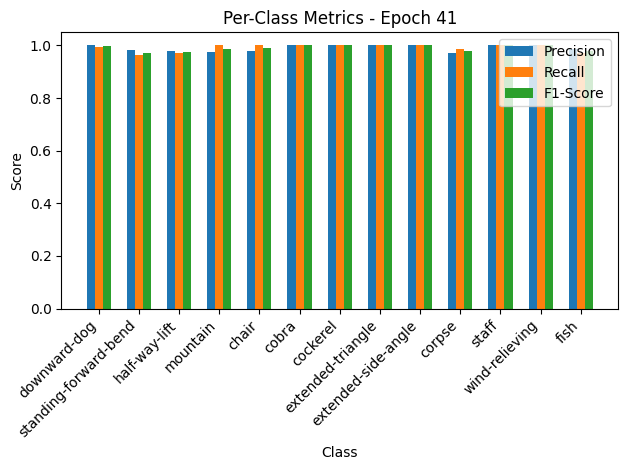

Validation: 100%|██████████| 21/21 [00:00<00:00, 28.99it/s, loss=0.0964, accuracy=98.2]


Per-Class Metrics for Epoch 41:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.99
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=1.00, Recall=0.94, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.94, Recall=1.00, F1-Score=0.97
fish: Precision=0.94, Recall=1.00, F1-Score=0.97


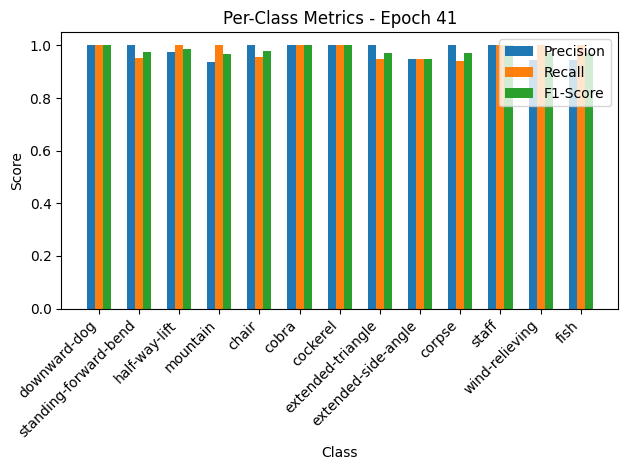


Epoch 42/50 Summary:
Train Loss: 0.0256 | Train Acc: 98.93% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0990 | Val Acc: 98.17% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 43/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:10<00:00,  8.01it/s, loss=0.0228, accuracy=99.3]


Per-Class Metrics for Epoch 42:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=1.00, F1-Score=1.00
mountain: Precision=0.98, Recall=0.98, F1-Score=0.98
chair: Precision=0.99, Recall=1.00, F1-Score=0.99
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.99, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.99, Recall=0.97, F1-Score=0.98


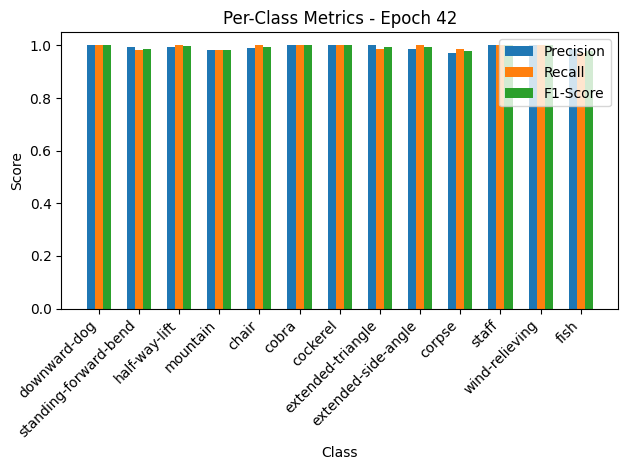

Validation: 100%|██████████| 21/21 [00:00<00:00, 27.78it/s, loss=0.0841, accuracy=98.5]


Per-Class Metrics for Epoch 42:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.99
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


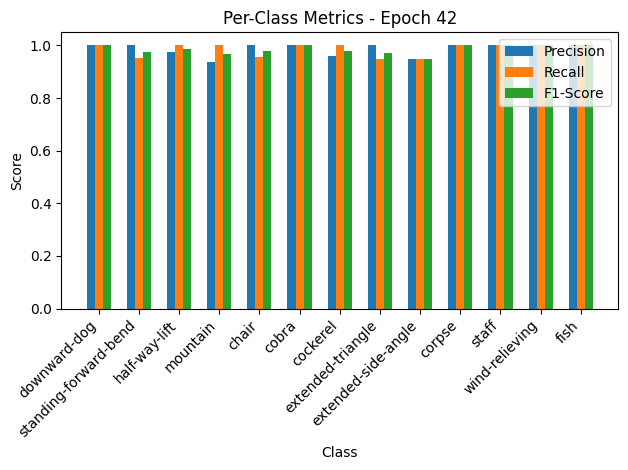


Epoch 43/50 Summary:
Train Loss: 0.0228 | Train Acc: 99.31% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0864 | Val Acc: 98.47% | Val Precision: 0.99 | Val Recall: 0.98 | Val F1: 0.98

Epoch 44/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:10<00:00,  7.94it/s, loss=0.022, accuracy=99.4]


Per-Class Metrics for Epoch 43:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.99, Recall=0.99, F1-Score=0.99
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=0.99, Recall=1.00, F1-Score=0.99
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.97, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.97, F1-Score=0.99


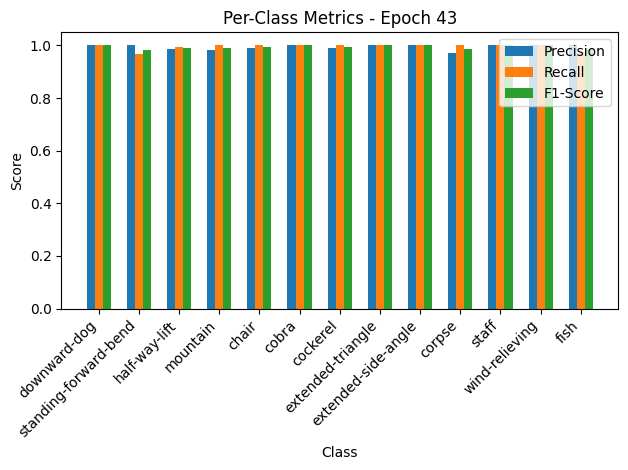

Validation: 100%|██████████| 21/21 [00:00<00:00, 25.24it/s, loss=0.0965, accuracy=98.5]


Per-Class Metrics for Epoch 43:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.99
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


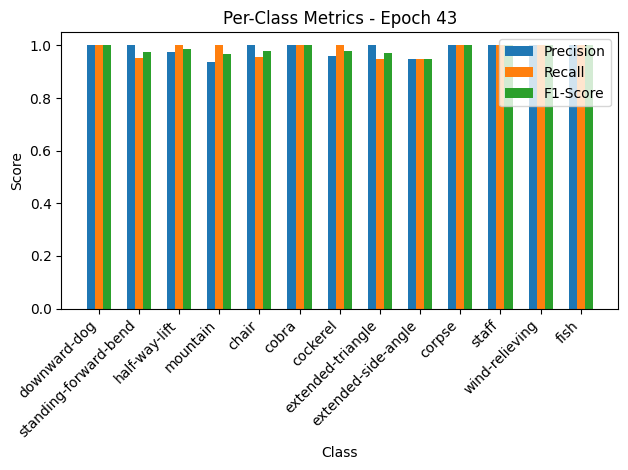


Epoch 44/50 Summary:
Train Loss: 0.0220 | Train Acc: 99.39% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0992 | Val Acc: 98.47% | Val Precision: 0.99 | Val Recall: 0.98 | Val F1: 0.98

Epoch 45/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:09<00:00,  8.71it/s, loss=0.021, accuracy=99.4]


Per-Class Metrics for Epoch 44:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=1.00, F1-Score=0.99
mountain: Precision=0.99, Recall=0.99, F1-Score=0.99
chair: Precision=0.98, Recall=1.00, F1-Score=0.99
cobra: Precision=1.00, Recall=0.99, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.97, F1-Score=0.99


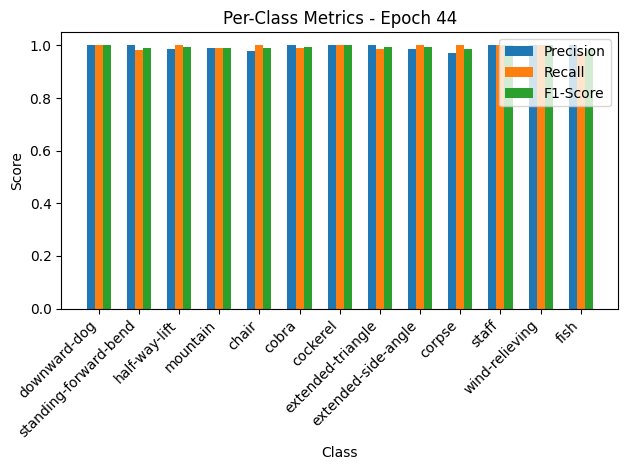

Validation: 100%|██████████| 21/21 [00:00<00:00, 28.94it/s, loss=0.0992, accuracy=98.5]


Per-Class Metrics for Epoch 44:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.99
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


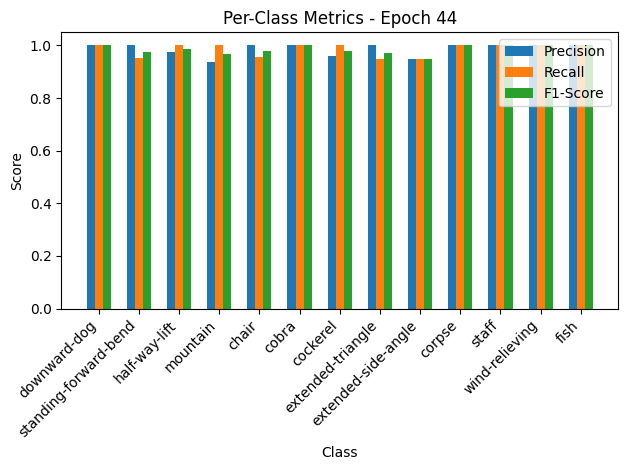


Epoch 45/50 Summary:
Train Loss: 0.0210 | Train Acc: 99.39% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1019 | Val Acc: 98.47% | Val Precision: 0.99 | Val Recall: 0.98 | Val F1: 0.98

Epoch 46/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:10<00:00,  7.77it/s, loss=0.036, accuracy=99.2]


Per-Class Metrics for Epoch 45:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=1.00, Recall=0.99, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=1.00, F1-Score=1.00
mountain: Precision=0.99, Recall=0.99, F1-Score=0.99
chair: Precision=0.98, Recall=0.98, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.97, Recall=0.97, F1-Score=0.97
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.97, F1-Score=0.97


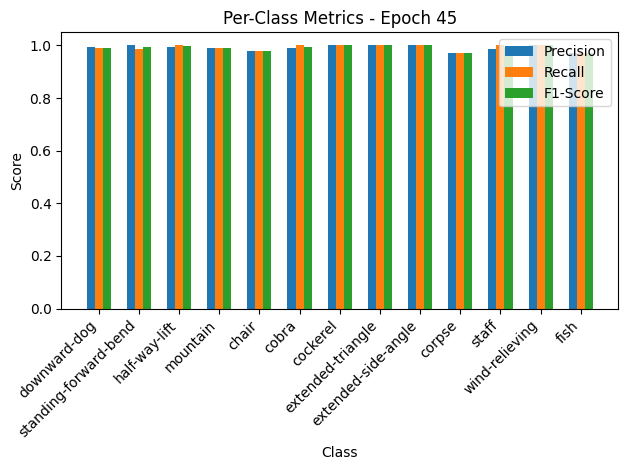

Validation: 100%|██████████| 21/21 [00:00<00:00, 28.44it/s, loss=0.113, accuracy=97.9]


Per-Class Metrics for Epoch 45:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.99
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=1.00, Recall=0.88, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.89, Recall=1.00, F1-Score=0.94


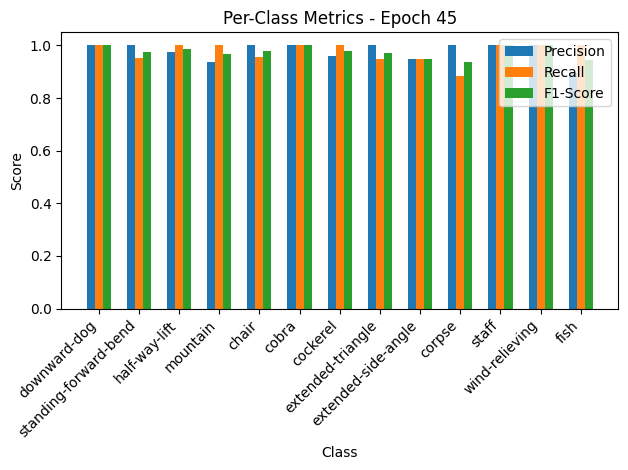


Epoch 46/50 Summary:
Train Loss: 0.0361 | Train Acc: 99.16% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1162 | Val Acc: 97.86% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 47/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:10<00:00,  7.59it/s, loss=0.0313, accuracy=98.5]


Per-Class Metrics for Epoch 46:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.98, F1-Score=0.97
mountain: Precision=0.97, Recall=0.98, F1-Score=0.98
chair: Precision=0.99, Recall=0.98, F1-Score=0.98
cobra: Precision=0.99, Recall=0.99, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.99, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.99, Recall=0.97, F1-Score=0.98


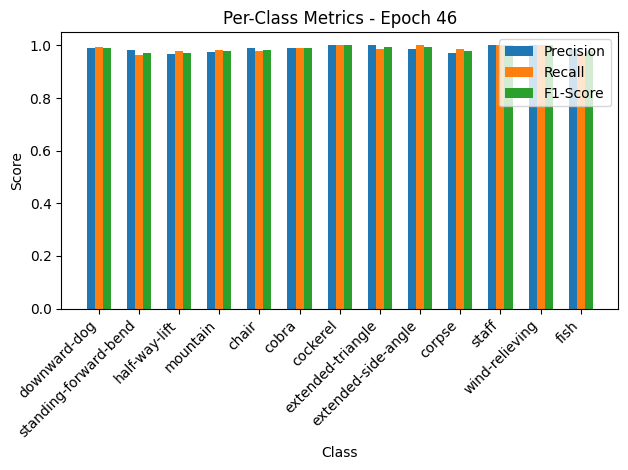

Validation: 100%|██████████| 21/21 [00:00<00:00, 29.49it/s, loss=0.0939, accuracy=98.8]


Per-Class Metrics for Epoch 46:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.99
mountain: Precision=0.97, Recall=1.00, F1-Score=0.98
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=1.00, F1-Score=0.97


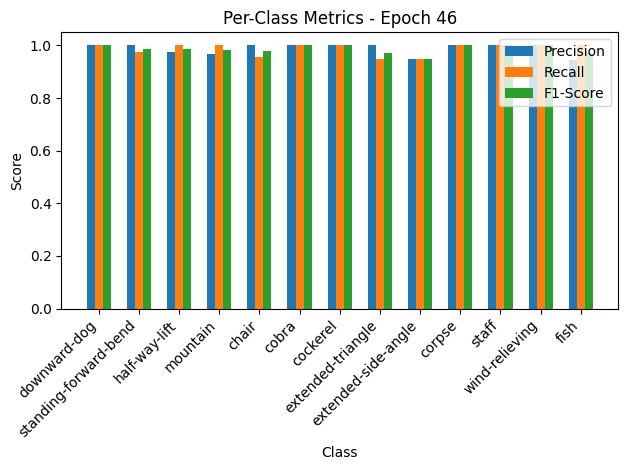


Epoch 47/50 Summary:
Train Loss: 0.0314 | Train Acc: 98.55% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0965 | Val Acc: 98.78% | Val Precision: 0.99 | Val Recall: 0.99 | Val F1: 0.99

Epoch 48/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:08<00:00,  9.26it/s, loss=0.03, accuracy=99.2]


Per-Class Metrics for Epoch 47:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.98, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.99, Recall=0.99, F1-Score=0.99
mountain: Precision=0.99, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=0.99, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.97, Recall=0.97, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.97, F1-Score=0.97


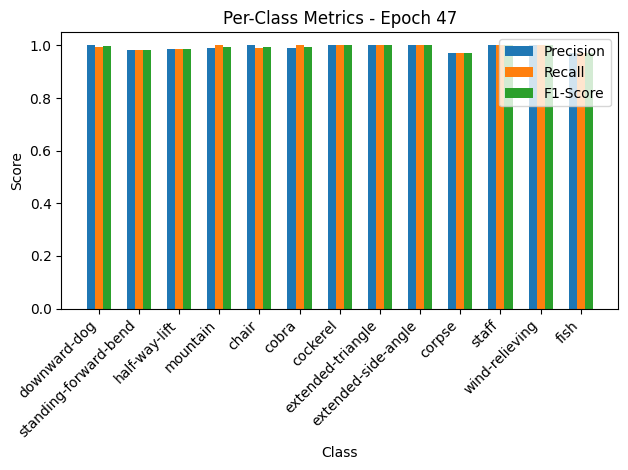

Validation: 100%|██████████| 21/21 [00:00<00:00, 23.27it/s, loss=0.0893, accuracy=98.5]


Per-Class Metrics for Epoch 47:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.99
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=1.00, F1-Score=0.97


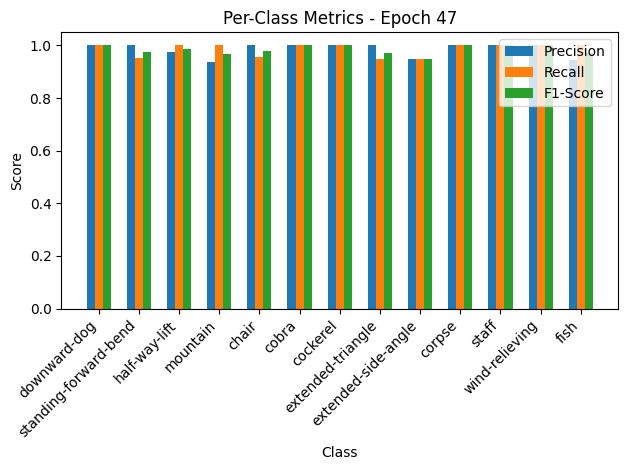


Epoch 48/50 Summary:
Train Loss: 0.0301 | Train Acc: 99.16% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0917 | Val Acc: 98.47% | Val Precision: 0.99 | Val Recall: 0.98 | Val F1: 0.98

Epoch 49/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:09<00:00,  8.90it/s, loss=0.0255, accuracy=99.2]


Per-Class Metrics for Epoch 48:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=1.00, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.98, Recall=1.00, F1-Score=0.99
mountain: Precision=0.99, Recall=0.99, F1-Score=0.99
chair: Precision=0.98, Recall=1.00, F1-Score=0.99
cobra: Precision=1.00, Recall=0.99, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.97, Recall=1.00, F1-Score=0.99
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.96, F1-Score=0.98


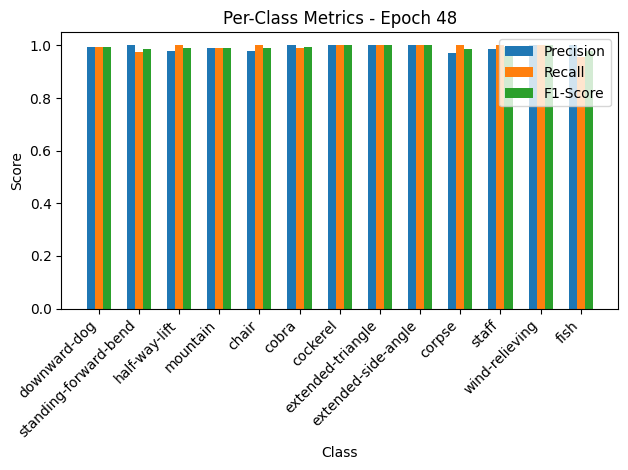

Validation: 100%|██████████| 21/21 [00:00<00:00, 30.18it/s, loss=0.1, accuracy=98.5]


Per-Class Metrics for Epoch 48:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.99
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


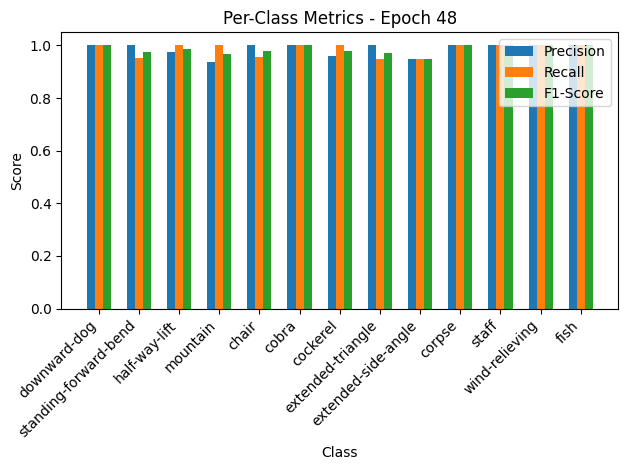


Epoch 49/50 Summary:
Train Loss: 0.0256 | Train Acc: 99.24% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1029 | Val Acc: 98.47% | Val Precision: 0.99 | Val Recall: 0.98 | Val F1: 0.98

Epoch 50/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:10<00:00,  8.17it/s, loss=0.0217, accuracy=99.4]


Per-Class Metrics for Epoch 49:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=1.00, Recall=0.99, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.99, Recall=0.99, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.99, Recall=0.99, F1-Score=0.99


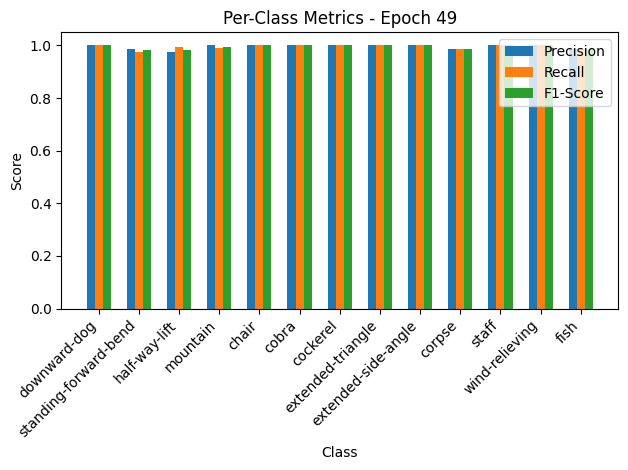

Validation: 100%|██████████| 21/21 [00:00<00:00, 28.54it/s, loss=0.0894, accuracy=98.5]


Per-Class Metrics for Epoch 49:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.99
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.94, Recall=1.00, F1-Score=0.97
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


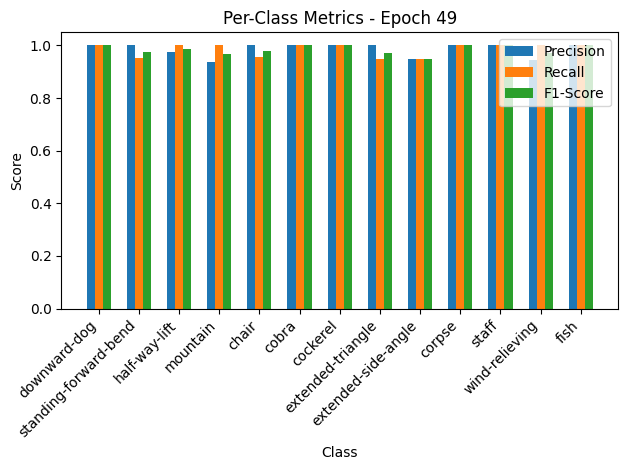


Epoch 50/50 Summary:
Train Loss: 0.0217 | Train Acc: 99.39% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0919 | Val Acc: 98.47% | Val Precision: 0.99 | Val Recall: 0.98 | Val F1: 0.98


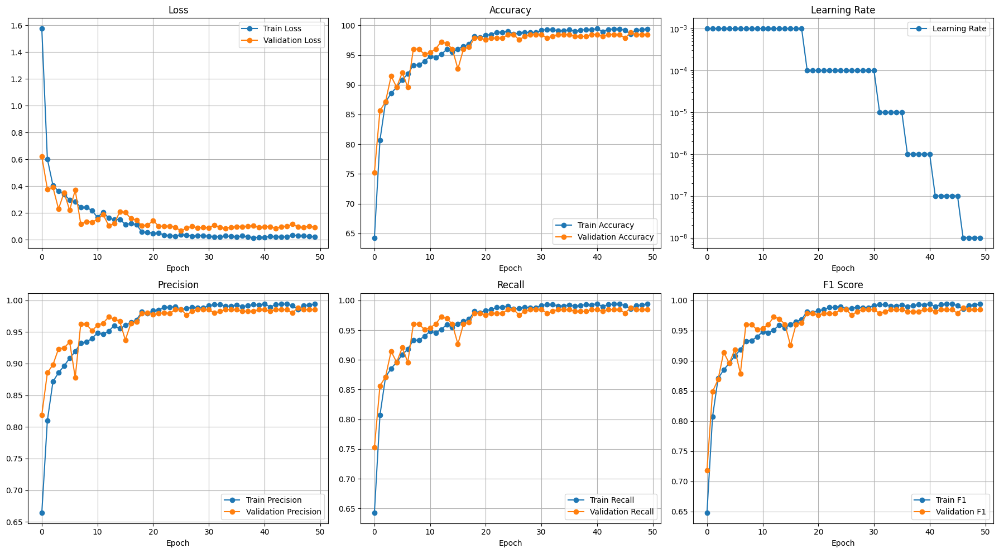

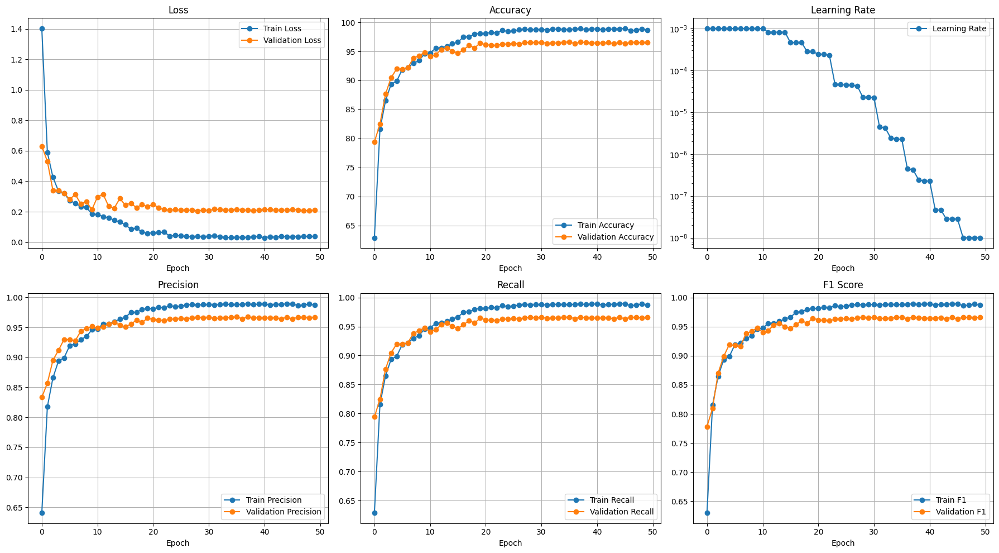

Testing: 100%|██████████| 12/12 [00:00<00:00, 32.88it/s]


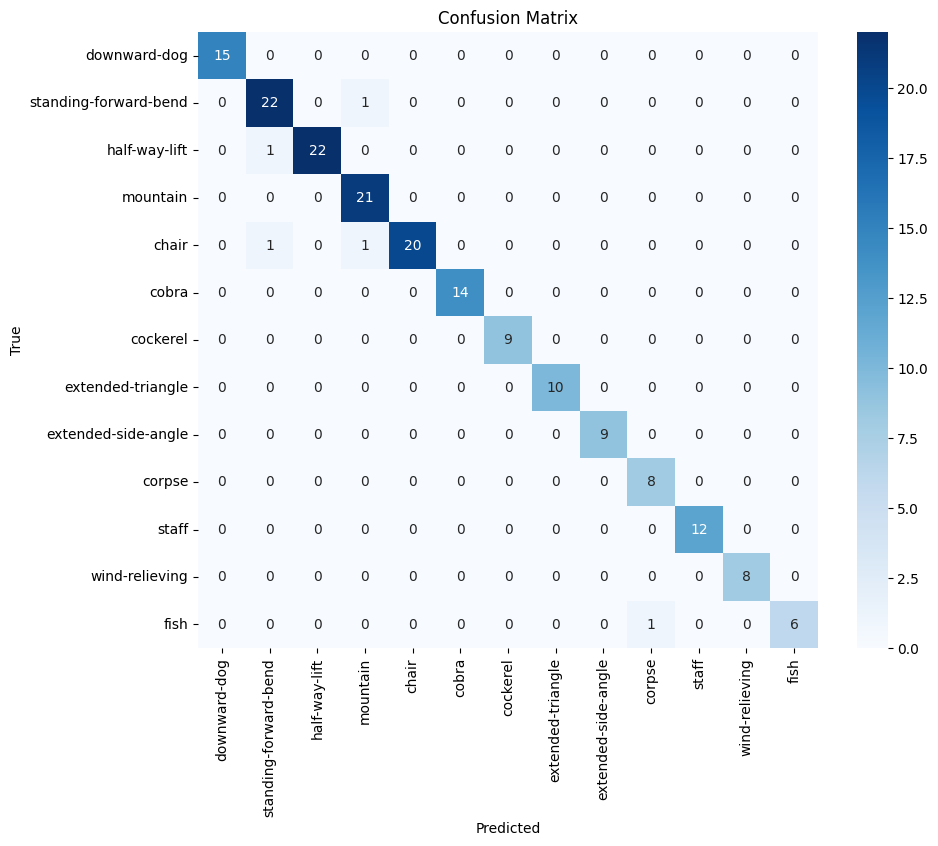

Test Loss: 0.1034
Test Accuracy: 97.24%


In [29]:
if __name__ == "__main__":
    main()

In [30]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
import seaborn as sns
import torch
import numpy as np
import os
from tqdm import tqdm
import csv

def find_sus(model, test_loader, criterion, class_names, spath=SAVE_PATH, fsave='confusion_matrix_all.png'):
    """
    Evaluate model on test set

    Args:
        model: PyTorch model
        test_loader: DataLoader for test data
        criterion: Loss function
        class_names: List of class names
        save_path: Directory to save the plot
        fsave: Filename for confusion matrix plot
    """
    csave = os.path.join(spath, fsave)
    sussave = os.path.join(spath, 'sus.csv')
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model = model.to(device)
    model.eval()

    test_loss = 0.0
    test_correct = 0
    test_total = 0
    all_predictions = []
    all_labels = []
    misclassified_data = []

    # Create progress bar
    test_loader_tqdm = tqdm(test_loader, desc="Testing")

    with torch.no_grad():
        for batch_idx, (inputs, labels) in enumerate(test_loader_tqdm):
            inputs = inputs.to(device)
            labels = labels.to(device)
            # Forward pass
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            test_loss += loss.item() * inputs.size(0)

            # Get predictions
            _, predicted = torch.max(outputs, 1)
            # Calculate accuracy
            test_correct += (predicted == labels).sum().item()
            test_total += labels.size(0)

            # Store predictions and labels for confusion matrix
            all_predictions.extend(predicted.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())

            # Check if the sample is misclassified
            misclassified_indices = (predicted != labels).nonzero(as_tuple=True)[0]
            for misclassified_idx in misclassified_indices:
                global_idx = batch_idx * inputs.size(0) + misclassified_idx.item()
                sequence_id = test_loader.dataset.idx_to_seq[global_idx]
                correct_label = class_names[labels[misclassified_idx].item()]
                prediction = class_names[predicted[misclassified_idx].item()]
                misclassified_data.append([sequence_id, correct_label, prediction])

    # Calculate metrics
    test_loss = test_loss / len(test_loader.dataset)
    accuracy = 100 * test_correct / test_total

    # Create confusion matrix
    cm = confusion_matrix(all_labels, all_predictions)

    # Plot confusion matrix
    plt.figure(figsize=(10, 8))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=pose_list, yticklabels=pose_list)
    plt.title('Confusion Matrix')
    plt.xlabel('Predicted')
    plt.ylabel('True')

    # Save the plot
    plt.savefig(csave)
    plt.show()
    plt.close()

    # Save misclassified data to CSV
    with open(sussave, mode='w', newline='') as file:
        writer = csv.writer(file)
        writer.writerow(['sequence_id', 'correct_label', 'prediction'])
        writer.writerows(misclassified_data)

    print(f'Test Loss: {test_loss:.4f}')
    print(f'Test Accuracy: {accuracy:.2f}%')

    return test_loss, accuracy

Class weights aligned with indices: tensor([0.5087, 0.5539, 0.5963, 0.7553, 0.8902, 0.9661, 1.0385, 1.1539, 1.2339,
        1.3118, 1.3258, 1.3258, 1.3400])
Loading checkpoint from /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention/best_model.pth
Resuming training from epoch 26


Testing: 100%|██████████| 114/114 [00:03<00:00, 34.64it/s]


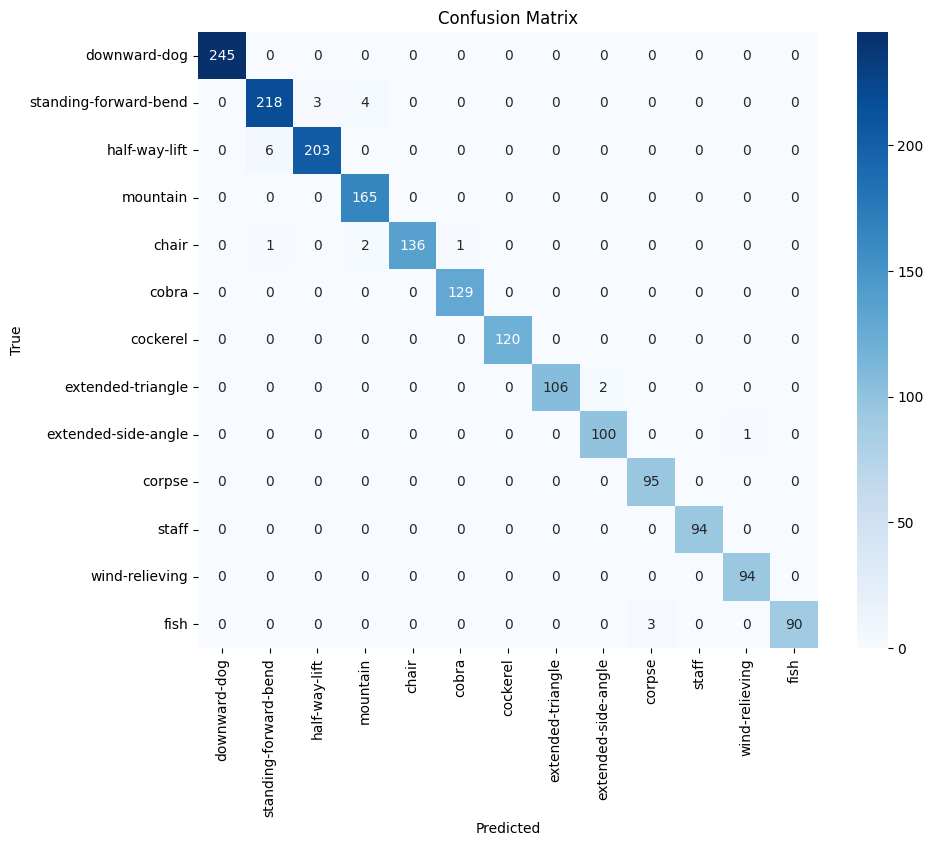

Test Loss: 0.0389
Test Accuracy: 98.73%


(0.0388502308581373, 98.73487348734874)

In [33]:
dataset = Yoga3DDataset(read_meta_data())
label_to_pose = {v:k for k,v in dataset.pose_to_label.items()}

model = STSAE_GCN(3, HIDDEN_CHANNELS, NUM_CLASSES, 20, NUM_BLOCKS)
# criterion = nn.CrossEntropyLoss()
all_labels = [dataset[i][1] for i in range(len(dataset))]
criterion = create_weighted_criterion(
        all_labels,
        num_classes= NUM_CLASSES,
        strategy='inverse'  # Try different strategies
    )
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

checkpoint_path = os.path.join(SAVE_PATH, 'best_model.pth')
# Plot the training curves
if checkpoint_path and os.path.exists(checkpoint_path):
        model, optimizer, start_epoch, history = load_checkpoint(
            model, optimizer, checkpoint_path
        )
        print(f"Resuming training from epoch {start_epoch}")
loader = DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=False)
# plot_training_curves(history)
find_sus(model, loader, criterion, label_to_pose)